In [2]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

# TensorNetwork class
class TensorNetwork:
    def __init__(self, graph, tensors):
        self.graph = graph
        self.tensors = tensors
        self.index_dims = {}
        self.index_to_tensors = {}

        for name, (tensor, indices) in tensors.items():
            for idx, dim in zip(indices, tensor.shape):
                if idx in self.index_dims:
                    assert self.index_dims[idx] == dim, f"index {idx} has inconsistent dimension"
                else:
                    self.index_dims[idx] = dim
                self.index_to_tensors.setdefault(idx, []).append((name, tensor, indices))
        
        self.col_of = {idx: c for c, idx in enumerate(self.index_dims)}

# evaluate configuration
def evaluate_config(network, configs):
    result = np.ones(len(configs))
    for name, (tensor, inds) in network.tensors.items():
        keys = tuple(configs[:, network.col_of[i]] for i in inds)
        result *= tensor[keys]
    return result

# Glauber update
def update_edge(network, configs, idx, beta=1.0):
    # tensors = network.index_to_tensors[idx]
    # dim = network.index_dims[idx]
    # n_chains = configs.shape[0]
    # probs = np.ones((n_chains, dim))
    # for name, arr, inds in tensors:
    #     slc = []
    #     for i in inds:
    #         if i == idx:
    #             slc.append(slice(None))
    #         else:
    #             col = list(network.index_dims).index(i)
    #             slc.append(configs[:, col])
    #     arr_vals = arr[tuple(slc)].reshape(n_chains, dim)
    #     probs *= arr_vals ** beta
    
    # probs = probs / probs.sum(axis=1, keepdims=True)
    # new_vals = [np.random.choice(dim, p=probs[i]) for i in range(n_chains)]
    # idx_pos = list(network.index_dims).index(idx)
    # configs[:, idx_pos] = new_vals

    dim = network.index_dims[idx]
    col = network.col_of[idx]
    n_chains = configs.shape[0]

    probs = np.ones((n_chains, dim))
    for _, tensor, inds in network.index_to_tensors[idx]:
        slc = []
        for i in inds:
            if i == idx:
                slc.append(slice(None))
            else:
                slc.append(configs[:, network.col_of[i]])
        
        arr_vals = tensor[tuple(slc)]
        if arr_vals.shape != (n_chains, dim):
            arr_vals = arr_vals.T
        probs *= arr_vals ** beta
    
    probs /= probs.sum(axis=1, keepdims=True)
    new_vals = [np.random.choice(dim, p=probs[i]) for i in range(n_chains)]
    configs[:, col] = new_vals


# contraction estimate with live plot
def estimate_contraction(net       : TensorNetwork,
                         betas     : np.ndarray,
                         iters     : int  = 10_000,
                         burns     : int  = 1_000,
                         n_rounds  : int  = 5,
                         verbose   : bool = True):
    logZ_trajs       = [[] for _ in range(n_rounds)]
    weights_by_beta  = [[] for _ in range(len(betas)-1)]
    logZ_sums        = np.zeros(n_rounds)

    index_list = list(net.index_dims)
    total_steps = len(betas) - 1
    dim_size = len(index_list)

    configs = np.random.randint(0, 3, size=(n_rounds, dim_size))

    for i in range(1, len(betas)):
        beta_prev, beta_curr = betas[i-1], betas[i]
        delta_beta = beta_curr - beta_prev

        if verbose and (i % 10 == 0 or i == total_steps):
            timestamp = datetime.now().strftime("%H:%M:%S")
            print(f'[{timestamp}] beta step {i}/{total_steps} ({beta_curr:.4f}) ')

        all_weights = [[] for _ in range(n_rounds)]

        for t in range(iters):
            idx = np.random.choice(index_list)
            update_edge(net, configs, idx, beta=beta_prev)
            if t >= burns:
                psi_vals = evaluate_config(net, configs)
                valid = psi_vals > 1e-30
                weights = np.where(valid, psi_vals ** delta_beta, 0.0)
                for j in range(n_rounds):
                    all_weights[j].append(weights[j])

        mean_weights = [np.mean(w) if len(w) > 0 else 0.0 for w in all_weights]
        log_rhos     = [np.log(mw) if mw > 0 else -np.inf for mw in mean_weights]

        for j in range(n_rounds):
            logZ_sums[j] += log_rhos[j]
            logZ_trajs[j].append(logZ_sums[j])
            weights_by_beta[i-1].append(np.asarray(all_weights[j]))

        if verbose:
            print(f"[beta={beta_curr:.3f}]  mean log rho = {np.mean(log_rhos):+.3e}  | <w> mean = {np.mean(mean_weights):.4e}")

    log_size = np.sum(np.log(list(net.index_dims.values())))
    Z_ests = np.exp(logZ_sums + log_size)
    return Z_ests, logZ_trajs, weights_by_beta


# run several independent AIS chains and visualize convergence
def run_multiple_chains(net        : TensorNetwork,
                        betas      : np.ndarray,
                        n_chains   : int  = 5,
                        iters      : int  = 10_000,
                        burns      : int  = 1_000,
                        n_rounds   : int  = 5,
                        Z_true     : float|None = None,
                        n_workers  : int  = None):

    print(f"Running {n_chains} AIS chains vectorized")
    Z_ests, logZ_trajectories, weights_by_beta = estimate_contraction(
        net, betas, iters, burns, n_rounds=n_chains, verbose=True
    )

    est_mean, est_std = np.mean(Z_ests), np.std(Z_ests)
    rel_var = est_std / est_mean if est_mean > 0 else float("nan")

    # ---------- combined plotting in subplots ----------------------- #
    fig, axs = plt.subplots(1, 3, figsize=(18, 4.5))

    # subplot 1: log-Z trajectories
    for k, traj in enumerate(logZ_trajectories, 1):
        axs[0].plot(betas[1:], traj, label=f"chain {k}", alpha=0.8)
    axs[0].set_xlabel(r"$\beta$")
    axs[0].set_ylabel(r"$\log Z$")
    axs[0].set_title("Log-Z convergence")
    axs[0].legend()
    axs[0].grid(True)

    # subplot 2: relative std of weights
    for k in range(n_chains):
        rel_sig = []
        for weights in weights_by_beta:
            w = weights[k]
            rel = np.std(w) / np.mean(w) if np.mean(w) > 0 else 0
            rel_sig.append(rel)
        axs[1].plot(betas[1:], rel_sig, label=f"chain {k+1}", alpha=0.8)
    axs[1].set_xlabel(r"$\beta$")
    axs[1].set_ylabel(r"rel $\sigma(w)$")
    axs[1].set_title("Weight dispersion vs beta")
    axs[1].legend()
    axs[1].grid(True)

    # subplot 3: final error bar plot
    if Z_true is not None:
        rel_errs = [abs(z - Z_true)/abs(Z_true) for z in Z_ests]
        axs[2].bar(range(1, n_chains+1), rel_errs)
        axs[2].set_xlabel("Chain")
        axs[2].set_ylabel("Rel. error")
        axs[2].set_title("Final relative error")
        axs[2].grid(True)

        print(f"True  Z   : {Z_true:.6f}")
        print(f"Mean  Ẑ  : {est_mean:.6f}  ± {est_std:.6f}")
        print(f"Mean rel error: {np.mean(rel_errs):.2%}")

    print(rf"\nFinal relative variance of $\hat Z$: {rel_var:.4e}")
    plt.tight_layout()
    plt.show()

    return est_mean, est_std

# contract full tensor network using np.einsum
def contract_tensor_network(graph, tensors):
    """
    Efficient full contraction using einsum.
    tensors: dict[node_name] = (ndarray, [str indices])
    """
    einsum_terms = []
    einsum_tensors = []
    index_map = {}
    chars = list('abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ')
    for _, (tensor, indices) in tensors.items():
        subs = []
        for idx in indices:
            if idx not in index_map:
                if not chars:
                    raise ValueError("not enough characters for indices")
                index_map[idx] = chars.pop(0)
            subs.append(index_map[idx])
        einsum_terms.append(''.join(subs))
        einsum_tensors.append(tensor)
    
    einsum_expr = ','.join(einsum_terms) + '->'
    return np.einsum(einsum_expr, *einsum_tensors)

# build 3x3 grid tensor network
def build_3x3_grid_test(dim=3):
    G = nx.Graph()
    tensors = {}
    grid_size = 3
    node_names = {(i, j): f"T{i}{j}" for i in range(grid_size) for j in range(grid_size)}

    def edge_index(i1, j1, i2, j2):
        return f"{i1}{j1}_{i2}{j2}"

    for i in range(grid_size):
        for j in range(grid_size):
            name = node_names[(i, j)]
            neighbors = []

            if j + 1 < grid_size:
                nbr = node_names[(i, j+1)]
                idx = edge_index(i, j, i, j+1)
                G.add_edge(name, nbr)
                neighbors.append(idx)

            if i + 1 < grid_size:
                nbr = node_names[(i+1, j)]
                idx = edge_index(i, j, i+1, j)
                G.add_edge(name, nbr)
                neighbors.append(idx)

            if j > 0:
                neighbors.append(edge_index(i, j-1, i, j))
            if i > 0:
                neighbors.append(edge_index(i-1, j, i, j))

            neighbors = sorted(neighbors)
            shape = (dim,) * len(neighbors)
            data = np.random.rand(*shape) + 1e-6  # positive entries ∈ (1e-6, 1)
            tensors[name] = (data, neighbors)

    return G, tensors

# full test on 3x3 grid tensor network with summary
def test_trace_3x3_grid(dim=3,
                        betas=np.linspace(0, 1, 100),
                        n_chains=5,
                        iters=20000,
                        burns=2000,
                        n_rounds=50):
    print("\n>>> Building 3x3 tensor network")
    G, tensors = build_3x3_grid_test(dim=dim)
    TRUE_Z = contract_tensor_network(G, tensors)
    print(f"True Z (exact contraction): {TRUE_Z:.6f}")

    tn = TensorNetwork(G, tensors)

    print("\n>>> Running MCMC chains")
    mean_Z, std_Z = run_multiple_chains(
        tn, betas,
        n_chains=n_chains,
        iters=iters,
        burns=burns,
        n_rounds=n_rounds,
        Z_true=TRUE_Z
    )

    rel_error = abs(mean_Z - TRUE_Z) / TRUE_Z
    print("\n================== Final Summary ==================")
    print(f"True       Z : {TRUE_Z:.6f}")
    print(f"Estimated  Z : {mean_Z:.6f} ± {std_Z:.6f}")
    print(f"Relative Error: {rel_error:.2e}")
    print("====================================================")


In [5]:
def sensitivity_iters(dim=3, 
                      betas=np.linspace(0, 1, 100), 
                      n_chains=5, 
                      iters_list=[1000, 2000, 5000, 10000, 20000],
                      burns=1000,
                      n_rounds=5,
                      n_trials=10):  # run each setting multiple times
    print('\n>>> Building Tensor Network')
    G, tensors = build_3x3_grid_test(dim=dim)
    TRUE_Z = contract_tensor_network(G, tensors)
    tn = TensorNetwork(G, tensors)

    stats = []

    for iters in iters_list:
        print(f'\n>>> Running {iters} iterations')

        rel_errors = []
        Z_means = []

        for trial in range(n_trials):
            try:
                mean_Z, std_Z = run_multiple_chains(
                    tn, betas,
                    n_chains=n_chains,
                    iters=iters,
                    burns=burns,
                    n_rounds=n_rounds,
                    Z_true=TRUE_Z,
                )
                rel_error = np.abs(mean_Z - TRUE_Z) / np.abs(TRUE_Z)
                rel_errors.append(rel_error)
                Z_means.append(mean_Z)
            except Exception as e:
                print(f"[!] Trial {trial+1} failed for {iters} iters: {e}")

        if len(rel_errors) > 0:
            stats.append({
                'Iterations': iters,
                'Mean Relative Error': np.mean(rel_errors),
                'Std Relative Error': np.std(rel_errors),
                'Mean Ẑ': np.mean(Z_means),
                'Std Ẑ': np.std(Z_means)
            })

    df = pd.DataFrame(stats)

    sns.set_theme(context="notebook", style="whitegrid", palette="deep", font_scale=1)
    plt.figure(figsize=(6, 4))
    plt.errorbar(df['Iterations'], df['Mean Relative Error'],
                 yerr=df['Std Relative Error'], fmt='o-', capsize=4, lw=2)
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel('Number of MCMC Iterations per beta')
    plt.ylabel('Relative Error (log scale)')
    plt.title('Sensitivity of Estimate to MCMC Iterations')
    plt.tight_layout()
    plt.grid(True, which='both', linestyle='--')
    plt.show()

    print(df.to_string(index=False, float_format='%.6f'))
    return df


>>> Building Tensor Network

>>> Running 1000 iterations
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:24:23] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean =

/Users/aniket/miniforge3/envs/ml/lib/python3.12/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/aniket/miniforge3/envs/ml/lib/python3.12/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


True  Z   : 961.890717
Mean  Ẑ  : 0.000000  ± 0.000000
Mean rel error: 100.00%
\nFinal relative variance of $\hat Z$: nan


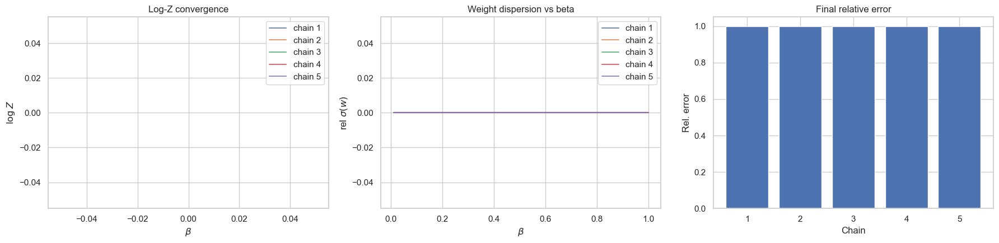

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:24:32] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

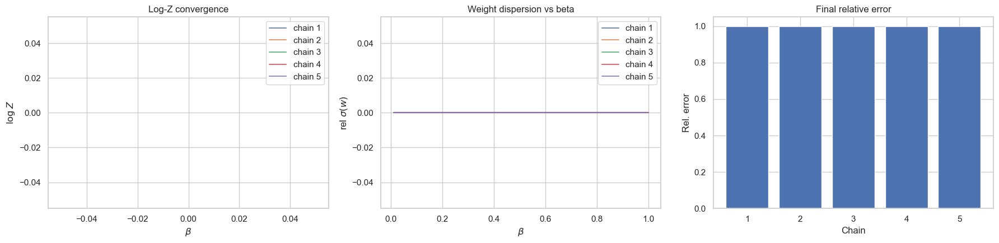

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:24:42] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

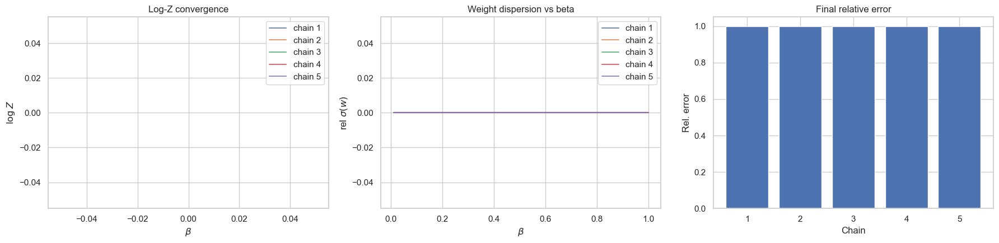

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:24:52] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

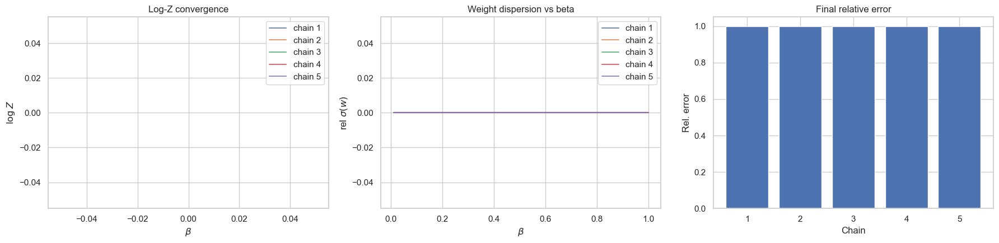

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:25:02] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

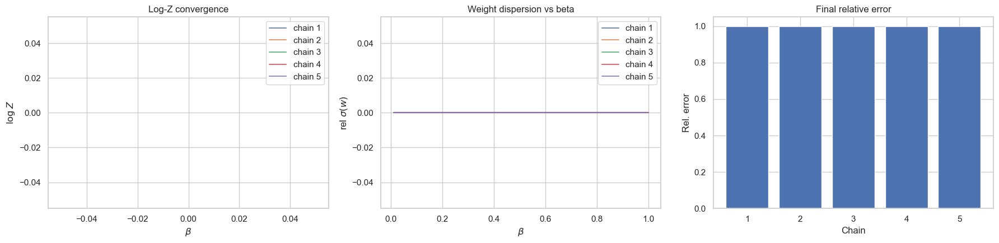

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:25:12] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

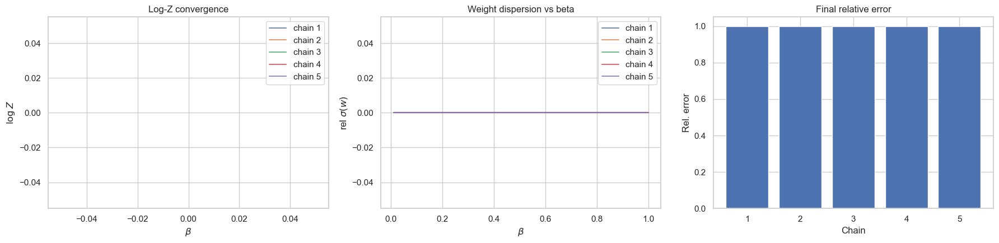

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:25:22] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

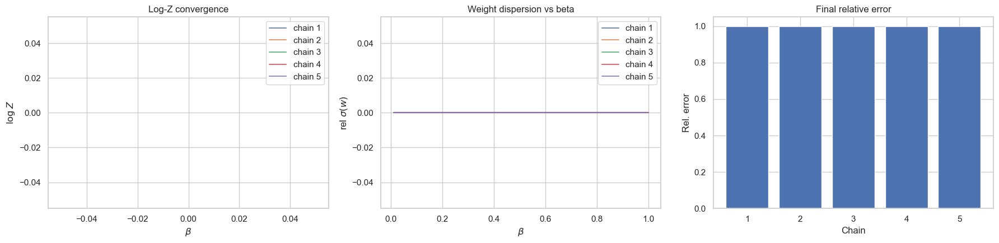

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:25:31] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

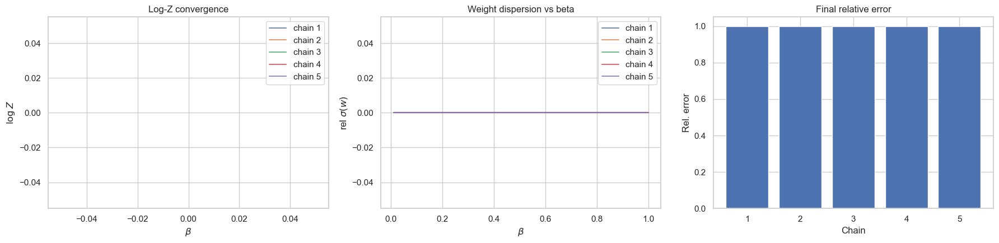

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:25:41] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

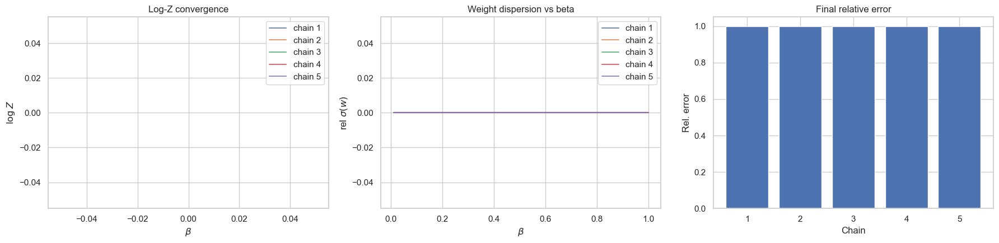

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.020]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.030]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.040]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.051]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.061]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.071]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.081]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.091]  mean log rho = -inf  | <w> mean = 0.0000e+00
[18:25:51] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.111]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.121]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.131]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.141]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.152]  mean log rho = -inf  | <w> mean = 0.0000e+00
[beta=0.162]  mean log rho = -inf  | <w> mean 

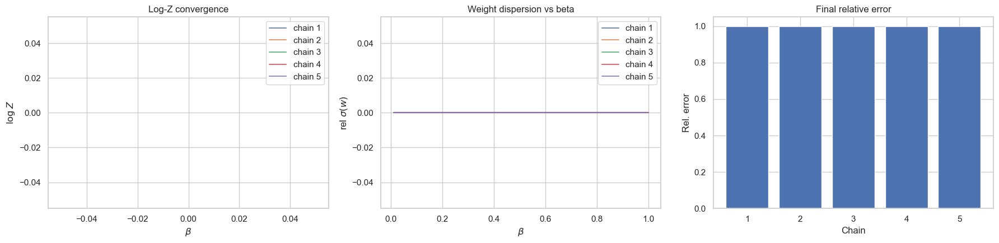


>>> Running 2000 iterations
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.946e-02  | <w> mean = 9.1443e-01
[beta=0.020]  mean log rho = -8.956e-02  | <w> mean = 9.1433e-01
[beta=0.030]  mean log rho = -8.794e-02  | <w> mean = 9.1582e-01
[beta=0.040]  mean log rho = -8.656e-02  | <w> mean = 9.1709e-01
[beta=0.051]  mean log rho = -8.689e-02  | <w> mean = 9.1678e-01
[beta=0.061]  mean log rho = -8.606e-02  | <w> mean = 9.1754e-01
[beta=0.071]  mean log rho = -8.605e-02  | <w> mean = 9.1755e-01
[beta=0.081]  mean log rho = -8.346e-02  | <w> mean = 9.1993e-01
[beta=0.091]  mean log rho = -8.232e-02  | <w> mean = 9.2098e-01
[18:26:02] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.341e-02  | <w> mean = 9.1998e-01
[beta=0.111]  mean log rho = -8.293e-02  | <w> mean = 9.2042e-01
[beta=0.121]  mean log rho = -8.007e-02  | <w> mean = 9.2305e-01
[beta=0.131]  mean log rho = -8.125e-02  | <w> mean = 9.2197e-01
[beta=0.141]  mean log rho = -8.093e-02  | <w> mean = 9.2

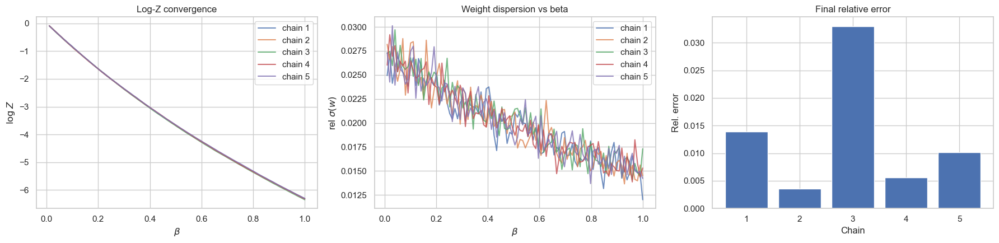

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -9.050e-02  | <w> mean = 9.1348e-01
[beta=0.020]  mean log rho = -8.745e-02  | <w> mean = 9.1627e-01
[beta=0.030]  mean log rho = -8.812e-02  | <w> mean = 9.1565e-01
[beta=0.040]  mean log rho = -8.713e-02  | <w> mean = 9.1657e-01
[beta=0.051]  mean log rho = -8.473e-02  | <w> mean = 9.1876e-01
[beta=0.061]  mean log rho = -8.616e-02  | <w> mean = 9.1745e-01
[beta=0.071]  mean log rho = -8.554e-02  | <w> mean = 9.1802e-01
[beta=0.081]  mean log rho = -8.338e-02  | <w> mean = 9.2000e-01
[beta=0.091]  mean log rho = -8.378e-02  | <w> mean = 9.1964e-01
[18:26:25] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.399e-02  | <w> mean = 9.1944e-01
[beta=0.111]  mean log rho = -7.862e-02  | <w> mean = 9.2439e-01
[beta=0.121]  mean log rho = -8.308e-02  | <w> mean = 9.2028e-01
[beta=0.131]  mean log rho = -8.151e-02  | <w> mean = 9.2173e-01
[beta=0.141]  mean log rho = -8.075e-02  | <w> mean = 9.2242e-01
[beta=0.152]  mean lo

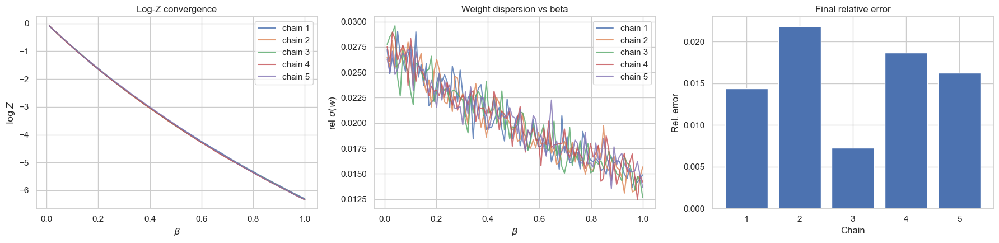

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.841e-02  | <w> mean = 9.1539e-01
[beta=0.020]  mean log rho = -8.643e-02  | <w> mean = 9.1720e-01
[beta=0.030]  mean log rho = -8.845e-02  | <w> mean = 9.1535e-01
[beta=0.040]  mean log rho = -8.665e-02  | <w> mean = 9.1701e-01
[beta=0.051]  mean log rho = -8.745e-02  | <w> mean = 9.1627e-01
[beta=0.061]  mean log rho = -8.503e-02  | <w> mean = 9.1849e-01
[beta=0.071]  mean log rho = -8.442e-02  | <w> mean = 9.1904e-01
[beta=0.081]  mean log rho = -8.245e-02  | <w> mean = 9.2086e-01
[beta=0.091]  mean log rho = -8.439e-02  | <w> mean = 9.1907e-01
[18:26:48] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.135e-02  | <w> mean = 9.2187e-01
[beta=0.111]  mean log rho = -8.342e-02  | <w> mean = 9.1997e-01
[beta=0.121]  mean log rho = -8.118e-02  | <w> mean = 9.2203e-01
[beta=0.131]  mean log rho = -8.206e-02  | <w> mean = 9.2122e-01
[beta=0.141]  mean log rho = -8.145e-02  | <w> mean = 9.2179e-01
[beta=0.152]  mean lo

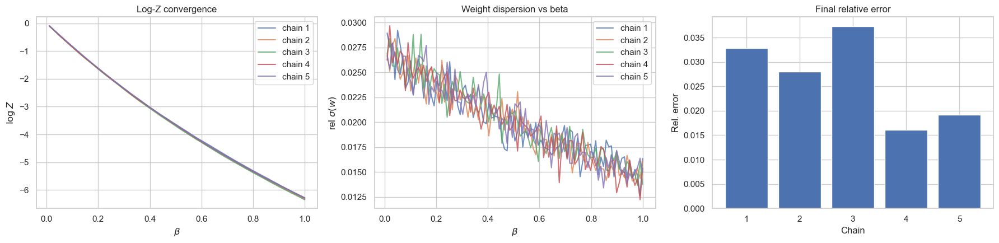

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.944e-02  | <w> mean = 9.1444e-01
[beta=0.020]  mean log rho = -8.786e-02  | <w> mean = 9.1589e-01
[beta=0.030]  mean log rho = -8.614e-02  | <w> mean = 9.1747e-01
[beta=0.040]  mean log rho = -8.595e-02  | <w> mean = 9.1765e-01
[beta=0.051]  mean log rho = -8.740e-02  | <w> mean = 9.1631e-01
[beta=0.061]  mean log rho = -8.370e-02  | <w> mean = 9.1971e-01
[beta=0.071]  mean log rho = -8.602e-02  | <w> mean = 9.1758e-01
[beta=0.081]  mean log rho = -8.508e-02  | <w> mean = 9.1844e-01
[beta=0.091]  mean log rho = -8.280e-02  | <w> mean = 9.2054e-01
[18:27:11] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.327e-02  | <w> mean = 9.2011e-01
[beta=0.111]  mean log rho = -8.041e-02  | <w> mean = 9.2274e-01
[beta=0.121]  mean log rho = -8.058e-02  | <w> mean = 9.2258e-01
[beta=0.131]  mean log rho = -8.113e-02  | <w> mean = 9.2207e-01
[beta=0.141]  mean log rho = -7.824e-02  | <w> mean = 9.2475e-01
[beta=0.152]  mean lo

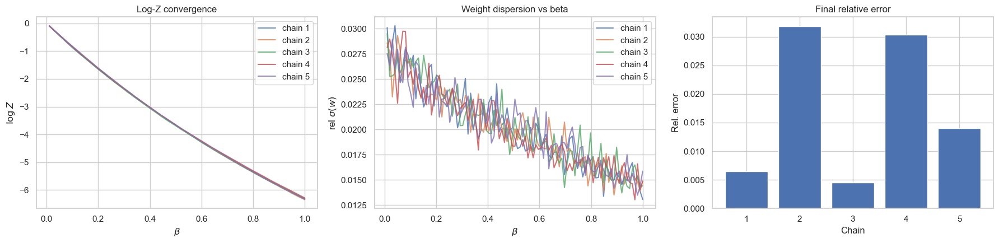

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -9.006e-02  | <w> mean = 9.1388e-01
[beta=0.020]  mean log rho = -8.875e-02  | <w> mean = 9.1508e-01
[beta=0.030]  mean log rho = -8.878e-02  | <w> mean = 9.1505e-01
[beta=0.040]  mean log rho = -8.733e-02  | <w> mean = 9.1638e-01
[beta=0.051]  mean log rho = -8.401e-02  | <w> mean = 9.1942e-01
[beta=0.061]  mean log rho = -8.484e-02  | <w> mean = 9.1866e-01
[beta=0.071]  mean log rho = -8.388e-02  | <w> mean = 9.1954e-01
[beta=0.081]  mean log rho = -8.318e-02  | <w> mean = 9.2019e-01
[beta=0.091]  mean log rho = -8.394e-02  | <w> mean = 9.1949e-01
[18:27:34] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.226e-02  | <w> mean = 9.2104e-01
[beta=0.111]  mean log rho = -8.385e-02  | <w> mean = 9.1958e-01
[beta=0.121]  mean log rho = -8.051e-02  | <w> mean = 9.2265e-01
[beta=0.131]  mean log rho = -7.991e-02  | <w> mean = 9.2321e-01
[beta=0.141]  mean log rho = -8.083e-02  | <w> mean = 9.2236e-01
[beta=0.152]  mean lo

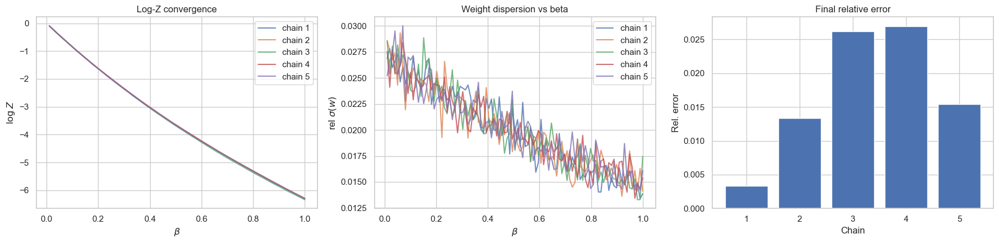

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.562e-02  | <w> mean = 9.1795e-01
[beta=0.020]  mean log rho = -8.683e-02  | <w> mean = 9.1684e-01
[beta=0.030]  mean log rho = -8.573e-02  | <w> mean = 9.1785e-01
[beta=0.040]  mean log rho = -8.689e-02  | <w> mean = 9.1678e-01
[beta=0.051]  mean log rho = -8.625e-02  | <w> mean = 9.1737e-01
[beta=0.061]  mean log rho = -8.647e-02  | <w> mean = 9.1716e-01
[beta=0.071]  mean log rho = -8.579e-02  | <w> mean = 9.1780e-01
[beta=0.081]  mean log rho = -8.531e-02  | <w> mean = 9.1823e-01
[beta=0.091]  mean log rho = -8.407e-02  | <w> mean = 9.1937e-01
[18:27:57] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.216e-02  | <w> mean = 9.2113e-01
[beta=0.111]  mean log rho = -8.373e-02  | <w> mean = 9.1968e-01
[beta=0.121]  mean log rho = -8.199e-02  | <w> mean = 9.2128e-01
[beta=0.131]  mean log rho = -8.215e-02  | <w> mean = 9.2114e-01
[beta=0.141]  mean log rho = -7.818e-02  | <w> mean = 9.2480e-01
[beta=0.152]  mean lo

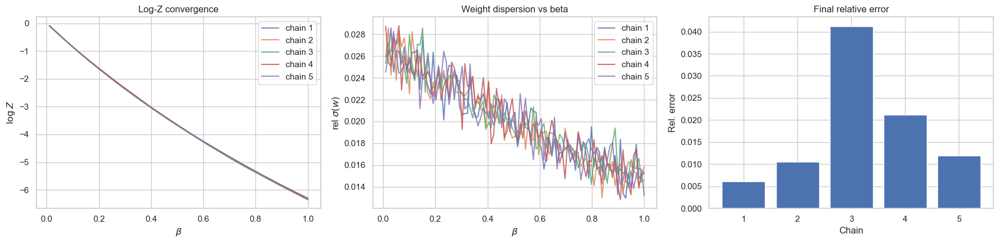

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.750e-02  | <w> mean = 9.1622e-01
[beta=0.020]  mean log rho = -8.713e-02  | <w> mean = 9.1656e-01
[beta=0.030]  mean log rho = -8.823e-02  | <w> mean = 9.1556e-01
[beta=0.040]  mean log rho = -8.917e-02  | <w> mean = 9.1469e-01
[beta=0.051]  mean log rho = -8.460e-02  | <w> mean = 9.1889e-01
[beta=0.061]  mean log rho = -8.333e-02  | <w> mean = 9.2005e-01
[beta=0.071]  mean log rho = -8.271e-02  | <w> mean = 9.2062e-01
[beta=0.081]  mean log rho = -8.403e-02  | <w> mean = 9.1940e-01
[beta=0.091]  mean log rho = -8.514e-02  | <w> mean = 9.1838e-01
[18:28:20] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.344e-02  | <w> mean = 9.1995e-01
[beta=0.111]  mean log rho = -8.043e-02  | <w> mean = 9.2272e-01
[beta=0.121]  mean log rho = -8.356e-02  | <w> mean = 9.1984e-01
[beta=0.131]  mean log rho = -7.944e-02  | <w> mean = 9.2363e-01
[beta=0.141]  mean log rho = -7.892e-02  | <w> mean = 9.2412e-01
[beta=0.152]  mean lo

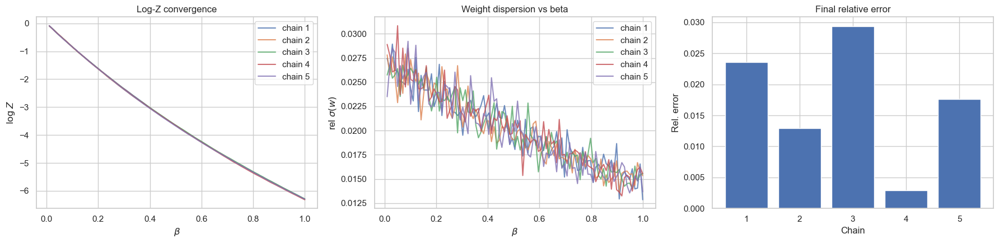

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.919e-02  | <w> mean = 9.1468e-01
[beta=0.020]  mean log rho = -8.856e-02  | <w> mean = 9.1525e-01
[beta=0.030]  mean log rho = -8.641e-02  | <w> mean = 9.1722e-01
[beta=0.040]  mean log rho = -8.578e-02  | <w> mean = 9.1779e-01
[beta=0.051]  mean log rho = -8.651e-02  | <w> mean = 9.1713e-01
[beta=0.061]  mean log rho = -8.524e-02  | <w> mean = 9.1829e-01
[beta=0.071]  mean log rho = -8.720e-02  | <w> mean = 9.1649e-01
[beta=0.081]  mean log rho = -8.514e-02  | <w> mean = 9.1839e-01
[beta=0.091]  mean log rho = -8.448e-02  | <w> mean = 9.1899e-01
[18:28:43] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.230e-02  | <w> mean = 9.2100e-01
[beta=0.111]  mean log rho = -8.153e-02  | <w> mean = 9.2171e-01
[beta=0.121]  mean log rho = -8.115e-02  | <w> mean = 9.2206e-01
[beta=0.131]  mean log rho = -8.018e-02  | <w> mean = 9.2295e-01
[beta=0.141]  mean log rho = -8.115e-02  | <w> mean = 9.2206e-01
[beta=0.152]  mean lo

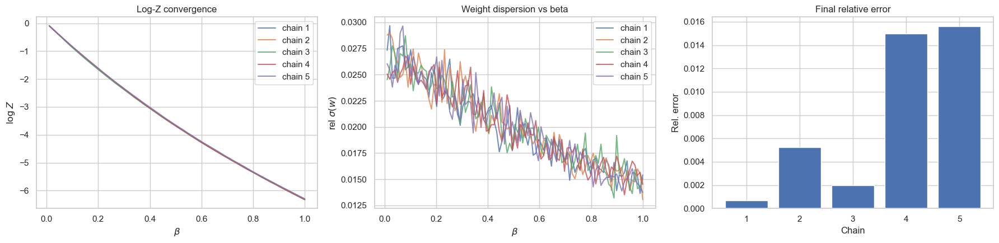

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -9.009e-02  | <w> mean = 9.1385e-01
[beta=0.020]  mean log rho = -8.991e-02  | <w> mean = 9.1401e-01
[beta=0.030]  mean log rho = -9.107e-02  | <w> mean = 9.1296e-01
[beta=0.040]  mean log rho = -8.634e-02  | <w> mean = 9.1728e-01
[beta=0.051]  mean log rho = -8.519e-02  | <w> mean = 9.1834e-01
[beta=0.061]  mean log rho = -8.467e-02  | <w> mean = 9.1882e-01
[beta=0.071]  mean log rho = -8.607e-02  | <w> mean = 9.1753e-01
[beta=0.081]  mean log rho = -8.508e-02  | <w> mean = 9.1844e-01
[beta=0.091]  mean log rho = -8.390e-02  | <w> mean = 9.1953e-01
[18:29:05] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.330e-02  | <w> mean = 9.2008e-01
[beta=0.111]  mean log rho = -8.159e-02  | <w> mean = 9.2165e-01
[beta=0.121]  mean log rho = -8.024e-02  | <w> mean = 9.2290e-01
[beta=0.131]  mean log rho = -8.113e-02  | <w> mean = 9.2208e-01
[beta=0.141]  mean log rho = -7.938e-02  | <w> mean = 9.2370e-01
[beta=0.152]  mean lo

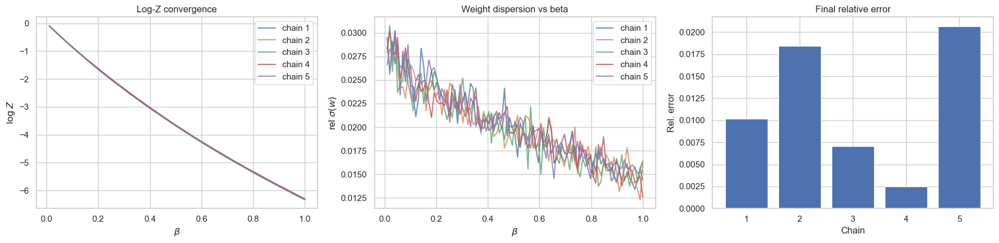

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.899e-02  | <w> mean = 9.1485e-01
[beta=0.020]  mean log rho = -8.701e-02  | <w> mean = 9.1667e-01
[beta=0.030]  mean log rho = -8.973e-02  | <w> mean = 9.1418e-01
[beta=0.040]  mean log rho = -8.565e-02  | <w> mean = 9.1792e-01
[beta=0.051]  mean log rho = -8.844e-02  | <w> mean = 9.1537e-01
[beta=0.061]  mean log rho = -8.548e-02  | <w> mean = 9.1808e-01
[beta=0.071]  mean log rho = -8.431e-02  | <w> mean = 9.1915e-01
[beta=0.081]  mean log rho = -8.311e-02  | <w> mean = 9.2025e-01
[beta=0.091]  mean log rho = -8.373e-02  | <w> mean = 9.1969e-01
[18:29:28] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.442e-02  | <w> mean = 9.1905e-01
[beta=0.111]  mean log rho = -8.195e-02  | <w> mean = 9.2132e-01
[beta=0.121]  mean log rho = -8.250e-02  | <w> mean = 9.2081e-01
[beta=0.131]  mean log rho = -8.245e-02  | <w> mean = 9.2086e-01
[beta=0.141]  mean log rho = -8.153e-02  | <w> mean = 9.2170e-01
[beta=0.152]  mean lo

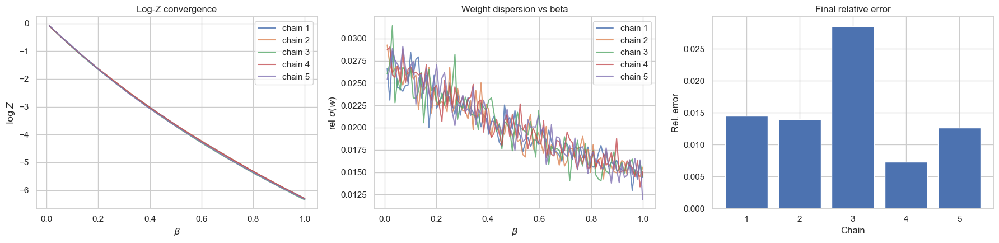


>>> Running 5000 iterations
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.918e-02  | <w> mean = 9.1468e-01
[beta=0.020]  mean log rho = -8.881e-02  | <w> mean = 9.1502e-01
[beta=0.030]  mean log rho = -8.737e-02  | <w> mean = 9.1634e-01
[beta=0.040]  mean log rho = -8.752e-02  | <w> mean = 9.1620e-01
[beta=0.051]  mean log rho = -8.661e-02  | <w> mean = 9.1703e-01
[beta=0.061]  mean log rho = -8.496e-02  | <w> mean = 9.1855e-01
[beta=0.071]  mean log rho = -8.507e-02  | <w> mean = 9.1845e-01
[beta=0.081]  mean log rho = -8.454e-02  | <w> mean = 9.1893e-01
[beta=0.091]  mean log rho = -8.447e-02  | <w> mean = 9.1900e-01
[18:29:54] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.266e-02  | <w> mean = 9.2066e-01
[beta=0.111]  mean log rho = -8.221e-02  | <w> mean = 9.2108e-01
[beta=0.121]  mean log rho = -8.186e-02  | <w> mean = 9.2140e-01
[beta=0.131]  mean log rho = -8.026e-02  | <w> mean = 9.2287e-01
[beta=0.141]  mean log rho = -7.958e-02  | <w> mean = 9.2

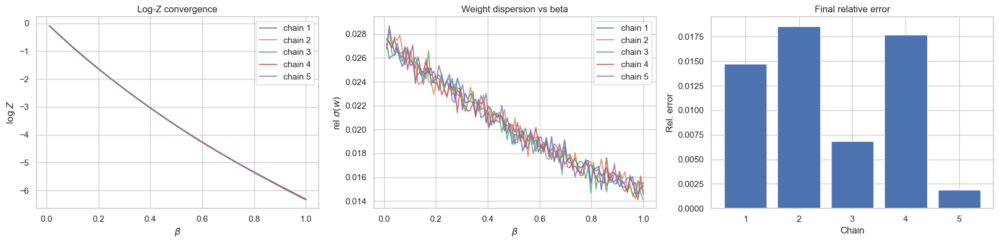

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.852e-02  | <w> mean = 9.1529e-01
[beta=0.020]  mean log rho = -8.888e-02  | <w> mean = 9.1495e-01
[beta=0.030]  mean log rho = -8.794e-02  | <w> mean = 9.1582e-01
[beta=0.040]  mean log rho = -8.854e-02  | <w> mean = 9.1526e-01
[beta=0.051]  mean log rho = -8.617e-02  | <w> mean = 9.1744e-01
[beta=0.061]  mean log rho = -8.595e-02  | <w> mean = 9.1764e-01
[beta=0.071]  mean log rho = -8.503e-02  | <w> mean = 9.1849e-01
[beta=0.081]  mean log rho = -8.236e-02  | <w> mean = 9.2094e-01
[beta=0.091]  mean log rho = -8.331e-02  | <w> mean = 9.2007e-01
[18:30:56] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.134e-02  | <w> mean = 9.2188e-01
[beta=0.111]  mean log rho = -8.228e-02  | <w> mean = 9.2101e-01
[beta=0.121]  mean log rho = -8.016e-02  | <w> mean = 9.2297e-01
[beta=0.131]  mean log rho = -8.007e-02  | <w> mean = 9.2305e-01
[beta=0.141]  mean log rho = -7.962e-02  | <w> mean = 9.2347e-01
[beta=0.152]  mean lo

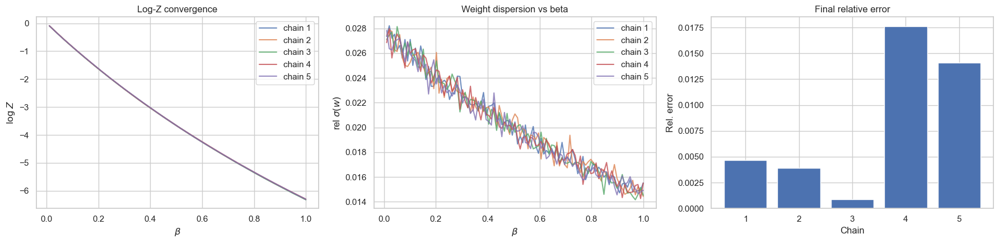

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.905e-02  | <w> mean = 9.1480e-01
[beta=0.020]  mean log rho = -8.811e-02  | <w> mean = 9.1566e-01
[beta=0.030]  mean log rho = -8.819e-02  | <w> mean = 9.1559e-01
[beta=0.040]  mean log rho = -8.626e-02  | <w> mean = 9.1736e-01
[beta=0.051]  mean log rho = -8.763e-02  | <w> mean = 9.1610e-01
[beta=0.061]  mean log rho = -8.446e-02  | <w> mean = 9.1901e-01
[beta=0.071]  mean log rho = -8.464e-02  | <w> mean = 9.1885e-01
[beta=0.081]  mean log rho = -8.494e-02  | <w> mean = 9.1857e-01
[beta=0.091]  mean log rho = -8.272e-02  | <w> mean = 9.2061e-01
[18:31:57] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.334e-02  | <w> mean = 9.2004e-01
[beta=0.111]  mean log rho = -8.192e-02  | <w> mean = 9.2134e-01
[beta=0.121]  mean log rho = -7.965e-02  | <w> mean = 9.2344e-01
[beta=0.131]  mean log rho = -8.036e-02  | <w> mean = 9.2279e-01
[beta=0.141]  mean log rho = -7.861e-02  | <w> mean = 9.2441e-01
[beta=0.152]  mean lo

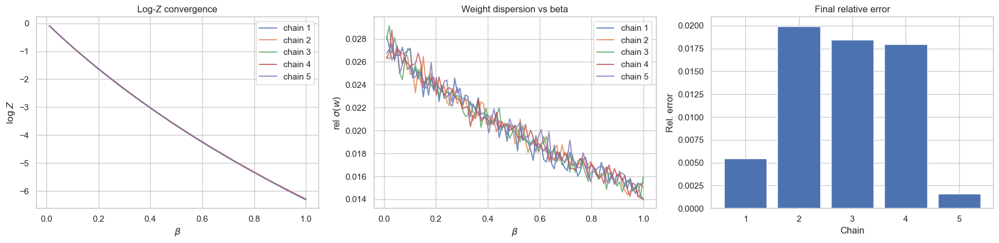

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.859e-02  | <w> mean = 9.1522e-01
[beta=0.020]  mean log rho = -8.756e-02  | <w> mean = 9.1617e-01
[beta=0.030]  mean log rho = -8.695e-02  | <w> mean = 9.1672e-01
[beta=0.040]  mean log rho = -8.678e-02  | <w> mean = 9.1688e-01
[beta=0.051]  mean log rho = -8.645e-02  | <w> mean = 9.1718e-01
[beta=0.061]  mean log rho = -8.490e-02  | <w> mean = 9.1861e-01
[beta=0.071]  mean log rho = -8.402e-02  | <w> mean = 9.1941e-01
[beta=0.081]  mean log rho = -8.423e-02  | <w> mean = 9.1922e-01
[beta=0.091]  mean log rho = -8.345e-02  | <w> mean = 9.1994e-01
[18:32:59] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.257e-02  | <w> mean = 9.2075e-01
[beta=0.111]  mean log rho = -8.147e-02  | <w> mean = 9.2176e-01
[beta=0.121]  mean log rho = -8.112e-02  | <w> mean = 9.2208e-01
[beta=0.131]  mean log rho = -8.013e-02  | <w> mean = 9.2300e-01
[beta=0.141]  mean log rho = -7.854e-02  | <w> mean = 9.2447e-01
[beta=0.152]  mean lo

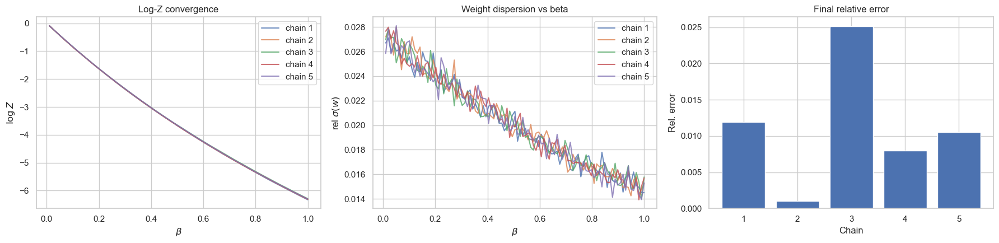

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.991e-02  | <w> mean = 9.1402e-01
[beta=0.020]  mean log rho = -8.810e-02  | <w> mean = 9.1567e-01
[beta=0.030]  mean log rho = -8.608e-02  | <w> mean = 9.1752e-01
[beta=0.040]  mean log rho = -8.711e-02  | <w> mean = 9.1658e-01
[beta=0.051]  mean log rho = -8.551e-02  | <w> mean = 9.1805e-01
[beta=0.061]  mean log rho = -8.585e-02  | <w> mean = 9.1773e-01
[beta=0.071]  mean log rho = -8.446e-02  | <w> mean = 9.1900e-01
[beta=0.081]  mean log rho = -8.356e-02  | <w> mean = 9.1984e-01
[beta=0.091]  mean log rho = -8.400e-02  | <w> mean = 9.1943e-01
[18:34:00] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.315e-02  | <w> mean = 9.2021e-01
[beta=0.111]  mean log rho = -8.059e-02  | <w> mean = 9.2257e-01
[beta=0.121]  mean log rho = -8.012e-02  | <w> mean = 9.2300e-01
[beta=0.131]  mean log rho = -8.111e-02  | <w> mean = 9.2209e-01
[beta=0.141]  mean log rho = -7.960e-02  | <w> mean = 9.2349e-01
[beta=0.152]  mean lo

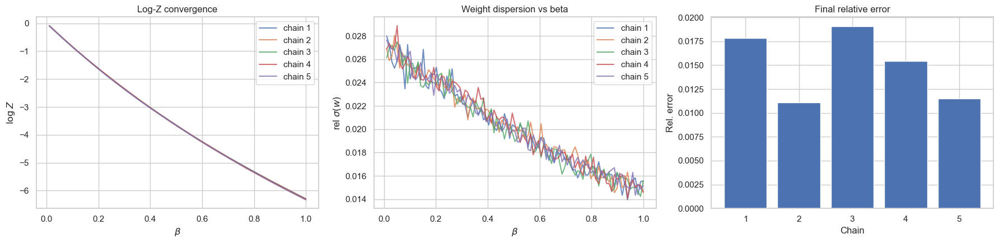

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.900e-02  | <w> mean = 9.1485e-01
[beta=0.020]  mean log rho = -8.829e-02  | <w> mean = 9.1549e-01
[beta=0.030]  mean log rho = -8.801e-02  | <w> mean = 9.1576e-01
[beta=0.040]  mean log rho = -8.725e-02  | <w> mean = 9.1645e-01
[beta=0.051]  mean log rho = -8.625e-02  | <w> mean = 9.1736e-01
[beta=0.061]  mean log rho = -8.689e-02  | <w> mean = 9.1678e-01
[beta=0.071]  mean log rho = -8.393e-02  | <w> mean = 9.1950e-01
[beta=0.081]  mean log rho = -8.316e-02  | <w> mean = 9.2021e-01
[beta=0.091]  mean log rho = -8.335e-02  | <w> mean = 9.2003e-01
[18:35:02] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.315e-02  | <w> mean = 9.2022e-01
[beta=0.111]  mean log rho = -8.203e-02  | <w> mean = 9.2125e-01
[beta=0.121]  mean log rho = -8.166e-02  | <w> mean = 9.2158e-01
[beta=0.131]  mean log rho = -8.066e-02  | <w> mean = 9.2251e-01
[beta=0.141]  mean log rho = -7.963e-02  | <w> mean = 9.2346e-01
[beta=0.152]  mean lo

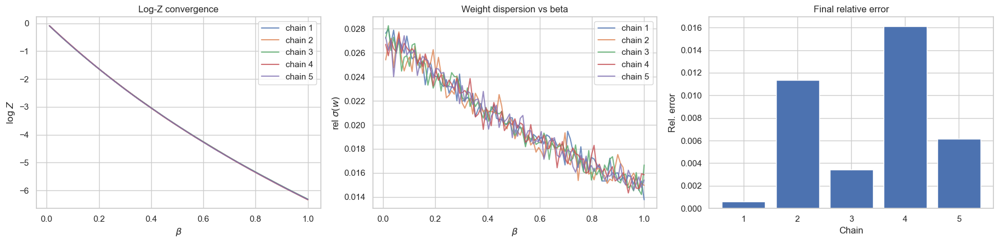

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.938e-02  | <w> mean = 9.1450e-01
[beta=0.020]  mean log rho = -8.805e-02  | <w> mean = 9.1572e-01
[beta=0.030]  mean log rho = -8.669e-02  | <w> mean = 9.1696e-01
[beta=0.040]  mean log rho = -8.733e-02  | <w> mean = 9.1638e-01
[beta=0.051]  mean log rho = -8.555e-02  | <w> mean = 9.1801e-01
[beta=0.061]  mean log rho = -8.568e-02  | <w> mean = 9.1789e-01
[beta=0.071]  mean log rho = -8.482e-02  | <w> mean = 9.1867e-01
[beta=0.081]  mean log rho = -8.494e-02  | <w> mean = 9.1857e-01
[beta=0.091]  mean log rho = -8.278e-02  | <w> mean = 9.2056e-01
[18:36:04] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.292e-02  | <w> mean = 9.2042e-01
[beta=0.111]  mean log rho = -8.131e-02  | <w> mean = 9.2191e-01
[beta=0.121]  mean log rho = -8.059e-02  | <w> mean = 9.2258e-01
[beta=0.131]  mean log rho = -8.075e-02  | <w> mean = 9.2243e-01
[beta=0.141]  mean log rho = -7.930e-02  | <w> mean = 9.2376e-01
[beta=0.152]  mean lo

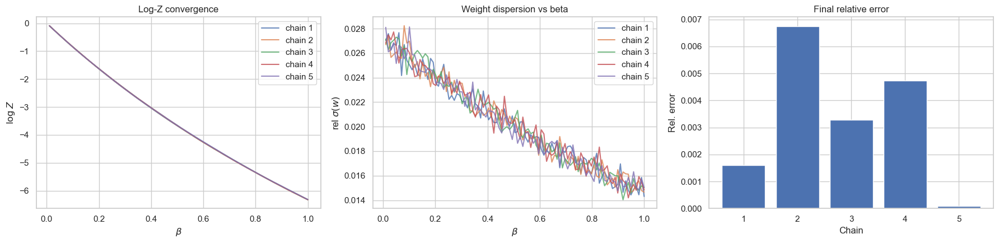

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.987e-02  | <w> mean = 9.1405e-01
[beta=0.020]  mean log rho = -8.856e-02  | <w> mean = 9.1525e-01
[beta=0.030]  mean log rho = -8.696e-02  | <w> mean = 9.1672e-01
[beta=0.040]  mean log rho = -8.640e-02  | <w> mean = 9.1723e-01
[beta=0.051]  mean log rho = -8.737e-02  | <w> mean = 9.1634e-01
[beta=0.061]  mean log rho = -8.540e-02  | <w> mean = 9.1815e-01
[beta=0.071]  mean log rho = -8.441e-02  | <w> mean = 9.1905e-01
[beta=0.081]  mean log rho = -8.453e-02  | <w> mean = 9.1894e-01
[beta=0.091]  mean log rho = -8.325e-02  | <w> mean = 9.2012e-01
[18:37:08] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.326e-02  | <w> mean = 9.2011e-01
[beta=0.111]  mean log rho = -8.194e-02  | <w> mean = 9.2133e-01
[beta=0.121]  mean log rho = -8.154e-02  | <w> mean = 9.2169e-01
[beta=0.131]  mean log rho = -8.073e-02  | <w> mean = 9.2244e-01
[beta=0.141]  mean log rho = -7.889e-02  | <w> mean = 9.2414e-01
[beta=0.152]  mean lo

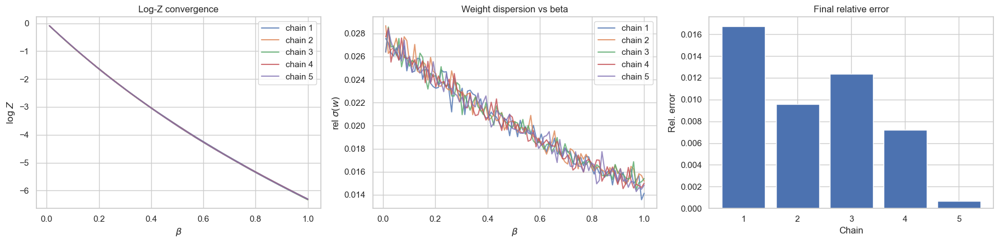

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.869e-02  | <w> mean = 9.1513e-01
[beta=0.020]  mean log rho = -8.892e-02  | <w> mean = 9.1492e-01
[beta=0.030]  mean log rho = -8.802e-02  | <w> mean = 9.1574e-01
[beta=0.040]  mean log rho = -8.603e-02  | <w> mean = 9.1756e-01
[beta=0.051]  mean log rho = -8.559e-02  | <w> mean = 9.1797e-01
[beta=0.061]  mean log rho = -8.550e-02  | <w> mean = 9.1806e-01
[beta=0.071]  mean log rho = -8.388e-02  | <w> mean = 9.1954e-01
[beta=0.081]  mean log rho = -8.416e-02  | <w> mean = 9.1928e-01
[beta=0.091]  mean log rho = -8.389e-02  | <w> mean = 9.1953e-01
[18:38:08] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.211e-02  | <w> mean = 9.2117e-01
[beta=0.111]  mean log rho = -8.270e-02  | <w> mean = 9.2063e-01
[beta=0.121]  mean log rho = -8.138e-02  | <w> mean = 9.2184e-01
[beta=0.131]  mean log rho = -7.945e-02  | <w> mean = 9.2363e-01
[beta=0.141]  mean log rho = -7.989e-02  | <w> mean = 9.2322e-01
[beta=0.152]  mean lo

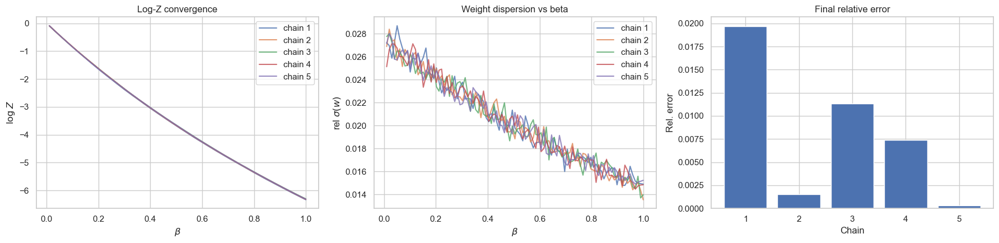

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.872e-02  | <w> mean = 9.1511e-01
[beta=0.020]  mean log rho = -8.851e-02  | <w> mean = 9.1529e-01
[beta=0.030]  mean log rho = -8.757e-02  | <w> mean = 9.1616e-01
[beta=0.040]  mean log rho = -8.746e-02  | <w> mean = 9.1625e-01
[beta=0.051]  mean log rho = -8.501e-02  | <w> mean = 9.1851e-01
[beta=0.061]  mean log rho = -8.547e-02  | <w> mean = 9.1808e-01
[beta=0.071]  mean log rho = -8.409e-02  | <w> mean = 9.1935e-01
[beta=0.081]  mean log rho = -8.399e-02  | <w> mean = 9.1944e-01
[beta=0.091]  mean log rho = -8.398e-02  | <w> mean = 9.1945e-01
[18:39:09] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.194e-02  | <w> mean = 9.2133e-01
[beta=0.111]  mean log rho = -8.196e-02  | <w> mean = 9.2131e-01
[beta=0.121]  mean log rho = -8.023e-02  | <w> mean = 9.2290e-01
[beta=0.131]  mean log rho = -7.997e-02  | <w> mean = 9.2314e-01
[beta=0.141]  mean log rho = -8.055e-02  | <w> mean = 9.2261e-01
[beta=0.152]  mean lo

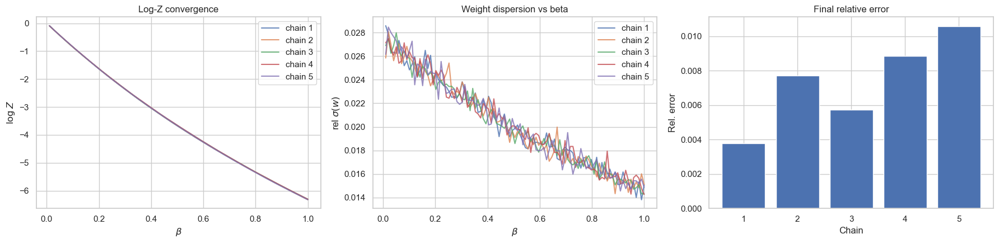


>>> Running 10000 iterations
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.845e-02  | <w> mean = 9.1535e-01
[beta=0.020]  mean log rho = -8.838e-02  | <w> mean = 9.1541e-01
[beta=0.030]  mean log rho = -8.834e-02  | <w> mean = 9.1545e-01
[beta=0.040]  mean log rho = -8.688e-02  | <w> mean = 9.1678e-01
[beta=0.051]  mean log rho = -8.669e-02  | <w> mean = 9.1697e-01
[beta=0.061]  mean log rho = -8.483e-02  | <w> mean = 9.1867e-01
[beta=0.071]  mean log rho = -8.496e-02  | <w> mean = 9.1855e-01
[beta=0.081]  mean log rho = -8.457e-02  | <w> mean = 9.1891e-01
[beta=0.091]  mean log rho = -8.284e-02  | <w> mean = 9.2050e-01
[18:40:16] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.195e-02  | <w> mean = 9.2132e-01
[beta=0.111]  mean log rho = -8.230e-02  | <w> mean = 9.2099e-01
[beta=0.121]  mean log rho = -8.132e-02  | <w> mean = 9.2190e-01
[beta=0.131]  mean log rho = -8.124e-02  | <w> mean = 9.2197e-01
[beta=0.141]  mean log rho = -8.008e-02  | <w> mean = 9.

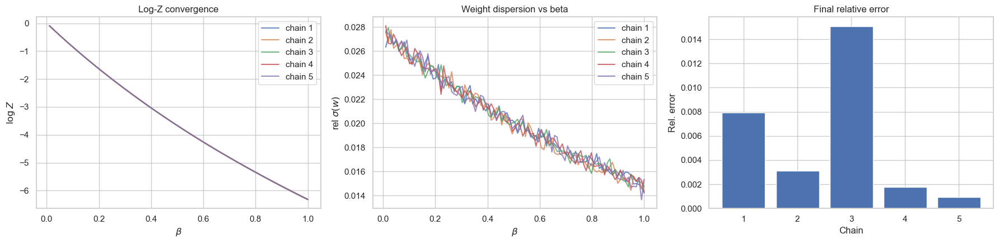

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.957e-02  | <w> mean = 9.1433e-01
[beta=0.020]  mean log rho = -8.878e-02  | <w> mean = 9.1505e-01
[beta=0.030]  mean log rho = -8.752e-02  | <w> mean = 9.1620e-01
[beta=0.040]  mean log rho = -8.702e-02  | <w> mean = 9.1666e-01
[beta=0.051]  mean log rho = -8.662e-02  | <w> mean = 9.1703e-01
[beta=0.061]  mean log rho = -8.519e-02  | <w> mean = 9.1833e-01
[beta=0.071]  mean log rho = -8.446e-02  | <w> mean = 9.1901e-01
[beta=0.081]  mean log rho = -8.390e-02  | <w> mean = 9.1953e-01
[beta=0.091]  mean log rho = -8.366e-02  | <w> mean = 9.1975e-01
[18:41:45] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.291e-02  | <w> mean = 9.2044e-01
[beta=0.111]  mean log rho = -8.178e-02  | <w> mean = 9.2147e-01
[beta=0.121]  mean log rho = -8.041e-02  | <w> mean = 9.2274e-01
[beta=0.131]  mean log rho = -8.013e-02  | <w> mean = 9.2300e-01
[beta=0.141]  mean log rho = -8.008e-02  | <w> mean = 9.2304e-01
[beta=0.152]  mean lo

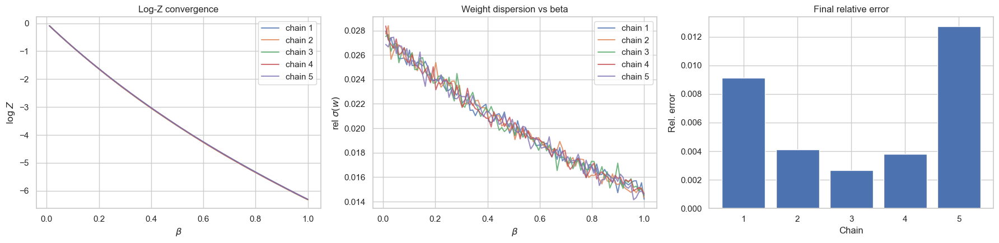

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.855e-02  | <w> mean = 9.1525e-01
[beta=0.020]  mean log rho = -8.795e-02  | <w> mean = 9.1580e-01
[beta=0.030]  mean log rho = -8.771e-02  | <w> mean = 9.1603e-01
[beta=0.040]  mean log rho = -8.683e-02  | <w> mean = 9.1684e-01
[beta=0.051]  mean log rho = -8.566e-02  | <w> mean = 9.1791e-01
[beta=0.061]  mean log rho = -8.512e-02  | <w> mean = 9.1840e-01
[beta=0.071]  mean log rho = -8.430e-02  | <w> mean = 9.1915e-01
[beta=0.081]  mean log rho = -8.345e-02  | <w> mean = 9.1994e-01
[beta=0.091]  mean log rho = -8.277e-02  | <w> mean = 9.2056e-01
[18:42:57] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.260e-02  | <w> mean = 9.2072e-01
[beta=0.111]  mean log rho = -8.281e-02  | <w> mean = 9.2052e-01
[beta=0.121]  mean log rho = -8.095e-02  | <w> mean = 9.2224e-01
[beta=0.131]  mean log rho = -8.093e-02  | <w> mean = 9.2226e-01
[beta=0.141]  mean log rho = -7.998e-02  | <w> mean = 9.2313e-01
[beta=0.152]  mean lo

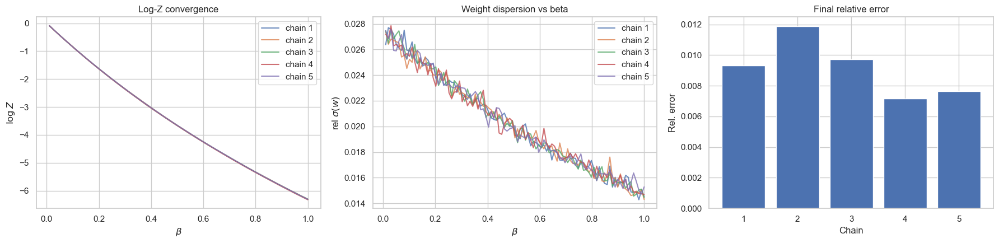

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.890e-02  | <w> mean = 9.1494e-01
[beta=0.020]  mean log rho = -8.813e-02  | <w> mean = 9.1565e-01
[beta=0.030]  mean log rho = -8.750e-02  | <w> mean = 9.1622e-01
[beta=0.040]  mean log rho = -8.680e-02  | <w> mean = 9.1686e-01
[beta=0.051]  mean log rho = -8.596e-02  | <w> mean = 9.1763e-01
[beta=0.061]  mean log rho = -8.534e-02  | <w> mean = 9.1820e-01
[beta=0.071]  mean log rho = -8.512e-02  | <w> mean = 9.1841e-01
[beta=0.081]  mean log rho = -8.430e-02  | <w> mean = 9.1915e-01
[beta=0.091]  mean log rho = -8.279e-02  | <w> mean = 9.2055e-01
[18:44:09] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.326e-02  | <w> mean = 9.2011e-01
[beta=0.111]  mean log rho = -8.115e-02  | <w> mean = 9.2206e-01
[beta=0.121]  mean log rho = -8.098e-02  | <w> mean = 9.2221e-01
[beta=0.131]  mean log rho = -8.069e-02  | <w> mean = 9.2248e-01
[beta=0.141]  mean log rho = -8.016e-02  | <w> mean = 9.2297e-01
[beta=0.152]  mean lo

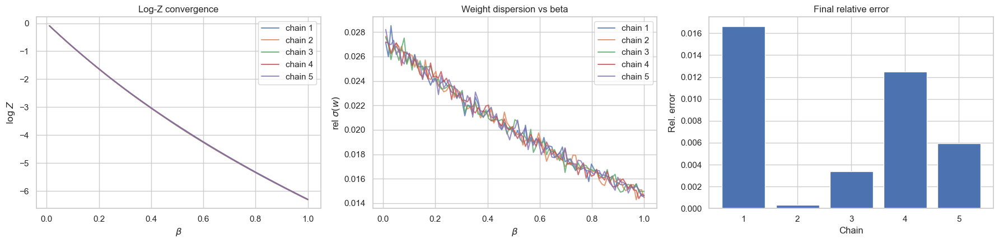

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.858e-02  | <w> mean = 9.1523e-01
[beta=0.020]  mean log rho = -8.789e-02  | <w> mean = 9.1586e-01
[beta=0.030]  mean log rho = -8.681e-02  | <w> mean = 9.1685e-01
[beta=0.040]  mean log rho = -8.657e-02  | <w> mean = 9.1707e-01
[beta=0.051]  mean log rho = -8.601e-02  | <w> mean = 9.1758e-01
[beta=0.061]  mean log rho = -8.536e-02  | <w> mean = 9.1818e-01
[beta=0.071]  mean log rho = -8.471e-02  | <w> mean = 9.1878e-01
[beta=0.081]  mean log rho = -8.398e-02  | <w> mean = 9.1945e-01
[beta=0.091]  mean log rho = -8.345e-02  | <w> mean = 9.1994e-01
[18:45:21] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.303e-02  | <w> mean = 9.2033e-01
[beta=0.111]  mean log rho = -8.225e-02  | <w> mean = 9.2104e-01
[beta=0.121]  mean log rho = -8.183e-02  | <w> mean = 9.2143e-01
[beta=0.131]  mean log rho = -8.009e-02  | <w> mean = 9.2304e-01
[beta=0.141]  mean log rho = -8.053e-02  | <w> mean = 9.2263e-01
[beta=0.152]  mean lo

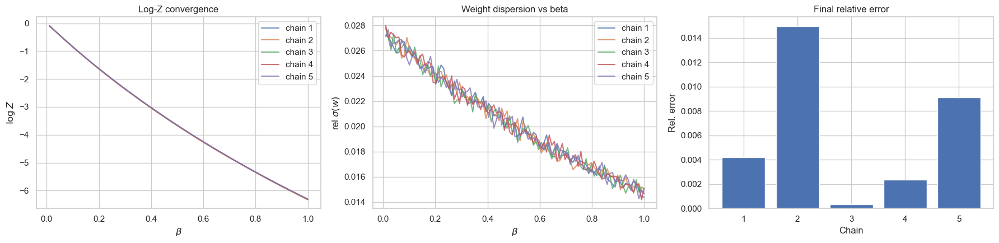

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.916e-02  | <w> mean = 9.1470e-01
[beta=0.020]  mean log rho = -8.891e-02  | <w> mean = 9.1493e-01
[beta=0.030]  mean log rho = -8.760e-02  | <w> mean = 9.1613e-01
[beta=0.040]  mean log rho = -8.694e-02  | <w> mean = 9.1674e-01
[beta=0.051]  mean log rho = -8.593e-02  | <w> mean = 9.1766e-01
[beta=0.061]  mean log rho = -8.561e-02  | <w> mean = 9.1796e-01
[beta=0.071]  mean log rho = -8.419e-02  | <w> mean = 9.1926e-01
[beta=0.081]  mean log rho = -8.380e-02  | <w> mean = 9.1962e-01
[beta=0.091]  mean log rho = -8.354e-02  | <w> mean = 9.1986e-01
[18:46:32] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.253e-02  | <w> mean = 9.2078e-01
[beta=0.111]  mean log rho = -8.136e-02  | <w> mean = 9.2186e-01
[beta=0.121]  mean log rho = -8.093e-02  | <w> mean = 9.2226e-01
[beta=0.131]  mean log rho = -8.133e-02  | <w> mean = 9.2189e-01
[beta=0.141]  mean log rho = -7.981e-02  | <w> mean = 9.2329e-01
[beta=0.152]  mean lo

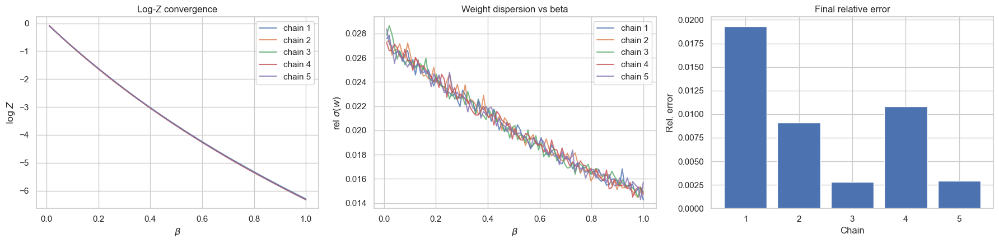

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.889e-02  | <w> mean = 9.1495e-01
[beta=0.020]  mean log rho = -8.786e-02  | <w> mean = 9.1589e-01
[beta=0.030]  mean log rho = -8.741e-02  | <w> mean = 9.1631e-01
[beta=0.040]  mean log rho = -8.619e-02  | <w> mean = 9.1742e-01
[beta=0.051]  mean log rho = -8.588e-02  | <w> mean = 9.1770e-01
[beta=0.061]  mean log rho = -8.470e-02  | <w> mean = 9.1879e-01
[beta=0.071]  mean log rho = -8.486e-02  | <w> mean = 9.1864e-01
[beta=0.081]  mean log rho = -8.378e-02  | <w> mean = 9.1963e-01
[beta=0.091]  mean log rho = -8.315e-02  | <w> mean = 9.2021e-01
[18:47:44] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.243e-02  | <w> mean = 9.2088e-01
[beta=0.111]  mean log rho = -8.161e-02  | <w> mean = 9.2163e-01
[beta=0.121]  mean log rho = -8.111e-02  | <w> mean = 9.2209e-01
[beta=0.131]  mean log rho = -8.066e-02  | <w> mean = 9.2251e-01
[beta=0.141]  mean log rho = -7.963e-02  | <w> mean = 9.2346e-01
[beta=0.152]  mean lo

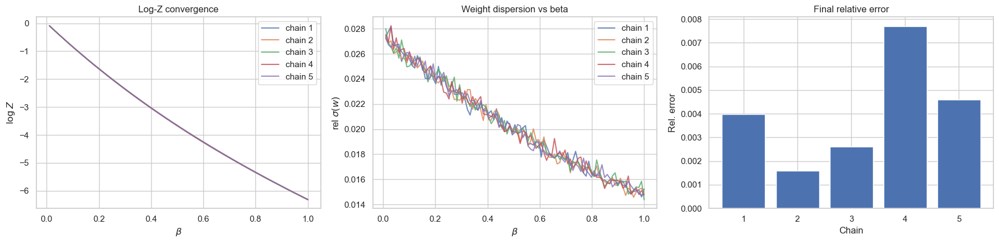

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.914e-02  | <w> mean = 9.1472e-01
[beta=0.020]  mean log rho = -8.839e-02  | <w> mean = 9.1541e-01
[beta=0.030]  mean log rho = -8.683e-02  | <w> mean = 9.1683e-01
[beta=0.040]  mean log rho = -8.657e-02  | <w> mean = 9.1708e-01
[beta=0.051]  mean log rho = -8.619e-02  | <w> mean = 9.1742e-01
[beta=0.061]  mean log rho = -8.519e-02  | <w> mean = 9.1834e-01
[beta=0.071]  mean log rho = -8.418e-02  | <w> mean = 9.1927e-01
[beta=0.081]  mean log rho = -8.337e-02  | <w> mean = 9.2001e-01
[beta=0.091]  mean log rho = -8.249e-02  | <w> mean = 9.2082e-01
[18:48:56] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.243e-02  | <w> mean = 9.2087e-01
[beta=0.111]  mean log rho = -8.183e-02  | <w> mean = 9.2143e-01
[beta=0.121]  mean log rho = -8.110e-02  | <w> mean = 9.2210e-01
[beta=0.131]  mean log rho = -8.087e-02  | <w> mean = 9.2232e-01
[beta=0.141]  mean log rho = -7.989e-02  | <w> mean = 9.2322e-01
[beta=0.152]  mean lo

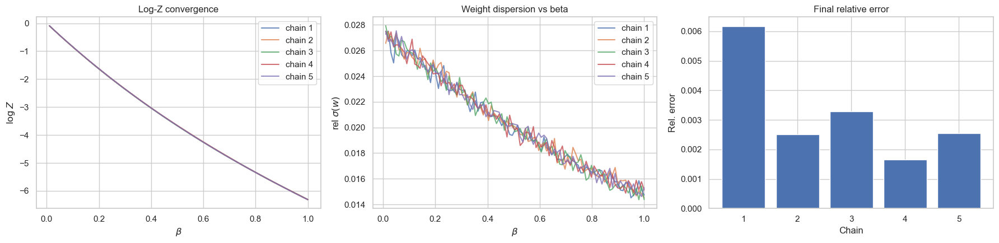

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.913e-02  | <w> mean = 9.1472e-01
[beta=0.020]  mean log rho = -8.842e-02  | <w> mean = 9.1538e-01
[beta=0.030]  mean log rho = -8.822e-02  | <w> mean = 9.1556e-01
[beta=0.040]  mean log rho = -8.626e-02  | <w> mean = 9.1736e-01
[beta=0.051]  mean log rho = -8.593e-02  | <w> mean = 9.1765e-01
[beta=0.061]  mean log rho = -8.477e-02  | <w> mean = 9.1873e-01
[beta=0.071]  mean log rho = -8.434e-02  | <w> mean = 9.1912e-01
[beta=0.081]  mean log rho = -8.331e-02  | <w> mean = 9.2007e-01
[beta=0.091]  mean log rho = -8.361e-02  | <w> mean = 9.1979e-01
[18:50:08] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.202e-02  | <w> mean = 9.2125e-01
[beta=0.111]  mean log rho = -8.198e-02  | <w> mean = 9.2129e-01
[beta=0.121]  mean log rho = -8.108e-02  | <w> mean = 9.2212e-01
[beta=0.131]  mean log rho = -8.053e-02  | <w> mean = 9.2263e-01
[beta=0.141]  mean log rho = -8.017e-02  | <w> mean = 9.2296e-01
[beta=0.152]  mean lo

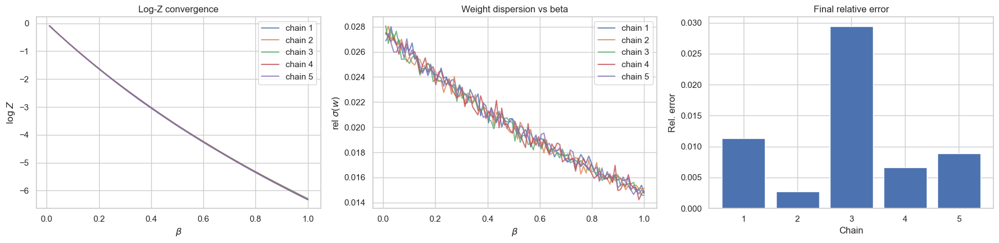

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.925e-02  | <w> mean = 9.1462e-01
[beta=0.020]  mean log rho = -8.775e-02  | <w> mean = 9.1599e-01
[beta=0.030]  mean log rho = -8.696e-02  | <w> mean = 9.1672e-01
[beta=0.040]  mean log rho = -8.717e-02  | <w> mean = 9.1652e-01
[beta=0.051]  mean log rho = -8.541e-02  | <w> mean = 9.1814e-01
[beta=0.061]  mean log rho = -8.498e-02  | <w> mean = 9.1853e-01
[beta=0.071]  mean log rho = -8.511e-02  | <w> mean = 9.1841e-01
[beta=0.081]  mean log rho = -8.366e-02  | <w> mean = 9.1975e-01
[beta=0.091]  mean log rho = -8.400e-02  | <w> mean = 9.1943e-01
[18:51:20] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.217e-02  | <w> mean = 9.2111e-01
[beta=0.111]  mean log rho = -8.149e-02  | <w> mean = 9.2174e-01
[beta=0.121]  mean log rho = -8.128e-02  | <w> mean = 9.2194e-01
[beta=0.131]  mean log rho = -8.132e-02  | <w> mean = 9.2190e-01
[beta=0.141]  mean log rho = -7.961e-02  | <w> mean = 9.2348e-01
[beta=0.152]  mean lo

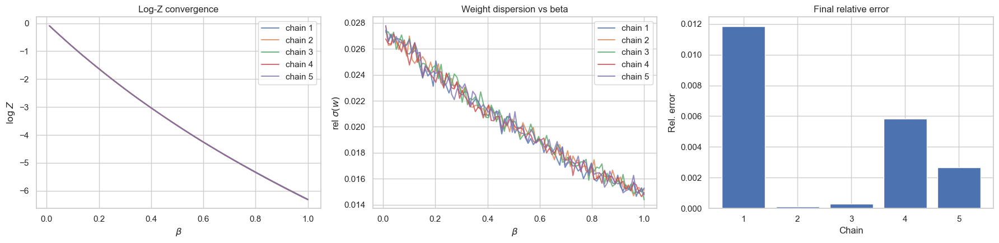


>>> Running 20000 iterations
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.911e-02  | <w> mean = 9.1474e-01
[beta=0.020]  mean log rho = -8.846e-02  | <w> mean = 9.1534e-01
[beta=0.030]  mean log rho = -8.764e-02  | <w> mean = 9.1609e-01
[beta=0.040]  mean log rho = -8.702e-02  | <w> mean = 9.1666e-01
[beta=0.051]  mean log rho = -8.549e-02  | <w> mean = 9.1806e-01
[beta=0.061]  mean log rho = -8.604e-02  | <w> mean = 9.1756e-01
[beta=0.071]  mean log rho = -8.422e-02  | <w> mean = 9.1923e-01
[beta=0.081]  mean log rho = -8.381e-02  | <w> mean = 9.1960e-01
[beta=0.091]  mean log rho = -8.306e-02  | <w> mean = 9.2030e-01
[18:52:39] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.313e-02  | <w> mean = 9.2023e-01
[beta=0.111]  mean log rho = -8.183e-02  | <w> mean = 9.2143e-01
[beta=0.121]  mean log rho = -8.117e-02  | <w> mean = 9.2203e-01
[beta=0.131]  mean log rho = -8.029e-02  | <w> mean = 9.2284e-01
[beta=0.141]  mean log rho = -8.014e-02  | <w> mean = 9.

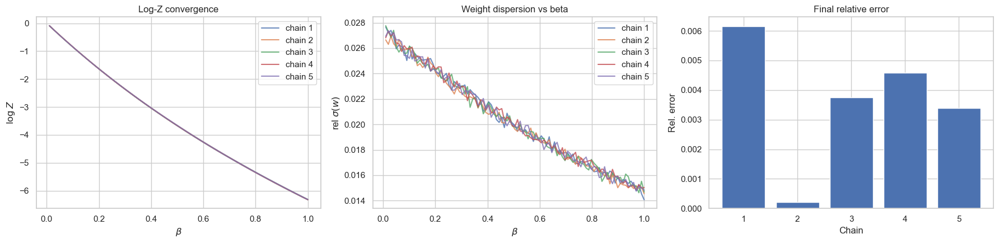

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.939e-02  | <w> mean = 9.1449e-01
[beta=0.020]  mean log rho = -8.883e-02  | <w> mean = 9.1500e-01
[beta=0.030]  mean log rho = -8.737e-02  | <w> mean = 9.1633e-01
[beta=0.040]  mean log rho = -8.670e-02  | <w> mean = 9.1695e-01
[beta=0.051]  mean log rho = -8.623e-02  | <w> mean = 9.1738e-01
[beta=0.061]  mean log rho = -8.513e-02  | <w> mean = 9.1839e-01
[beta=0.071]  mean log rho = -8.429e-02  | <w> mean = 9.1916e-01
[beta=0.081]  mean log rho = -8.474e-02  | <w> mean = 9.1875e-01
[beta=0.091]  mean log rho = -8.341e-02  | <w> mean = 9.1997e-01
[18:55:06] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.273e-02  | <w> mean = 9.2060e-01
[beta=0.111]  mean log rho = -8.197e-02  | <w> mean = 9.2130e-01
[beta=0.121]  mean log rho = -8.149e-02  | <w> mean = 9.2174e-01
[beta=0.131]  mean log rho = -8.049e-02  | <w> mean = 9.2266e-01
[beta=0.141]  mean log rho = -8.016e-02  | <w> mean = 9.2296e-01
[beta=0.152]  mean lo

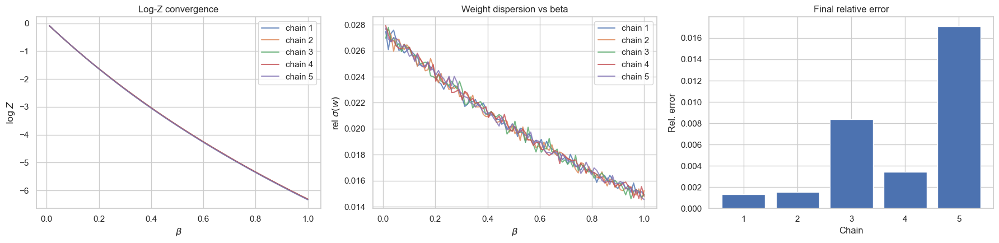

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.891e-02  | <w> mean = 9.1493e-01
[beta=0.020]  mean log rho = -8.817e-02  | <w> mean = 9.1561e-01
[beta=0.030]  mean log rho = -8.753e-02  | <w> mean = 9.1619e-01
[beta=0.040]  mean log rho = -8.690e-02  | <w> mean = 9.1677e-01
[beta=0.051]  mean log rho = -8.589e-02  | <w> mean = 9.1769e-01
[beta=0.061]  mean log rho = -8.491e-02  | <w> mean = 9.1860e-01
[beta=0.071]  mean log rho = -8.496e-02  | <w> mean = 9.1855e-01
[beta=0.081]  mean log rho = -8.419e-02  | <w> mean = 9.1926e-01
[beta=0.091]  mean log rho = -8.322e-02  | <w> mean = 9.2015e-01
[18:57:32] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.301e-02  | <w> mean = 9.2034e-01
[beta=0.111]  mean log rho = -8.183e-02  | <w> mean = 9.2143e-01
[beta=0.121]  mean log rho = -8.152e-02  | <w> mean = 9.2171e-01
[beta=0.131]  mean log rho = -8.047e-02  | <w> mean = 9.2269e-01
[beta=0.141]  mean log rho = -7.937e-02  | <w> mean = 9.2370e-01
[beta=0.152]  mean lo

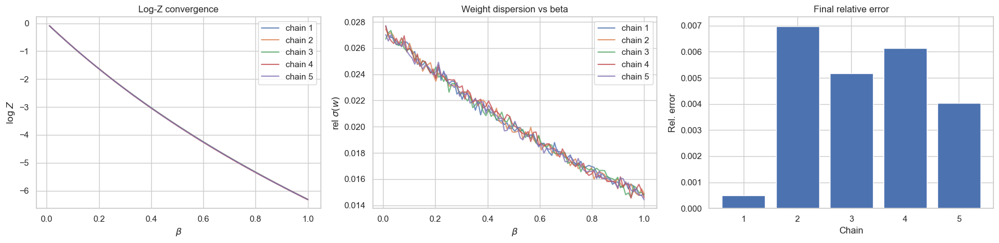

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.897e-02  | <w> mean = 9.1487e-01
[beta=0.020]  mean log rho = -8.811e-02  | <w> mean = 9.1566e-01
[beta=0.030]  mean log rho = -8.761e-02  | <w> mean = 9.1612e-01
[beta=0.040]  mean log rho = -8.708e-02  | <w> mean = 9.1661e-01
[beta=0.051]  mean log rho = -8.585e-02  | <w> mean = 9.1773e-01
[beta=0.061]  mean log rho = -8.553e-02  | <w> mean = 9.1803e-01
[beta=0.071]  mean log rho = -8.447e-02  | <w> mean = 9.1900e-01
[beta=0.081]  mean log rho = -8.367e-02  | <w> mean = 9.1973e-01
[beta=0.091]  mean log rho = -8.323e-02  | <w> mean = 9.2014e-01
[18:59:59] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.215e-02  | <w> mean = 9.2114e-01
[beta=0.111]  mean log rho = -8.221e-02  | <w> mean = 9.2108e-01
[beta=0.121]  mean log rho = -8.173e-02  | <w> mean = 9.2152e-01
[beta=0.131]  mean log rho = -8.077e-02  | <w> mean = 9.2241e-01
[beta=0.141]  mean log rho = -7.997e-02  | <w> mean = 9.2314e-01
[beta=0.152]  mean lo

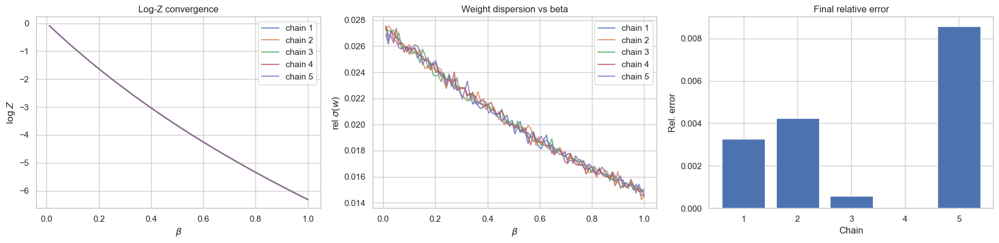

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.903e-02  | <w> mean = 9.1482e-01
[beta=0.020]  mean log rho = -8.922e-02  | <w> mean = 9.1465e-01
[beta=0.030]  mean log rho = -8.747e-02  | <w> mean = 9.1625e-01
[beta=0.040]  mean log rho = -8.696e-02  | <w> mean = 9.1671e-01
[beta=0.051]  mean log rho = -8.586e-02  | <w> mean = 9.1773e-01
[beta=0.061]  mean log rho = -8.537e-02  | <w> mean = 9.1817e-01
[beta=0.071]  mean log rho = -8.476e-02  | <w> mean = 9.1873e-01
[beta=0.081]  mean log rho = -8.381e-02  | <w> mean = 9.1961e-01
[beta=0.091]  mean log rho = -8.353e-02  | <w> mean = 9.1986e-01
[19:02:25] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.314e-02  | <w> mean = 9.2023e-01
[beta=0.111]  mean log rho = -8.205e-02  | <w> mean = 9.2123e-01
[beta=0.121]  mean log rho = -8.105e-02  | <w> mean = 9.2214e-01
[beta=0.131]  mean log rho = -8.116e-02  | <w> mean = 9.2204e-01
[beta=0.141]  mean log rho = -7.976e-02  | <w> mean = 9.2333e-01
[beta=0.152]  mean lo

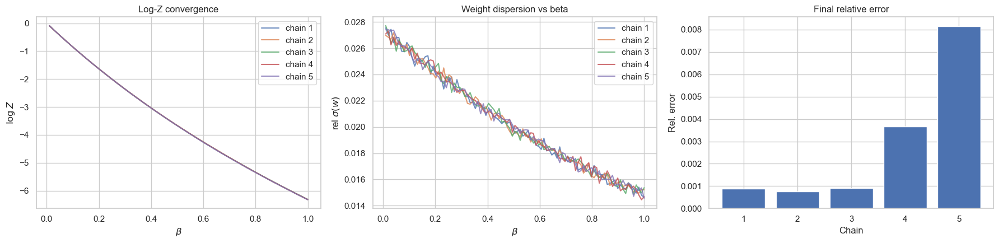

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.836e-02  | <w> mean = 9.1543e-01
[beta=0.020]  mean log rho = -8.767e-02  | <w> mean = 9.1607e-01
[beta=0.030]  mean log rho = -8.750e-02  | <w> mean = 9.1622e-01
[beta=0.040]  mean log rho = -8.706e-02  | <w> mean = 9.1663e-01
[beta=0.051]  mean log rho = -8.578e-02  | <w> mean = 9.1780e-01
[beta=0.061]  mean log rho = -8.562e-02  | <w> mean = 9.1794e-01
[beta=0.071]  mean log rho = -8.477e-02  | <w> mean = 9.1872e-01
[beta=0.081]  mean log rho = -8.385e-02  | <w> mean = 9.1957e-01
[beta=0.091]  mean log rho = -8.335e-02  | <w> mean = 9.2003e-01
[19:04:51] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.266e-02  | <w> mean = 9.2066e-01
[beta=0.111]  mean log rho = -8.194e-02  | <w> mean = 9.2133e-01
[beta=0.121]  mean log rho = -8.118e-02  | <w> mean = 9.2203e-01
[beta=0.131]  mean log rho = -8.007e-02  | <w> mean = 9.2305e-01
[beta=0.141]  mean log rho = -8.054e-02  | <w> mean = 9.2261e-01
[beta=0.152]  mean lo

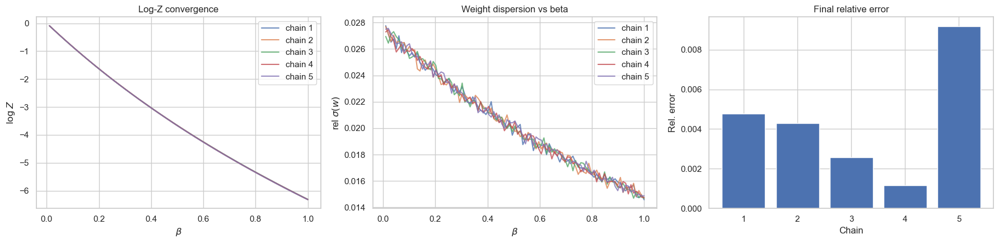

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.926e-02  | <w> mean = 9.1461e-01
[beta=0.020]  mean log rho = -8.842e-02  | <w> mean = 9.1537e-01
[beta=0.030]  mean log rho = -8.740e-02  | <w> mean = 9.1631e-01
[beta=0.040]  mean log rho = -8.704e-02  | <w> mean = 9.1664e-01
[beta=0.051]  mean log rho = -8.638e-02  | <w> mean = 9.1725e-01
[beta=0.061]  mean log rho = -8.548e-02  | <w> mean = 9.1807e-01
[beta=0.071]  mean log rho = -8.519e-02  | <w> mean = 9.1833e-01
[beta=0.081]  mean log rho = -8.405e-02  | <w> mean = 9.1939e-01
[beta=0.091]  mean log rho = -8.332e-02  | <w> mean = 9.2006e-01
[19:07:17] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.237e-02  | <w> mean = 9.2093e-01
[beta=0.111]  mean log rho = -8.189e-02  | <w> mean = 9.2137e-01
[beta=0.121]  mean log rho = -8.138e-02  | <w> mean = 9.2185e-01
[beta=0.131]  mean log rho = -8.075e-02  | <w> mean = 9.2242e-01
[beta=0.141]  mean log rho = -8.003e-02  | <w> mean = 9.2308e-01
[beta=0.152]  mean lo

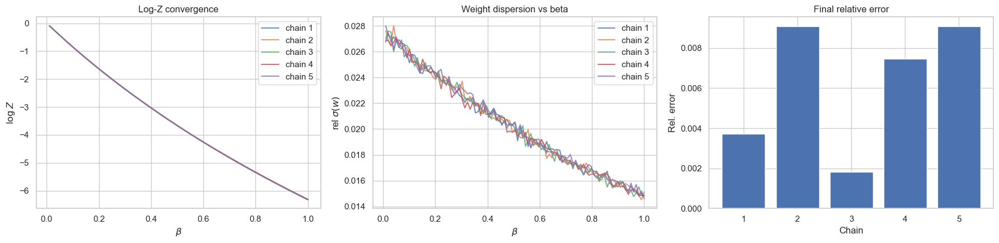

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.884e-02  | <w> mean = 9.1499e-01
[beta=0.020]  mean log rho = -8.771e-02  | <w> mean = 9.1602e-01
[beta=0.030]  mean log rho = -8.760e-02  | <w> mean = 9.1613e-01
[beta=0.040]  mean log rho = -8.701e-02  | <w> mean = 9.1667e-01
[beta=0.051]  mean log rho = -8.618e-02  | <w> mean = 9.1743e-01
[beta=0.061]  mean log rho = -8.556e-02  | <w> mean = 9.1800e-01
[beta=0.071]  mean log rho = -8.423e-02  | <w> mean = 9.1922e-01
[beta=0.081]  mean log rho = -8.391e-02  | <w> mean = 9.1951e-01
[beta=0.091]  mean log rho = -8.334e-02  | <w> mean = 9.2004e-01
[19:09:43] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.271e-02  | <w> mean = 9.2062e-01
[beta=0.111]  mean log rho = -8.227e-02  | <w> mean = 9.2102e-01
[beta=0.121]  mean log rho = -8.098e-02  | <w> mean = 9.2221e-01
[beta=0.131]  mean log rho = -8.121e-02  | <w> mean = 9.2200e-01
[beta=0.141]  mean log rho = -7.979e-02  | <w> mean = 9.2331e-01
[beta=0.152]  mean lo

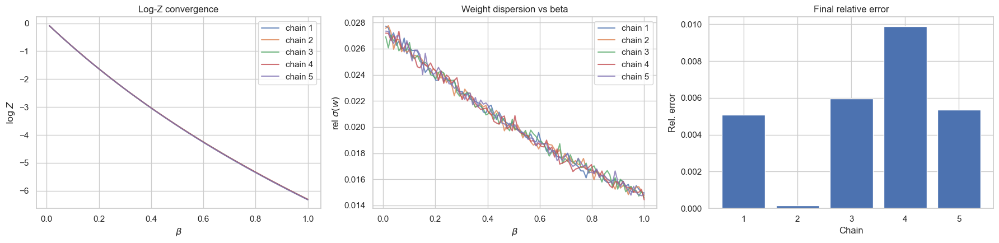

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.901e-02  | <w> mean = 9.1484e-01
[beta=0.020]  mean log rho = -8.813e-02  | <w> mean = 9.1564e-01
[beta=0.030]  mean log rho = -8.759e-02  | <w> mean = 9.1614e-01
[beta=0.040]  mean log rho = -8.670e-02  | <w> mean = 9.1696e-01
[beta=0.051]  mean log rho = -8.622e-02  | <w> mean = 9.1740e-01
[beta=0.061]  mean log rho = -8.540e-02  | <w> mean = 9.1815e-01
[beta=0.071]  mean log rho = -8.432e-02  | <w> mean = 9.1914e-01
[beta=0.081]  mean log rho = -8.370e-02  | <w> mean = 9.1971e-01
[beta=0.091]  mean log rho = -8.317e-02  | <w> mean = 9.2019e-01
[19:12:09] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.277e-02  | <w> mean = 9.2056e-01
[beta=0.111]  mean log rho = -8.215e-02  | <w> mean = 9.2114e-01
[beta=0.121]  mean log rho = -8.101e-02  | <w> mean = 9.2218e-01
[beta=0.131]  mean log rho = -8.073e-02  | <w> mean = 9.2244e-01
[beta=0.141]  mean log rho = -8.051e-02  | <w> mean = 9.2264e-01
[beta=0.152]  mean lo

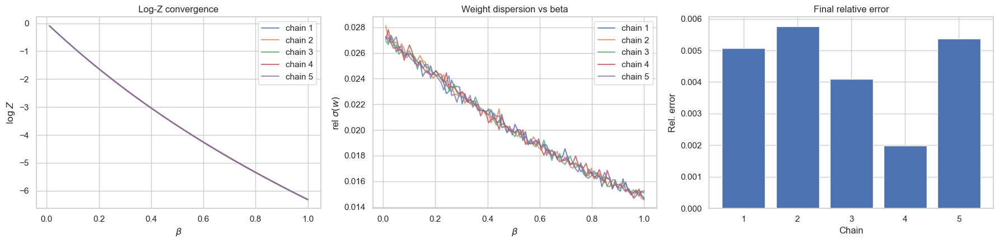

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.902e-02  | <w> mean = 9.1483e-01
[beta=0.020]  mean log rho = -8.800e-02  | <w> mean = 9.1576e-01
[beta=0.030]  mean log rho = -8.717e-02  | <w> mean = 9.1652e-01
[beta=0.040]  mean log rho = -8.674e-02  | <w> mean = 9.1692e-01
[beta=0.051]  mean log rho = -8.613e-02  | <w> mean = 9.1748e-01
[beta=0.061]  mean log rho = -8.511e-02  | <w> mean = 9.1841e-01
[beta=0.071]  mean log rho = -8.464e-02  | <w> mean = 9.1885e-01
[beta=0.081]  mean log rho = -8.376e-02  | <w> mean = 9.1965e-01
[beta=0.091]  mean log rho = -8.348e-02  | <w> mean = 9.1991e-01
[19:14:34] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.300e-02  | <w> mean = 9.2035e-01
[beta=0.111]  mean log rho = -8.184e-02  | <w> mean = 9.2142e-01
[beta=0.121]  mean log rho = -8.121e-02  | <w> mean = 9.2200e-01
[beta=0.131]  mean log rho = -8.048e-02  | <w> mean = 9.2267e-01
[beta=0.141]  mean log rho = -8.044e-02  | <w> mean = 9.2271e-01
[beta=0.152]  mean lo

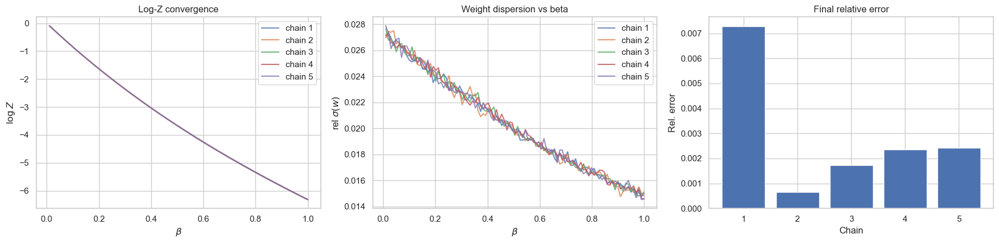

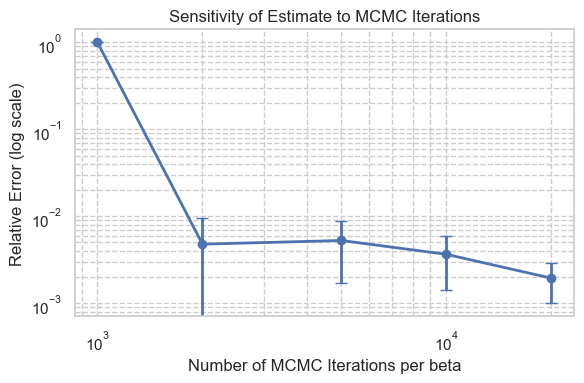

 Iterations  Mean Relative Error  Std Relative Error    Mean Ẑ   Std Ẑ
       1000             1.000000            0.000000   0.000000 0.000000
       2000             0.004777            0.004843 961.898041 6.543435
       5000             0.005268            0.003573 962.885464 6.041556
      10000             0.003654            0.002241 964.030375 3.524408
      20000             0.001942            0.000941 960.643260 1.659124


,Iterations,Mean Relative Error,Std Relative Error,Mean Ẑ,Std Ẑ
0,1000,1.000000,0.000000,0.000000,0.000000
1,2000,0.004777,0.004843,961.898041,6.543435
2,5000,0.005268,0.003573,962.885464,6.041556
3,10000,0.003654,0.002241,964.030375,3.524408
4,20000,0.001942,0.000941,960.643260,1.659124


In [6]:
sensitivity_iters()


>>> Building Tensor Network

>>> Running with 10 beta steps
Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.068e+00  | <w> mean = 3.4382e-01
[beta=0.222]  mean log rho = -9.853e-01  | <w> mean = 3.7333e-01
[beta=0.333]  mean log rho = -8.885e-01  | <w> mean = 4.1134e-01
[beta=0.444]  mean log rho = -8.254e-01  | <w> mean = 4.3807e-01
[beta=0.556]  mean log rho = -7.561e-01  | <w> mean = 4.6953e-01
[beta=0.667]  mean log rho = -6.873e-01  | <w> mean = 5.0294e-01
[beta=0.778]  mean log rho = -6.352e-01  | <w> mean = 5.2989e-01
[beta=0.889]  mean log rho = -5.948e-01  | <w> mean = 5.5169e-01
[19:16:52] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.495e-01  | <w> mean = 5.7725e-01
True  Z   : 490.140765
Mean  Ẑ  : 489.710333  ± 11.088058
Mean rel error: 2.08%
\nFinal relative variance of $\hat Z$: 2.2642e-02


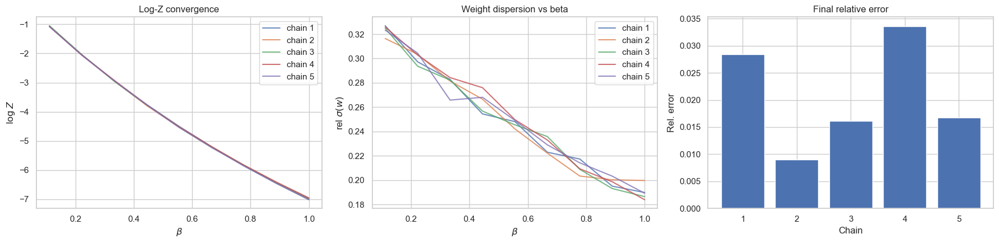

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.066e+00  | <w> mean = 3.4453e-01
[beta=0.222]  mean log rho = -9.888e-01  | <w> mean = 3.7205e-01
[beta=0.333]  mean log rho = -8.871e-01  | <w> mean = 4.1185e-01
[beta=0.444]  mean log rho = -8.101e-01  | <w> mean = 4.4485e-01
[beta=0.556]  mean log rho = -7.533e-01  | <w> mean = 4.7082e-01
[beta=0.667]  mean log rho = -6.873e-01  | <w> mean = 5.0295e-01
[beta=0.778]  mean log rho = -6.332e-01  | <w> mean = 5.3093e-01
[beta=0.889]  mean log rho = -5.892e-01  | <w> mean = 5.5481e-01
[19:16:59] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.633e-01  | <w> mean = 5.6935e-01
True  Z   : 490.140765
Mean  Ẑ  : 495.756010  ± 19.175657
Mean rel error: 2.61%
\nFinal relative variance of $\hat Z$: 3.8680e-02


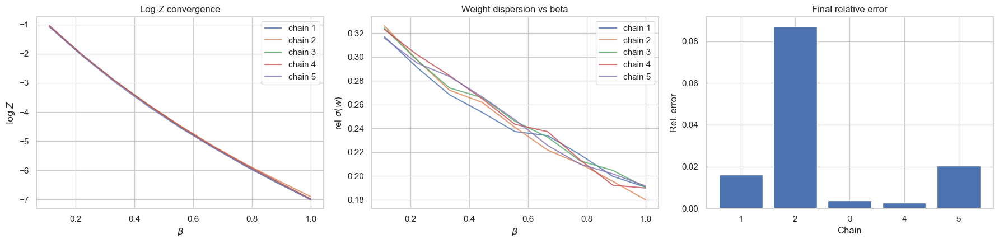

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.067e+00  | <w> mean = 3.4422e-01
[beta=0.222]  mean log rho = -9.719e-01  | <w> mean = 3.7842e-01
[beta=0.333]  mean log rho = -8.855e-01  | <w> mean = 4.1250e-01
[beta=0.444]  mean log rho = -8.152e-01  | <w> mean = 4.4256e-01
[beta=0.556]  mean log rho = -7.520e-01  | <w> mean = 4.7148e-01
[beta=0.667]  mean log rho = -6.935e-01  | <w> mean = 4.9986e-01
[beta=0.778]  mean log rho = -6.415e-01  | <w> mean = 5.2653e-01
[beta=0.889]  mean log rho = -5.952e-01  | <w> mean = 5.5148e-01
[19:17:05] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.606e-01  | <w> mean = 5.7087e-01
True  Z   : 490.140765
Mean  Ẑ  : 493.739064  ± 15.536481
Mean rel error: 2.84%
\nFinal relative variance of $\hat Z$: 3.1467e-02


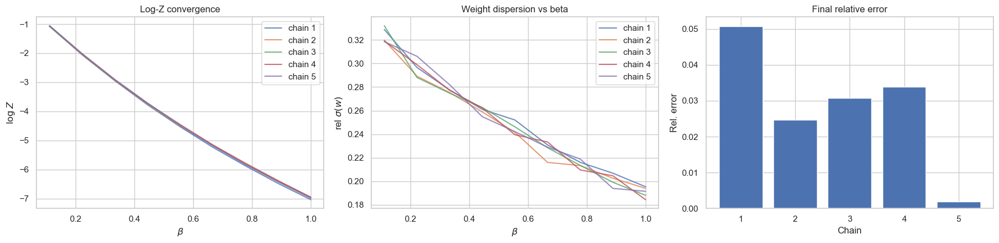

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.073e+00  | <w> mean = 3.4201e-01
[beta=0.222]  mean log rho = -9.759e-01  | <w> mean = 3.7690e-01
[beta=0.333]  mean log rho = -8.903e-01  | <w> mean = 4.1058e-01
[beta=0.444]  mean log rho = -8.162e-01  | <w> mean = 4.4212e-01
[beta=0.556]  mean log rho = -7.496e-01  | <w> mean = 4.7258e-01
[beta=0.667]  mean log rho = -6.943e-01  | <w> mean = 4.9944e-01
[beta=0.778]  mean log rho = -6.336e-01  | <w> mean = 5.3070e-01
[beta=0.889]  mean log rho = -5.959e-01  | <w> mean = 5.5107e-01
[19:17:12] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.582e-01  | <w> mean = 5.7225e-01
True  Z   : 490.140765
Mean  Ẑ  : 491.106612  ± 11.715162
Mean rel error: 2.16%
\nFinal relative variance of $\hat Z$: 2.3855e-02


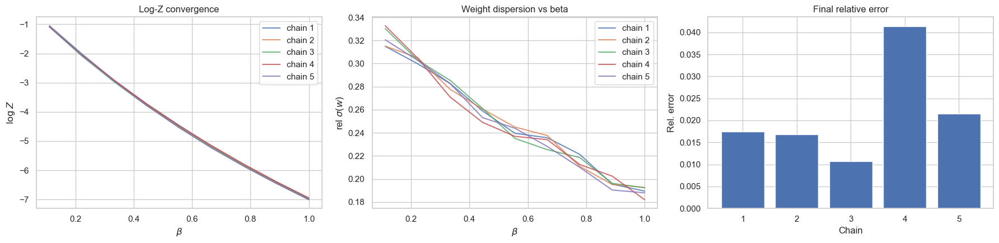

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.081e+00  | <w> mean = 3.3917e-01
[beta=0.222]  mean log rho = -9.784e-01  | <w> mean = 3.7594e-01
[beta=0.333]  mean log rho = -8.820e-01  | <w> mean = 4.1397e-01
[beta=0.444]  mean log rho = -8.069e-01  | <w> mean = 4.4626e-01
[beta=0.556]  mean log rho = -7.487e-01  | <w> mean = 4.7299e-01
[beta=0.667]  mean log rho = -6.986e-01  | <w> mean = 4.9735e-01
[beta=0.778]  mean log rho = -6.391e-01  | <w> mean = 5.2780e-01
[beta=0.889]  mean log rho = -6.014e-01  | <w> mean = 5.4809e-01
[19:17:19] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.544e-01  | <w> mean = 5.7441e-01
True  Z   : 490.140765
Mean  Ẑ  : 489.378231  ± 16.170621
Mean rel error: 2.66%
\nFinal relative variance of $\hat Z$: 3.3043e-02


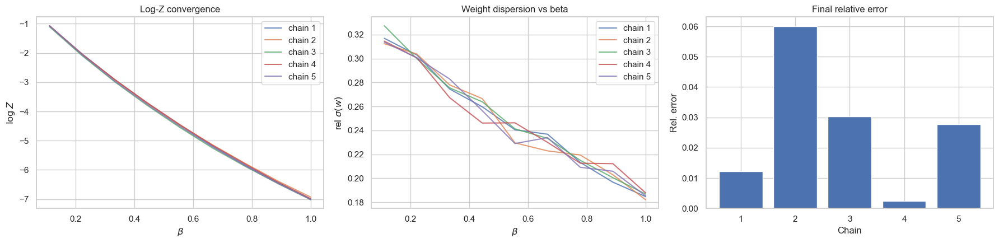

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.075e+00  | <w> mean = 3.4139e-01
[beta=0.222]  mean log rho = -9.810e-01  | <w> mean = 3.7493e-01
[beta=0.333]  mean log rho = -8.939e-01  | <w> mean = 4.0911e-01
[beta=0.444]  mean log rho = -8.179e-01  | <w> mean = 4.4134e-01
[beta=0.556]  mean log rho = -7.596e-01  | <w> mean = 4.6784e-01
[beta=0.667]  mean log rho = -6.906e-01  | <w> mean = 5.0130e-01
[beta=0.778]  mean log rho = -6.424e-01  | <w> mean = 5.2606e-01
[beta=0.889]  mean log rho = -5.973e-01  | <w> mean = 5.5034e-01
[19:17:25] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.533e-01  | <w> mean = 5.7507e-01
True  Z   : 490.140765
Mean  Ẑ  : 479.523869  ± 12.960593
Mean rel error: 2.41%
\nFinal relative variance of $\hat Z$: 2.7028e-02


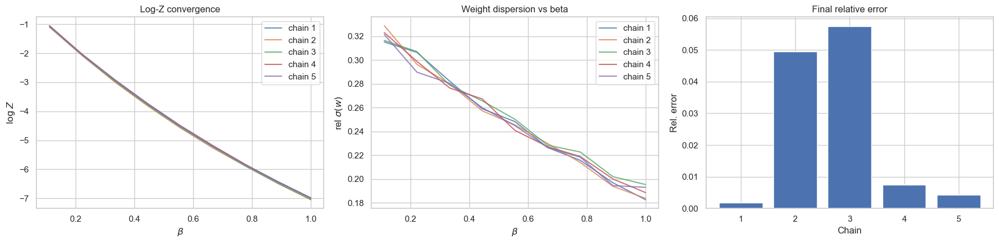

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.075e+00  | <w> mean = 3.4137e-01
[beta=0.222]  mean log rho = -9.728e-01  | <w> mean = 3.7805e-01
[beta=0.333]  mean log rho = -8.874e-01  | <w> mean = 4.1176e-01
[beta=0.444]  mean log rho = -8.165e-01  | <w> mean = 4.4198e-01
[beta=0.556]  mean log rho = -7.488e-01  | <w> mean = 4.7305e-01
[beta=0.667]  mean log rho = -6.981e-01  | <w> mean = 4.9755e-01
[beta=0.778]  mean log rho = -6.397e-01  | <w> mean = 5.2747e-01
[beta=0.889]  mean log rho = -5.961e-01  | <w> mean = 5.5095e-01
[19:17:32] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.562e-01  | <w> mean = 5.7343e-01
True  Z   : 490.140765
Mean  Ẑ  : 489.781990  ± 20.866643
Mean rel error: 4.09%
\nFinal relative variance of $\hat Z$: 4.2604e-02


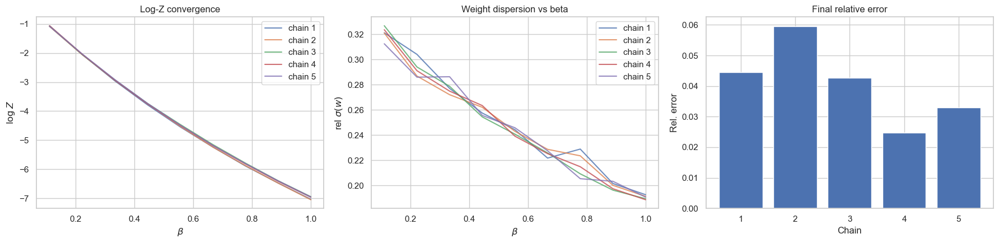

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.074e+00  | <w> mean = 3.4182e-01
[beta=0.222]  mean log rho = -9.775e-01  | <w> mean = 3.7625e-01
[beta=0.333]  mean log rho = -8.922e-01  | <w> mean = 4.0982e-01
[beta=0.444]  mean log rho = -8.119e-01  | <w> mean = 4.4407e-01
[beta=0.556]  mean log rho = -7.412e-01  | <w> mean = 4.7657e-01
[beta=0.667]  mean log rho = -6.903e-01  | <w> mean = 5.0147e-01
[beta=0.778]  mean log rho = -6.418e-01  | <w> mean = 5.2633e-01
[beta=0.889]  mean log rho = -5.946e-01  | <w> mean = 5.5179e-01
[19:17:39] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.510e-01  | <w> mean = 5.7637e-01
True  Z   : 490.140765
Mean  Ẑ  : 497.650089  ± 16.830323
Mean rel error: 3.42%
\nFinal relative variance of $\hat Z$: 3.3820e-02


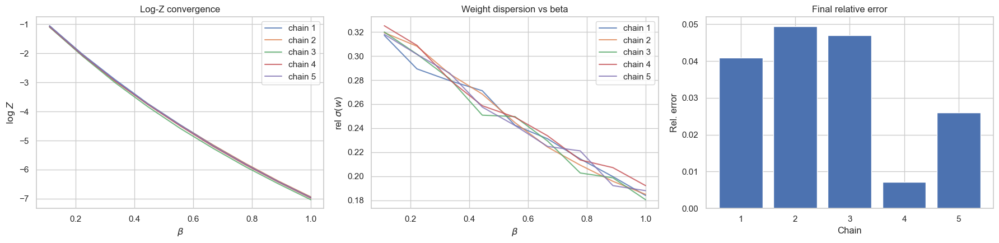

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.088e+00  | <w> mean = 3.3692e-01
[beta=0.222]  mean log rho = -9.778e-01  | <w> mean = 3.7616e-01
[beta=0.333]  mean log rho = -8.836e-01  | <w> mean = 4.1331e-01
[beta=0.444]  mean log rho = -8.118e-01  | <w> mean = 4.4404e-01
[beta=0.556]  mean log rho = -7.424e-01  | <w> mean = 4.7601e-01
[beta=0.667]  mean log rho = -6.815e-01  | <w> mean = 5.0591e-01
[beta=0.778]  mean log rho = -6.359e-01  | <w> mean = 5.2946e-01
[beta=0.889]  mean log rho = -6.000e-01  | <w> mean = 5.4886e-01
[19:17:46] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.538e-01  | <w> mean = 5.7478e-01
True  Z   : 490.140765
Mean  Ẑ  : 497.165215  ± 12.696945
Mean rel error: 2.53%
\nFinal relative variance of $\hat Z$: 2.5539e-02


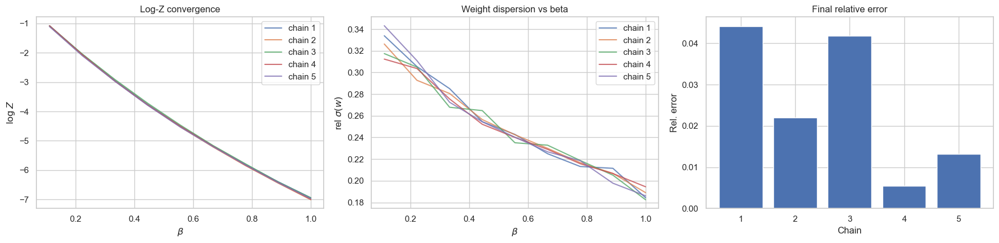

Running 5 AIS chains vectorized
[beta=0.111]  mean log rho = -1.088e+00  | <w> mean = 3.3681e-01
[beta=0.222]  mean log rho = -9.734e-01  | <w> mean = 3.7784e-01
[beta=0.333]  mean log rho = -8.871e-01  | <w> mean = 4.1188e-01
[beta=0.444]  mean log rho = -8.152e-01  | <w> mean = 4.4257e-01
[beta=0.556]  mean log rho = -7.552e-01  | <w> mean = 4.6995e-01
[beta=0.667]  mean log rho = -6.983e-01  | <w> mean = 4.9741e-01
[beta=0.778]  mean log rho = -6.396e-01  | <w> mean = 5.2754e-01
[beta=0.889]  mean log rho = -6.025e-01  | <w> mean = 5.4743e-01
[19:17:52] beta step 9/9 (1.0000) 
[beta=1.000]  mean log rho = -5.573e-01  | <w> mean = 5.7275e-01
True  Z   : 490.140765
Mean  Ẑ  : 476.556742  ± 8.428458
Mean rel error: 2.77%
\nFinal relative variance of $\hat Z$: 1.7686e-02


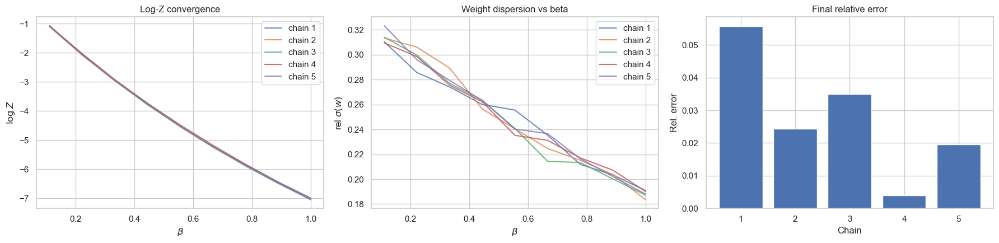


>>> Running with 25 beta steps
Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.114e-01  | <w> mean = 6.6273e-01
[beta=0.083]  mean log rho = -3.966e-01  | <w> mean = 6.7259e-01
[beta=0.125]  mean log rho = -3.853e-01  | <w> mean = 6.8024e-01
[beta=0.167]  mean log rho = -3.707e-01  | <w> mean = 6.9024e-01
[beta=0.208]  mean log rho = -3.652e-01  | <w> mean = 6.9405e-01
[beta=0.250]  mean log rho = -3.510e-01  | <w> mean = 7.0400e-01
[beta=0.292]  mean log rho = -3.365e-01  | <w> mean = 7.1427e-01
[beta=0.333]  mean log rho = -3.255e-01  | <w> mean = 7.2216e-01
[beta=0.375]  mean log rho = -3.167e-01  | <w> mean = 7.2855e-01
[19:18:00] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.068e-01  | <w> mean = 7.3582e-01
[beta=0.458]  mean log rho = -2.945e-01  | <w> mean = 7.4493e-01
[beta=0.500]  mean log rho = -2.818e-01  | <w> mean = 7.5441e-01
[beta=0.542]  mean log rho = -2.750e-01  | <w> mean = 7.5956e-01
[beta=0.583]  mean log rho = -2.682e-01  | <w> mean = 

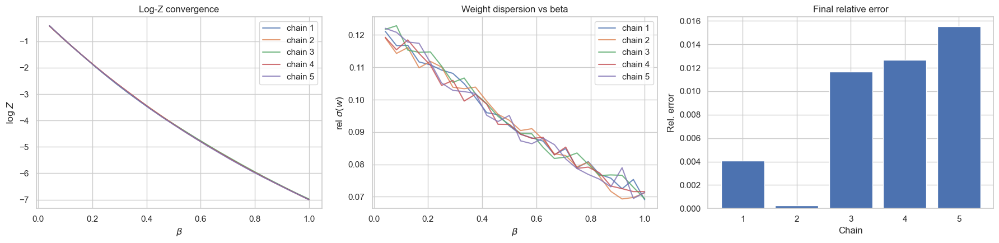

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.175e-01  | <w> mean = 6.5872e-01
[beta=0.083]  mean log rho = -4.033e-01  | <w> mean = 6.6811e-01
[beta=0.125]  mean log rho = -3.822e-01  | <w> mean = 6.8239e-01
[beta=0.167]  mean log rho = -3.733e-01  | <w> mean = 6.8844e-01
[beta=0.208]  mean log rho = -3.582e-01  | <w> mean = 6.9897e-01
[beta=0.250]  mean log rho = -3.469e-01  | <w> mean = 7.0688e-01
[beta=0.292]  mean log rho = -3.332e-01  | <w> mean = 7.1662e-01
[beta=0.333]  mean log rho = -3.269e-01  | <w> mean = 7.2114e-01
[beta=0.375]  mean log rho = -3.124e-01  | <w> mean = 7.3167e-01
[19:18:17] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.046e-01  | <w> mean = 7.3741e-01
[beta=0.458]  mean log rho = -2.944e-01  | <w> mean = 7.4501e-01
[beta=0.500]  mean log rho = -2.830e-01  | <w> mean = 7.5350e-01
[beta=0.542]  mean log rho = -2.766e-01  | <w> mean = 7.5837e-01
[beta=0.583]  mean log rho = -2.692e-01  | <w> mean = 7.6398e-01
[beta=0.625]  mean lo

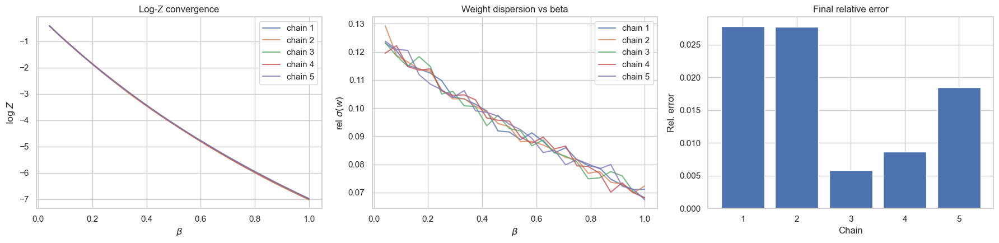

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.152e-01  | <w> mean = 6.6020e-01
[beta=0.083]  mean log rho = -4.039e-01  | <w> mean = 6.6772e-01
[beta=0.125]  mean log rho = -3.867e-01  | <w> mean = 6.7932e-01
[beta=0.167]  mean log rho = -3.702e-01  | <w> mean = 6.9057e-01
[beta=0.208]  mean log rho = -3.574e-01  | <w> mean = 6.9950e-01
[beta=0.250]  mean log rho = -3.452e-01  | <w> mean = 7.0810e-01
[beta=0.292]  mean log rho = -3.374e-01  | <w> mean = 7.1367e-01
[beta=0.333]  mean log rho = -3.245e-01  | <w> mean = 7.2286e-01
[beta=0.375]  mean log rho = -3.117e-01  | <w> mean = 7.3221e-01
[19:18:35] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.049e-01  | <w> mean = 7.3717e-01
[beta=0.458]  mean log rho = -2.968e-01  | <w> mean = 7.4320e-01
[beta=0.500]  mean log rho = -2.865e-01  | <w> mean = 7.5088e-01
[beta=0.542]  mean log rho = -2.776e-01  | <w> mean = 7.5761e-01
[beta=0.583]  mean log rho = -2.658e-01  | <w> mean = 7.6658e-01
[beta=0.625]  mean lo

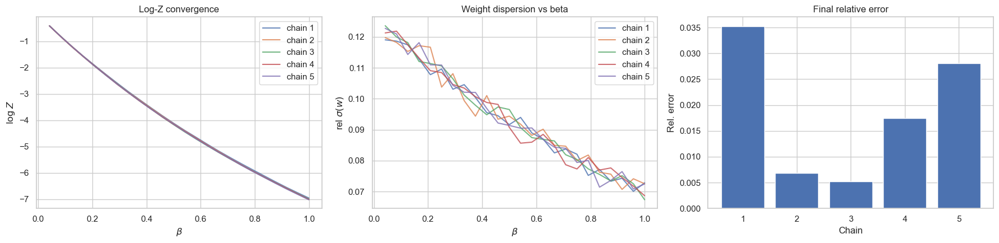

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.128e-01  | <w> mean = 6.6181e-01
[beta=0.083]  mean log rho = -3.978e-01  | <w> mean = 6.7181e-01
[beta=0.125]  mean log rho = -3.851e-01  | <w> mean = 6.8038e-01
[beta=0.167]  mean log rho = -3.682e-01  | <w> mean = 6.9199e-01
[beta=0.208]  mean log rho = -3.589e-01  | <w> mean = 6.9844e-01
[beta=0.250]  mean log rho = -3.431e-01  | <w> mean = 7.0957e-01
[beta=0.292]  mean log rho = -3.359e-01  | <w> mean = 7.1467e-01
[beta=0.333]  mean log rho = -3.254e-01  | <w> mean = 7.2226e-01
[beta=0.375]  mean log rho = -3.137e-01  | <w> mean = 7.3077e-01
[19:18:52] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.070e-01  | <w> mean = 7.3563e-01
[beta=0.458]  mean log rho = -2.931e-01  | <w> mean = 7.4597e-01
[beta=0.500]  mean log rho = -2.851e-01  | <w> mean = 7.5197e-01
[beta=0.542]  mean log rho = -2.780e-01  | <w> mean = 7.5731e-01
[beta=0.583]  mean log rho = -2.687e-01  | <w> mean = 7.6436e-01
[beta=0.625]  mean lo

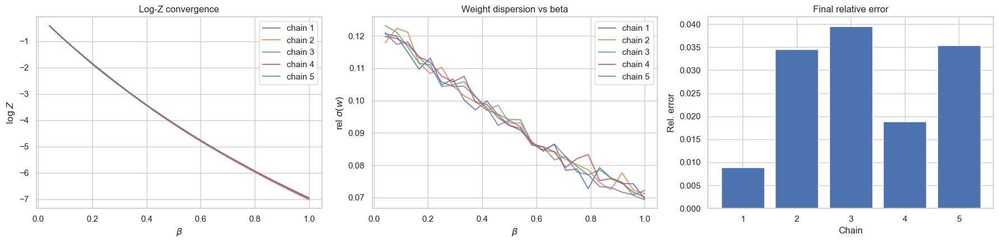

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.176e-01  | <w> mean = 6.5862e-01
[beta=0.083]  mean log rho = -3.982e-01  | <w> mean = 6.7151e-01
[beta=0.125]  mean log rho = -3.841e-01  | <w> mean = 6.8109e-01
[beta=0.167]  mean log rho = -3.713e-01  | <w> mean = 6.8982e-01
[beta=0.208]  mean log rho = -3.604e-01  | <w> mean = 6.9744e-01
[beta=0.250]  mean log rho = -3.471e-01  | <w> mean = 7.0675e-01
[beta=0.292]  mean log rho = -3.376e-01  | <w> mean = 7.1352e-01
[beta=0.333]  mean log rho = -3.243e-01  | <w> mean = 7.2305e-01
[beta=0.375]  mean log rho = -3.128e-01  | <w> mean = 7.3138e-01
[19:19:09] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.075e-01  | <w> mean = 7.3528e-01
[beta=0.458]  mean log rho = -2.937e-01  | <w> mean = 7.4550e-01
[beta=0.500]  mean log rho = -2.867e-01  | <w> mean = 7.5076e-01
[beta=0.542]  mean log rho = -2.797e-01  | <w> mean = 7.5599e-01
[beta=0.583]  mean log rho = -2.674e-01  | <w> mean = 7.6540e-01
[beta=0.625]  mean lo

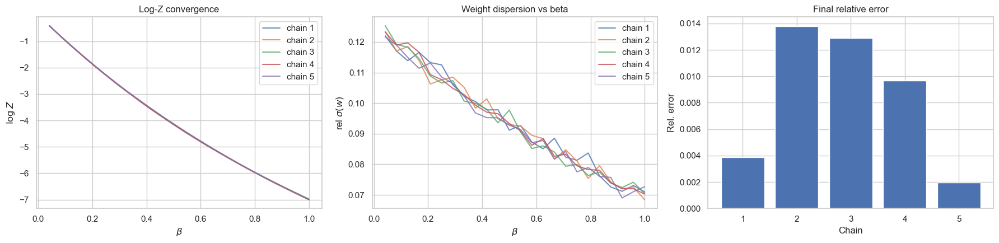

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.150e-01  | <w> mean = 6.6035e-01
[beta=0.083]  mean log rho = -3.984e-01  | <w> mean = 6.7141e-01
[beta=0.125]  mean log rho = -3.833e-01  | <w> mean = 6.8160e-01
[beta=0.167]  mean log rho = -3.734e-01  | <w> mean = 6.8838e-01
[beta=0.208]  mean log rho = -3.584e-01  | <w> mean = 6.9878e-01
[beta=0.250]  mean log rho = -3.463e-01  | <w> mean = 7.0729e-01
[beta=0.292]  mean log rho = -3.344e-01  | <w> mean = 7.1575e-01
[beta=0.333]  mean log rho = -3.255e-01  | <w> mean = 7.2215e-01
[beta=0.375]  mean log rho = -3.153e-01  | <w> mean = 7.2958e-01
[19:19:27] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.010e-01  | <w> mean = 7.4012e-01
[beta=0.458]  mean log rho = -2.949e-01  | <w> mean = 7.4465e-01
[beta=0.500]  mean log rho = -2.854e-01  | <w> mean = 7.5170e-01
[beta=0.542]  mean log rho = -2.800e-01  | <w> mean = 7.5579e-01
[beta=0.583]  mean log rho = -2.730e-01  | <w> mean = 7.6108e-01
[beta=0.625]  mean lo

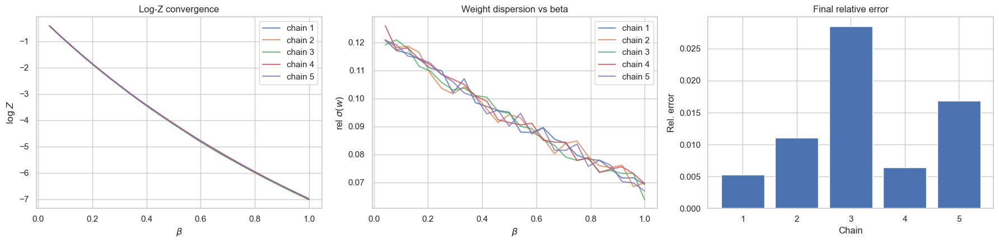

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.151e-01  | <w> mean = 6.6030e-01
[beta=0.083]  mean log rho = -4.015e-01  | <w> mean = 6.6932e-01
[beta=0.125]  mean log rho = -3.851e-01  | <w> mean = 6.8041e-01
[beta=0.167]  mean log rho = -3.726e-01  | <w> mean = 6.8897e-01
[beta=0.208]  mean log rho = -3.581e-01  | <w> mean = 6.9901e-01
[beta=0.250]  mean log rho = -3.457e-01  | <w> mean = 7.0773e-01
[beta=0.292]  mean log rho = -3.363e-01  | <w> mean = 7.1442e-01
[beta=0.333]  mean log rho = -3.246e-01  | <w> mean = 7.2283e-01
[beta=0.375]  mean log rho = -3.164e-01  | <w> mean = 7.2875e-01
[19:19:44] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.030e-01  | <w> mean = 7.3864e-01
[beta=0.458]  mean log rho = -2.925e-01  | <w> mean = 7.4638e-01
[beta=0.500]  mean log rho = -2.829e-01  | <w> mean = 7.5362e-01
[beta=0.542]  mean log rho = -2.769e-01  | <w> mean = 7.5816e-01
[beta=0.583]  mean log rho = -2.668e-01  | <w> mean = 7.6583e-01
[beta=0.625]  mean lo

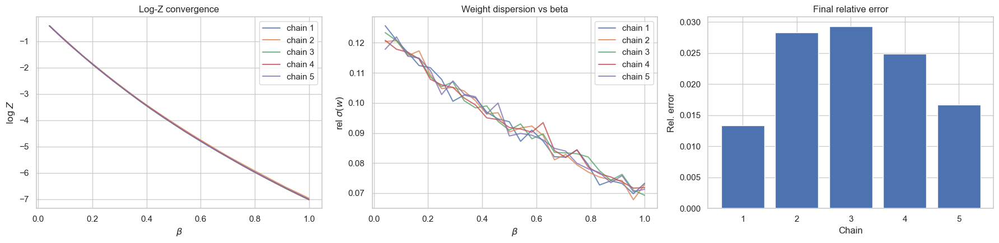

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.203e-01  | <w> mean = 6.5686e-01
[beta=0.083]  mean log rho = -4.008e-01  | <w> mean = 6.6979e-01
[beta=0.125]  mean log rho = -3.893e-01  | <w> mean = 6.7757e-01
[beta=0.167]  mean log rho = -3.700e-01  | <w> mean = 6.9078e-01
[beta=0.208]  mean log rho = -3.617e-01  | <w> mean = 6.9650e-01
[beta=0.250]  mean log rho = -3.426e-01  | <w> mean = 7.0991e-01
[beta=0.292]  mean log rho = -3.375e-01  | <w> mean = 7.1357e-01
[beta=0.333]  mean log rho = -3.220e-01  | <w> mean = 7.2471e-01
[beta=0.375]  mean log rho = -3.139e-01  | <w> mean = 7.3060e-01
[19:20:02] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.021e-01  | <w> mean = 7.3930e-01
[beta=0.458]  mean log rho = -2.961e-01  | <w> mean = 7.4372e-01
[beta=0.500]  mean log rho = -2.873e-01  | <w> mean = 7.5027e-01
[beta=0.542]  mean log rho = -2.764e-01  | <w> mean = 7.5852e-01
[beta=0.583]  mean log rho = -2.681e-01  | <w> mean = 7.6487e-01
[beta=0.625]  mean lo

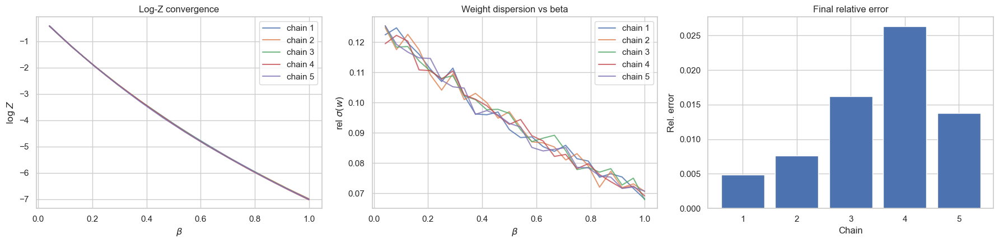

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.124e-01  | <w> mean = 6.6206e-01
[beta=0.083]  mean log rho = -4.005e-01  | <w> mean = 6.7000e-01
[beta=0.125]  mean log rho = -3.873e-01  | <w> mean = 6.7886e-01
[beta=0.167]  mean log rho = -3.727e-01  | <w> mean = 6.8890e-01
[beta=0.208]  mean log rho = -3.596e-01  | <w> mean = 6.9795e-01
[beta=0.250]  mean log rho = -3.452e-01  | <w> mean = 7.0811e-01
[beta=0.292]  mean log rho = -3.379e-01  | <w> mean = 7.1325e-01
[beta=0.333]  mean log rho = -3.239e-01  | <w> mean = 7.2333e-01
[beta=0.375]  mean log rho = -3.139e-01  | <w> mean = 7.3063e-01
[19:20:19] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.016e-01  | <w> mean = 7.3965e-01
[beta=0.458]  mean log rho = -2.961e-01  | <w> mean = 7.4371e-01
[beta=0.500]  mean log rho = -2.860e-01  | <w> mean = 7.5124e-01
[beta=0.542]  mean log rho = -2.762e-01  | <w> mean = 7.5865e-01
[beta=0.583]  mean log rho = -2.679e-01  | <w> mean = 7.6499e-01
[beta=0.625]  mean lo

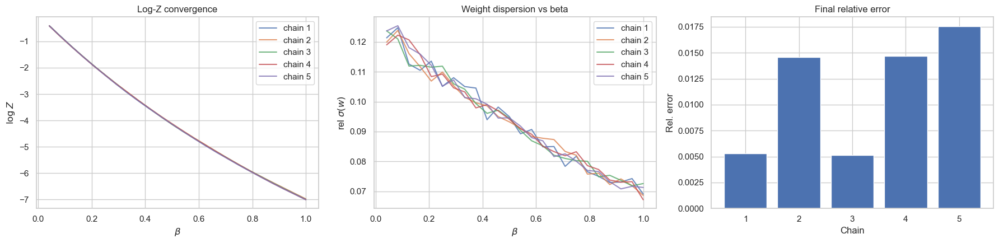

Running 5 AIS chains vectorized
[beta=0.042]  mean log rho = -4.169e-01  | <w> mean = 6.5906e-01
[beta=0.083]  mean log rho = -4.039e-01  | <w> mean = 6.6773e-01
[beta=0.125]  mean log rho = -3.850e-01  | <w> mean = 6.8045e-01
[beta=0.167]  mean log rho = -3.720e-01  | <w> mean = 6.8935e-01
[beta=0.208]  mean log rho = -3.600e-01  | <w> mean = 6.9767e-01
[beta=0.250]  mean log rho = -3.452e-01  | <w> mean = 7.0811e-01
[beta=0.292]  mean log rho = -3.356e-01  | <w> mean = 7.1491e-01
[beta=0.333]  mean log rho = -3.265e-01  | <w> mean = 7.2147e-01
[beta=0.375]  mean log rho = -3.116e-01  | <w> mean = 7.3224e-01
[19:20:37] beta step 10/24 (0.4167) 
[beta=0.417]  mean log rho = -3.035e-01  | <w> mean = 7.3824e-01
[beta=0.458]  mean log rho = -2.924e-01  | <w> mean = 7.4646e-01
[beta=0.500]  mean log rho = -2.869e-01  | <w> mean = 7.5061e-01
[beta=0.542]  mean log rho = -2.729e-01  | <w> mean = 7.6117e-01
[beta=0.583]  mean log rho = -2.671e-01  | <w> mean = 7.6557e-01
[beta=0.625]  mean lo

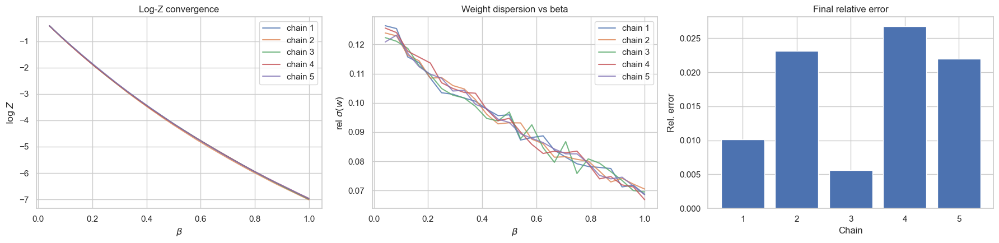


>>> Running with 50 beta steps
Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.064e-01  | <w> mean = 8.1353e-01
[beta=0.041]  mean log rho = -2.002e-01  | <w> mean = 8.1856e-01
[beta=0.061]  mean log rho = -1.968e-01  | <w> mean = 8.2133e-01
[beta=0.082]  mean log rho = -1.942e-01  | <w> mean = 8.2347e-01
[beta=0.102]  mean log rho = -1.930e-01  | <w> mean = 8.2445e-01
[beta=0.122]  mean log rho = -1.879e-01  | <w> mean = 8.2872e-01
[beta=0.143]  mean log rho = -1.858e-01  | <w> mean = 8.3048e-01
[beta=0.163]  mean log rho = -1.818e-01  | <w> mean = 8.3375e-01
[beta=0.184]  mean log rho = -1.770e-01  | <w> mean = 8.3779e-01
[19:20:54] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.752e-01  | <w> mean = 8.3930e-01
[beta=0.224]  mean log rho = -1.724e-01  | <w> mean = 8.4165e-01
[beta=0.245]  mean log rho = -1.714e-01  | <w> mean = 8.4252e-01
[beta=0.265]  mean log rho = -1.656e-01  | <w> mean = 8.4742e-01
[beta=0.286]  mean log rho = -1.652e-01  | <w> mean = 

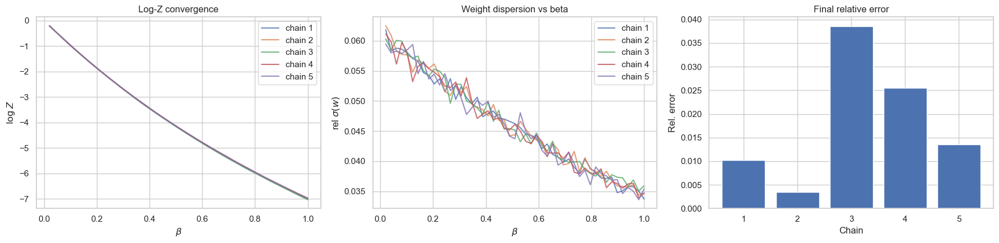

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.058e-01  | <w> mean = 8.1397e-01
[beta=0.041]  mean log rho = -2.020e-01  | <w> mean = 8.1708e-01
[beta=0.061]  mean log rho = -1.986e-01  | <w> mean = 8.1990e-01
[beta=0.082]  mean log rho = -1.947e-01  | <w> mean = 8.2305e-01
[beta=0.102]  mean log rho = -1.916e-01  | <w> mean = 8.2566e-01
[beta=0.122]  mean log rho = -1.897e-01  | <w> mean = 8.2725e-01
[beta=0.143]  mean log rho = -1.843e-01  | <w> mean = 8.3166e-01
[beta=0.163]  mean log rho = -1.798e-01  | <w> mean = 8.3543e-01
[beta=0.184]  mean log rho = -1.778e-01  | <w> mean = 8.3714e-01
[19:21:29] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.741e-01  | <w> mean = 8.4022e-01
[beta=0.224]  mean log rho = -1.705e-01  | <w> mean = 8.4320e-01
[beta=0.245]  mean log rho = -1.671e-01  | <w> mean = 8.4611e-01
[beta=0.265]  mean log rho = -1.652e-01  | <w> mean = 8.4774e-01
[beta=0.286]  mean log rho = -1.644e-01  | <w> mean = 8.4839e-01
[beta=0.306]  mean lo

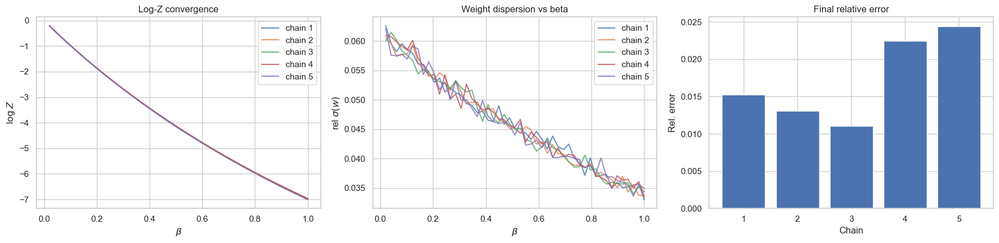

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.071e-01  | <w> mean = 8.1294e-01
[beta=0.041]  mean log rho = -2.016e-01  | <w> mean = 8.1746e-01
[beta=0.061]  mean log rho = -1.991e-01  | <w> mean = 8.1946e-01
[beta=0.082]  mean log rho = -1.955e-01  | <w> mean = 8.2246e-01
[beta=0.102]  mean log rho = -1.905e-01  | <w> mean = 8.2651e-01
[beta=0.122]  mean log rho = -1.866e-01  | <w> mean = 8.2981e-01
[beta=0.143]  mean log rho = -1.835e-01  | <w> mean = 8.3238e-01
[beta=0.163]  mean log rho = -1.818e-01  | <w> mean = 8.3379e-01
[beta=0.184]  mean log rho = -1.787e-01  | <w> mean = 8.3638e-01
[19:22:05] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.749e-01  | <w> mean = 8.3952e-01
[beta=0.224]  mean log rho = -1.715e-01  | <w> mean = 8.4236e-01
[beta=0.245]  mean log rho = -1.689e-01  | <w> mean = 8.4458e-01
[beta=0.265]  mean log rho = -1.665e-01  | <w> mean = 8.4663e-01
[beta=0.286]  mean log rho = -1.627e-01  | <w> mean = 8.4987e-01
[beta=0.306]  mean lo

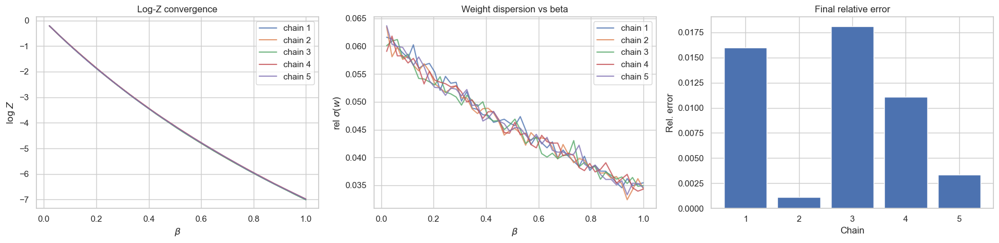

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.071e-01  | <w> mean = 8.1291e-01
[beta=0.041]  mean log rho = -2.015e-01  | <w> mean = 8.1754e-01
[beta=0.061]  mean log rho = -1.973e-01  | <w> mean = 8.2093e-01
[beta=0.082]  mean log rho = -1.937e-01  | <w> mean = 8.2387e-01
[beta=0.102]  mean log rho = -1.916e-01  | <w> mean = 8.2564e-01
[beta=0.122]  mean log rho = -1.873e-01  | <w> mean = 8.2922e-01
[beta=0.143]  mean log rho = -1.855e-01  | <w> mean = 8.3070e-01
[beta=0.163]  mean log rho = -1.815e-01  | <w> mean = 8.3401e-01
[beta=0.184]  mean log rho = -1.773e-01  | <w> mean = 8.3750e-01
[19:22:40] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.734e-01  | <w> mean = 8.4078e-01
[beta=0.224]  mean log rho = -1.711e-01  | <w> mean = 8.4271e-01
[beta=0.245]  mean log rho = -1.687e-01  | <w> mean = 8.4474e-01
[beta=0.265]  mean log rho = -1.662e-01  | <w> mean = 8.4691e-01
[beta=0.286]  mean log rho = -1.642e-01  | <w> mean = 8.4860e-01
[beta=0.306]  mean lo

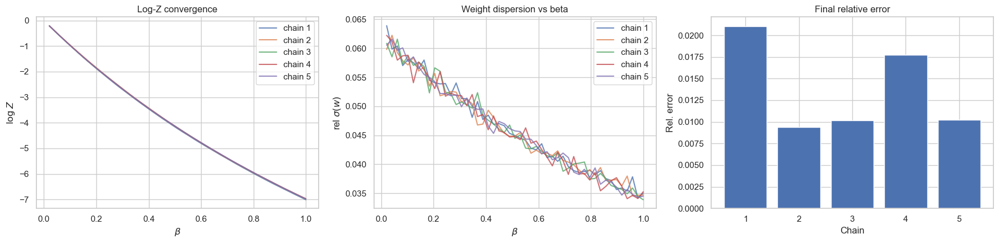

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.066e-01  | <w> mean = 8.1334e-01
[beta=0.041]  mean log rho = -2.011e-01  | <w> mean = 8.1781e-01
[beta=0.061]  mean log rho = -1.967e-01  | <w> mean = 8.2143e-01
[beta=0.082]  mean log rho = -1.941e-01  | <w> mean = 8.2357e-01
[beta=0.102]  mean log rho = -1.920e-01  | <w> mean = 8.2531e-01
[beta=0.122]  mean log rho = -1.887e-01  | <w> mean = 8.2801e-01
[beta=0.143]  mean log rho = -1.846e-01  | <w> mean = 8.3144e-01
[beta=0.163]  mean log rho = -1.810e-01  | <w> mean = 8.3440e-01
[beta=0.184]  mean log rho = -1.771e-01  | <w> mean = 8.3766e-01
[19:23:16] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.732e-01  | <w> mean = 8.4098e-01
[beta=0.224]  mean log rho = -1.722e-01  | <w> mean = 8.4181e-01
[beta=0.245]  mean log rho = -1.709e-01  | <w> mean = 8.4288e-01
[beta=0.265]  mean log rho = -1.656e-01  | <w> mean = 8.4741e-01
[beta=0.286]  mean log rho = -1.645e-01  | <w> mean = 8.4834e-01
[beta=0.306]  mean lo

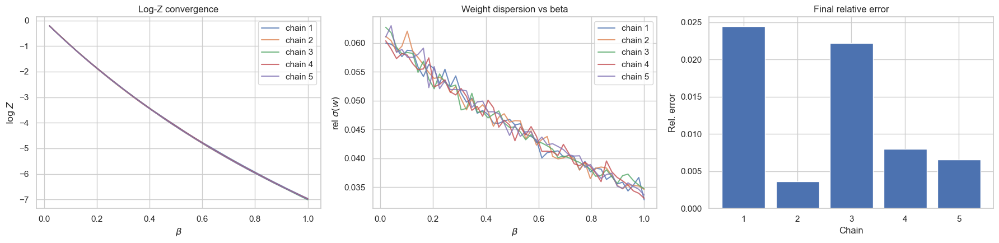

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.049e-01  | <w> mean = 8.1470e-01
[beta=0.041]  mean log rho = -1.992e-01  | <w> mean = 8.1942e-01
[beta=0.061]  mean log rho = -1.982e-01  | <w> mean = 8.2020e-01
[beta=0.082]  mean log rho = -1.951e-01  | <w> mean = 8.2279e-01
[beta=0.102]  mean log rho = -1.896e-01  | <w> mean = 8.2726e-01
[beta=0.122]  mean log rho = -1.864e-01  | <w> mean = 8.2993e-01
[beta=0.143]  mean log rho = -1.860e-01  | <w> mean = 8.3028e-01
[beta=0.163]  mean log rho = -1.815e-01  | <w> mean = 8.3401e-01
[beta=0.184]  mean log rho = -1.807e-01  | <w> mean = 8.3467e-01
[19:23:51] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.754e-01  | <w> mean = 8.3915e-01
[beta=0.224]  mean log rho = -1.712e-01  | <w> mean = 8.4264e-01
[beta=0.245]  mean log rho = -1.698e-01  | <w> mean = 8.4381e-01
[beta=0.265]  mean log rho = -1.679e-01  | <w> mean = 8.4543e-01
[beta=0.286]  mean log rho = -1.639e-01  | <w> mean = 8.4886e-01
[beta=0.306]  mean lo

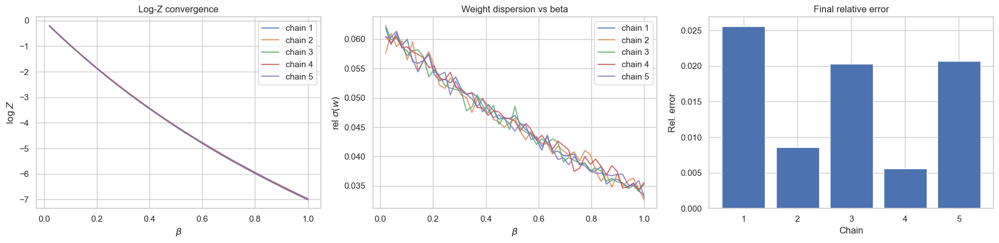

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.050e-01  | <w> mean = 8.1464e-01
[beta=0.041]  mean log rho = -2.022e-01  | <w> mean = 8.1696e-01
[beta=0.061]  mean log rho = -1.982e-01  | <w> mean = 8.2025e-01
[beta=0.082]  mean log rho = -1.943e-01  | <w> mean = 8.2344e-01
[beta=0.102]  mean log rho = -1.911e-01  | <w> mean = 8.2603e-01
[beta=0.122]  mean log rho = -1.874e-01  | <w> mean = 8.2915e-01
[beta=0.143]  mean log rho = -1.851e-01  | <w> mean = 8.3099e-01
[beta=0.163]  mean log rho = -1.802e-01  | <w> mean = 8.3509e-01
[beta=0.184]  mean log rho = -1.772e-01  | <w> mean = 8.3761e-01
[19:24:26] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.752e-01  | <w> mean = 8.3927e-01
[beta=0.224]  mean log rho = -1.717e-01  | <w> mean = 8.4220e-01
[beta=0.245]  mean log rho = -1.691e-01  | <w> mean = 8.4442e-01
[beta=0.265]  mean log rho = -1.663e-01  | <w> mean = 8.4682e-01
[beta=0.286]  mean log rho = -1.620e-01  | <w> mean = 8.5042e-01
[beta=0.306]  mean lo

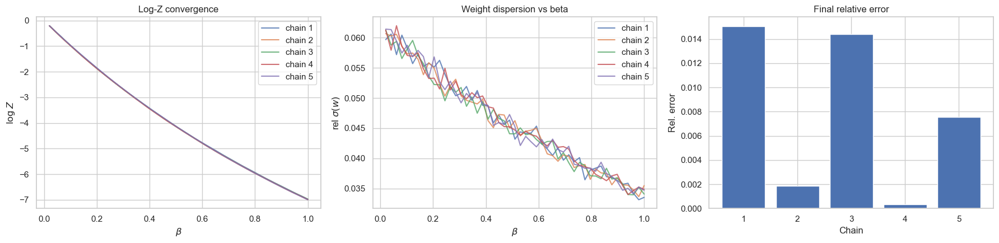

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.052e-01  | <w> mean = 8.1446e-01
[beta=0.041]  mean log rho = -2.013e-01  | <w> mean = 8.1769e-01
[beta=0.061]  mean log rho = -1.992e-01  | <w> mean = 8.1943e-01
[beta=0.082]  mean log rho = -1.935e-01  | <w> mean = 8.2410e-01
[beta=0.102]  mean log rho = -1.901e-01  | <w> mean = 8.2687e-01
[beta=0.122]  mean log rho = -1.886e-01  | <w> mean = 8.2814e-01
[beta=0.143]  mean log rho = -1.841e-01  | <w> mean = 8.3185e-01
[beta=0.163]  mean log rho = -1.811e-01  | <w> mean = 8.3431e-01
[beta=0.184]  mean log rho = -1.790e-01  | <w> mean = 8.3609e-01
[19:25:02] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.759e-01  | <w> mean = 8.3869e-01
[beta=0.224]  mean log rho = -1.718e-01  | <w> mean = 8.4218e-01
[beta=0.245]  mean log rho = -1.703e-01  | <w> mean = 8.4340e-01
[beta=0.265]  mean log rho = -1.662e-01  | <w> mean = 8.4689e-01
[beta=0.286]  mean log rho = -1.631e-01  | <w> mean = 8.4950e-01
[beta=0.306]  mean lo

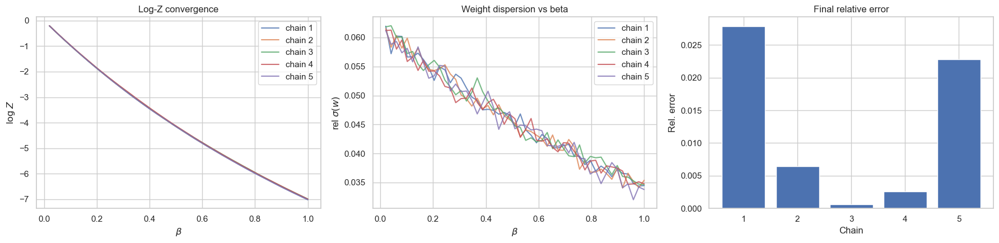

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.075e-01  | <w> mean = 8.1263e-01
[beta=0.041]  mean log rho = -2.012e-01  | <w> mean = 8.1774e-01
[beta=0.061]  mean log rho = -1.998e-01  | <w> mean = 8.1890e-01
[beta=0.082]  mean log rho = -1.919e-01  | <w> mean = 8.2540e-01
[beta=0.102]  mean log rho = -1.926e-01  | <w> mean = 8.2485e-01
[beta=0.122]  mean log rho = -1.873e-01  | <w> mean = 8.2916e-01
[beta=0.143]  mean log rho = -1.836e-01  | <w> mean = 8.3227e-01
[beta=0.163]  mean log rho = -1.799e-01  | <w> mean = 8.3533e-01
[beta=0.184]  mean log rho = -1.803e-01  | <w> mean = 8.3501e-01
[19:25:37] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.734e-01  | <w> mean = 8.4083e-01
[beta=0.224]  mean log rho = -1.710e-01  | <w> mean = 8.4281e-01
[beta=0.245]  mean log rho = -1.701e-01  | <w> mean = 8.4358e-01
[beta=0.265]  mean log rho = -1.664e-01  | <w> mean = 8.4669e-01
[beta=0.286]  mean log rho = -1.632e-01  | <w> mean = 8.4939e-01
[beta=0.306]  mean lo

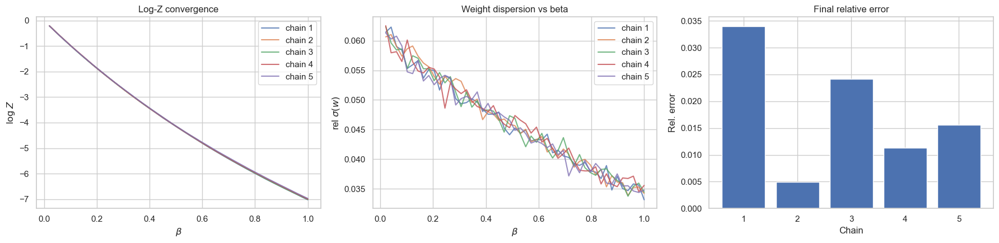

Running 5 AIS chains vectorized
[beta=0.020]  mean log rho = -2.051e-01  | <w> mean = 8.1460e-01
[beta=0.041]  mean log rho = -2.004e-01  | <w> mean = 8.1844e-01
[beta=0.061]  mean log rho = -1.995e-01  | <w> mean = 8.1917e-01
[beta=0.082]  mean log rho = -1.949e-01  | <w> mean = 8.2292e-01
[beta=0.102]  mean log rho = -1.906e-01  | <w> mean = 8.2646e-01
[beta=0.122]  mean log rho = -1.858e-01  | <w> mean = 8.3044e-01
[beta=0.143]  mean log rho = -1.817e-01  | <w> mean = 8.3386e-01
[beta=0.163]  mean log rho = -1.808e-01  | <w> mean = 8.3461e-01
[beta=0.184]  mean log rho = -1.782e-01  | <w> mean = 8.3680e-01
[19:26:12] beta step 10/49 (0.2041) 
[beta=0.204]  mean log rho = -1.728e-01  | <w> mean = 8.4133e-01
[beta=0.224]  mean log rho = -1.715e-01  | <w> mean = 8.4240e-01
[beta=0.245]  mean log rho = -1.690e-01  | <w> mean = 8.4452e-01
[beta=0.265]  mean log rho = -1.663e-01  | <w> mean = 8.4680e-01
[beta=0.286]  mean log rho = -1.645e-01  | <w> mean = 8.4832e-01
[beta=0.306]  mean lo

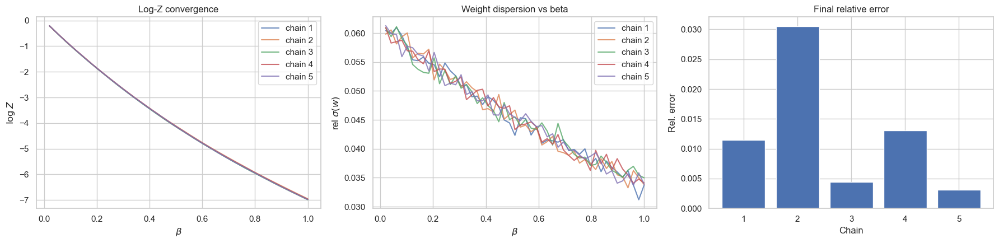


>>> Running with 100 beta steps
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.020e-01  | <w> mean = 9.0302e-01
[beta=0.020]  mean log rho = -1.015e-01  | <w> mean = 9.0348e-01
[beta=0.030]  mean log rho = -1.001e-01  | <w> mean = 9.0473e-01
[beta=0.040]  mean log rho = -9.984e-02  | <w> mean = 9.0499e-01
[beta=0.051]  mean log rho = -9.926e-02  | <w> mean = 9.0551e-01
[beta=0.061]  mean log rho = -9.749e-02  | <w> mean = 9.0711e-01
[beta=0.071]  mean log rho = -9.696e-02  | <w> mean = 9.0759e-01
[beta=0.081]  mean log rho = -9.518e-02  | <w> mean = 9.0921e-01
[beta=0.091]  mean log rho = -9.517e-02  | <w> mean = 9.0922e-01
[19:26:48] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.301e-02  | <w> mean = 9.1118e-01
[beta=0.111]  mean log rho = -9.348e-02  | <w> mean = 9.1076e-01
[beta=0.121]  mean log rho = -9.247e-02  | <w> mean = 9.1167e-01
[beta=0.131]  mean log rho = -9.150e-02  | <w> mean = 9.1256e-01
[beta=0.141]  mean log rho = -9.184e-02  | <w> mean =

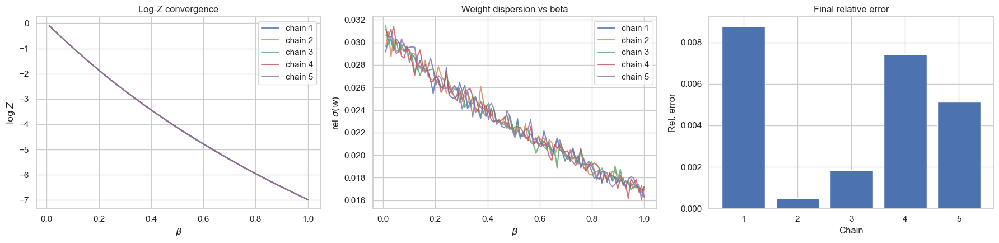

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.022e-01  | <w> mean = 9.0282e-01
[beta=0.020]  mean log rho = -1.011e-01  | <w> mean = 9.0383e-01
[beta=0.030]  mean log rho = -1.001e-01  | <w> mean = 9.0472e-01
[beta=0.040]  mean log rho = -9.918e-02  | <w> mean = 9.0558e-01
[beta=0.051]  mean log rho = -9.889e-02  | <w> mean = 9.0584e-01
[beta=0.061]  mean log rho = -9.802e-02  | <w> mean = 9.0663e-01
[beta=0.071]  mean log rho = -9.759e-02  | <w> mean = 9.0702e-01
[beta=0.081]  mean log rho = -9.468e-02  | <w> mean = 9.0966e-01
[beta=0.091]  mean log rho = -9.541e-02  | <w> mean = 9.0900e-01
[19:27:59] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.451e-02  | <w> mean = 9.0981e-01
[beta=0.111]  mean log rho = -9.324e-02  | <w> mean = 9.1098e-01
[beta=0.121]  mean log rho = -9.355e-02  | <w> mean = 9.1069e-01
[beta=0.131]  mean log rho = -9.134e-02  | <w> mean = 9.1271e-01
[beta=0.141]  mean log rho = -9.125e-02  | <w> mean = 9.1279e-01
[beta=0.152]  mean lo

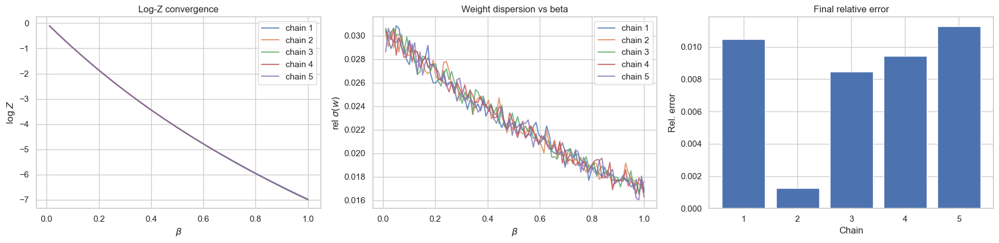

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.025e-01  | <w> mean = 9.0257e-01
[beta=0.020]  mean log rho = -1.017e-01  | <w> mean = 9.0333e-01
[beta=0.030]  mean log rho = -9.959e-02  | <w> mean = 9.0520e-01
[beta=0.040]  mean log rho = -9.884e-02  | <w> mean = 9.0589e-01
[beta=0.051]  mean log rho = -9.852e-02  | <w> mean = 9.0617e-01
[beta=0.061]  mean log rho = -9.766e-02  | <w> mean = 9.0695e-01
[beta=0.071]  mean log rho = -9.663e-02  | <w> mean = 9.0789e-01
[beta=0.081]  mean log rho = -9.559e-02  | <w> mean = 9.0883e-01
[beta=0.091]  mean log rho = -9.516e-02  | <w> mean = 9.0922e-01
[19:29:11] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.358e-02  | <w> mean = 9.1067e-01
[beta=0.111]  mean log rho = -9.324e-02  | <w> mean = 9.1097e-01
[beta=0.121]  mean log rho = -9.197e-02  | <w> mean = 9.1214e-01
[beta=0.131]  mean log rho = -9.168e-02  | <w> mean = 9.1240e-01
[beta=0.141]  mean log rho = -9.021e-02  | <w> mean = 9.1374e-01
[beta=0.152]  mean lo

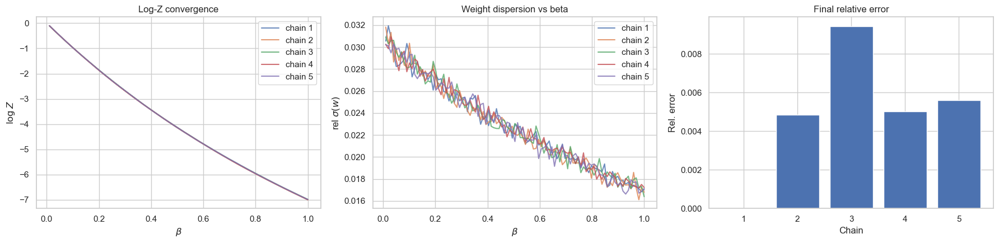

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.024e-01  | <w> mean = 9.0271e-01
[beta=0.020]  mean log rho = -1.009e-01  | <w> mean = 9.0406e-01
[beta=0.030]  mean log rho = -1.007e-01  | <w> mean = 9.0421e-01
[beta=0.040]  mean log rho = -9.909e-02  | <w> mean = 9.0566e-01
[beta=0.051]  mean log rho = -9.897e-02  | <w> mean = 9.0577e-01
[beta=0.061]  mean log rho = -9.830e-02  | <w> mean = 9.0637e-01
[beta=0.071]  mean log rho = -9.612e-02  | <w> mean = 9.0835e-01
[beta=0.081]  mean log rho = -9.617e-02  | <w> mean = 9.0831e-01
[beta=0.091]  mean log rho = -9.557e-02  | <w> mean = 9.0886e-01
[19:30:22] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.411e-02  | <w> mean = 9.1018e-01
[beta=0.111]  mean log rho = -9.270e-02  | <w> mean = 9.1147e-01
[beta=0.121]  mean log rho = -9.174e-02  | <w> mean = 9.1235e-01
[beta=0.131]  mean log rho = -9.204e-02  | <w> mean = 9.1207e-01
[beta=0.141]  mean log rho = -9.119e-02  | <w> mean = 9.1284e-01
[beta=0.152]  mean lo

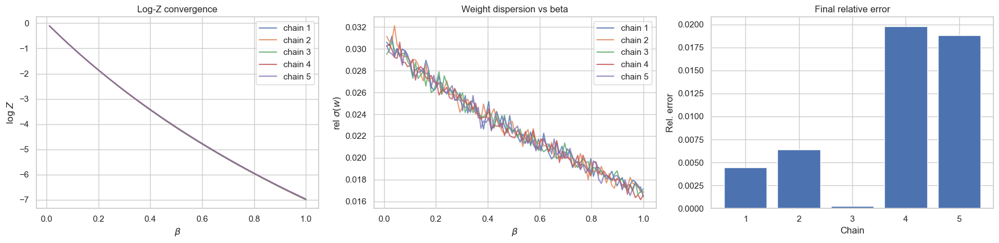

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.023e-01  | <w> mean = 9.0280e-01
[beta=0.020]  mean log rho = -1.008e-01  | <w> mean = 9.0411e-01
[beta=0.030]  mean log rho = -1.004e-01  | <w> mean = 9.0451e-01
[beta=0.040]  mean log rho = -9.993e-02  | <w> mean = 9.0490e-01
[beta=0.051]  mean log rho = -9.936e-02  | <w> mean = 9.0541e-01
[beta=0.061]  mean log rho = -9.749e-02  | <w> mean = 9.0711e-01
[beta=0.071]  mean log rho = -9.671e-02  | <w> mean = 9.0782e-01
[beta=0.081]  mean log rho = -9.650e-02  | <w> mean = 9.0801e-01
[beta=0.091]  mean log rho = -9.392e-02  | <w> mean = 9.1036e-01
[19:31:33] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.393e-02  | <w> mean = 9.1035e-01
[beta=0.111]  mean log rho = -9.404e-02  | <w> mean = 9.1025e-01
[beta=0.121]  mean log rho = -9.267e-02  | <w> mean = 9.1149e-01
[beta=0.131]  mean log rho = -9.172e-02  | <w> mean = 9.1236e-01
[beta=0.141]  mean log rho = -9.087e-02  | <w> mean = 9.1314e-01
[beta=0.152]  mean lo

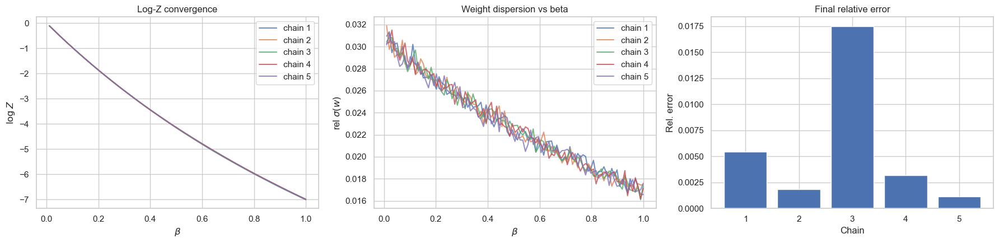

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.023e-01  | <w> mean = 9.0280e-01
[beta=0.020]  mean log rho = -1.007e-01  | <w> mean = 9.0424e-01
[beta=0.030]  mean log rho = -1.012e-01  | <w> mean = 9.0371e-01
[beta=0.040]  mean log rho = -1.003e-01  | <w> mean = 9.0455e-01
[beta=0.051]  mean log rho = -9.807e-02  | <w> mean = 9.0658e-01
[beta=0.061]  mean log rho = -9.825e-02  | <w> mean = 9.0642e-01
[beta=0.071]  mean log rho = -9.646e-02  | <w> mean = 9.0804e-01
[beta=0.081]  mean log rho = -9.641e-02  | <w> mean = 9.0809e-01
[beta=0.091]  mean log rho = -9.502e-02  | <w> mean = 9.0936e-01
[19:32:44] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.459e-02  | <w> mean = 9.0975e-01
[beta=0.111]  mean log rho = -9.274e-02  | <w> mean = 9.1143e-01
[beta=0.121]  mean log rho = -9.284e-02  | <w> mean = 9.1134e-01
[beta=0.131]  mean log rho = -9.068e-02  | <w> mean = 9.1331e-01
[beta=0.141]  mean log rho = -9.067e-02  | <w> mean = 9.1332e-01
[beta=0.152]  mean lo

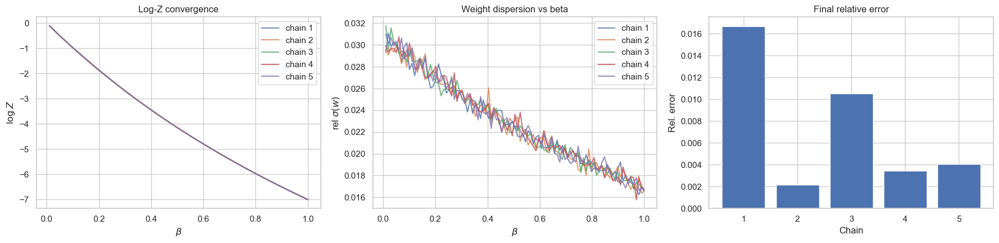

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.019e-01  | <w> mean = 9.0308e-01
[beta=0.020]  mean log rho = -1.009e-01  | <w> mean = 9.0404e-01
[beta=0.030]  mean log rho = -9.961e-02  | <w> mean = 9.0519e-01
[beta=0.040]  mean log rho = -9.861e-02  | <w> mean = 9.0610e-01
[beta=0.051]  mean log rho = -9.903e-02  | <w> mean = 9.0572e-01
[beta=0.061]  mean log rho = -9.706e-02  | <w> mean = 9.0750e-01
[beta=0.071]  mean log rho = -9.706e-02  | <w> mean = 9.0750e-01
[beta=0.081]  mean log rho = -9.584e-02  | <w> mean = 9.0861e-01
[beta=0.091]  mean log rho = -9.481e-02  | <w> mean = 9.0954e-01
[19:33:55] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.511e-02  | <w> mean = 9.0928e-01
[beta=0.111]  mean log rho = -9.381e-02  | <w> mean = 9.1046e-01
[beta=0.121]  mean log rho = -9.204e-02  | <w> mean = 9.1207e-01
[beta=0.131]  mean log rho = -9.217e-02  | <w> mean = 9.1195e-01
[beta=0.141]  mean log rho = -9.053e-02  | <w> mean = 9.1345e-01
[beta=0.152]  mean lo

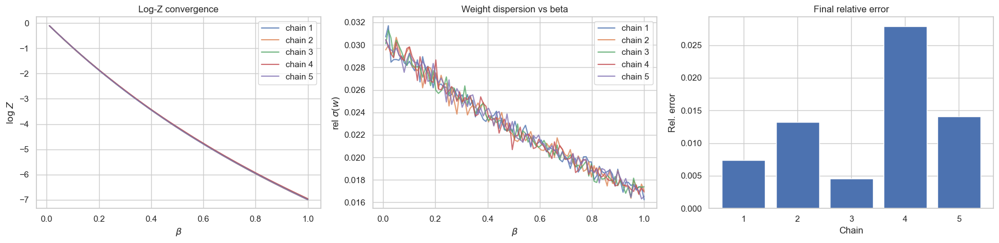

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.020e-01  | <w> mean = 9.0302e-01
[beta=0.020]  mean log rho = -1.010e-01  | <w> mean = 9.0390e-01
[beta=0.030]  mean log rho = -1.003e-01  | <w> mean = 9.0460e-01
[beta=0.040]  mean log rho = -9.982e-02  | <w> mean = 9.0500e-01
[beta=0.051]  mean log rho = -9.817e-02  | <w> mean = 9.0650e-01
[beta=0.061]  mean log rho = -9.821e-02  | <w> mean = 9.0646e-01
[beta=0.071]  mean log rho = -9.707e-02  | <w> mean = 9.0749e-01
[beta=0.081]  mean log rho = -9.535e-02  | <w> mean = 9.0905e-01
[beta=0.091]  mean log rho = -9.526e-02  | <w> mean = 9.0914e-01
[19:35:07] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.500e-02  | <w> mean = 9.0938e-01
[beta=0.111]  mean log rho = -9.344e-02  | <w> mean = 9.1079e-01
[beta=0.121]  mean log rho = -9.239e-02  | <w> mean = 9.1175e-01
[beta=0.131]  mean log rho = -9.205e-02  | <w> mean = 9.1206e-01
[beta=0.141]  mean log rho = -9.126e-02  | <w> mean = 9.1278e-01
[beta=0.152]  mean lo

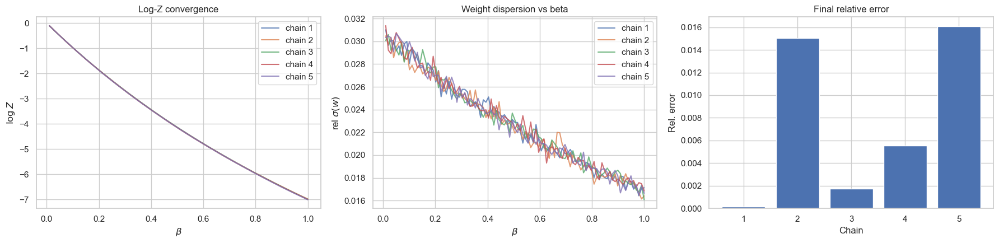

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.018e-01  | <w> mean = 9.0323e-01
[beta=0.020]  mean log rho = -1.017e-01  | <w> mean = 9.0330e-01
[beta=0.030]  mean log rho = -9.921e-02  | <w> mean = 9.0555e-01
[beta=0.040]  mean log rho = -9.878e-02  | <w> mean = 9.0595e-01
[beta=0.051]  mean log rho = -9.896e-02  | <w> mean = 9.0578e-01
[beta=0.061]  mean log rho = -9.727e-02  | <w> mean = 9.0731e-01
[beta=0.071]  mean log rho = -9.691e-02  | <w> mean = 9.0764e-01
[beta=0.081]  mean log rho = -9.511e-02  | <w> mean = 9.0927e-01
[beta=0.091]  mean log rho = -9.570e-02  | <w> mean = 9.0874e-01
[19:36:18] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.441e-02  | <w> mean = 9.0991e-01
[beta=0.111]  mean log rho = -9.314e-02  | <w> mean = 9.1107e-01
[beta=0.121]  mean log rho = -9.368e-02  | <w> mean = 9.1058e-01
[beta=0.131]  mean log rho = -9.178e-02  | <w> mean = 9.1231e-01
[beta=0.141]  mean log rho = -9.065e-02  | <w> mean = 9.1334e-01
[beta=0.152]  mean lo

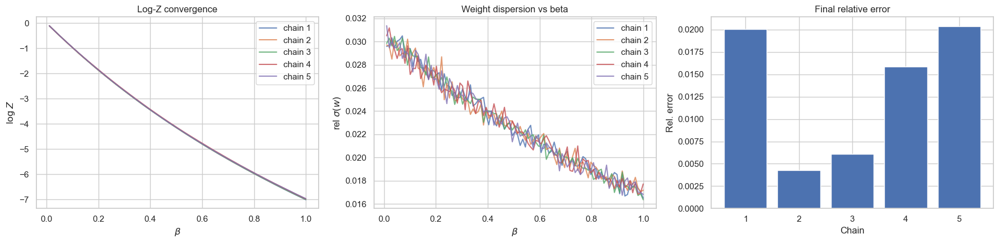

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -1.019e-01  | <w> mean = 9.0312e-01
[beta=0.020]  mean log rho = -1.012e-01  | <w> mean = 9.0380e-01
[beta=0.030]  mean log rho = -1.010e-01  | <w> mean = 9.0390e-01
[beta=0.040]  mean log rho = -9.865e-02  | <w> mean = 9.0606e-01
[beta=0.051]  mean log rho = -9.835e-02  | <w> mean = 9.0633e-01
[beta=0.061]  mean log rho = -9.700e-02  | <w> mean = 9.0755e-01
[beta=0.071]  mean log rho = -9.786e-02  | <w> mean = 9.0678e-01
[beta=0.081]  mean log rho = -9.570e-02  | <w> mean = 9.0874e-01
[beta=0.091]  mean log rho = -9.480e-02  | <w> mean = 9.0955e-01
[19:37:29] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -9.402e-02  | <w> mean = 9.1027e-01
[beta=0.111]  mean log rho = -9.366e-02  | <w> mean = 9.1059e-01
[beta=0.121]  mean log rho = -9.296e-02  | <w> mean = 9.1123e-01
[beta=0.131]  mean log rho = -9.184e-02  | <w> mean = 9.1225e-01
[beta=0.141]  mean log rho = -9.090e-02  | <w> mean = 9.1311e-01
[beta=0.152]  mean lo

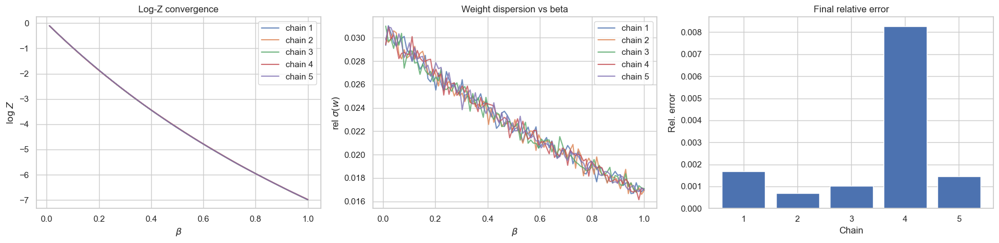


>>> Running with 200 beta steps
Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.100e-02  | <w> mean = 9.5028e-01
[beta=0.010]  mean log rho = -5.099e-02  | <w> mean = 9.5029e-01
[beta=0.015]  mean log rho = -5.078e-02  | <w> mean = 9.5049e-01
[beta=0.020]  mean log rho = -5.004e-02  | <w> mean = 9.5119e-01
[beta=0.025]  mean log rho = -4.969e-02  | <w> mean = 9.5152e-01
[beta=0.030]  mean log rho = -4.973e-02  | <w> mean = 9.5148e-01
[beta=0.035]  mean log rho = -4.950e-02  | <w> mean = 9.5171e-01
[beta=0.040]  mean log rho = -4.922e-02  | <w> mean = 9.5197e-01
[beta=0.045]  mean log rho = -4.893e-02  | <w> mean = 9.5225e-01
[19:38:40] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.876e-02  | <w> mean = 9.5241e-01
[beta=0.055]  mean log rho = -4.850e-02  | <w> mean = 9.5266e-01
[beta=0.060]  mean log rho = -4.807e-02  | <w> mean = 9.5306e-01
[beta=0.065]  mean log rho = -4.822e-02  | <w> mean = 9.5293e-01
[beta=0.070]  mean log rho = -4.818e-02  | <w> mean 

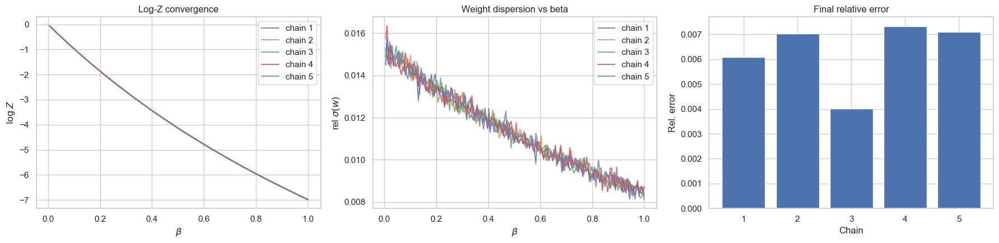

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.053e-02  | <w> mean = 9.5072e-01
[beta=0.010]  mean log rho = -5.084e-02  | <w> mean = 9.5043e-01
[beta=0.015]  mean log rho = -5.005e-02  | <w> mean = 9.5118e-01
[beta=0.020]  mean log rho = -4.969e-02  | <w> mean = 9.5153e-01
[beta=0.025]  mean log rho = -5.024e-02  | <w> mean = 9.5100e-01
[beta=0.030]  mean log rho = -4.929e-02  | <w> mean = 9.5190e-01
[beta=0.035]  mean log rho = -5.007e-02  | <w> mean = 9.5117e-01
[beta=0.040]  mean log rho = -4.949e-02  | <w> mean = 9.5171e-01
[beta=0.045]  mean log rho = -4.960e-02  | <w> mean = 9.5161e-01
[19:41:03] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.885e-02  | <w> mean = 9.5233e-01
[beta=0.055]  mean log rho = -4.930e-02  | <w> mean = 9.5189e-01
[beta=0.060]  mean log rho = -4.802e-02  | <w> mean = 9.5311e-01
[beta=0.065]  mean log rho = -4.814e-02  | <w> mean = 9.5300e-01
[beta=0.070]  mean log rho = -4.759e-02  | <w> mean = 9.5352e-01
[beta=0.075]  mean l

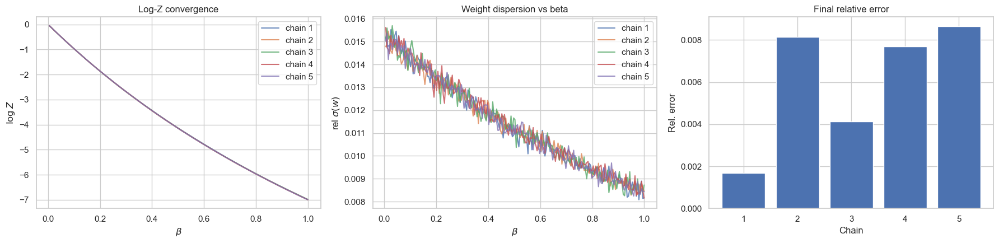

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.124e-02  | <w> mean = 9.5005e-01
[beta=0.010]  mean log rho = -5.107e-02  | <w> mean = 9.5022e-01
[beta=0.015]  mean log rho = -5.010e-02  | <w> mean = 9.5114e-01
[beta=0.020]  mean log rho = -4.979e-02  | <w> mean = 9.5143e-01
[beta=0.025]  mean log rho = -5.010e-02  | <w> mean = 9.5114e-01
[beta=0.030]  mean log rho = -4.988e-02  | <w> mean = 9.5135e-01
[beta=0.035]  mean log rho = -4.907e-02  | <w> mean = 9.5212e-01
[beta=0.040]  mean log rho = -4.987e-02  | <w> mean = 9.5136e-01
[beta=0.045]  mean log rho = -4.912e-02  | <w> mean = 9.5207e-01
[19:43:25] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.871e-02  | <w> mean = 9.5246e-01
[beta=0.055]  mean log rho = -4.877e-02  | <w> mean = 9.5240e-01
[beta=0.060]  mean log rho = -4.853e-02  | <w> mean = 9.5263e-01
[beta=0.065]  mean log rho = -4.803e-02  | <w> mean = 9.5310e-01
[beta=0.070]  mean log rho = -4.777e-02  | <w> mean = 9.5336e-01
[beta=0.075]  mean l

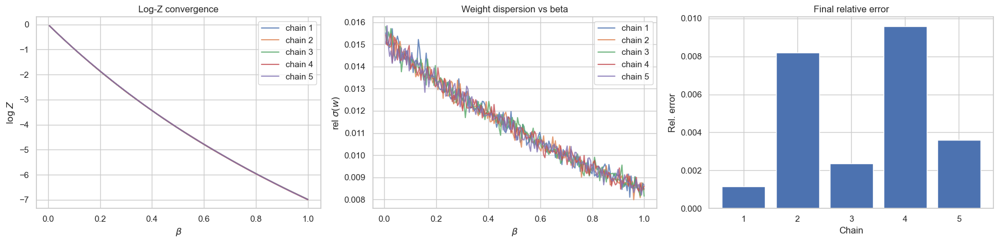

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.122e-02  | <w> mean = 9.5007e-01
[beta=0.010]  mean log rho = -5.089e-02  | <w> mean = 9.5039e-01
[beta=0.015]  mean log rho = -5.100e-02  | <w> mean = 9.5027e-01
[beta=0.020]  mean log rho = -4.997e-02  | <w> mean = 9.5126e-01
[beta=0.025]  mean log rho = -5.015e-02  | <w> mean = 9.5108e-01
[beta=0.030]  mean log rho = -4.919e-02  | <w> mean = 9.5200e-01
[beta=0.035]  mean log rho = -4.921e-02  | <w> mean = 9.5198e-01
[beta=0.040]  mean log rho = -4.897e-02  | <w> mean = 9.5221e-01
[beta=0.045]  mean log rho = -4.887e-02  | <w> mean = 9.5230e-01
[19:45:49] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.881e-02  | <w> mean = 9.5236e-01
[beta=0.055]  mean log rho = -4.902e-02  | <w> mean = 9.5216e-01
[beta=0.060]  mean log rho = -4.810e-02  | <w> mean = 9.5304e-01
[beta=0.065]  mean log rho = -4.806e-02  | <w> mean = 9.5308e-01
[beta=0.070]  mean log rho = -4.830e-02  | <w> mean = 9.5285e-01
[beta=0.075]  mean l

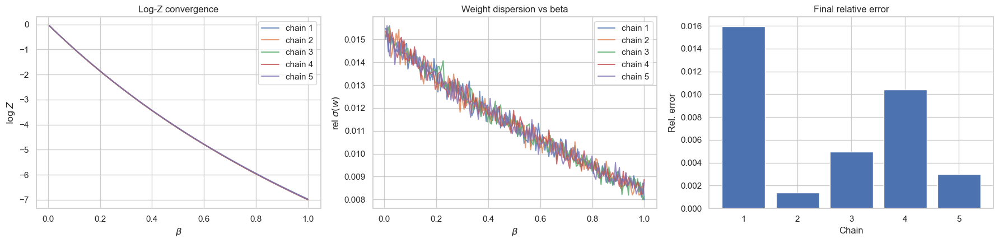

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.129e-02  | <w> mean = 9.5001e-01
[beta=0.010]  mean log rho = -5.058e-02  | <w> mean = 9.5068e-01
[beta=0.015]  mean log rho = -5.060e-02  | <w> mean = 9.5066e-01
[beta=0.020]  mean log rho = -5.079e-02  | <w> mean = 9.5047e-01
[beta=0.025]  mean log rho = -5.019e-02  | <w> mean = 9.5105e-01
[beta=0.030]  mean log rho = -4.985e-02  | <w> mean = 9.5137e-01
[beta=0.035]  mean log rho = -4.983e-02  | <w> mean = 9.5139e-01
[beta=0.040]  mean log rho = -4.934e-02  | <w> mean = 9.5186e-01
[beta=0.045]  mean log rho = -4.915e-02  | <w> mean = 9.5203e-01
[19:48:11] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.912e-02  | <w> mean = 9.5207e-01
[beta=0.055]  mean log rho = -4.890e-02  | <w> mean = 9.5227e-01
[beta=0.060]  mean log rho = -4.838e-02  | <w> mean = 9.5278e-01
[beta=0.065]  mean log rho = -4.832e-02  | <w> mean = 9.5283e-01
[beta=0.070]  mean log rho = -4.803e-02  | <w> mean = 9.5311e-01
[beta=0.075]  mean l

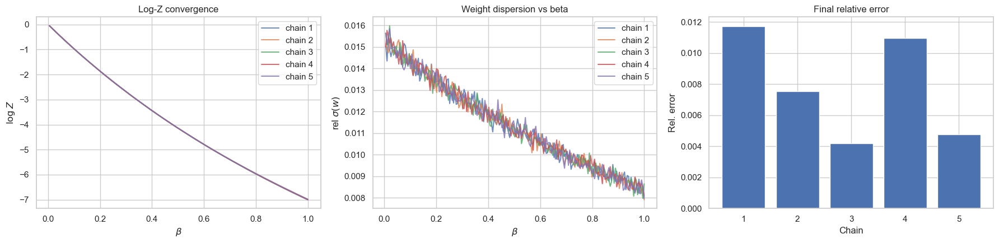

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.156e-02  | <w> mean = 9.4975e-01
[beta=0.010]  mean log rho = -5.050e-02  | <w> mean = 9.5075e-01
[beta=0.015]  mean log rho = -5.052e-02  | <w> mean = 9.5074e-01
[beta=0.020]  mean log rho = -4.982e-02  | <w> mean = 9.5140e-01
[beta=0.025]  mean log rho = -5.009e-02  | <w> mean = 9.5114e-01
[beta=0.030]  mean log rho = -4.891e-02  | <w> mean = 9.5227e-01
[beta=0.035]  mean log rho = -4.936e-02  | <w> mean = 9.5184e-01
[beta=0.040]  mean log rho = -4.938e-02  | <w> mean = 9.5182e-01
[beta=0.045]  mean log rho = -4.868e-02  | <w> mean = 9.5249e-01
[19:50:34] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.848e-02  | <w> mean = 9.5267e-01
[beta=0.055]  mean log rho = -4.853e-02  | <w> mean = 9.5263e-01
[beta=0.060]  mean log rho = -4.842e-02  | <w> mean = 9.5274e-01
[beta=0.065]  mean log rho = -4.824e-02  | <w> mean = 9.5290e-01
[beta=0.070]  mean log rho = -4.767e-02  | <w> mean = 9.5344e-01
[beta=0.075]  mean l

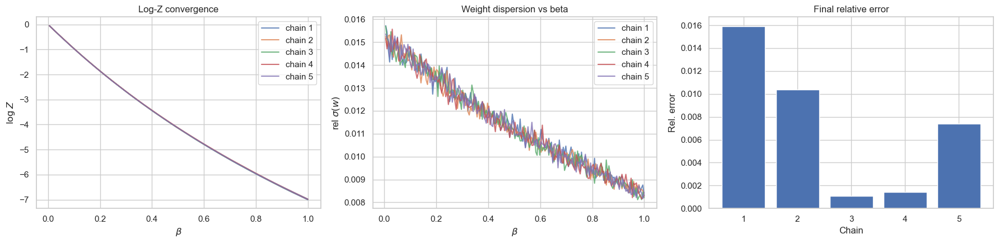

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.113e-02  | <w> mean = 9.5015e-01
[beta=0.010]  mean log rho = -5.074e-02  | <w> mean = 9.5052e-01
[beta=0.015]  mean log rho = -5.083e-02  | <w> mean = 9.5044e-01
[beta=0.020]  mean log rho = -5.052e-02  | <w> mean = 9.5074e-01
[beta=0.025]  mean log rho = -4.967e-02  | <w> mean = 9.5154e-01
[beta=0.030]  mean log rho = -5.008e-02  | <w> mean = 9.5116e-01
[beta=0.035]  mean log rho = -4.970e-02  | <w> mean = 9.5151e-01
[beta=0.040]  mean log rho = -4.886e-02  | <w> mean = 9.5232e-01
[beta=0.045]  mean log rho = -4.987e-02  | <w> mean = 9.5135e-01
[19:52:57] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.889e-02  | <w> mean = 9.5228e-01
[beta=0.055]  mean log rho = -4.838e-02  | <w> mean = 9.5277e-01
[beta=0.060]  mean log rho = -4.847e-02  | <w> mean = 9.5268e-01
[beta=0.065]  mean log rho = -4.870e-02  | <w> mean = 9.5247e-01
[beta=0.070]  mean log rho = -4.839e-02  | <w> mean = 9.5276e-01
[beta=0.075]  mean l

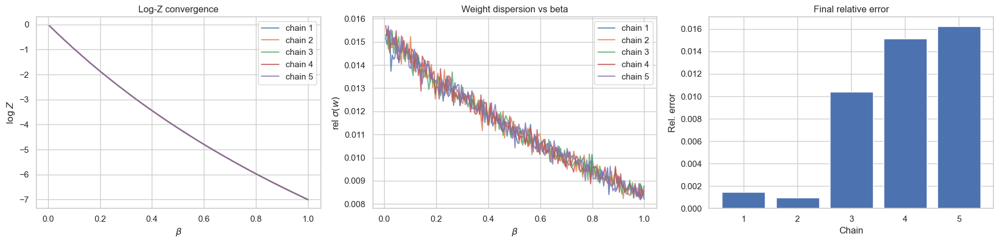

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.099e-02  | <w> mean = 9.5029e-01
[beta=0.010]  mean log rho = -5.033e-02  | <w> mean = 9.5092e-01
[beta=0.015]  mean log rho = -5.028e-02  | <w> mean = 9.5096e-01
[beta=0.020]  mean log rho = -5.025e-02  | <w> mean = 9.5099e-01
[beta=0.025]  mean log rho = -5.015e-02  | <w> mean = 9.5109e-01
[beta=0.030]  mean log rho = -4.996e-02  | <w> mean = 9.5127e-01
[beta=0.035]  mean log rho = -4.902e-02  | <w> mean = 9.5216e-01
[beta=0.040]  mean log rho = -4.972e-02  | <w> mean = 9.5150e-01
[beta=0.045]  mean log rho = -4.899e-02  | <w> mean = 9.5219e-01
[19:55:20] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.906e-02  | <w> mean = 9.5213e-01
[beta=0.055]  mean log rho = -4.817e-02  | <w> mean = 9.5297e-01
[beta=0.060]  mean log rho = -4.908e-02  | <w> mean = 9.5210e-01
[beta=0.065]  mean log rho = -4.850e-02  | <w> mean = 9.5265e-01
[beta=0.070]  mean log rho = -4.819e-02  | <w> mean = 9.5295e-01
[beta=0.075]  mean l

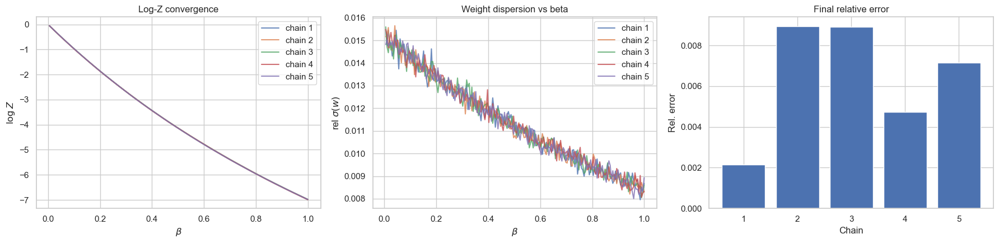

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.054e-02  | <w> mean = 9.5072e-01
[beta=0.010]  mean log rho = -5.071e-02  | <w> mean = 9.5056e-01
[beta=0.015]  mean log rho = -5.051e-02  | <w> mean = 9.5075e-01
[beta=0.020]  mean log rho = -5.048e-02  | <w> mean = 9.5077e-01
[beta=0.025]  mean log rho = -4.983e-02  | <w> mean = 9.5139e-01
[beta=0.030]  mean log rho = -5.019e-02  | <w> mean = 9.5105e-01
[beta=0.035]  mean log rho = -4.942e-02  | <w> mean = 9.5178e-01
[beta=0.040]  mean log rho = -4.966e-02  | <w> mean = 9.5155e-01
[beta=0.045]  mean log rho = -4.902e-02  | <w> mean = 9.5216e-01
[19:57:43] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.876e-02  | <w> mean = 9.5241e-01
[beta=0.055]  mean log rho = -4.896e-02  | <w> mean = 9.5222e-01
[beta=0.060]  mean log rho = -4.842e-02  | <w> mean = 9.5273e-01
[beta=0.065]  mean log rho = -4.866e-02  | <w> mean = 9.5250e-01
[beta=0.070]  mean log rho = -4.791e-02  | <w> mean = 9.5322e-01
[beta=0.075]  mean l

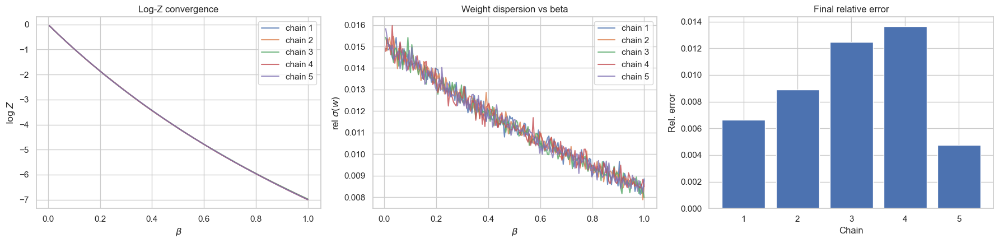

Running 5 AIS chains vectorized
[beta=0.005]  mean log rho = -5.070e-02  | <w> mean = 9.5056e-01
[beta=0.010]  mean log rho = -5.080e-02  | <w> mean = 9.5046e-01
[beta=0.015]  mean log rho = -5.070e-02  | <w> mean = 9.5056e-01
[beta=0.020]  mean log rho = -5.030e-02  | <w> mean = 9.5094e-01
[beta=0.025]  mean log rho = -5.011e-02  | <w> mean = 9.5112e-01
[beta=0.030]  mean log rho = -5.013e-02  | <w> mean = 9.5111e-01
[beta=0.035]  mean log rho = -4.958e-02  | <w> mean = 9.5163e-01
[beta=0.040]  mean log rho = -4.950e-02  | <w> mean = 9.5170e-01
[beta=0.045]  mean log rho = -4.913e-02  | <w> mean = 9.5205e-01
[20:00:06] beta step 10/199 (0.0503) 
[beta=0.050]  mean log rho = -4.918e-02  | <w> mean = 9.5201e-01
[beta=0.055]  mean log rho = -4.877e-02  | <w> mean = 9.5240e-01
[beta=0.060]  mean log rho = -4.877e-02  | <w> mean = 9.5240e-01
[beta=0.065]  mean log rho = -4.820e-02  | <w> mean = 9.5294e-01
[beta=0.070]  mean log rho = -4.808e-02  | <w> mean = 9.5306e-01
[beta=0.075]  mean l

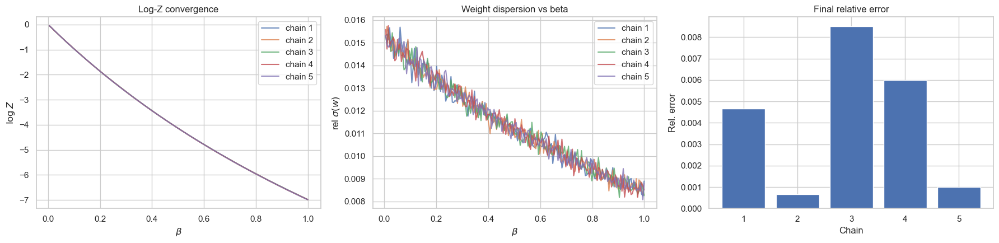

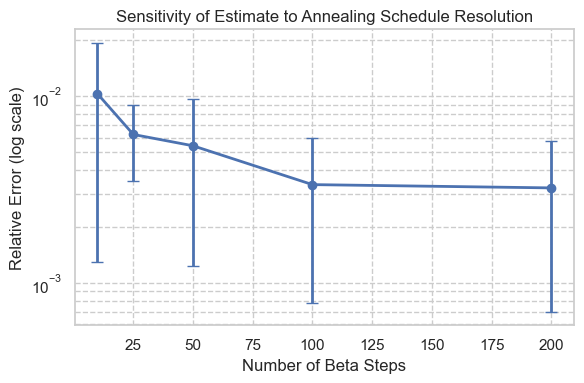

 Beta Steps  Mean Relative Error  Std Relative Error    Mean Ẑ   Std Ẑ
         10             0.010296            0.009000 490.036816 6.702059
         25             0.006235            0.002744 488.487322 2.900733
         50             0.005422            0.004187 489.757233 3.335931
        100             0.003359            0.002576 490.395926 2.059226
        200             0.003226            0.002525 490.064780 2.006474


,Beta Steps,Mean Relative Error,Std Relative Error,Mean Ẑ,Std Ẑ
0,10,0.010296,0.009000,490.036816,6.702059
1,25,0.006235,0.002744,488.487322,2.900733
2,50,0.005422,0.004187,489.757233,3.335931
3,100,0.003359,0.002576,490.395926,2.059226
4,200,0.003226,0.002525,490.064780,2.006474


In [7]:
def sensitivity_betas(dim=3, 
                      n_betas_list=[10, 25, 50, 100, 200], 
                      n_chains=5, 
                      iters=10_000,
                      burns=1000,
                      n_rounds=5,
                      n_trials=10):  # new: multiple trials
    print('\n>>> Building Tensor Network')
    G, tensors = build_3x3_grid_test(dim=dim)
    TRUE_Z = contract_tensor_network(G, tensors)
    tn = TensorNetwork(G, tensors)

    stats = []

    for n_betas in n_betas_list:
        print(f'\n>>> Running with {n_betas} beta steps')
        betas = np.linspace(0, 1, n_betas)

        rel_errors = []
        Z_means = []

        for trial in range(n_trials):
            try:
                mean_Z, std_Z = run_multiple_chains(
                    tn, betas,
                    n_chains=n_chains,
                    iters=iters,
                    burns=burns,
                    n_rounds=n_rounds,
                    Z_true=TRUE_Z
                )
                rel_error = np.abs(mean_Z - TRUE_Z) / np.abs(TRUE_Z)
                rel_errors.append(rel_error)
                Z_means.append(mean_Z)
            except Exception as e:
                print(f"[!] Trial {trial+1} failed for {n_betas} beta steps: {e}")

        if len(rel_errors) > 0:
            stats.append({
                'Beta Steps': n_betas,
                'Mean Relative Error': np.mean(rel_errors),
                'Std Relative Error': np.std(rel_errors),
                'Mean Ẑ': np.mean(Z_means),
                'Std Ẑ': np.std(Z_means)
            })

    df = pd.DataFrame(stats)

    sns.set_theme(style="whitegrid")
    plt.figure(figsize=(6, 4))
    plt.errorbar(df['Beta Steps'], df['Mean Relative Error'],
                 yerr=df['Std Relative Error'], fmt='o-', capsize=4, lw=2)
    plt.yscale('log')
    plt.xlabel('Number of Beta Steps')
    plt.ylabel('Relative Error (log scale)')
    plt.title('Sensitivity of Estimate to Annealing Schedule Resolution')
    plt.tight_layout()
    plt.grid(True, which="both", ls="--")
    plt.show()

    print(df.to_string(index=False, float_format='%.6f'))
    return df

sensitivity_betas()


>>> Building Tensor Network

>>> Running with 1 AIS chains
Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.303e-02  | <w> mean = 9.2033e-01
[beta=0.020]  mean log rho = -8.313e-02  | <w> mean = 9.2023e-01
[beta=0.030]  mean log rho = -8.360e-02  | <w> mean = 9.1980e-01
[beta=0.040]  mean log rho = -8.079e-02  | <w> mean = 9.2239e-01
[beta=0.051]  mean log rho = -7.963e-02  | <w> mean = 9.2346e-01
[beta=0.061]  mean log rho = -8.024e-02  | <w> mean = 9.2289e-01
[beta=0.071]  mean log rho = -7.950e-02  | <w> mean = 9.2358e-01
[beta=0.081]  mean log rho = -7.803e-02  | <w> mean = 9.2493e-01
[beta=0.091]  mean log rho = -7.777e-02  | <w> mean = 9.2517e-01
[20:02:26] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.828e-02  | <w> mean = 9.2470e-01
[beta=0.111]  mean log rho = -7.929e-02  | <w> mean = 9.2377e-01
[beta=0.121]  mean log rho = -7.624e-02  | <w> mean = 9.2659e-01
[beta=0.131]  mean log rho = -7.654e-02  | <w> mean = 9.2631e-01
[beta=0.141]  mean log rho

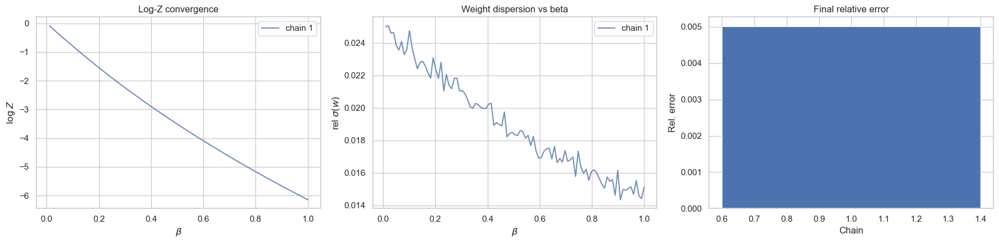

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.391e-02  | <w> mean = 9.1951e-01
[beta=0.020]  mean log rho = -8.310e-02  | <w> mean = 9.2026e-01
[beta=0.030]  mean log rho = -8.312e-02  | <w> mean = 9.2024e-01
[beta=0.040]  mean log rho = -8.341e-02  | <w> mean = 9.1998e-01
[beta=0.051]  mean log rho = -8.127e-02  | <w> mean = 9.2195e-01
[beta=0.061]  mean log rho = -7.938e-02  | <w> mean = 9.2369e-01
[beta=0.071]  mean log rho = -8.006e-02  | <w> mean = 9.2306e-01
[beta=0.081]  mean log rho = -7.786e-02  | <w> mean = 9.2509e-01
[beta=0.091]  mean log rho = -7.909e-02  | <w> mean = 9.2396e-01
[20:03:09] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.823e-02  | <w> mean = 9.2475e-01
[beta=0.111]  mean log rho = -7.955e-02  | <w> mean = 9.2353e-01
[beta=0.121]  mean log rho = -7.787e-02  | <w> mean = 9.2508e-01
[beta=0.131]  mean log rho = -7.592e-02  | <w> mean = 9.2689e-01
[beta=0.141]  mean log rho = -7.579e-02  | <w> mean = 9.2701e-01
[beta=0.152]  mean lo

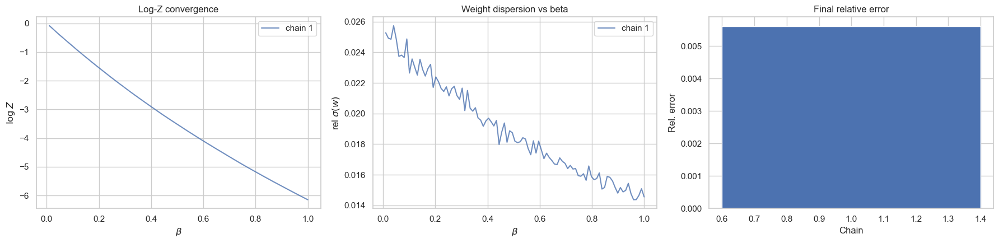

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.408e-02  | <w> mean = 9.1935e-01
[beta=0.020]  mean log rho = -8.388e-02  | <w> mean = 9.1955e-01
[beta=0.030]  mean log rho = -8.383e-02  | <w> mean = 9.1959e-01
[beta=0.040]  mean log rho = -8.129e-02  | <w> mean = 9.2193e-01
[beta=0.051]  mean log rho = -8.285e-02  | <w> mean = 9.2049e-01
[beta=0.061]  mean log rho = -8.072e-02  | <w> mean = 9.2245e-01
[beta=0.071]  mean log rho = -8.013e-02  | <w> mean = 9.2300e-01
[beta=0.081]  mean log rho = -8.037e-02  | <w> mean = 9.2278e-01
[beta=0.091]  mean log rho = -7.894e-02  | <w> mean = 9.2410e-01
[20:03:52] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.867e-02  | <w> mean = 9.2434e-01
[beta=0.111]  mean log rho = -7.755e-02  | <w> mean = 9.2538e-01
[beta=0.121]  mean log rho = -7.634e-02  | <w> mean = 9.2650e-01
[beta=0.131]  mean log rho = -7.655e-02  | <w> mean = 9.2631e-01
[beta=0.141]  mean log rho = -7.668e-02  | <w> mean = 9.2619e-01
[beta=0.152]  mean lo

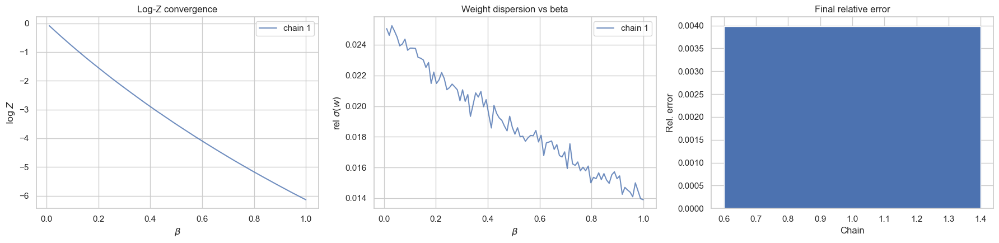

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.427e-02  | <w> mean = 9.1918e-01
[beta=0.020]  mean log rho = -8.226e-02  | <w> mean = 9.2103e-01
[beta=0.030]  mean log rho = -8.281e-02  | <w> mean = 9.2052e-01
[beta=0.040]  mean log rho = -8.123e-02  | <w> mean = 9.2198e-01
[beta=0.051]  mean log rho = -7.984e-02  | <w> mean = 9.2326e-01
[beta=0.061]  mean log rho = -8.148e-02  | <w> mean = 9.2175e-01
[beta=0.071]  mean log rho = -8.123e-02  | <w> mean = 9.2198e-01
[beta=0.081]  mean log rho = -8.004e-02  | <w> mean = 9.2308e-01
[beta=0.091]  mean log rho = -7.866e-02  | <w> mean = 9.2435e-01
[20:04:34] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.831e-02  | <w> mean = 9.2468e-01
[beta=0.111]  mean log rho = -7.857e-02  | <w> mean = 9.2444e-01
[beta=0.121]  mean log rho = -7.770e-02  | <w> mean = 9.2524e-01
[beta=0.131]  mean log rho = -7.713e-02  | <w> mean = 9.2577e-01
[beta=0.141]  mean log rho = -7.476e-02  | <w> mean = 9.2797e-01
[beta=0.152]  mean lo

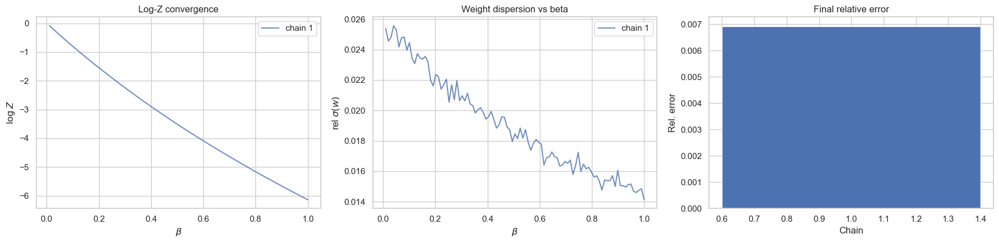

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.482e-02  | <w> mean = 9.1867e-01
[beta=0.020]  mean log rho = -8.532e-02  | <w> mean = 9.1822e-01
[beta=0.030]  mean log rho = -8.280e-02  | <w> mean = 9.2053e-01
[beta=0.040]  mean log rho = -8.195e-02  | <w> mean = 9.2132e-01
[beta=0.051]  mean log rho = -8.163e-02  | <w> mean = 9.2161e-01
[beta=0.061]  mean log rho = -8.066e-02  | <w> mean = 9.2251e-01
[beta=0.071]  mean log rho = -7.990e-02  | <w> mean = 9.2321e-01
[beta=0.081]  mean log rho = -7.902e-02  | <w> mean = 9.2402e-01
[beta=0.091]  mean log rho = -7.772e-02  | <w> mean = 9.2522e-01
[20:05:17] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.726e-02  | <w> mean = 9.2565e-01
[beta=0.111]  mean log rho = -7.699e-02  | <w> mean = 9.2589e-01
[beta=0.121]  mean log rho = -7.574e-02  | <w> mean = 9.2706e-01
[beta=0.131]  mean log rho = -7.784e-02  | <w> mean = 9.2511e-01
[beta=0.141]  mean log rho = -7.519e-02  | <w> mean = 9.2756e-01
[beta=0.152]  mean lo

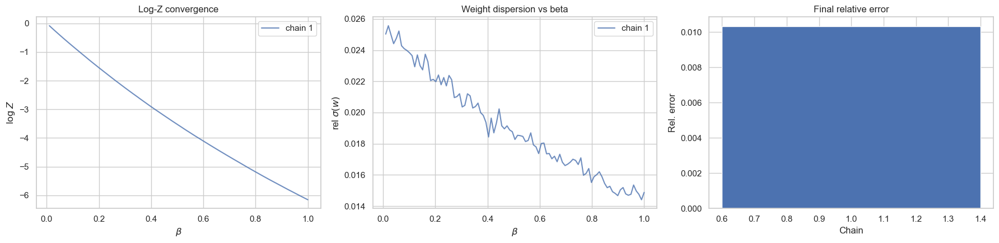

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.398e-02  | <w> mean = 9.1945e-01
[beta=0.020]  mean log rho = -8.294e-02  | <w> mean = 9.2040e-01
[beta=0.030]  mean log rho = -8.255e-02  | <w> mean = 9.2077e-01
[beta=0.040]  mean log rho = -8.201e-02  | <w> mean = 9.2126e-01
[beta=0.051]  mean log rho = -8.216e-02  | <w> mean = 9.2112e-01
[beta=0.061]  mean log rho = -8.159e-02  | <w> mean = 9.2165e-01
[beta=0.071]  mean log rho = -7.979e-02  | <w> mean = 9.2331e-01
[beta=0.081]  mean log rho = -7.830e-02  | <w> mean = 9.2469e-01
[beta=0.091]  mean log rho = -8.109e-02  | <w> mean = 9.2211e-01
[20:06:00] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.859e-02  | <w> mean = 9.2441e-01
[beta=0.111]  mean log rho = -7.820e-02  | <w> mean = 9.2478e-01
[beta=0.121]  mean log rho = -7.816e-02  | <w> mean = 9.2482e-01
[beta=0.131]  mean log rho = -7.718e-02  | <w> mean = 9.2572e-01
[beta=0.141]  mean log rho = -7.601e-02  | <w> mean = 9.2681e-01
[beta=0.152]  mean lo

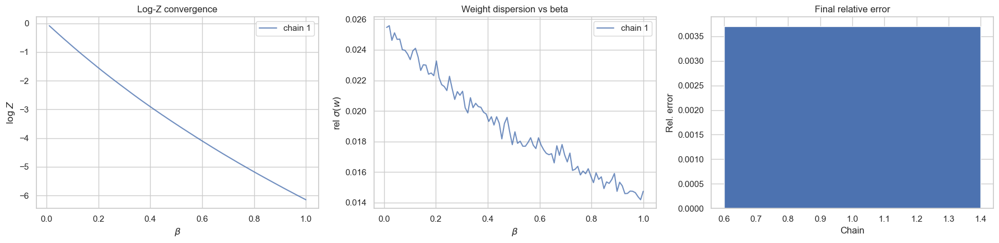

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.429e-02  | <w> mean = 9.1917e-01
[beta=0.020]  mean log rho = -8.619e-02  | <w> mean = 9.1742e-01
[beta=0.030]  mean log rho = -8.253e-02  | <w> mean = 9.2078e-01
[beta=0.040]  mean log rho = -8.002e-02  | <w> mean = 9.2310e-01
[beta=0.051]  mean log rho = -8.135e-02  | <w> mean = 9.2187e-01
[beta=0.061]  mean log rho = -8.119e-02  | <w> mean = 9.2202e-01
[beta=0.071]  mean log rho = -8.004e-02  | <w> mean = 9.2308e-01
[beta=0.081]  mean log rho = -8.234e-02  | <w> mean = 9.2096e-01
[beta=0.091]  mean log rho = -7.860e-02  | <w> mean = 9.2441e-01
[20:06:43] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.780e-02  | <w> mean = 9.2515e-01
[beta=0.111]  mean log rho = -7.792e-02  | <w> mean = 9.2504e-01
[beta=0.121]  mean log rho = -7.755e-02  | <w> mean = 9.2538e-01
[beta=0.131]  mean log rho = -7.850e-02  | <w> mean = 9.2450e-01
[beta=0.141]  mean log rho = -7.782e-02  | <w> mean = 9.2513e-01
[beta=0.152]  mean lo

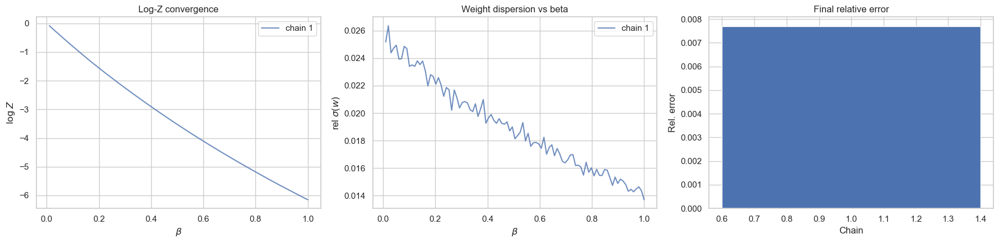

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.403e-02  | <w> mean = 9.1940e-01
[beta=0.020]  mean log rho = -8.201e-02  | <w> mean = 9.2127e-01
[beta=0.030]  mean log rho = -8.253e-02  | <w> mean = 9.2078e-01
[beta=0.040]  mean log rho = -8.059e-02  | <w> mean = 9.2257e-01
[beta=0.051]  mean log rho = -8.170e-02  | <w> mean = 9.2155e-01
[beta=0.061]  mean log rho = -8.147e-02  | <w> mean = 9.2176e-01
[beta=0.071]  mean log rho = -7.984e-02  | <w> mean = 9.2327e-01
[beta=0.081]  mean log rho = -7.873e-02  | <w> mean = 9.2429e-01
[beta=0.091]  mean log rho = -7.789e-02  | <w> mean = 9.2507e-01
[20:07:26] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.765e-02  | <w> mean = 9.2529e-01
[beta=0.111]  mean log rho = -7.642e-02  | <w> mean = 9.2642e-01
[beta=0.121]  mean log rho = -7.663e-02  | <w> mean = 9.2623e-01
[beta=0.131]  mean log rho = -7.675e-02  | <w> mean = 9.2612e-01
[beta=0.141]  mean log rho = -7.713e-02  | <w> mean = 9.2577e-01
[beta=0.152]  mean lo

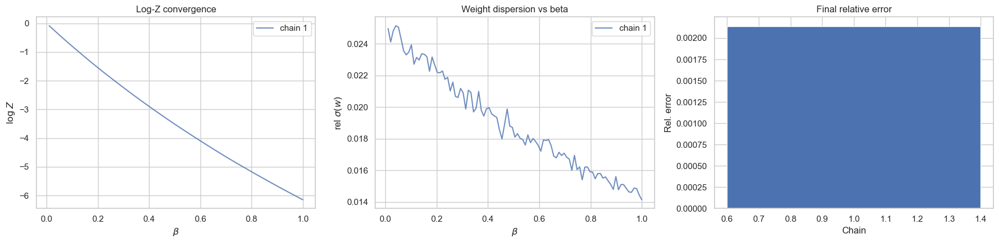

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.277e-02  | <w> mean = 9.2056e-01
[beta=0.020]  mean log rho = -8.402e-02  | <w> mean = 9.1942e-01
[beta=0.030]  mean log rho = -8.040e-02  | <w> mean = 9.2275e-01
[beta=0.040]  mean log rho = -8.202e-02  | <w> mean = 9.2126e-01
[beta=0.051]  mean log rho = -7.998e-02  | <w> mean = 9.2313e-01
[beta=0.061]  mean log rho = -8.085e-02  | <w> mean = 9.2233e-01
[beta=0.071]  mean log rho = -8.131e-02  | <w> mean = 9.2191e-01
[beta=0.081]  mean log rho = -7.945e-02  | <w> mean = 9.2362e-01
[beta=0.091]  mean log rho = -7.992e-02  | <w> mean = 9.2319e-01
[20:08:09] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.904e-02  | <w> mean = 9.2400e-01
[beta=0.111]  mean log rho = -7.723e-02  | <w> mean = 9.2568e-01
[beta=0.121]  mean log rho = -7.747e-02  | <w> mean = 9.2546e-01
[beta=0.131]  mean log rho = -7.871e-02  | <w> mean = 9.2430e-01
[beta=0.141]  mean log rho = -7.778e-02  | <w> mean = 9.2517e-01
[beta=0.152]  mean lo

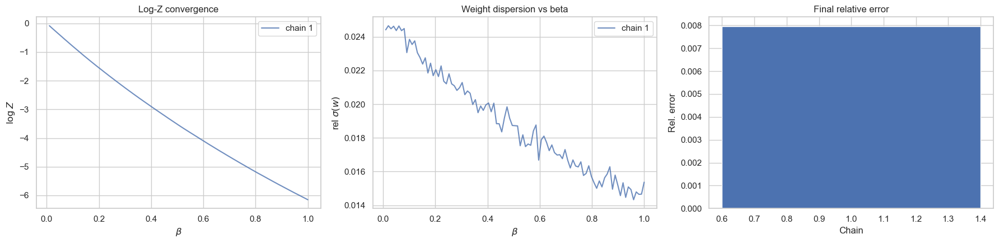

Running 1 AIS chains vectorized
[beta=0.010]  mean log rho = -8.281e-02  | <w> mean = 9.2053e-01
[beta=0.020]  mean log rho = -8.304e-02  | <w> mean = 9.2031e-01
[beta=0.030]  mean log rho = -8.373e-02  | <w> mean = 9.1968e-01
[beta=0.040]  mean log rho = -8.155e-02  | <w> mean = 9.2168e-01
[beta=0.051]  mean log rho = -8.080e-02  | <w> mean = 9.2237e-01
[beta=0.061]  mean log rho = -8.074e-02  | <w> mean = 9.2243e-01
[beta=0.071]  mean log rho = -8.080e-02  | <w> mean = 9.2238e-01
[beta=0.081]  mean log rho = -7.991e-02  | <w> mean = 9.2320e-01
[beta=0.091]  mean log rho = -7.735e-02  | <w> mean = 9.2556e-01
[20:08:53] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.106e-02  | <w> mean = 9.2214e-01
[beta=0.111]  mean log rho = -7.652e-02  | <w> mean = 9.2633e-01
[beta=0.121]  mean log rho = -7.608e-02  | <w> mean = 9.2674e-01
[beta=0.131]  mean log rho = -7.738e-02  | <w> mean = 9.2554e-01
[beta=0.141]  mean log rho = -7.576e-02  | <w> mean = 9.2704e-01
[beta=0.152]  mean lo

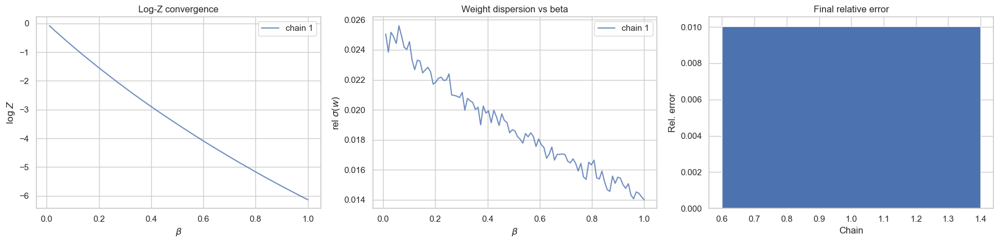


>>> Running with 3 AIS chains
Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.285e-02  | <w> mean = 9.2049e-01
[beta=0.020]  mean log rho = -8.312e-02  | <w> mean = 9.2024e-01
[beta=0.030]  mean log rho = -8.221e-02  | <w> mean = 9.2108e-01
[beta=0.040]  mean log rho = -8.161e-02  | <w> mean = 9.2163e-01
[beta=0.051]  mean log rho = -8.210e-02  | <w> mean = 9.2118e-01
[beta=0.061]  mean log rho = -8.170e-02  | <w> mean = 9.2154e-01
[beta=0.071]  mean log rho = -8.080e-02  | <w> mean = 9.2238e-01
[beta=0.081]  mean log rho = -8.037e-02  | <w> mean = 9.2278e-01
[beta=0.091]  mean log rho = -7.915e-02  | <w> mean = 9.2390e-01
[20:09:38] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.984e-02  | <w> mean = 9.2327e-01
[beta=0.111]  mean log rho = -7.881e-02  | <w> mean = 9.2422e-01
[beta=0.121]  mean log rho = -7.902e-02  | <w> mean = 9.2402e-01
[beta=0.131]  mean log rho = -7.912e-02  | <w> mean = 9.2393e-01
[beta=0.141]  mean log rho = -7.795e-02  | <w> mean = 9

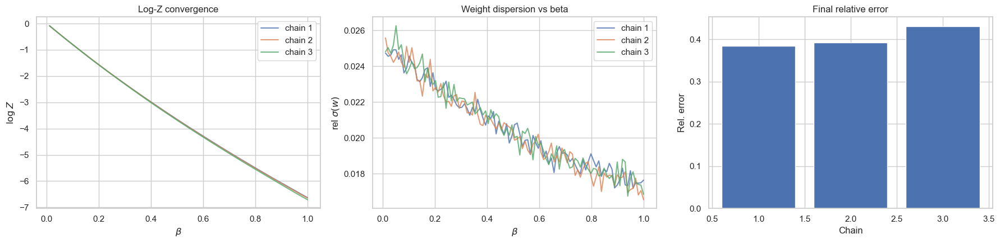

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.309e-02  | <w> mean = 9.2027e-01
[beta=0.020]  mean log rho = -8.297e-02  | <w> mean = 9.2038e-01
[beta=0.030]  mean log rho = -8.218e-02  | <w> mean = 9.2110e-01
[beta=0.040]  mean log rho = -8.284e-02  | <w> mean = 9.2050e-01
[beta=0.051]  mean log rho = -8.197e-02  | <w> mean = 9.2130e-01
[beta=0.061]  mean log rho = -8.111e-02  | <w> mean = 9.2209e-01
[beta=0.071]  mean log rho = -8.096e-02  | <w> mean = 9.2223e-01
[beta=0.081]  mean log rho = -8.002e-02  | <w> mean = 9.2310e-01
[beta=0.091]  mean log rho = -8.070e-02  | <w> mean = 9.2248e-01
[20:10:36] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.006e-02  | <w> mean = 9.2306e-01
[beta=0.111]  mean log rho = -7.894e-02  | <w> mean = 9.2410e-01
[beta=0.121]  mean log rho = -7.879e-02  | <w> mean = 9.2424e-01
[beta=0.131]  mean log rho = -7.803e-02  | <w> mean = 9.2493e-01
[beta=0.141]  mean log rho = -7.747e-02  | <w> mean = 9.2545e-01
[beta=0.152]  mean lo

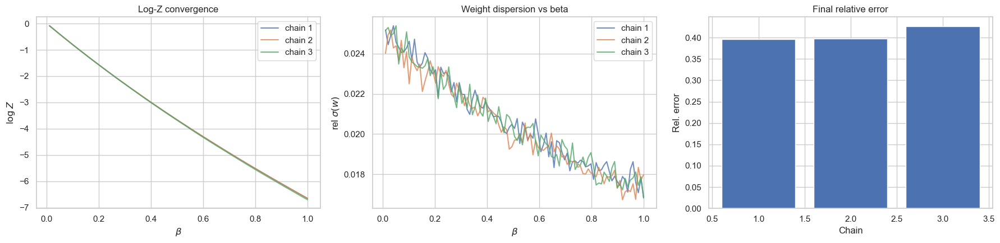

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.335e-02  | <w> mean = 9.2003e-01
[beta=0.020]  mean log rho = -8.290e-02  | <w> mean = 9.2045e-01
[beta=0.030]  mean log rho = -8.293e-02  | <w> mean = 9.2042e-01
[beta=0.040]  mean log rho = -8.194e-02  | <w> mean = 9.2132e-01
[beta=0.051]  mean log rho = -8.177e-02  | <w> mean = 9.2148e-01
[beta=0.061]  mean log rho = -8.209e-02  | <w> mean = 9.2119e-01
[beta=0.071]  mean log rho = -8.196e-02  | <w> mean = 9.2131e-01
[beta=0.081]  mean log rho = -8.116e-02  | <w> mean = 9.2205e-01
[beta=0.091]  mean log rho = -8.016e-02  | <w> mean = 9.2297e-01
[20:11:33] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.950e-02  | <w> mean = 9.2358e-01
[beta=0.111]  mean log rho = -7.894e-02  | <w> mean = 9.2410e-01
[beta=0.121]  mean log rho = -7.877e-02  | <w> mean = 9.2426e-01
[beta=0.131]  mean log rho = -7.834e-02  | <w> mean = 9.2465e-01
[beta=0.141]  mean log rho = -7.843e-02  | <w> mean = 9.2456e-01
[beta=0.152]  mean lo

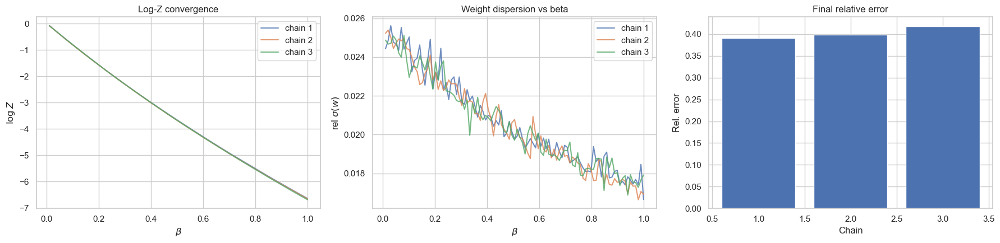

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.312e-02  | <w> mean = 9.2024e-01
[beta=0.020]  mean log rho = -8.267e-02  | <w> mean = 9.2065e-01
[beta=0.030]  mean log rho = -8.315e-02  | <w> mean = 9.2021e-01
[beta=0.040]  mean log rho = -8.253e-02  | <w> mean = 9.2078e-01
[beta=0.051]  mean log rho = -8.235e-02  | <w> mean = 9.2095e-01
[beta=0.061]  mean log rho = -8.079e-02  | <w> mean = 9.2239e-01
[beta=0.071]  mean log rho = -8.221e-02  | <w> mean = 9.2108e-01
[beta=0.081]  mean log rho = -8.077e-02  | <w> mean = 9.2241e-01
[beta=0.091]  mean log rho = -7.914e-02  | <w> mean = 9.2391e-01
[20:12:30] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.990e-02  | <w> mean = 9.2321e-01
[beta=0.111]  mean log rho = -7.836e-02  | <w> mean = 9.2463e-01
[beta=0.121]  mean log rho = -7.800e-02  | <w> mean = 9.2496e-01
[beta=0.131]  mean log rho = -7.761e-02  | <w> mean = 9.2532e-01
[beta=0.141]  mean log rho = -7.709e-02  | <w> mean = 9.2581e-01
[beta=0.152]  mean lo

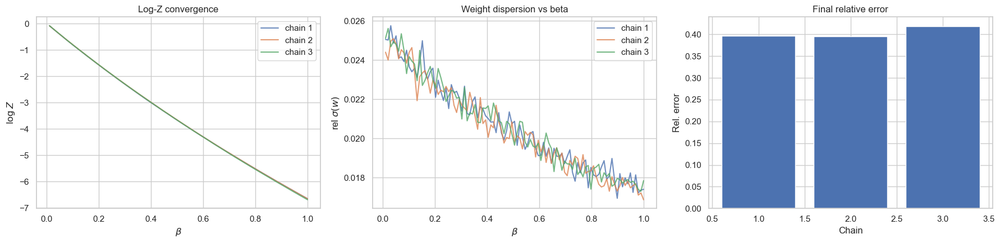

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.323e-02  | <w> mean = 9.2014e-01
[beta=0.020]  mean log rho = -8.184e-02  | <w> mean = 9.2142e-01
[beta=0.030]  mean log rho = -8.374e-02  | <w> mean = 9.1967e-01
[beta=0.040]  mean log rho = -8.215e-02  | <w> mean = 9.2114e-01
[beta=0.051]  mean log rho = -8.292e-02  | <w> mean = 9.2043e-01
[beta=0.061]  mean log rho = -8.240e-02  | <w> mean = 9.2090e-01
[beta=0.071]  mean log rho = -8.049e-02  | <w> mean = 9.2267e-01
[beta=0.081]  mean log rho = -8.047e-02  | <w> mean = 9.2268e-01
[beta=0.091]  mean log rho = -8.000e-02  | <w> mean = 9.2312e-01
[20:13:27] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -8.058e-02  | <w> mean = 9.2258e-01
[beta=0.111]  mean log rho = -7.934e-02  | <w> mean = 9.2372e-01
[beta=0.121]  mean log rho = -7.785e-02  | <w> mean = 9.2510e-01
[beta=0.131]  mean log rho = -7.894e-02  | <w> mean = 9.2410e-01
[beta=0.141]  mean log rho = -7.822e-02  | <w> mean = 9.2476e-01
[beta=0.152]  mean lo

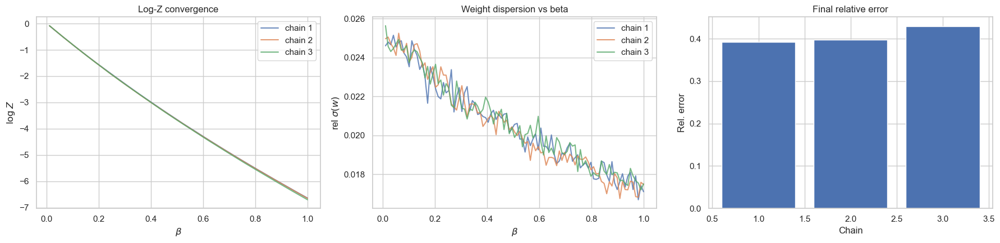

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.339e-02  | <w> mean = 9.2000e-01
[beta=0.020]  mean log rho = -8.318e-02  | <w> mean = 9.2019e-01
[beta=0.030]  mean log rho = -8.225e-02  | <w> mean = 9.2104e-01
[beta=0.040]  mean log rho = -8.166e-02  | <w> mean = 9.2158e-01
[beta=0.051]  mean log rho = -8.122e-02  | <w> mean = 9.2199e-01
[beta=0.061]  mean log rho = -8.127e-02  | <w> mean = 9.2194e-01
[beta=0.071]  mean log rho = -8.070e-02  | <w> mean = 9.2247e-01
[beta=0.081]  mean log rho = -8.023e-02  | <w> mean = 9.2290e-01
[beta=0.091]  mean log rho = -7.997e-02  | <w> mean = 9.2315e-01
[20:14:24] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.902e-02  | <w> mean = 9.2403e-01
[beta=0.111]  mean log rho = -7.886e-02  | <w> mean = 9.2417e-01
[beta=0.121]  mean log rho = -7.935e-02  | <w> mean = 9.2372e-01
[beta=0.131]  mean log rho = -7.800e-02  | <w> mean = 9.2497e-01
[beta=0.141]  mean log rho = -7.846e-02  | <w> mean = 9.2454e-01
[beta=0.152]  mean lo

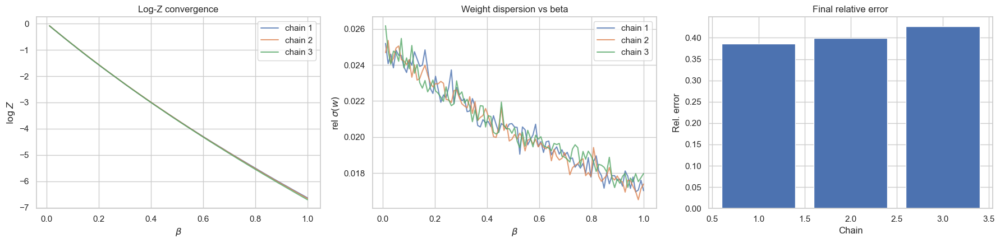

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.423e-02  | <w> mean = 9.1922e-01
[beta=0.020]  mean log rho = -8.371e-02  | <w> mean = 9.1970e-01
[beta=0.030]  mean log rho = -8.264e-02  | <w> mean = 9.2068e-01
[beta=0.040]  mean log rho = -8.259e-02  | <w> mean = 9.2073e-01
[beta=0.051]  mean log rho = -8.173e-02  | <w> mean = 9.2152e-01
[beta=0.061]  mean log rho = -8.119e-02  | <w> mean = 9.2202e-01
[beta=0.071]  mean log rho = -8.131e-02  | <w> mean = 9.2191e-01
[beta=0.081]  mean log rho = -8.002e-02  | <w> mean = 9.2310e-01
[beta=0.091]  mean log rho = -8.003e-02  | <w> mean = 9.2309e-01
[20:15:21] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.993e-02  | <w> mean = 9.2318e-01
[beta=0.111]  mean log rho = -7.962e-02  | <w> mean = 9.2347e-01
[beta=0.121]  mean log rho = -7.911e-02  | <w> mean = 9.2394e-01
[beta=0.131]  mean log rho = -7.819e-02  | <w> mean = 9.2479e-01
[beta=0.141]  mean log rho = -7.845e-02  | <w> mean = 9.2455e-01
[beta=0.152]  mean lo

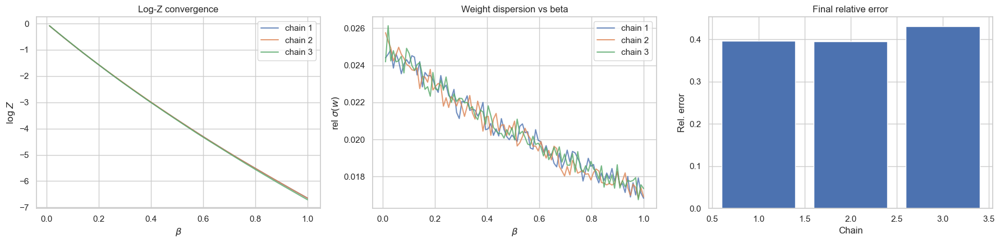

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.337e-02  | <w> mean = 9.2001e-01
[beta=0.020]  mean log rho = -8.260e-02  | <w> mean = 9.2072e-01
[beta=0.030]  mean log rho = -8.182e-02  | <w> mean = 9.2144e-01
[beta=0.040]  mean log rho = -8.204e-02  | <w> mean = 9.2124e-01
[beta=0.051]  mean log rho = -8.105e-02  | <w> mean = 9.2215e-01
[beta=0.061]  mean log rho = -8.187e-02  | <w> mean = 9.2139e-01
[beta=0.071]  mean log rho = -8.141e-02  | <w> mean = 9.2182e-01
[beta=0.081]  mean log rho = -8.077e-02  | <w> mean = 9.2241e-01
[beta=0.091]  mean log rho = -7.940e-02  | <w> mean = 9.2367e-01
[20:16:18] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.983e-02  | <w> mean = 9.2328e-01
[beta=0.111]  mean log rho = -7.801e-02  | <w> mean = 9.2496e-01
[beta=0.121]  mean log rho = -7.827e-02  | <w> mean = 9.2472e-01
[beta=0.131]  mean log rho = -7.826e-02  | <w> mean = 9.2472e-01
[beta=0.141]  mean log rho = -7.753e-02  | <w> mean = 9.2540e-01
[beta=0.152]  mean lo

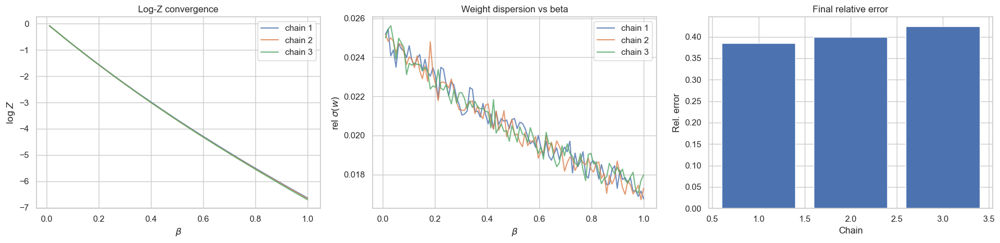

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.408e-02  | <w> mean = 9.1936e-01
[beta=0.020]  mean log rho = -8.295e-02  | <w> mean = 9.2039e-01
[beta=0.030]  mean log rho = -8.276e-02  | <w> mean = 9.2057e-01
[beta=0.040]  mean log rho = -8.164e-02  | <w> mean = 9.2160e-01
[beta=0.051]  mean log rho = -8.141e-02  | <w> mean = 9.2181e-01
[beta=0.061]  mean log rho = -8.026e-02  | <w> mean = 9.2288e-01
[beta=0.071]  mean log rho = -8.089e-02  | <w> mean = 9.2230e-01
[beta=0.081]  mean log rho = -8.104e-02  | <w> mean = 9.2216e-01
[beta=0.091]  mean log rho = -8.092e-02  | <w> mean = 9.2227e-01
[20:17:28] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.990e-02  | <w> mean = 9.2321e-01
[beta=0.111]  mean log rho = -7.884e-02  | <w> mean = 9.2419e-01
[beta=0.121]  mean log rho = -7.800e-02  | <w> mean = 9.2497e-01
[beta=0.131]  mean log rho = -7.839e-02  | <w> mean = 9.2460e-01
[beta=0.141]  mean log rho = -7.850e-02  | <w> mean = 9.2450e-01
[beta=0.152]  mean lo

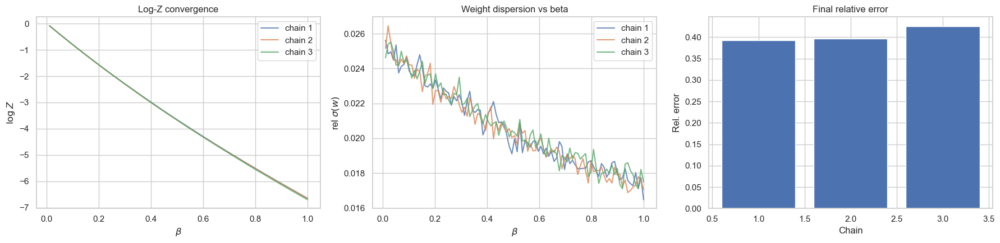

Running 3 AIS chains vectorized
[beta=0.010]  mean log rho = -8.341e-02  | <w> mean = 9.1997e-01
[beta=0.020]  mean log rho = -8.209e-02  | <w> mean = 9.2119e-01
[beta=0.030]  mean log rho = -8.313e-02  | <w> mean = 9.2023e-01
[beta=0.040]  mean log rho = -8.306e-02  | <w> mean = 9.2029e-01
[beta=0.051]  mean log rho = -8.145e-02  | <w> mean = 9.2178e-01
[beta=0.061]  mean log rho = -8.116e-02  | <w> mean = 9.2205e-01
[beta=0.071]  mean log rho = -8.092e-02  | <w> mean = 9.2227e-01
[beta=0.081]  mean log rho = -8.030e-02  | <w> mean = 9.2284e-01
[beta=0.091]  mean log rho = -7.970e-02  | <w> mean = 9.2339e-01
[20:19:06] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.973e-02  | <w> mean = 9.2337e-01
[beta=0.111]  mean log rho = -7.888e-02  | <w> mean = 9.2415e-01
[beta=0.121]  mean log rho = -7.904e-02  | <w> mean = 9.2400e-01
[beta=0.131]  mean log rho = -7.849e-02  | <w> mean = 9.2451e-01
[beta=0.141]  mean log rho = -7.836e-02  | <w> mean = 9.2464e-01
[beta=0.152]  mean lo

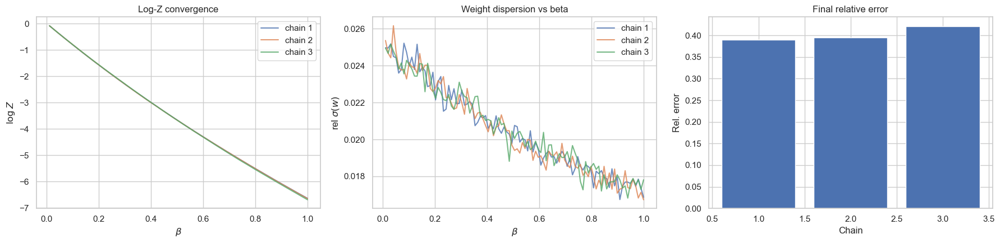


>>> Running with 5 AIS chains
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.356e-02  | <w> mean = 9.1984e-01
[beta=0.020]  mean log rho = -8.253e-02  | <w> mean = 9.2078e-01
[beta=0.030]  mean log rho = -8.274e-02  | <w> mean = 9.2059e-01
[beta=0.040]  mean log rho = -8.188e-02  | <w> mean = 9.2139e-01
[beta=0.051]  mean log rho = -8.039e-02  | <w> mean = 9.2275e-01
[beta=0.061]  mean log rho = -8.068e-02  | <w> mean = 9.2249e-01
[beta=0.071]  mean log rho = -8.084e-02  | <w> mean = 9.2234e-01
[beta=0.081]  mean log rho = -7.981e-02  | <w> mean = 9.2329e-01
[beta=0.091]  mean log rho = -7.868e-02  | <w> mean = 9.2434e-01
[20:20:47] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.749e-02  | <w> mean = 9.2543e-01
[beta=0.111]  mean log rho = -7.802e-02  | <w> mean = 9.2494e-01
[beta=0.121]  mean log rho = -7.661e-02  | <w> mean = 9.2625e-01
[beta=0.131]  mean log rho = -7.606e-02  | <w> mean = 9.2676e-01
[beta=0.141]  mean log rho = -7.579e-02  | <w> mean = 9

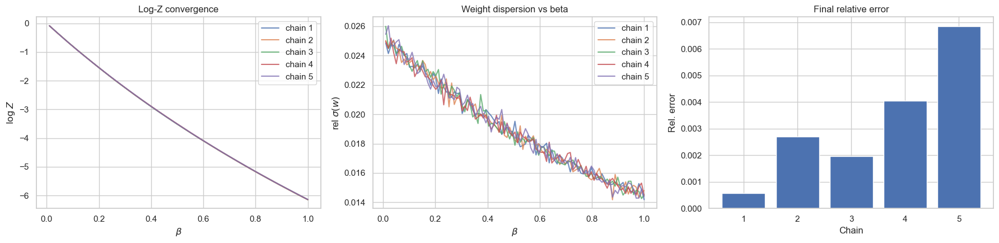

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.268e-02  | <w> mean = 9.2065e-01
[beta=0.020]  mean log rho = -8.333e-02  | <w> mean = 9.2005e-01
[beta=0.030]  mean log rho = -8.212e-02  | <w> mean = 9.2116e-01
[beta=0.040]  mean log rho = -8.141e-02  | <w> mean = 9.2182e-01
[beta=0.051]  mean log rho = -8.194e-02  | <w> mean = 9.2133e-01
[beta=0.061]  mean log rho = -8.020e-02  | <w> mean = 9.2293e-01
[beta=0.071]  mean log rho = -7.986e-02  | <w> mean = 9.2324e-01
[beta=0.081]  mean log rho = -7.973e-02  | <w> mean = 9.2337e-01
[beta=0.091]  mean log rho = -7.827e-02  | <w> mean = 9.2471e-01
[20:22:53] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.826e-02  | <w> mean = 9.2472e-01
[beta=0.111]  mean log rho = -7.777e-02  | <w> mean = 9.2518e-01
[beta=0.121]  mean log rho = -7.683e-02  | <w> mean = 9.2605e-01
[beta=0.131]  mean log rho = -7.623e-02  | <w> mean = 9.2661e-01
[beta=0.141]  mean log rho = -7.638e-02  | <w> mean = 9.2647e-01
[beta=0.152]  mean lo

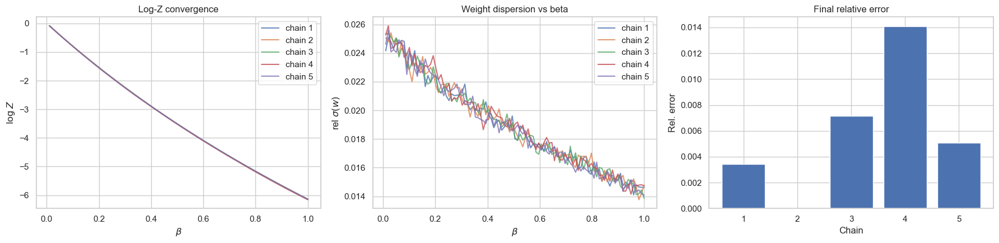

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.360e-02  | <w> mean = 9.1980e-01
[beta=0.020]  mean log rho = -8.373e-02  | <w> mean = 9.1968e-01
[beta=0.030]  mean log rho = -8.225e-02  | <w> mean = 9.2105e-01
[beta=0.040]  mean log rho = -8.200e-02  | <w> mean = 9.2127e-01
[beta=0.051]  mean log rho = -8.138e-02  | <w> mean = 9.2184e-01
[beta=0.061]  mean log rho = -8.075e-02  | <w> mean = 9.2243e-01
[beta=0.071]  mean log rho = -8.002e-02  | <w> mean = 9.2310e-01
[beta=0.081]  mean log rho = -7.937e-02  | <w> mean = 9.2370e-01
[beta=0.091]  mean log rho = -7.839e-02  | <w> mean = 9.2460e-01
[20:24:57] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.829e-02  | <w> mean = 9.2470e-01
[beta=0.111]  mean log rho = -7.736e-02  | <w> mean = 9.2556e-01
[beta=0.121]  mean log rho = -7.754e-02  | <w> mean = 9.2539e-01
[beta=0.131]  mean log rho = -7.667e-02  | <w> mean = 9.2620e-01
[beta=0.141]  mean log rho = -7.577e-02  | <w> mean = 9.2703e-01
[beta=0.152]  mean lo

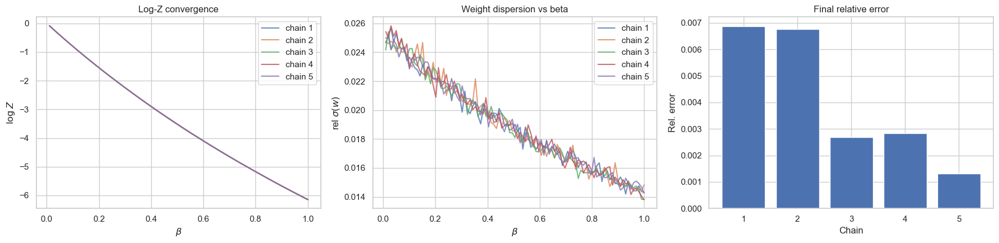

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.370e-02  | <w> mean = 9.1971e-01
[beta=0.020]  mean log rho = -8.235e-02  | <w> mean = 9.2095e-01
[beta=0.030]  mean log rho = -8.188e-02  | <w> mean = 9.2139e-01
[beta=0.040]  mean log rho = -8.111e-02  | <w> mean = 9.2209e-01
[beta=0.051]  mean log rho = -8.088e-02  | <w> mean = 9.2231e-01
[beta=0.061]  mean log rho = -8.002e-02  | <w> mean = 9.2309e-01
[beta=0.071]  mean log rho = -7.936e-02  | <w> mean = 9.2371e-01
[beta=0.081]  mean log rho = -7.927e-02  | <w> mean = 9.2380e-01
[beta=0.091]  mean log rho = -7.879e-02  | <w> mean = 9.2423e-01
[20:26:59] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.807e-02  | <w> mean = 9.2490e-01
[beta=0.111]  mean log rho = -7.670e-02  | <w> mean = 9.2616e-01
[beta=0.121]  mean log rho = -7.719e-02  | <w> mean = 9.2571e-01
[beta=0.131]  mean log rho = -7.591e-02  | <w> mean = 9.2690e-01
[beta=0.141]  mean log rho = -7.594e-02  | <w> mean = 9.2688e-01
[beta=0.152]  mean lo

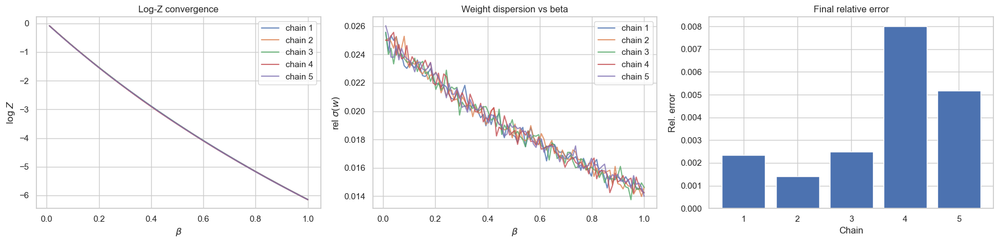

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.403e-02  | <w> mean = 9.1940e-01
[beta=0.020]  mean log rho = -8.314e-02  | <w> mean = 9.2022e-01
[beta=0.030]  mean log rho = -8.162e-02  | <w> mean = 9.2162e-01
[beta=0.040]  mean log rho = -8.192e-02  | <w> mean = 9.2135e-01
[beta=0.051]  mean log rho = -8.116e-02  | <w> mean = 9.2205e-01
[beta=0.061]  mean log rho = -8.028e-02  | <w> mean = 9.2286e-01
[beta=0.071]  mean log rho = -7.950e-02  | <w> mean = 9.2358e-01
[beta=0.081]  mean log rho = -7.885e-02  | <w> mean = 9.2418e-01
[beta=0.091]  mean log rho = -7.924e-02  | <w> mean = 9.2382e-01
[20:29:02] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.803e-02  | <w> mean = 9.2494e-01
[beta=0.111]  mean log rho = -7.828e-02  | <w> mean = 9.2471e-01
[beta=0.121]  mean log rho = -7.724e-02  | <w> mean = 9.2567e-01
[beta=0.131]  mean log rho = -7.625e-02  | <w> mean = 9.2658e-01
[beta=0.141]  mean log rho = -7.607e-02  | <w> mean = 9.2675e-01
[beta=0.152]  mean lo

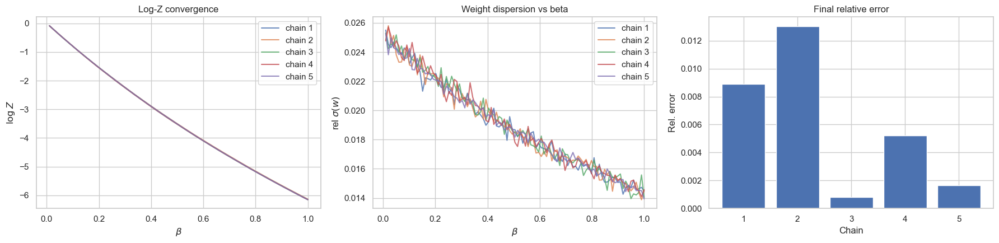

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.300e-02  | <w> mean = 9.2035e-01
[beta=0.020]  mean log rho = -8.318e-02  | <w> mean = 9.2018e-01
[beta=0.030]  mean log rho = -8.151e-02  | <w> mean = 9.2172e-01
[beta=0.040]  mean log rho = -8.121e-02  | <w> mean = 9.2200e-01
[beta=0.051]  mean log rho = -8.159e-02  | <w> mean = 9.2165e-01
[beta=0.061]  mean log rho = -8.098e-02  | <w> mean = 9.2221e-01
[beta=0.071]  mean log rho = -7.975e-02  | <w> mean = 9.2335e-01
[beta=0.081]  mean log rho = -7.920e-02  | <w> mean = 9.2386e-01
[beta=0.091]  mean log rho = -7.850e-02  | <w> mean = 9.2450e-01
[20:31:05] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.797e-02  | <w> mean = 9.2499e-01
[beta=0.111]  mean log rho = -7.766e-02  | <w> mean = 9.2528e-01
[beta=0.121]  mean log rho = -7.653e-02  | <w> mean = 9.2632e-01
[beta=0.131]  mean log rho = -7.657e-02  | <w> mean = 9.2629e-01
[beta=0.141]  mean log rho = -7.571e-02  | <w> mean = 9.2709e-01
[beta=0.152]  mean lo

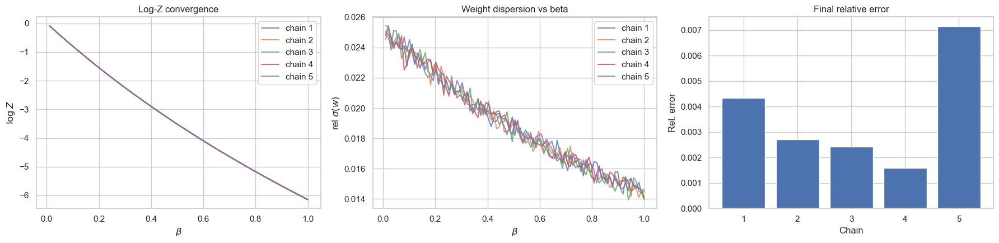

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.295e-02  | <w> mean = 9.2040e-01
[beta=0.020]  mean log rho = -8.290e-02  | <w> mean = 9.2044e-01
[beta=0.030]  mean log rho = -8.209e-02  | <w> mean = 9.2118e-01
[beta=0.040]  mean log rho = -8.235e-02  | <w> mean = 9.2095e-01
[beta=0.051]  mean log rho = -8.092e-02  | <w> mean = 9.2227e-01
[beta=0.061]  mean log rho = -8.061e-02  | <w> mean = 9.2255e-01
[beta=0.071]  mean log rho = -7.978e-02  | <w> mean = 9.2332e-01
[beta=0.081]  mean log rho = -7.865e-02  | <w> mean = 9.2436e-01
[beta=0.091]  mean log rho = -7.856e-02  | <w> mean = 9.2445e-01
[20:33:08] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.807e-02  | <w> mean = 9.2490e-01
[beta=0.111]  mean log rho = -7.828e-02  | <w> mean = 9.2471e-01
[beta=0.121]  mean log rho = -7.683e-02  | <w> mean = 9.2605e-01
[beta=0.131]  mean log rho = -7.732e-02  | <w> mean = 9.2560e-01
[beta=0.141]  mean log rho = -7.558e-02  | <w> mean = 9.2721e-01
[beta=0.152]  mean lo

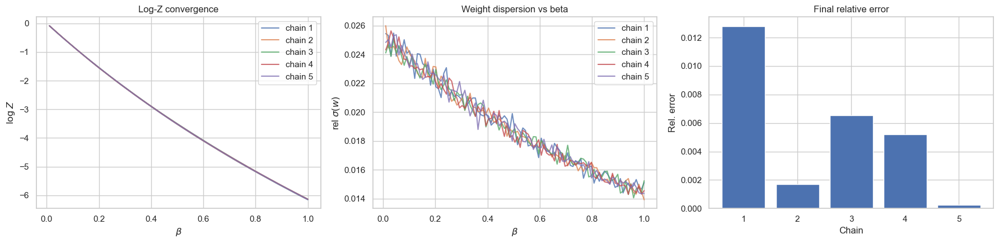

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.350e-02  | <w> mean = 9.1990e-01
[beta=0.020]  mean log rho = -8.338e-02  | <w> mean = 9.2000e-01
[beta=0.030]  mean log rho = -8.171e-02  | <w> mean = 9.2154e-01
[beta=0.040]  mean log rho = -8.188e-02  | <w> mean = 9.2138e-01
[beta=0.051]  mean log rho = -8.214e-02  | <w> mean = 9.2115e-01
[beta=0.061]  mean log rho = -8.079e-02  | <w> mean = 9.2239e-01
[beta=0.071]  mean log rho = -7.957e-02  | <w> mean = 9.2351e-01
[beta=0.081]  mean log rho = -7.914e-02  | <w> mean = 9.2391e-01
[beta=0.091]  mean log rho = -7.889e-02  | <w> mean = 9.2414e-01
[20:35:12] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.846e-02  | <w> mean = 9.2454e-01
[beta=0.111]  mean log rho = -7.782e-02  | <w> mean = 9.2513e-01
[beta=0.121]  mean log rho = -7.740e-02  | <w> mean = 9.2552e-01
[beta=0.131]  mean log rho = -7.674e-02  | <w> mean = 9.2613e-01
[beta=0.141]  mean log rho = -7.585e-02  | <w> mean = 9.2696e-01
[beta=0.152]  mean lo

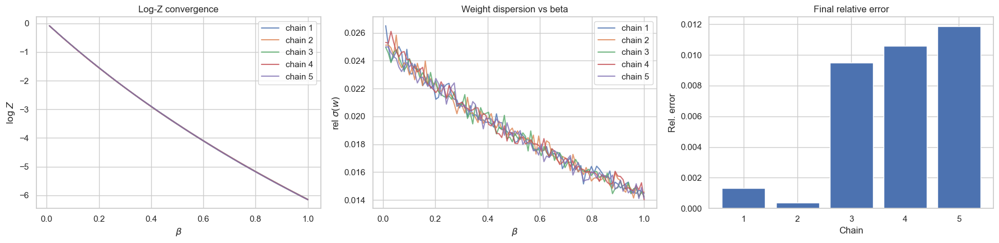

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.384e-02  | <w> mean = 9.1957e-01
[beta=0.020]  mean log rho = -8.303e-02  | <w> mean = 9.2032e-01
[beta=0.030]  mean log rho = -8.224e-02  | <w> mean = 9.2105e-01
[beta=0.040]  mean log rho = -8.164e-02  | <w> mean = 9.2160e-01
[beta=0.051]  mean log rho = -8.167e-02  | <w> mean = 9.2158e-01
[beta=0.061]  mean log rho = -8.082e-02  | <w> mean = 9.2236e-01
[beta=0.071]  mean log rho = -7.993e-02  | <w> mean = 9.2318e-01
[beta=0.081]  mean log rho = -7.936e-02  | <w> mean = 9.2370e-01
[beta=0.091]  mean log rho = -7.870e-02  | <w> mean = 9.2432e-01
[20:37:17] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.804e-02  | <w> mean = 9.2493e-01
[beta=0.111]  mean log rho = -7.771e-02  | <w> mean = 9.2524e-01
[beta=0.121]  mean log rho = -7.709e-02  | <w> mean = 9.2580e-01
[beta=0.131]  mean log rho = -7.676e-02  | <w> mean = 9.2611e-01
[beta=0.141]  mean log rho = -7.619e-02  | <w> mean = 9.2664e-01
[beta=0.152]  mean lo

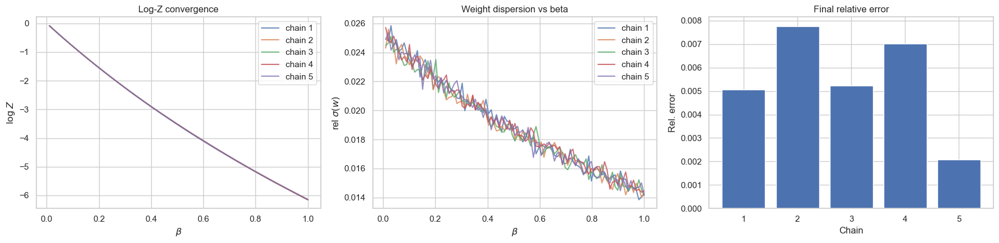

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.429e-02  | <w> mean = 9.1916e-01
[beta=0.020]  mean log rho = -8.333e-02  | <w> mean = 9.2005e-01
[beta=0.030]  mean log rho = -8.263e-02  | <w> mean = 9.2069e-01
[beta=0.040]  mean log rho = -8.178e-02  | <w> mean = 9.2148e-01
[beta=0.051]  mean log rho = -8.135e-02  | <w> mean = 9.2188e-01
[beta=0.061]  mean log rho = -8.117e-02  | <w> mean = 9.2204e-01
[beta=0.071]  mean log rho = -8.045e-02  | <w> mean = 9.2270e-01
[beta=0.081]  mean log rho = -7.933e-02  | <w> mean = 9.2374e-01
[beta=0.091]  mean log rho = -7.917e-02  | <w> mean = 9.2389e-01
[20:39:19] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.861e-02  | <w> mean = 9.2440e-01
[beta=0.111]  mean log rho = -7.861e-02  | <w> mean = 9.2440e-01
[beta=0.121]  mean log rho = -7.710e-02  | <w> mean = 9.2580e-01
[beta=0.131]  mean log rho = -7.663e-02  | <w> mean = 9.2623e-01
[beta=0.141]  mean log rho = -7.658e-02  | <w> mean = 9.2628e-01
[beta=0.152]  mean lo

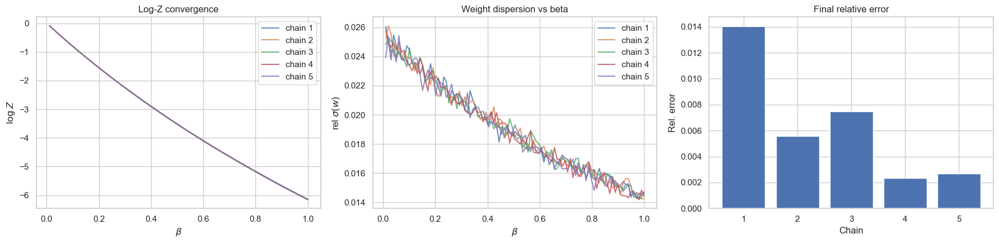


>>> Running with 10 AIS chains
Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.333e-02  | <w> mean = 9.2005e-01
[beta=0.020]  mean log rho = -8.275e-02  | <w> mean = 9.2058e-01
[beta=0.030]  mean log rho = -8.212e-02  | <w> mean = 9.2116e-01
[beta=0.040]  mean log rho = -8.196e-02  | <w> mean = 9.2131e-01
[beta=0.051]  mean log rho = -8.143e-02  | <w> mean = 9.2179e-01
[beta=0.061]  mean log rho = -8.009e-02  | <w> mean = 9.2303e-01
[beta=0.071]  mean log rho = -7.964e-02  | <w> mean = 9.2345e-01
[beta=0.081]  mean log rho = -7.950e-02  | <w> mean = 9.2358e-01
[beta=0.091]  mean log rho = -7.853e-02  | <w> mean = 9.2447e-01
[20:41:27] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.839e-02  | <w> mean = 9.2460e-01
[beta=0.111]  mean log rho = -7.777e-02  | <w> mean = 9.2518e-01
[beta=0.121]  mean log rho = -7.709e-02  | <w> mean = 9.2581e-01
[beta=0.131]  mean log rho = -7.652e-02  | <w> mean = 9.2634e-01
[beta=0.141]  mean log rho = -7.568e-02  | <w> mean =

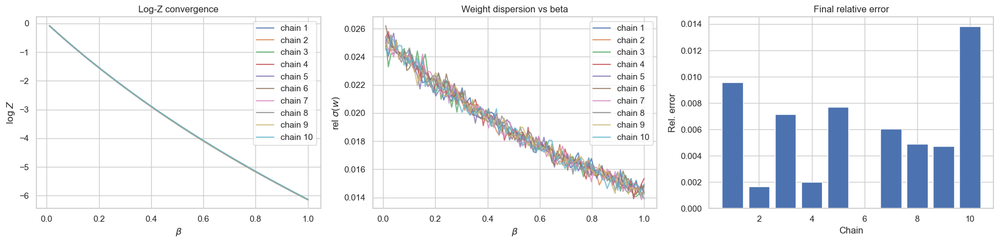

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.335e-02  | <w> mean = 9.2003e-01
[beta=0.020]  mean log rho = -8.288e-02  | <w> mean = 9.2047e-01
[beta=0.030]  mean log rho = -8.257e-02  | <w> mean = 9.2074e-01
[beta=0.040]  mean log rho = -8.137e-02  | <w> mean = 9.2185e-01
[beta=0.051]  mean log rho = -8.144e-02  | <w> mean = 9.2178e-01
[beta=0.061]  mean log rho = -8.061e-02  | <w> mean = 9.2255e-01
[beta=0.071]  mean log rho = -7.964e-02  | <w> mean = 9.2345e-01
[beta=0.081]  mean log rho = -7.954e-02  | <w> mean = 9.2354e-01
[beta=0.091]  mean log rho = -7.912e-02  | <w> mean = 9.2393e-01
[20:44:40] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.811e-02  | <w> mean = 9.2487e-01
[beta=0.111]  mean log rho = -7.773e-02  | <w> mean = 9.2521e-01
[beta=0.121]  mean log rho = -7.730e-02  | <w> mean = 9.2562e-01
[beta=0.131]  mean log rho = -7.671e-02  | <w> mean = 9.2616e-01
[beta=0.141]  mean log rho = -7.593e-02  | <w> mean = 9.2688e-01
[beta=0.152]  mean l

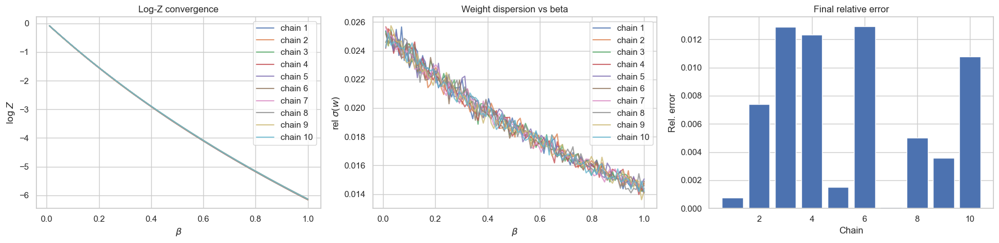

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.384e-02  | <w> mean = 9.1958e-01
[beta=0.020]  mean log rho = -8.332e-02  | <w> mean = 9.2005e-01
[beta=0.030]  mean log rho = -8.252e-02  | <w> mean = 9.2080e-01
[beta=0.040]  mean log rho = -8.179e-02  | <w> mean = 9.2147e-01
[beta=0.051]  mean log rho = -8.137e-02  | <w> mean = 9.2186e-01
[beta=0.061]  mean log rho = -8.073e-02  | <w> mean = 9.2244e-01
[beta=0.071]  mean log rho = -7.941e-02  | <w> mean = 9.2366e-01
[beta=0.081]  mean log rho = -7.942e-02  | <w> mean = 9.2365e-01
[beta=0.091]  mean log rho = -7.900e-02  | <w> mean = 9.2404e-01
[20:47:47] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.804e-02  | <w> mean = 9.2493e-01
[beta=0.111]  mean log rho = -7.754e-02  | <w> mean = 9.2539e-01
[beta=0.121]  mean log rho = -7.665e-02  | <w> mean = 9.2621e-01
[beta=0.131]  mean log rho = -7.651e-02  | <w> mean = 9.2634e-01
[beta=0.141]  mean log rho = -7.598e-02  | <w> mean = 9.2684e-01
[beta=0.152]  mean l

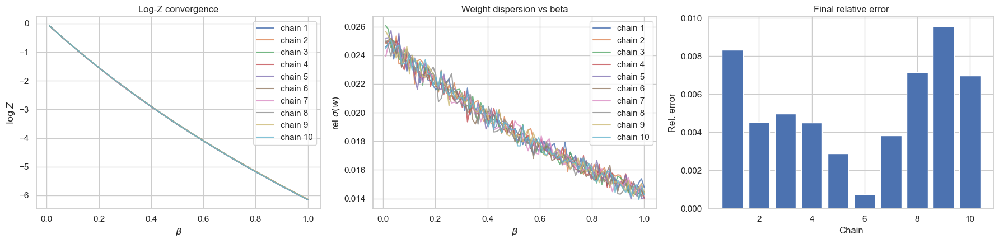

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.377e-02  | <w> mean = 9.1964e-01
[beta=0.020]  mean log rho = -8.320e-02  | <w> mean = 9.2017e-01
[beta=0.030]  mean log rho = -8.175e-02  | <w> mean = 9.2150e-01
[beta=0.040]  mean log rho = -8.176e-02  | <w> mean = 9.2150e-01
[beta=0.051]  mean log rho = -8.104e-02  | <w> mean = 9.2216e-01
[beta=0.061]  mean log rho = -8.094e-02  | <w> mean = 9.2225e-01
[beta=0.071]  mean log rho = -7.973e-02  | <w> mean = 9.2337e-01
[beta=0.081]  mean log rho = -7.892e-02  | <w> mean = 9.2411e-01
[beta=0.091]  mean log rho = -7.882e-02  | <w> mean = 9.2421e-01
[20:50:52] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.799e-02  | <w> mean = 9.2498e-01
[beta=0.111]  mean log rho = -7.773e-02  | <w> mean = 9.2521e-01
[beta=0.121]  mean log rho = -7.693e-02  | <w> mean = 9.2596e-01
[beta=0.131]  mean log rho = -7.700e-02  | <w> mean = 9.2589e-01
[beta=0.141]  mean log rho = -7.559e-02  | <w> mean = 9.2719e-01
[beta=0.152]  mean l

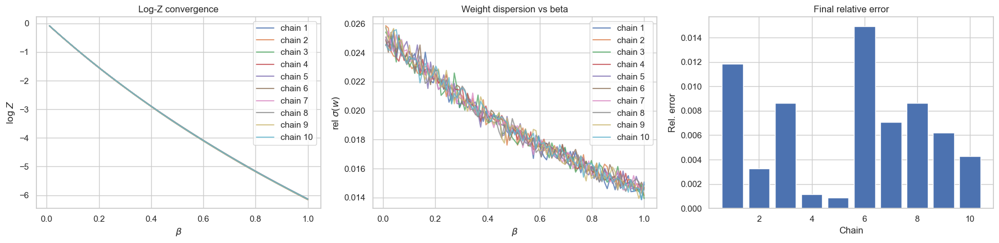

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.378e-02  | <w> mean = 9.1964e-01
[beta=0.020]  mean log rho = -8.309e-02  | <w> mean = 9.2027e-01
[beta=0.030]  mean log rho = -8.259e-02  | <w> mean = 9.2073e-01
[beta=0.040]  mean log rho = -8.203e-02  | <w> mean = 9.2125e-01
[beta=0.051]  mean log rho = -8.082e-02  | <w> mean = 9.2236e-01
[beta=0.061]  mean log rho = -8.031e-02  | <w> mean = 9.2283e-01
[beta=0.071]  mean log rho = -7.957e-02  | <w> mean = 9.2352e-01
[beta=0.081]  mean log rho = -7.923e-02  | <w> mean = 9.2383e-01
[beta=0.091]  mean log rho = -7.914e-02  | <w> mean = 9.2391e-01
[20:53:56] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.749e-02  | <w> mean = 9.2543e-01
[beta=0.111]  mean log rho = -7.812e-02  | <w> mean = 9.2486e-01
[beta=0.121]  mean log rho = -7.707e-02  | <w> mean = 9.2583e-01
[beta=0.131]  mean log rho = -7.623e-02  | <w> mean = 9.2660e-01
[beta=0.141]  mean log rho = -7.589e-02  | <w> mean = 9.2692e-01
[beta=0.152]  mean l

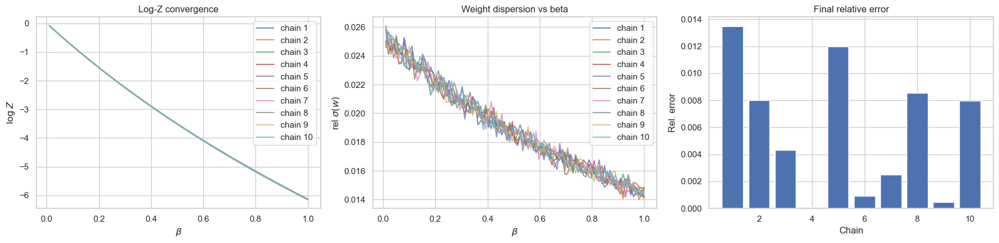

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.390e-02  | <w> mean = 9.1952e-01
[beta=0.020]  mean log rho = -8.198e-02  | <w> mean = 9.2129e-01
[beta=0.030]  mean log rho = -8.222e-02  | <w> mean = 9.2107e-01
[beta=0.040]  mean log rho = -8.211e-02  | <w> mean = 9.2117e-01
[beta=0.051]  mean log rho = -8.136e-02  | <w> mean = 9.2186e-01
[beta=0.061]  mean log rho = -8.009e-02  | <w> mean = 9.2303e-01
[beta=0.071]  mean log rho = -7.991e-02  | <w> mean = 9.2320e-01
[beta=0.081]  mean log rho = -7.973e-02  | <w> mean = 9.2336e-01
[beta=0.091]  mean log rho = -7.871e-02  | <w> mean = 9.2430e-01
[20:57:01] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.846e-02  | <w> mean = 9.2454e-01
[beta=0.111]  mean log rho = -7.779e-02  | <w> mean = 9.2516e-01
[beta=0.121]  mean log rho = -7.737e-02  | <w> mean = 9.2554e-01
[beta=0.131]  mean log rho = -7.593e-02  | <w> mean = 9.2688e-01
[beta=0.141]  mean log rho = -7.597e-02  | <w> mean = 9.2684e-01
[beta=0.152]  mean l

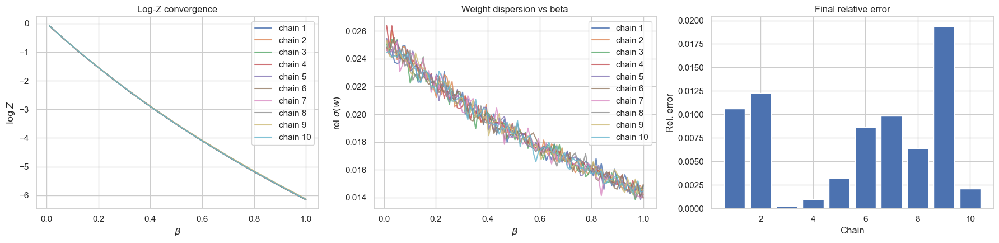

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.370e-02  | <w> mean = 9.1971e-01
[beta=0.020]  mean log rho = -8.276e-02  | <w> mean = 9.2057e-01
[beta=0.030]  mean log rho = -8.293e-02  | <w> mean = 9.2042e-01
[beta=0.040]  mean log rho = -8.148e-02  | <w> mean = 9.2175e-01
[beta=0.051]  mean log rho = -8.073e-02  | <w> mean = 9.2244e-01
[beta=0.061]  mean log rho = -8.067e-02  | <w> mean = 9.2250e-01
[beta=0.071]  mean log rho = -7.984e-02  | <w> mean = 9.2327e-01
[beta=0.081]  mean log rho = -7.882e-02  | <w> mean = 9.2421e-01
[beta=0.091]  mean log rho = -7.924e-02  | <w> mean = 9.2382e-01
[21:00:06] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.851e-02  | <w> mean = 9.2449e-01
[beta=0.111]  mean log rho = -7.735e-02  | <w> mean = 9.2557e-01
[beta=0.121]  mean log rho = -7.710e-02  | <w> mean = 9.2580e-01
[beta=0.131]  mean log rho = -7.642e-02  | <w> mean = 9.2642e-01
[beta=0.141]  mean log rho = -7.600e-02  | <w> mean = 9.2682e-01
[beta=0.152]  mean l

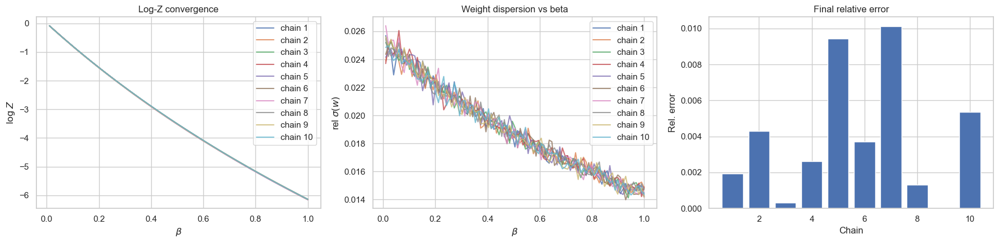

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.369e-02  | <w> mean = 9.1972e-01
[beta=0.020]  mean log rho = -8.294e-02  | <w> mean = 9.2041e-01
[beta=0.030]  mean log rho = -8.220e-02  | <w> mean = 9.2109e-01
[beta=0.040]  mean log rho = -8.187e-02  | <w> mean = 9.2139e-01
[beta=0.051]  mean log rho = -8.099e-02  | <w> mean = 9.2220e-01
[beta=0.061]  mean log rho = -8.077e-02  | <w> mean = 9.2240e-01
[beta=0.071]  mean log rho = -7.939e-02  | <w> mean = 9.2368e-01
[beta=0.081]  mean log rho = -8.005e-02  | <w> mean = 9.2307e-01
[beta=0.091]  mean log rho = -7.915e-02  | <w> mean = 9.2390e-01
[21:03:11] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.844e-02  | <w> mean = 9.2455e-01
[beta=0.111]  mean log rho = -7.746e-02  | <w> mean = 9.2547e-01
[beta=0.121]  mean log rho = -7.716e-02  | <w> mean = 9.2574e-01
[beta=0.131]  mean log rho = -7.644e-02  | <w> mean = 9.2641e-01
[beta=0.141]  mean log rho = -7.640e-02  | <w> mean = 9.2644e-01
[beta=0.152]  mean l

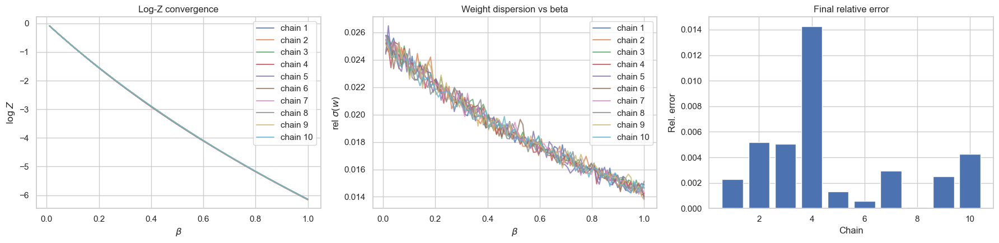

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.391e-02  | <w> mean = 9.1951e-01
[beta=0.020]  mean log rho = -8.251e-02  | <w> mean = 9.2080e-01
[beta=0.030]  mean log rho = -8.257e-02  | <w> mean = 9.2075e-01
[beta=0.040]  mean log rho = -8.137e-02  | <w> mean = 9.2186e-01
[beta=0.051]  mean log rho = -8.125e-02  | <w> mean = 9.2196e-01
[beta=0.061]  mean log rho = -8.069e-02  | <w> mean = 9.2248e-01
[beta=0.071]  mean log rho = -7.971e-02  | <w> mean = 9.2339e-01
[beta=0.081]  mean log rho = -7.953e-02  | <w> mean = 9.2355e-01
[beta=0.091]  mean log rho = -7.878e-02  | <w> mean = 9.2424e-01
[21:06:16] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.835e-02  | <w> mean = 9.2464e-01
[beta=0.111]  mean log rho = -7.733e-02  | <w> mean = 9.2558e-01
[beta=0.121]  mean log rho = -7.754e-02  | <w> mean = 9.2539e-01
[beta=0.131]  mean log rho = -7.661e-02  | <w> mean = 9.2625e-01
[beta=0.141]  mean log rho = -7.598e-02  | <w> mean = 9.2684e-01
[beta=0.152]  mean l

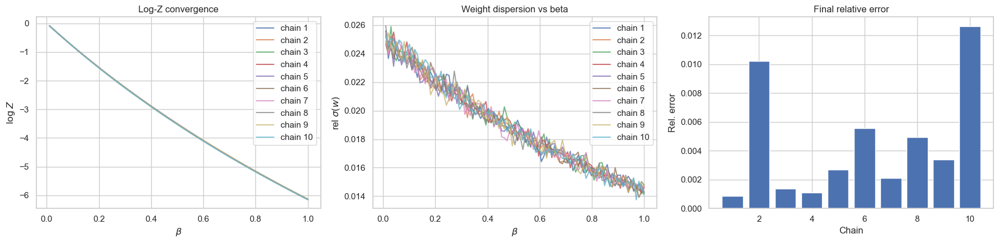

Running 10 AIS chains vectorized
[beta=0.010]  mean log rho = -8.326e-02  | <w> mean = 9.2011e-01
[beta=0.020]  mean log rho = -8.315e-02  | <w> mean = 9.2021e-01
[beta=0.030]  mean log rho = -8.229e-02  | <w> mean = 9.2100e-01
[beta=0.040]  mean log rho = -8.181e-02  | <w> mean = 9.2145e-01
[beta=0.051]  mean log rho = -8.080e-02  | <w> mean = 9.2238e-01
[beta=0.061]  mean log rho = -8.053e-02  | <w> mean = 9.2263e-01
[beta=0.071]  mean log rho = -8.017e-02  | <w> mean = 9.2296e-01
[beta=0.081]  mean log rho = -7.937e-02  | <w> mean = 9.2369e-01
[beta=0.091]  mean log rho = -7.872e-02  | <w> mean = 9.2430e-01
[21:09:21] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.822e-02  | <w> mean = 9.2476e-01
[beta=0.111]  mean log rho = -7.754e-02  | <w> mean = 9.2539e-01
[beta=0.121]  mean log rho = -7.672e-02  | <w> mean = 9.2615e-01
[beta=0.131]  mean log rho = -7.608e-02  | <w> mean = 9.2675e-01
[beta=0.141]  mean log rho = -7.585e-02  | <w> mean = 9.2695e-01
[beta=0.152]  mean l

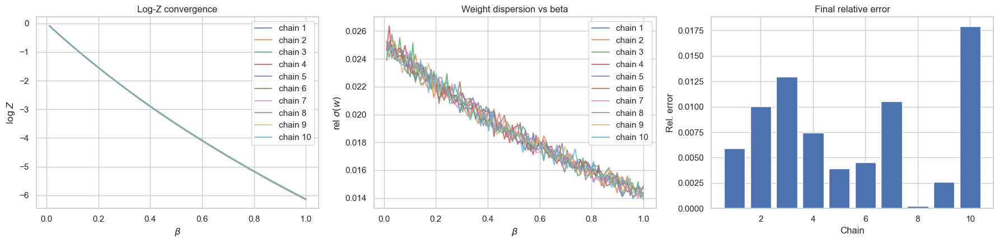


>>> Running with 20 AIS chains
Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.368e-02  | <w> mean = 9.1973e-01
[beta=0.020]  mean log rho = -8.307e-02  | <w> mean = 9.2029e-01
[beta=0.030]  mean log rho = -8.250e-02  | <w> mean = 9.2081e-01
[beta=0.040]  mean log rho = -8.147e-02  | <w> mean = 9.2177e-01
[beta=0.051]  mean log rho = -8.087e-02  | <w> mean = 9.2231e-01
[beta=0.061]  mean log rho = -8.041e-02  | <w> mean = 9.2274e-01
[beta=0.071]  mean log rho = -7.952e-02  | <w> mean = 9.2356e-01
[beta=0.081]  mean log rho = -7.934e-02  | <w> mean = 9.2373e-01
[beta=0.091]  mean log rho = -7.884e-02  | <w> mean = 9.2419e-01
[21:12:37] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.808e-02  | <w> mean = 9.2489e-01
[beta=0.111]  mean log rho = -7.760e-02  | <w> mean = 9.2534e-01
[beta=0.121]  mean log rho = -7.678e-02  | <w> mean = 9.2609e-01
[beta=0.131]  mean log rho = -7.676e-02  | <w> mean = 9.2612e-01
[beta=0.141]  mean log rho = -7.593e-02  | <w> mean =

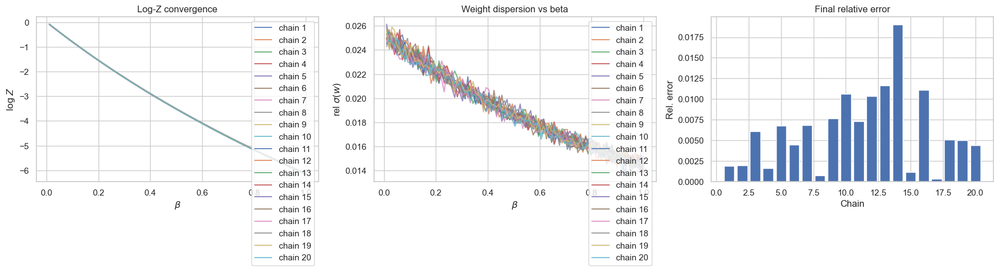

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.358e-02  | <w> mean = 9.1982e-01
[beta=0.020]  mean log rho = -8.315e-02  | <w> mean = 9.2022e-01
[beta=0.030]  mean log rho = -8.254e-02  | <w> mean = 9.2078e-01
[beta=0.040]  mean log rho = -8.192e-02  | <w> mean = 9.2134e-01
[beta=0.051]  mean log rho = -8.118e-02  | <w> mean = 9.2203e-01
[beta=0.061]  mean log rho = -8.051e-02  | <w> mean = 9.2265e-01
[beta=0.071]  mean log rho = -8.003e-02  | <w> mean = 9.2309e-01
[beta=0.081]  mean log rho = -7.925e-02  | <w> mean = 9.2381e-01
[beta=0.091]  mean log rho = -7.857e-02  | <w> mean = 9.2443e-01
[21:17:48] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.846e-02  | <w> mean = 9.2454e-01
[beta=0.111]  mean log rho = -7.778e-02  | <w> mean = 9.2517e-01
[beta=0.121]  mean log rho = -7.730e-02  | <w> mean = 9.2561e-01
[beta=0.131]  mean log rho = -7.643e-02  | <w> mean = 9.2642e-01
[beta=0.141]  mean log rho = -7.584e-02  | <w> mean = 9.2697e-01
[beta=0.152]  mean l

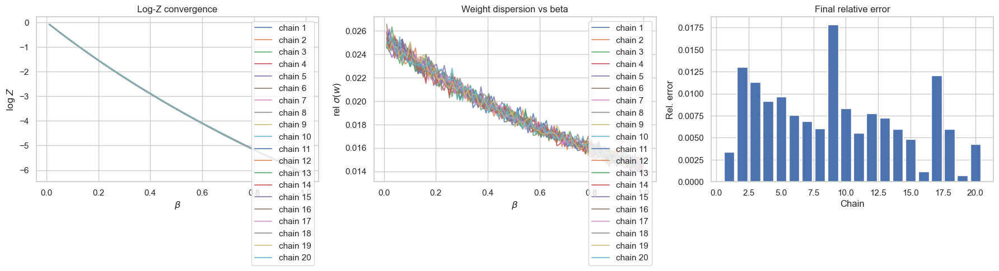

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.347e-02  | <w> mean = 9.1992e-01
[beta=0.020]  mean log rho = -8.292e-02  | <w> mean = 9.2042e-01
[beta=0.030]  mean log rho = -8.239e-02  | <w> mean = 9.2091e-01
[beta=0.040]  mean log rho = -8.180e-02  | <w> mean = 9.2145e-01
[beta=0.051]  mean log rho = -8.102e-02  | <w> mean = 9.2218e-01
[beta=0.061]  mean log rho = -8.048e-02  | <w> mean = 9.2267e-01
[beta=0.071]  mean log rho = -8.021e-02  | <w> mean = 9.2293e-01
[beta=0.081]  mean log rho = -7.906e-02  | <w> mean = 9.2399e-01
[beta=0.091]  mean log rho = -7.852e-02  | <w> mean = 9.2448e-01
[21:22:59] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.810e-02  | <w> mean = 9.2487e-01
[beta=0.111]  mean log rho = -7.767e-02  | <w> mean = 9.2527e-01
[beta=0.121]  mean log rho = -7.707e-02  | <w> mean = 9.2582e-01
[beta=0.131]  mean log rho = -7.665e-02  | <w> mean = 9.2621e-01
[beta=0.141]  mean log rho = -7.597e-02  | <w> mean = 9.2684e-01
[beta=0.152]  mean l

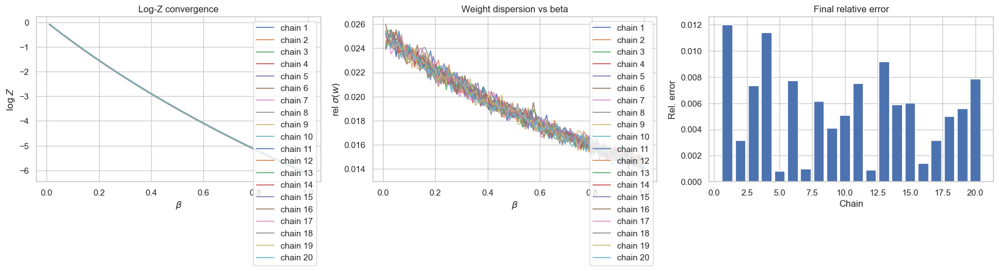

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.327e-02  | <w> mean = 9.2010e-01
[beta=0.020]  mean log rho = -8.281e-02  | <w> mean = 9.2053e-01
[beta=0.030]  mean log rho = -8.232e-02  | <w> mean = 9.2098e-01
[beta=0.040]  mean log rho = -8.154e-02  | <w> mean = 9.2170e-01
[beta=0.051]  mean log rho = -8.140e-02  | <w> mean = 9.2183e-01
[beta=0.061]  mean log rho = -8.042e-02  | <w> mean = 9.2273e-01
[beta=0.071]  mean log rho = -7.991e-02  | <w> mean = 9.2320e-01
[beta=0.081]  mean log rho = -7.928e-02  | <w> mean = 9.2378e-01
[beta=0.091]  mean log rho = -7.886e-02  | <w> mean = 9.2417e-01
[21:28:10] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.848e-02  | <w> mean = 9.2452e-01
[beta=0.111]  mean log rho = -7.756e-02  | <w> mean = 9.2538e-01
[beta=0.121]  mean log rho = -7.720e-02  | <w> mean = 9.2571e-01
[beta=0.131]  mean log rho = -7.670e-02  | <w> mean = 9.2617e-01
[beta=0.141]  mean log rho = -7.606e-02  | <w> mean = 9.2676e-01
[beta=0.152]  mean l

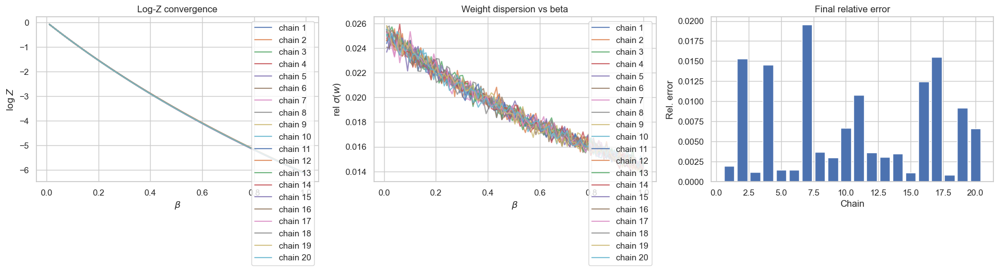

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.324e-02  | <w> mean = 9.2013e-01
[beta=0.020]  mean log rho = -8.272e-02  | <w> mean = 9.2061e-01
[beta=0.030]  mean log rho = -8.247e-02  | <w> mean = 9.2084e-01
[beta=0.040]  mean log rho = -8.157e-02  | <w> mean = 9.2167e-01
[beta=0.051]  mean log rho = -8.096e-02  | <w> mean = 9.2223e-01
[beta=0.061]  mean log rho = -8.034e-02  | <w> mean = 9.2280e-01
[beta=0.071]  mean log rho = -7.983e-02  | <w> mean = 9.2328e-01
[beta=0.081]  mean log rho = -7.896e-02  | <w> mean = 9.2407e-01
[beta=0.091]  mean log rho = -7.873e-02  | <w> mean = 9.2429e-01
[21:33:20] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.840e-02  | <w> mean = 9.2460e-01
[beta=0.111]  mean log rho = -7.747e-02  | <w> mean = 9.2546e-01
[beta=0.121]  mean log rho = -7.713e-02  | <w> mean = 9.2577e-01
[beta=0.131]  mean log rho = -7.677e-02  | <w> mean = 9.2610e-01
[beta=0.141]  mean log rho = -7.591e-02  | <w> mean = 9.2690e-01
[beta=0.152]  mean l

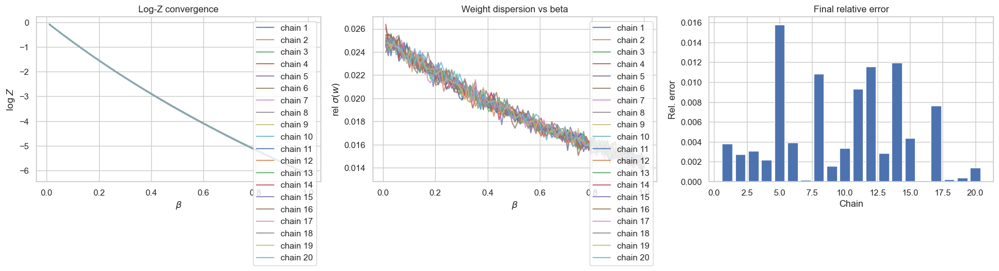

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.349e-02  | <w> mean = 9.1990e-01
[beta=0.020]  mean log rho = -8.306e-02  | <w> mean = 9.2030e-01
[beta=0.030]  mean log rho = -8.221e-02  | <w> mean = 9.2108e-01
[beta=0.040]  mean log rho = -8.178e-02  | <w> mean = 9.2147e-01
[beta=0.051]  mean log rho = -8.141e-02  | <w> mean = 9.2182e-01
[beta=0.061]  mean log rho = -8.057e-02  | <w> mean = 9.2259e-01
[beta=0.071]  mean log rho = -7.992e-02  | <w> mean = 9.2319e-01
[beta=0.081]  mean log rho = -7.905e-02  | <w> mean = 9.2399e-01
[beta=0.091]  mean log rho = -7.912e-02  | <w> mean = 9.2393e-01
[21:38:30] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.813e-02  | <w> mean = 9.2484e-01
[beta=0.111]  mean log rho = -7.746e-02  | <w> mean = 9.2547e-01
[beta=0.121]  mean log rho = -7.750e-02  | <w> mean = 9.2543e-01
[beta=0.131]  mean log rho = -7.648e-02  | <w> mean = 9.2637e-01
[beta=0.141]  mean log rho = -7.610e-02  | <w> mean = 9.2672e-01
[beta=0.152]  mean l

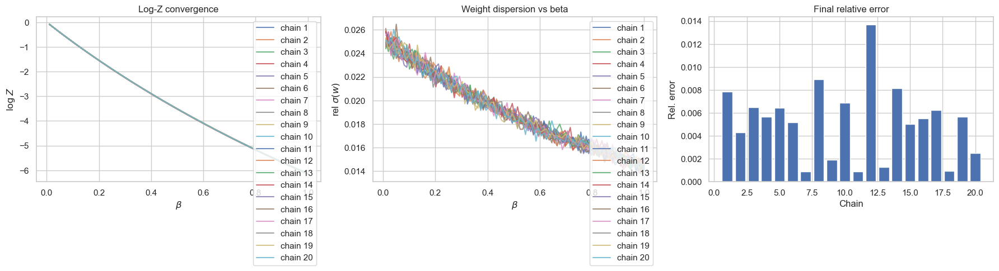

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.306e-02  | <w> mean = 9.2030e-01
[beta=0.020]  mean log rho = -8.308e-02  | <w> mean = 9.2028e-01
[beta=0.030]  mean log rho = -8.231e-02  | <w> mean = 9.2099e-01
[beta=0.040]  mean log rho = -8.165e-02  | <w> mean = 9.2159e-01
[beta=0.051]  mean log rho = -8.065e-02  | <w> mean = 9.2252e-01
[beta=0.061]  mean log rho = -8.062e-02  | <w> mean = 9.2255e-01
[beta=0.071]  mean log rho = -8.002e-02  | <w> mean = 9.2310e-01
[beta=0.081]  mean log rho = -7.927e-02  | <w> mean = 9.2379e-01
[beta=0.091]  mean log rho = -7.887e-02  | <w> mean = 9.2416e-01
[21:43:56] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.784e-02  | <w> mean = 9.2511e-01
[beta=0.111]  mean log rho = -7.761e-02  | <w> mean = 9.2532e-01
[beta=0.121]  mean log rho = -7.703e-02  | <w> mean = 9.2587e-01
[beta=0.131]  mean log rho = -7.674e-02  | <w> mean = 9.2613e-01
[beta=0.141]  mean log rho = -7.599e-02  | <w> mean = 9.2683e-01
[beta=0.152]  mean l

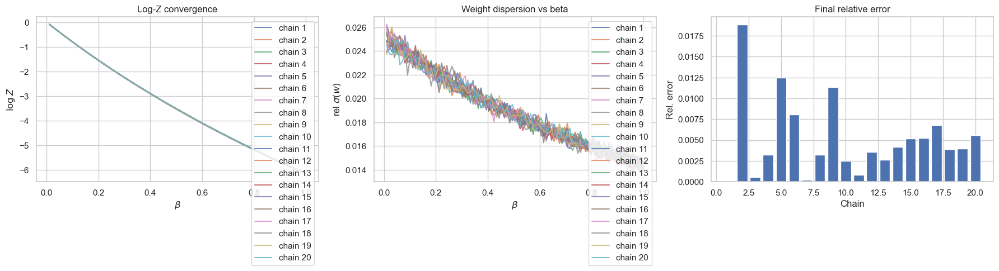

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.387e-02  | <w> mean = 9.1955e-01
[beta=0.020]  mean log rho = -8.267e-02  | <w> mean = 9.2066e-01
[beta=0.030]  mean log rho = -8.228e-02  | <w> mean = 9.2101e-01
[beta=0.040]  mean log rho = -8.163e-02  | <w> mean = 9.2161e-01
[beta=0.051]  mean log rho = -8.141e-02  | <w> mean = 9.2182e-01
[beta=0.061]  mean log rho = -8.061e-02  | <w> mean = 9.2256e-01
[beta=0.071]  mean log rho = -7.998e-02  | <w> mean = 9.2314e-01
[beta=0.081]  mean log rho = -7.948e-02  | <w> mean = 9.2360e-01
[beta=0.091]  mean log rho = -7.906e-02  | <w> mean = 9.2399e-01
[21:49:14] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.787e-02  | <w> mean = 9.2508e-01
[beta=0.111]  mean log rho = -7.747e-02  | <w> mean = 9.2546e-01
[beta=0.121]  mean log rho = -7.700e-02  | <w> mean = 9.2589e-01
[beta=0.131]  mean log rho = -7.670e-02  | <w> mean = 9.2617e-01
[beta=0.141]  mean log rho = -7.614e-02  | <w> mean = 9.2669e-01
[beta=0.152]  mean l

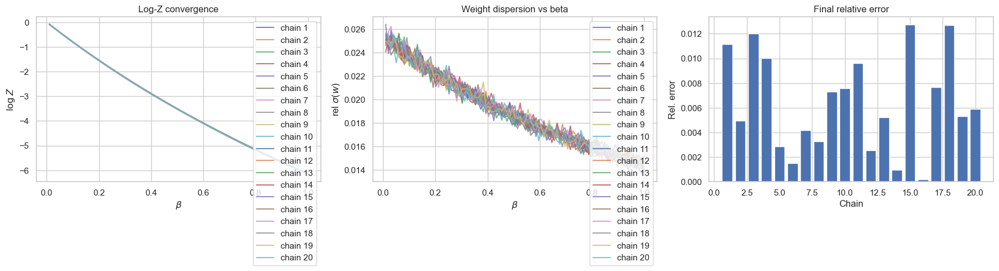

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.350e-02  | <w> mean = 9.1989e-01
[beta=0.020]  mean log rho = -8.278e-02  | <w> mean = 9.2055e-01
[beta=0.030]  mean log rho = -8.227e-02  | <w> mean = 9.2103e-01
[beta=0.040]  mean log rho = -8.170e-02  | <w> mean = 9.2155e-01
[beta=0.051]  mean log rho = -8.139e-02  | <w> mean = 9.2183e-01
[beta=0.061]  mean log rho = -8.049e-02  | <w> mean = 9.2266e-01
[beta=0.071]  mean log rho = -7.977e-02  | <w> mean = 9.2333e-01
[beta=0.081]  mean log rho = -7.922e-02  | <w> mean = 9.2384e-01
[beta=0.091]  mean log rho = -7.872e-02  | <w> mean = 9.2430e-01
[21:54:30] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.789e-02  | <w> mean = 9.2506e-01
[beta=0.111]  mean log rho = -7.775e-02  | <w> mean = 9.2520e-01
[beta=0.121]  mean log rho = -7.686e-02  | <w> mean = 9.2602e-01
[beta=0.131]  mean log rho = -7.681e-02  | <w> mean = 9.2606e-01
[beta=0.141]  mean log rho = -7.618e-02  | <w> mean = 9.2665e-01
[beta=0.152]  mean l

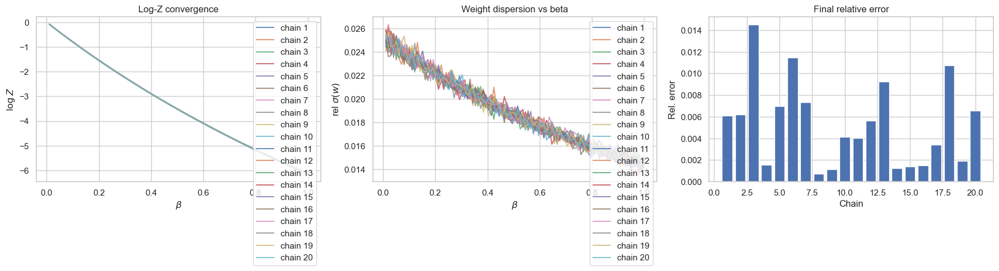

Running 20 AIS chains vectorized
[beta=0.010]  mean log rho = -8.351e-02  | <w> mean = 9.1988e-01
[beta=0.020]  mean log rho = -8.307e-02  | <w> mean = 9.2029e-01
[beta=0.030]  mean log rho = -8.201e-02  | <w> mean = 9.2127e-01
[beta=0.040]  mean log rho = -8.182e-02  | <w> mean = 9.2144e-01
[beta=0.051]  mean log rho = -8.106e-02  | <w> mean = 9.2214e-01
[beta=0.061]  mean log rho = -8.048e-02  | <w> mean = 9.2267e-01
[beta=0.071]  mean log rho = -7.971e-02  | <w> mean = 9.2339e-01
[beta=0.081]  mean log rho = -7.900e-02  | <w> mean = 9.2404e-01
[beta=0.091]  mean log rho = -7.890e-02  | <w> mean = 9.2413e-01
[21:59:42] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.802e-02  | <w> mean = 9.2495e-01
[beta=0.111]  mean log rho = -7.797e-02  | <w> mean = 9.2500e-01
[beta=0.121]  mean log rho = -7.722e-02  | <w> mean = 9.2569e-01
[beta=0.131]  mean log rho = -7.638e-02  | <w> mean = 9.2646e-01
[beta=0.141]  mean log rho = -7.650e-02  | <w> mean = 9.2635e-01
[beta=0.152]  mean l

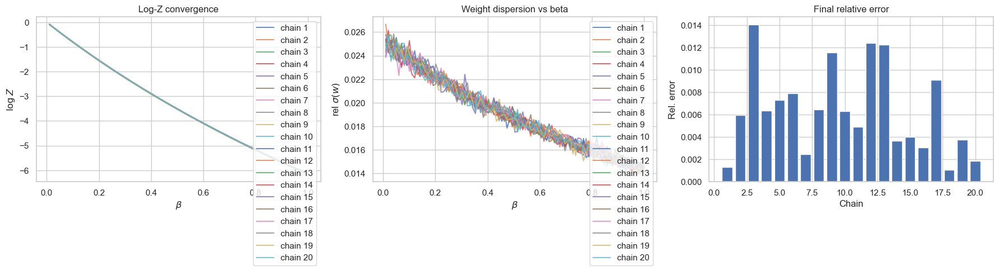

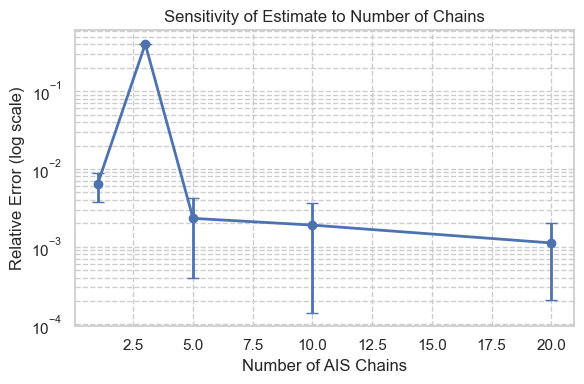

 Chains  Mean Relative Error  Std Relative Error     Mean Ẑ   Std Ẑ
      1             0.006344            0.002586 1138.097210 7.417835
      3             0.404341            0.001815  679.380067 2.070282
      5             0.002313            0.001921 1138.512606 2.756600
     10             0.001893            0.001752 1141.481887 2.792073
     20             0.001117            0.000914 1141.055047 1.566851


,Chains,Mean Relative Error,Std Relative Error,Mean Ẑ,Std Ẑ
0,1,0.006344,0.002586,1138.097210,7.417835
1,3,0.404341,0.001815,679.380067,2.070282
2,5,0.002313,0.001921,1138.512606,2.756600
3,10,0.001893,0.001752,1141.481887,2.792073
4,20,0.001117,0.000914,1141.055047,1.566851


In [8]:
def sensitivity_n_chains(dim=3, 
                         betas=np.linspace(0, 1, 100), 
                         chains_list=[1, 3, 5, 10, 20],
                         iters=10_000,
                         burns=1000,
                         n_rounds=5,
                         n_trials=10):  # added: repeated trials
    print('\n>>> Building Tensor Network')
    G, tensors = build_3x3_grid_test(dim=dim)
    TRUE_Z = contract_tensor_network(G, tensors)
    tn = TensorNetwork(G, tensors)

    stats = []

    for n_chains in chains_list:
        print(f'\n>>> Running with {n_chains} AIS chains')

        rel_errors = []
        Z_means = []

        for trial in range(n_trials):
            try:
                mean_Z, std_Z = run_multiple_chains(
                    tn, betas,
                    n_chains=n_chains,
                    iters=iters,
                    burns=burns,
                    n_rounds=n_rounds,
                    Z_true=TRUE_Z
                )
                rel_error = np.abs(mean_Z - TRUE_Z) / np.abs(TRUE_Z)
                rel_errors.append(rel_error)
                Z_means.append(mean_Z)
            except Exception as e:
                print(f"[!] Trial {trial+1} failed for {n_chains} chains: {e}")

        if len(rel_errors) > 0:
            stats.append({
                'Chains': n_chains,
                'Mean Relative Error': np.mean(rel_errors),
                'Std Relative Error': np.std(rel_errors),
                'Mean Ẑ': np.mean(Z_means),
                'Std Ẑ': np.std(Z_means)
            })

    df = pd.DataFrame(stats)

    sns.set_theme(style="whitegrid")
    plt.figure(figsize=(6, 4))
    plt.errorbar(df['Chains'], df['Mean Relative Error'],
                 yerr=df['Std Relative Error'], fmt='o-', capsize=4, lw=2)
    plt.yscale('log')
    plt.xlabel('Number of AIS Chains')
    plt.ylabel('Relative Error (log scale)')
    plt.title('Sensitivity of Estimate to Number of Chains')
    plt.tight_layout()
    plt.grid(True, which="both", ls="--")
    plt.show()

    print(df.to_string(index=False, float_format='%.6f'))
    return df

sensitivity_n_chains()


>>> Building Tensor Network

>>> Running with 1 rounds
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.147e-02  | <w> mean = 9.2177e-01
[beta=0.020]  mean log rho = -8.054e-02  | <w> mean = 9.2262e-01
[beta=0.030]  mean log rho = -8.079e-02  | <w> mean = 9.2238e-01
[beta=0.040]  mean log rho = -7.983e-02  | <w> mean = 9.2327e-01
[beta=0.051]  mean log rho = -7.936e-02  | <w> mean = 9.2371e-01
[beta=0.061]  mean log rho = -7.768e-02  | <w> mean = 9.2526e-01
[beta=0.071]  mean log rho = -7.825e-02  | <w> mean = 9.2473e-01
[beta=0.081]  mean log rho = -7.719e-02  | <w> mean = 9.2572e-01
[beta=0.091]  mean log rho = -7.572e-02  | <w> mean = 9.2708e-01
[22:04:37] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.653e-02  | <w> mean = 9.2632e-01
[beta=0.111]  mean log rho = -7.495e-02  | <w> mean = 9.2779e-01
[beta=0.121]  mean log rho = -7.438e-02  | <w> mean = 9.2832e-01
[beta=0.131]  mean log rho = -7.379e-02  | <w> mean = 9.2887e-01
[beta=0.141]  mean log rho = -

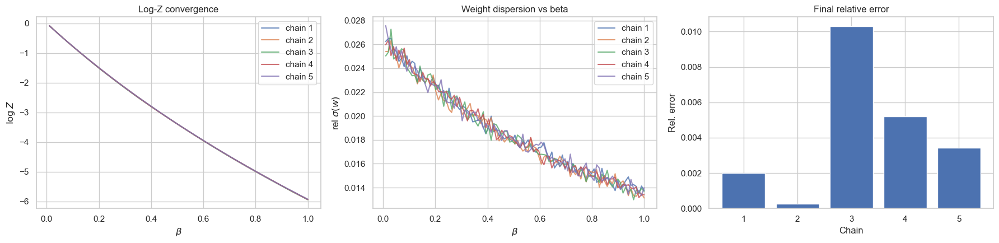

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.125e-02  | <w> mean = 9.2197e-01
[beta=0.020]  mean log rho = -8.049e-02  | <w> mean = 9.2266e-01
[beta=0.030]  mean log rho = -8.032e-02  | <w> mean = 9.2282e-01
[beta=0.040]  mean log rho = -7.913e-02  | <w> mean = 9.2392e-01
[beta=0.051]  mean log rho = -7.873e-02  | <w> mean = 9.2429e-01
[beta=0.061]  mean log rho = -7.810e-02  | <w> mean = 9.2487e-01
[beta=0.071]  mean log rho = -7.836e-02  | <w> mean = 9.2463e-01
[beta=0.081]  mean log rho = -7.704e-02  | <w> mean = 9.2586e-01
[beta=0.091]  mean log rho = -7.668e-02  | <w> mean = 9.2619e-01
[22:06:39] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.564e-02  | <w> mean = 9.2715e-01
[beta=0.111]  mean log rho = -7.492e-02  | <w> mean = 9.2782e-01
[beta=0.121]  mean log rho = -7.430e-02  | <w> mean = 9.2839e-01
[beta=0.131]  mean log rho = -7.464e-02  | <w> mean = 9.2808e-01
[beta=0.141]  mean log rho = -7.322e-02  | <w> mean = 9.2940e-01
[beta=0.152]  mean lo

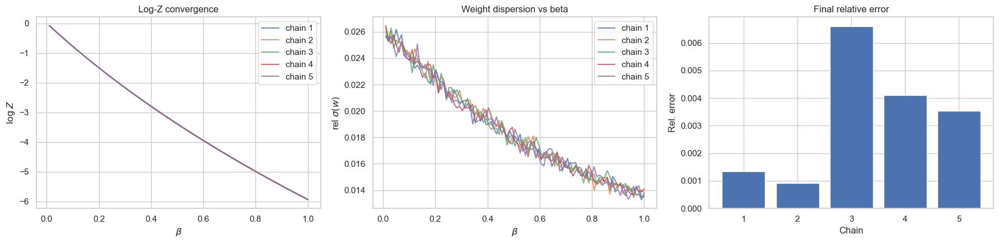

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.109e-02  | <w> mean = 9.2212e-01
[beta=0.020]  mean log rho = -8.086e-02  | <w> mean = 9.2233e-01
[beta=0.030]  mean log rho = -7.932e-02  | <w> mean = 9.2375e-01
[beta=0.040]  mean log rho = -7.948e-02  | <w> mean = 9.2359e-01
[beta=0.051]  mean log rho = -7.884e-02  | <w> mean = 9.2419e-01
[beta=0.061]  mean log rho = -7.845e-02  | <w> mean = 9.2455e-01
[beta=0.071]  mean log rho = -7.736e-02  | <w> mean = 9.2555e-01
[beta=0.081]  mean log rho = -7.652e-02  | <w> mean = 9.2633e-01
[beta=0.091]  mean log rho = -7.572e-02  | <w> mean = 9.2707e-01
[22:08:40] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.514e-02  | <w> mean = 9.2761e-01
[beta=0.111]  mean log rho = -7.483e-02  | <w> mean = 9.2790e-01
[beta=0.121]  mean log rho = -7.433e-02  | <w> mean = 9.2837e-01
[beta=0.131]  mean log rho = -7.345e-02  | <w> mean = 9.2919e-01
[beta=0.141]  mean log rho = -7.426e-02  | <w> mean = 9.2843e-01
[beta=0.152]  mean lo

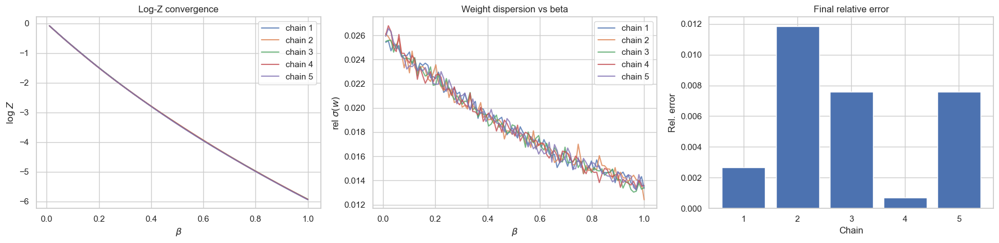

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.138e-02  | <w> mean = 9.2184e-01
[beta=0.020]  mean log rho = -8.055e-02  | <w> mean = 9.2261e-01
[beta=0.030]  mean log rho = -8.025e-02  | <w> mean = 9.2288e-01
[beta=0.040]  mean log rho = -7.908e-02  | <w> mean = 9.2397e-01
[beta=0.051]  mean log rho = -7.925e-02  | <w> mean = 9.2381e-01
[beta=0.061]  mean log rho = -7.835e-02  | <w> mean = 9.2464e-01
[beta=0.071]  mean log rho = -7.761e-02  | <w> mean = 9.2532e-01
[beta=0.081]  mean log rho = -7.689e-02  | <w> mean = 9.2600e-01
[beta=0.091]  mean log rho = -7.611e-02  | <w> mean = 9.2672e-01
[22:11:00] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.605e-02  | <w> mean = 9.2677e-01
[beta=0.111]  mean log rho = -7.401e-02  | <w> mean = 9.2867e-01
[beta=0.121]  mean log rho = -7.471e-02  | <w> mean = 9.2801e-01
[beta=0.131]  mean log rho = -7.374e-02  | <w> mean = 9.2891e-01
[beta=0.141]  mean log rho = -7.296e-02  | <w> mean = 9.2964e-01
[beta=0.152]  mean lo

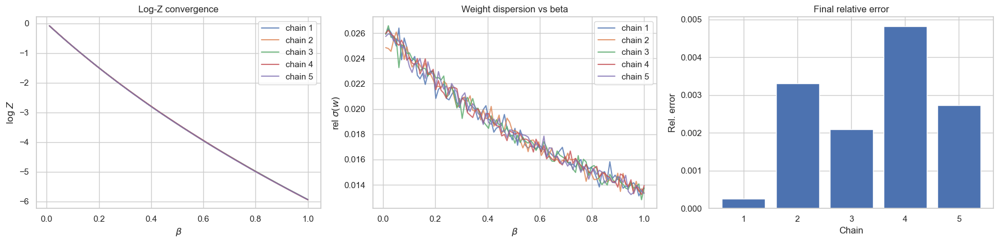

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.155e-02  | <w> mean = 9.2169e-01
[beta=0.020]  mean log rho = -8.045e-02  | <w> mean = 9.2270e-01
[beta=0.030]  mean log rho = -7.985e-02  | <w> mean = 9.2326e-01
[beta=0.040]  mean log rho = -7.864e-02  | <w> mean = 9.2438e-01
[beta=0.051]  mean log rho = -7.898e-02  | <w> mean = 9.2406e-01
[beta=0.061]  mean log rho = -7.877e-02  | <w> mean = 9.2425e-01
[beta=0.071]  mean log rho = -7.812e-02  | <w> mean = 9.2485e-01
[beta=0.081]  mean log rho = -7.659e-02  | <w> mean = 9.2627e-01
[beta=0.091]  mean log rho = -7.573e-02  | <w> mean = 9.2707e-01
[22:13:07] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.612e-02  | <w> mean = 9.2671e-01
[beta=0.111]  mean log rho = -7.451e-02  | <w> mean = 9.2820e-01
[beta=0.121]  mean log rho = -7.426e-02  | <w> mean = 9.2843e-01
[beta=0.131]  mean log rho = -7.385e-02  | <w> mean = 9.2881e-01
[beta=0.141]  mean log rho = -7.258e-02  | <w> mean = 9.2999e-01
[beta=0.152]  mean lo

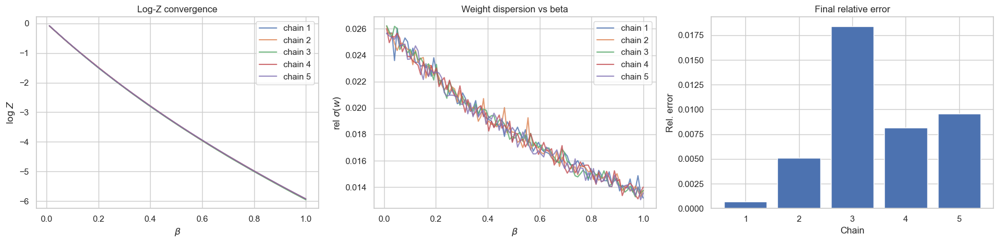

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.105e-02  | <w> mean = 9.2215e-01
[beta=0.020]  mean log rho = -8.057e-02  | <w> mean = 9.2259e-01
[beta=0.030]  mean log rho = -7.938e-02  | <w> mean = 9.2369e-01
[beta=0.040]  mean log rho = -7.988e-02  | <w> mean = 9.2322e-01
[beta=0.051]  mean log rho = -7.915e-02  | <w> mean = 9.2390e-01
[beta=0.061]  mean log rho = -7.776e-02  | <w> mean = 9.2518e-01
[beta=0.071]  mean log rho = -7.714e-02  | <w> mean = 9.2576e-01
[beta=0.081]  mean log rho = -7.673e-02  | <w> mean = 9.2614e-01
[beta=0.091]  mean log rho = -7.651e-02  | <w> mean = 9.2634e-01
[22:15:12] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.614e-02  | <w> mean = 9.2669e-01
[beta=0.111]  mean log rho = -7.549e-02  | <w> mean = 9.2729e-01
[beta=0.121]  mean log rho = -7.444e-02  | <w> mean = 9.2826e-01
[beta=0.131]  mean log rho = -7.430e-02  | <w> mean = 9.2840e-01
[beta=0.141]  mean log rho = -7.365e-02  | <w> mean = 9.2900e-01
[beta=0.152]  mean lo

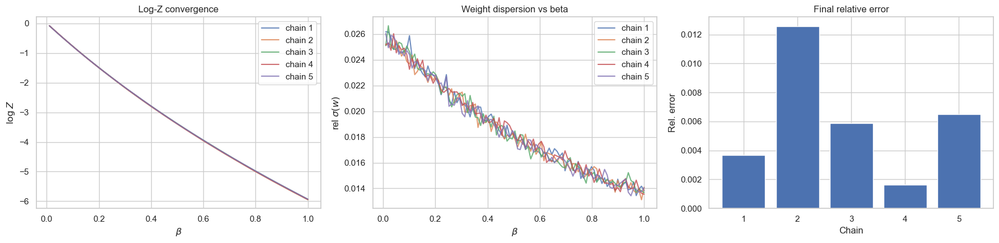

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.124e-02  | <w> mean = 9.2198e-01
[beta=0.020]  mean log rho = -8.069e-02  | <w> mean = 9.2248e-01
[beta=0.030]  mean log rho = -7.990e-02  | <w> mean = 9.2321e-01
[beta=0.040]  mean log rho = -8.035e-02  | <w> mean = 9.2279e-01
[beta=0.051]  mean log rho = -7.878e-02  | <w> mean = 9.2424e-01
[beta=0.061]  mean log rho = -7.840e-02  | <w> mean = 9.2460e-01
[beta=0.071]  mean log rho = -7.753e-02  | <w> mean = 9.2540e-01
[beta=0.081]  mean log rho = -7.721e-02  | <w> mean = 9.2570e-01
[beta=0.091]  mean log rho = -7.547e-02  | <w> mean = 9.2731e-01
[22:17:17] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.546e-02  | <w> mean = 9.2731e-01
[beta=0.111]  mean log rho = -7.490e-02  | <w> mean = 9.2784e-01
[beta=0.121]  mean log rho = -7.463e-02  | <w> mean = 9.2809e-01
[beta=0.131]  mean log rho = -7.355e-02  | <w> mean = 9.2909e-01
[beta=0.141]  mean log rho = -7.348e-02  | <w> mean = 9.2916e-01
[beta=0.152]  mean lo

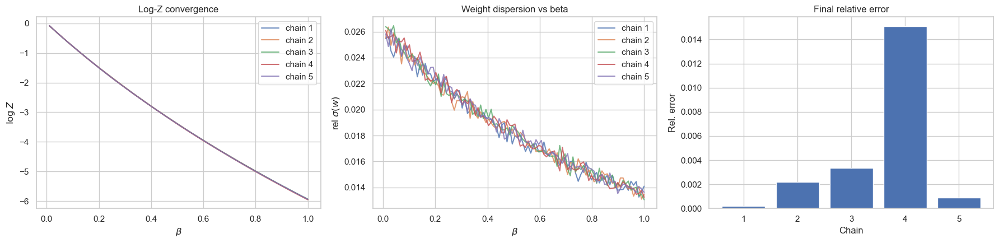

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.169e-02  | <w> mean = 9.2156e-01
[beta=0.020]  mean log rho = -8.040e-02  | <w> mean = 9.2275e-01
[beta=0.030]  mean log rho = -7.950e-02  | <w> mean = 9.2358e-01
[beta=0.040]  mean log rho = -7.902e-02  | <w> mean = 9.2402e-01
[beta=0.051]  mean log rho = -7.883e-02  | <w> mean = 9.2420e-01
[beta=0.061]  mean log rho = -7.756e-02  | <w> mean = 9.2537e-01
[beta=0.071]  mean log rho = -7.759e-02  | <w> mean = 9.2534e-01
[beta=0.081]  mean log rho = -7.766e-02  | <w> mean = 9.2528e-01
[beta=0.091]  mean log rho = -7.606e-02  | <w> mean = 9.2676e-01
[22:19:20] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.487e-02  | <w> mean = 9.2786e-01
[beta=0.111]  mean log rho = -7.547e-02  | <w> mean = 9.2731e-01
[beta=0.121]  mean log rho = -7.469e-02  | <w> mean = 9.2803e-01
[beta=0.131]  mean log rho = -7.360e-02  | <w> mean = 9.2905e-01
[beta=0.141]  mean log rho = -7.299e-02  | <w> mean = 9.2961e-01
[beta=0.152]  mean lo

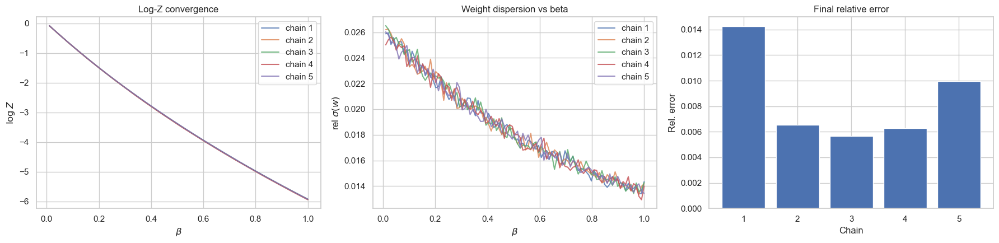

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.234e-02  | <w> mean = 9.2096e-01
[beta=0.020]  mean log rho = -8.019e-02  | <w> mean = 9.2294e-01
[beta=0.030]  mean log rho = -8.019e-02  | <w> mean = 9.2294e-01
[beta=0.040]  mean log rho = -7.954e-02  | <w> mean = 9.2354e-01
[beta=0.051]  mean log rho = -7.838e-02  | <w> mean = 9.2462e-01
[beta=0.061]  mean log rho = -7.743e-02  | <w> mean = 9.2549e-01
[beta=0.071]  mean log rho = -7.743e-02  | <w> mean = 9.2549e-01
[beta=0.081]  mean log rho = -7.671e-02  | <w> mean = 9.2616e-01
[beta=0.091]  mean log rho = -7.597e-02  | <w> mean = 9.2684e-01
[22:21:22] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.647e-02  | <w> mean = 9.2638e-01
[beta=0.111]  mean log rho = -7.490e-02  | <w> mean = 9.2784e-01
[beta=0.121]  mean log rho = -7.457e-02  | <w> mean = 9.2814e-01
[beta=0.131]  mean log rho = -7.366e-02  | <w> mean = 9.2898e-01
[beta=0.141]  mean log rho = -7.346e-02  | <w> mean = 9.2918e-01
[beta=0.152]  mean lo

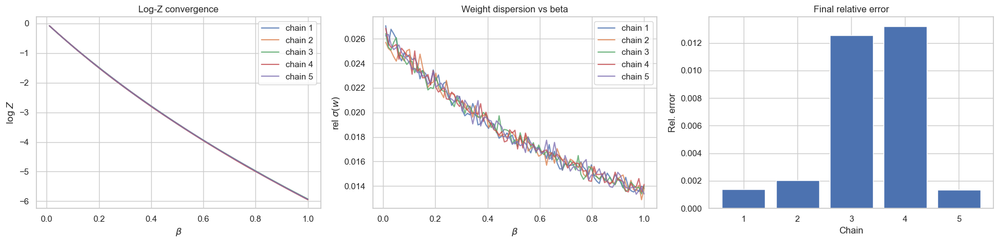

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.165e-02  | <w> mean = 9.2159e-01
[beta=0.020]  mean log rho = -8.039e-02  | <w> mean = 9.2276e-01
[beta=0.030]  mean log rho = -8.009e-02  | <w> mean = 9.2303e-01
[beta=0.040]  mean log rho = -7.940e-02  | <w> mean = 9.2367e-01
[beta=0.051]  mean log rho = -7.981e-02  | <w> mean = 9.2329e-01
[beta=0.061]  mean log rho = -7.756e-02  | <w> mean = 9.2537e-01
[beta=0.071]  mean log rho = -7.718e-02  | <w> mean = 9.2572e-01
[beta=0.081]  mean log rho = -7.711e-02  | <w> mean = 9.2579e-01
[beta=0.091]  mean log rho = -7.624e-02  | <w> mean = 9.2660e-01
[22:23:27] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.592e-02  | <w> mean = 9.2689e-01
[beta=0.111]  mean log rho = -7.495e-02  | <w> mean = 9.2779e-01
[beta=0.121]  mean log rho = -7.433e-02  | <w> mean = 9.2836e-01
[beta=0.131]  mean log rho = -7.465e-02  | <w> mean = 9.2807e-01
[beta=0.141]  mean log rho = -7.376e-02  | <w> mean = 9.2889e-01
[beta=0.152]  mean lo

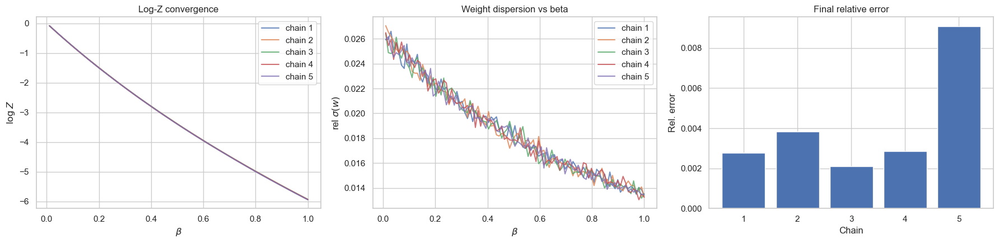


>>> Running with 3 rounds
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.119e-02  | <w> mean = 9.2202e-01
[beta=0.020]  mean log rho = -8.085e-02  | <w> mean = 9.2233e-01
[beta=0.030]  mean log rho = -7.935e-02  | <w> mean = 9.2372e-01
[beta=0.040]  mean log rho = -7.991e-02  | <w> mean = 9.2320e-01
[beta=0.051]  mean log rho = -7.886e-02  | <w> mean = 9.2417e-01
[beta=0.061]  mean log rho = -7.771e-02  | <w> mean = 9.2524e-01
[beta=0.071]  mean log rho = -7.800e-02  | <w> mean = 9.2496e-01
[beta=0.081]  mean log rho = -7.718e-02  | <w> mean = 9.2572e-01
[beta=0.091]  mean log rho = -7.634e-02  | <w> mean = 9.2650e-01
[22:25:31] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.618e-02  | <w> mean = 9.2665e-01
[beta=0.111]  mean log rho = -7.513e-02  | <w> mean = 9.2762e-01
[beta=0.121]  mean log rho = -7.462e-02  | <w> mean = 9.2809e-01
[beta=0.131]  mean log rho = -7.406e-02  | <w> mean = 9.2861e-01
[beta=0.141]  mean log rho = -7.363e-02  | <w> mean = 9.290

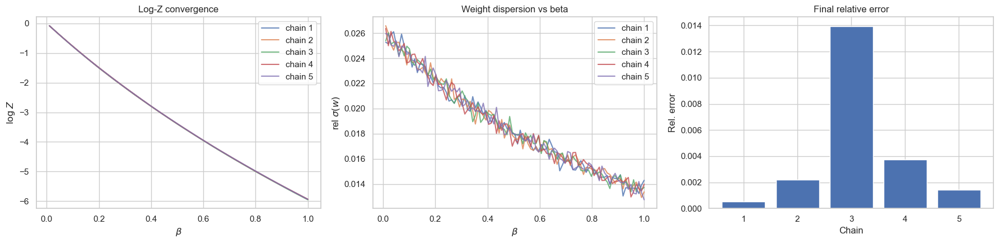

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.153e-02  | <w> mean = 9.2170e-01
[beta=0.020]  mean log rho = -8.084e-02  | <w> mean = 9.2234e-01
[beta=0.030]  mean log rho = -7.951e-02  | <w> mean = 9.2357e-01
[beta=0.040]  mean log rho = -7.921e-02  | <w> mean = 9.2385e-01
[beta=0.051]  mean log rho = -7.936e-02  | <w> mean = 9.2371e-01
[beta=0.061]  mean log rho = -7.775e-02  | <w> mean = 9.2519e-01
[beta=0.071]  mean log rho = -7.732e-02  | <w> mean = 9.2560e-01
[beta=0.081]  mean log rho = -7.686e-02  | <w> mean = 9.2602e-01
[beta=0.091]  mean log rho = -7.675e-02  | <w> mean = 9.2612e-01
[22:27:36] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.572e-02  | <w> mean = 9.2708e-01
[beta=0.111]  mean log rho = -7.475e-02  | <w> mean = 9.2798e-01
[beta=0.121]  mean log rho = -7.419e-02  | <w> mean = 9.2849e-01
[beta=0.131]  mean log rho = -7.453e-02  | <w> mean = 9.2818e-01
[beta=0.141]  mean log rho = -7.295e-02  | <w> mean = 9.2964e-01
[beta=0.152]  mean lo

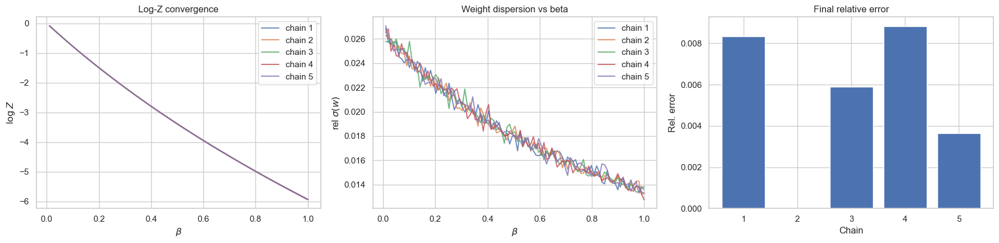

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.182e-02  | <w> mean = 9.2144e-01
[beta=0.020]  mean log rho = -8.124e-02  | <w> mean = 9.2197e-01
[beta=0.030]  mean log rho = -8.032e-02  | <w> mean = 9.2282e-01
[beta=0.040]  mean log rho = -7.946e-02  | <w> mean = 9.2361e-01
[beta=0.051]  mean log rho = -7.871e-02  | <w> mean = 9.2431e-01
[beta=0.061]  mean log rho = -7.835e-02  | <w> mean = 9.2464e-01
[beta=0.071]  mean log rho = -7.762e-02  | <w> mean = 9.2532e-01
[beta=0.081]  mean log rho = -7.781e-02  | <w> mean = 9.2514e-01
[beta=0.091]  mean log rho = -7.629e-02  | <w> mean = 9.2654e-01
[22:29:40] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.579e-02  | <w> mean = 9.2701e-01
[beta=0.111]  mean log rho = -7.526e-02  | <w> mean = 9.2750e-01
[beta=0.121]  mean log rho = -7.458e-02  | <w> mean = 9.2813e-01
[beta=0.131]  mean log rho = -7.392e-02  | <w> mean = 9.2875e-01
[beta=0.141]  mean log rho = -7.357e-02  | <w> mean = 9.2908e-01
[beta=0.152]  mean lo

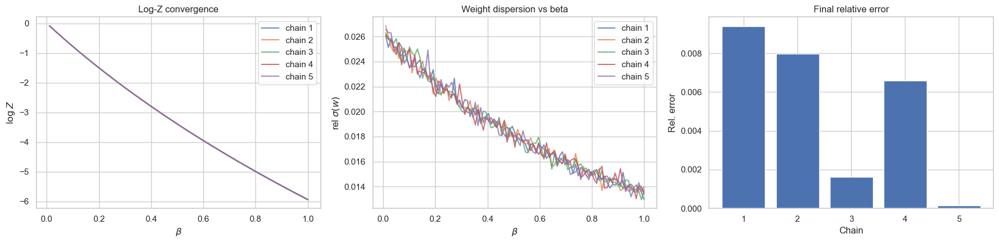

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.099e-02  | <w> mean = 9.2221e-01
[beta=0.020]  mean log rho = -8.032e-02  | <w> mean = 9.2282e-01
[beta=0.030]  mean log rho = -7.978e-02  | <w> mean = 9.2332e-01
[beta=0.040]  mean log rho = -7.986e-02  | <w> mean = 9.2325e-01
[beta=0.051]  mean log rho = -7.817e-02  | <w> mean = 9.2481e-01
[beta=0.061]  mean log rho = -7.829e-02  | <w> mean = 9.2470e-01
[beta=0.071]  mean log rho = -7.814e-02  | <w> mean = 9.2483e-01
[beta=0.081]  mean log rho = -7.680e-02  | <w> mean = 9.2607e-01
[beta=0.091]  mean log rho = -7.625e-02  | <w> mean = 9.2658e-01
[22:31:43] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.548e-02  | <w> mean = 9.2730e-01
[beta=0.111]  mean log rho = -7.532e-02  | <w> mean = 9.2745e-01
[beta=0.121]  mean log rho = -7.434e-02  | <w> mean = 9.2836e-01
[beta=0.131]  mean log rho = -7.411e-02  | <w> mean = 9.2857e-01
[beta=0.141]  mean log rho = -7.322e-02  | <w> mean = 9.2940e-01
[beta=0.152]  mean lo

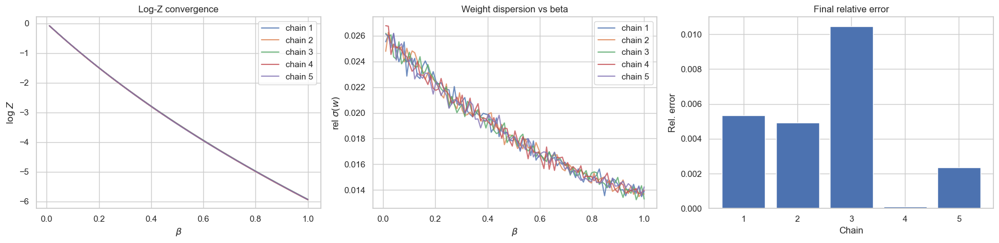

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.086e-02  | <w> mean = 9.2232e-01
[beta=0.020]  mean log rho = -8.053e-02  | <w> mean = 9.2262e-01
[beta=0.030]  mean log rho = -8.013e-02  | <w> mean = 9.2300e-01
[beta=0.040]  mean log rho = -7.903e-02  | <w> mean = 9.2401e-01
[beta=0.051]  mean log rho = -7.947e-02  | <w> mean = 9.2361e-01
[beta=0.061]  mean log rho = -7.752e-02  | <w> mean = 9.2541e-01
[beta=0.071]  mean log rho = -7.701e-02  | <w> mean = 9.2588e-01
[beta=0.081]  mean log rho = -7.676e-02  | <w> mean = 9.2611e-01
[beta=0.091]  mean log rho = -7.690e-02  | <w> mean = 9.2598e-01
[22:33:46] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.551e-02  | <w> mean = 9.2727e-01
[beta=0.111]  mean log rho = -7.541e-02  | <w> mean = 9.2737e-01
[beta=0.121]  mean log rho = -7.429e-02  | <w> mean = 9.2840e-01
[beta=0.131]  mean log rho = -7.411e-02  | <w> mean = 9.2857e-01
[beta=0.141]  mean log rho = -7.374e-02  | <w> mean = 9.2891e-01
[beta=0.152]  mean lo

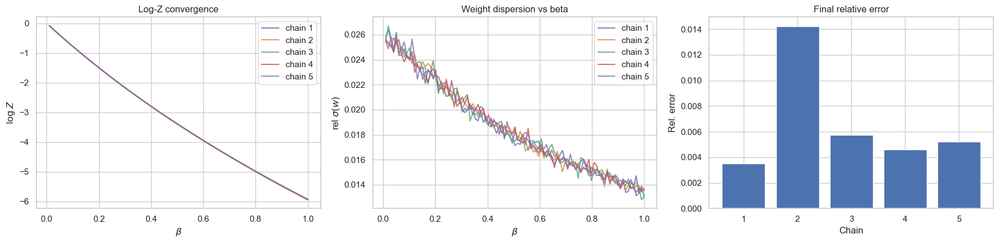

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.158e-02  | <w> mean = 9.2166e-01
[beta=0.020]  mean log rho = -8.057e-02  | <w> mean = 9.2259e-01
[beta=0.030]  mean log rho = -7.991e-02  | <w> mean = 9.2320e-01
[beta=0.040]  mean log rho = -7.951e-02  | <w> mean = 9.2357e-01
[beta=0.051]  mean log rho = -7.801e-02  | <w> mean = 9.2496e-01
[beta=0.061]  mean log rho = -7.774e-02  | <w> mean = 9.2520e-01
[beta=0.071]  mean log rho = -7.724e-02  | <w> mean = 9.2567e-01
[beta=0.081]  mean log rho = -7.676e-02  | <w> mean = 9.2611e-01
[beta=0.091]  mean log rho = -7.651e-02  | <w> mean = 9.2634e-01
[22:35:55] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.602e-02  | <w> mean = 9.2680e-01
[beta=0.111]  mean log rho = -7.469e-02  | <w> mean = 9.2803e-01
[beta=0.121]  mean log rho = -7.492e-02  | <w> mean = 9.2782e-01
[beta=0.131]  mean log rho = -7.436e-02  | <w> mean = 9.2834e-01
[beta=0.141]  mean log rho = -7.339e-02  | <w> mean = 9.2924e-01
[beta=0.152]  mean lo

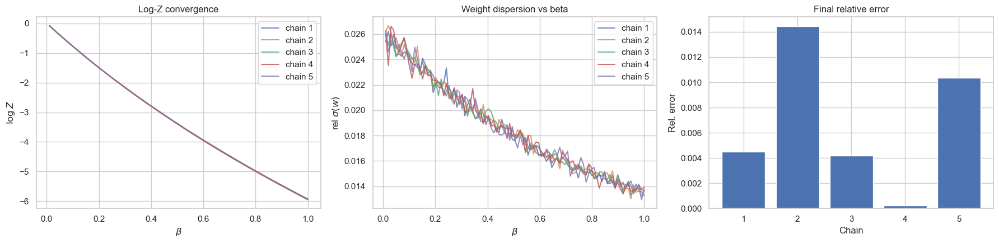

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.104e-02  | <w> mean = 9.2216e-01
[beta=0.020]  mean log rho = -8.048e-02  | <w> mean = 9.2267e-01
[beta=0.030]  mean log rho = -7.957e-02  | <w> mean = 9.2352e-01
[beta=0.040]  mean log rho = -7.956e-02  | <w> mean = 9.2352e-01
[beta=0.051]  mean log rho = -7.917e-02  | <w> mean = 9.2388e-01
[beta=0.061]  mean log rho = -7.822e-02  | <w> mean = 9.2476e-01
[beta=0.071]  mean log rho = -7.845e-02  | <w> mean = 9.2455e-01
[beta=0.081]  mean log rho = -7.697e-02  | <w> mean = 9.2591e-01
[beta=0.091]  mean log rho = -7.631e-02  | <w> mean = 9.2653e-01
[22:37:56] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.517e-02  | <w> mean = 9.2759e-01
[beta=0.111]  mean log rho = -7.495e-02  | <w> mean = 9.2779e-01
[beta=0.121]  mean log rho = -7.439e-02  | <w> mean = 9.2831e-01
[beta=0.131]  mean log rho = -7.464e-02  | <w> mean = 9.2808e-01
[beta=0.141]  mean log rho = -7.302e-02  | <w> mean = 9.2958e-01
[beta=0.152]  mean lo

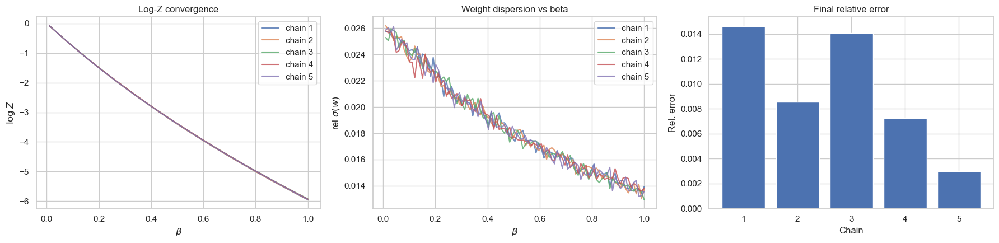

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.116e-02  | <w> mean = 9.2205e-01
[beta=0.020]  mean log rho = -8.100e-02  | <w> mean = 9.2219e-01
[beta=0.030]  mean log rho = -8.047e-02  | <w> mean = 9.2269e-01
[beta=0.040]  mean log rho = -7.922e-02  | <w> mean = 9.2384e-01
[beta=0.051]  mean log rho = -7.888e-02  | <w> mean = 9.2415e-01
[beta=0.061]  mean log rho = -7.801e-02  | <w> mean = 9.2496e-01
[beta=0.071]  mean log rho = -7.706e-02  | <w> mean = 9.2584e-01
[beta=0.081]  mean log rho = -7.757e-02  | <w> mean = 9.2536e-01
[beta=0.091]  mean log rho = -7.617e-02  | <w> mean = 9.2666e-01
[22:40:01] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.618e-02  | <w> mean = 9.2665e-01
[beta=0.111]  mean log rho = -7.568e-02  | <w> mean = 9.2711e-01
[beta=0.121]  mean log rho = -7.485e-02  | <w> mean = 9.2788e-01
[beta=0.131]  mean log rho = -7.402e-02  | <w> mean = 9.2865e-01
[beta=0.141]  mean log rho = -7.355e-02  | <w> mean = 9.2909e-01
[beta=0.152]  mean lo

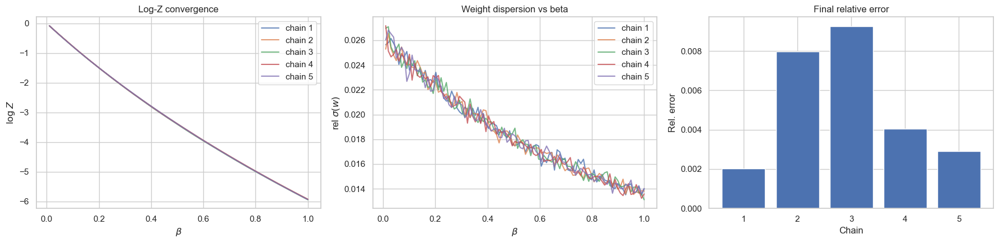

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.131e-02  | <w> mean = 9.2191e-01
[beta=0.020]  mean log rho = -8.089e-02  | <w> mean = 9.2229e-01
[beta=0.030]  mean log rho = -8.008e-02  | <w> mean = 9.2304e-01
[beta=0.040]  mean log rho = -7.950e-02  | <w> mean = 9.2358e-01
[beta=0.051]  mean log rho = -7.882e-02  | <w> mean = 9.2421e-01
[beta=0.061]  mean log rho = -7.870e-02  | <w> mean = 9.2432e-01
[beta=0.071]  mean log rho = -7.836e-02  | <w> mean = 9.2463e-01
[beta=0.081]  mean log rho = -7.659e-02  | <w> mean = 9.2627e-01
[beta=0.091]  mean log rho = -7.632e-02  | <w> mean = 9.2652e-01
[22:42:07] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.624e-02  | <w> mean = 9.2660e-01
[beta=0.111]  mean log rho = -7.521e-02  | <w> mean = 9.2755e-01
[beta=0.121]  mean log rho = -7.485e-02  | <w> mean = 9.2788e-01
[beta=0.131]  mean log rho = -7.396e-02  | <w> mean = 9.2871e-01
[beta=0.141]  mean log rho = -7.323e-02  | <w> mean = 9.2938e-01
[beta=0.152]  mean lo

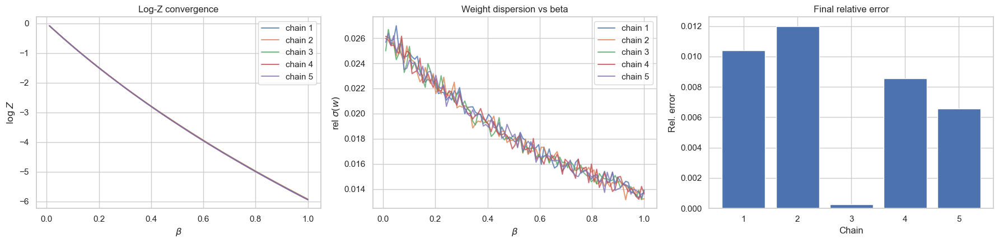

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.194e-02  | <w> mean = 9.2133e-01
[beta=0.020]  mean log rho = -8.064e-02  | <w> mean = 9.2253e-01
[beta=0.030]  mean log rho = -7.979e-02  | <w> mean = 9.2331e-01
[beta=0.040]  mean log rho = -7.958e-02  | <w> mean = 9.2350e-01
[beta=0.051]  mean log rho = -7.858e-02  | <w> mean = 9.2443e-01
[beta=0.061]  mean log rho = -7.858e-02  | <w> mean = 9.2443e-01
[beta=0.071]  mean log rho = -7.745e-02  | <w> mean = 9.2548e-01
[beta=0.081]  mean log rho = -7.709e-02  | <w> mean = 9.2581e-01
[beta=0.091]  mean log rho = -7.691e-02  | <w> mean = 9.2597e-01
[22:44:11] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.611e-02  | <w> mean = 9.2671e-01
[beta=0.111]  mean log rho = -7.516e-02  | <w> mean = 9.2759e-01
[beta=0.121]  mean log rho = -7.430e-02  | <w> mean = 9.2839e-01
[beta=0.131]  mean log rho = -7.527e-02  | <w> mean = 9.2749e-01
[beta=0.141]  mean log rho = -7.321e-02  | <w> mean = 9.2941e-01
[beta=0.152]  mean lo

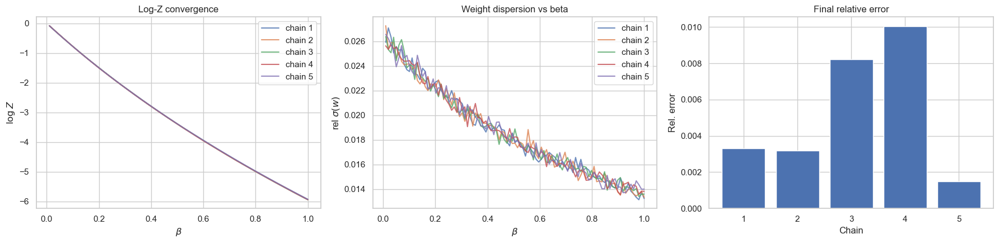


>>> Running with 5 rounds
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.112e-02  | <w> mean = 9.2208e-01
[beta=0.020]  mean log rho = -8.104e-02  | <w> mean = 9.2216e-01
[beta=0.030]  mean log rho = -7.937e-02  | <w> mean = 9.2370e-01
[beta=0.040]  mean log rho = -7.929e-02  | <w> mean = 9.2378e-01
[beta=0.051]  mean log rho = -7.867e-02  | <w> mean = 9.2434e-01
[beta=0.061]  mean log rho = -7.796e-02  | <w> mean = 9.2500e-01
[beta=0.071]  mean log rho = -7.728e-02  | <w> mean = 9.2563e-01
[beta=0.081]  mean log rho = -7.687e-02  | <w> mean = 9.2601e-01
[beta=0.091]  mean log rho = -7.660e-02  | <w> mean = 9.2626e-01
[22:46:19] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.493e-02  | <w> mean = 9.2781e-01
[beta=0.111]  mean log rho = -7.525e-02  | <w> mean = 9.2751e-01
[beta=0.121]  mean log rho = -7.430e-02  | <w> mean = 9.2840e-01
[beta=0.131]  mean log rho = -7.388e-02  | <w> mean = 9.2878e-01
[beta=0.141]  mean log rho = -7.424e-02  | <w> mean = 9.284

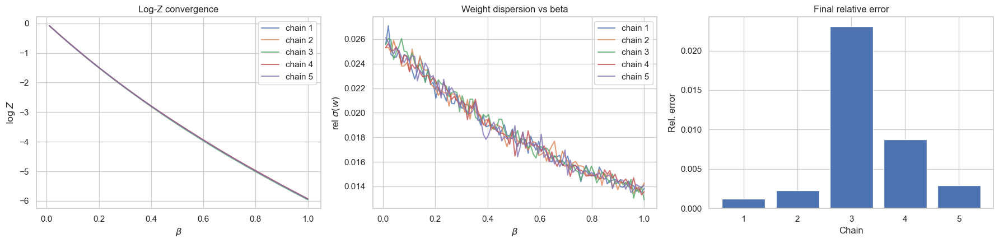

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.163e-02  | <w> mean = 9.2161e-01
[beta=0.020]  mean log rho = -8.069e-02  | <w> mean = 9.2248e-01
[beta=0.030]  mean log rho = -8.007e-02  | <w> mean = 9.2305e-01
[beta=0.040]  mean log rho = -7.912e-02  | <w> mean = 9.2393e-01
[beta=0.051]  mean log rho = -7.965e-02  | <w> mean = 9.2344e-01
[beta=0.061]  mean log rho = -7.883e-02  | <w> mean = 9.2420e-01
[beta=0.071]  mean log rho = -7.797e-02  | <w> mean = 9.2499e-01
[beta=0.081]  mean log rho = -7.694e-02  | <w> mean = 9.2595e-01
[beta=0.091]  mean log rho = -7.639e-02  | <w> mean = 9.2646e-01
[22:48:26] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.524e-02  | <w> mean = 9.2752e-01
[beta=0.111]  mean log rho = -7.504e-02  | <w> mean = 9.2770e-01
[beta=0.121]  mean log rho = -7.421e-02  | <w> mean = 9.2848e-01
[beta=0.131]  mean log rho = -7.316e-02  | <w> mean = 9.2945e-01
[beta=0.141]  mean log rho = -7.353e-02  | <w> mean = 9.2911e-01
[beta=0.152]  mean lo

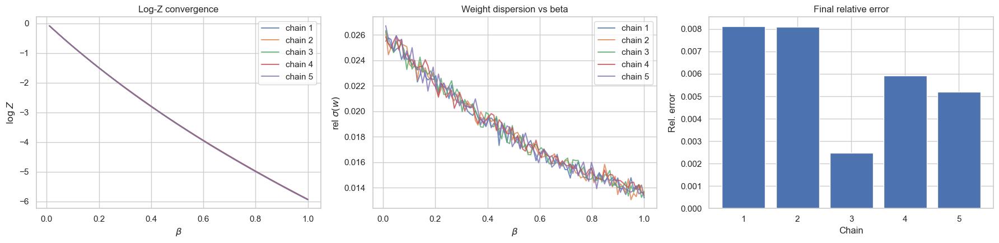

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.144e-02  | <w> mean = 9.2178e-01
[beta=0.020]  mean log rho = -8.038e-02  | <w> mean = 9.2277e-01
[beta=0.030]  mean log rho = -8.073e-02  | <w> mean = 9.2244e-01
[beta=0.040]  mean log rho = -7.853e-02  | <w> mean = 9.2447e-01
[beta=0.051]  mean log rho = -7.965e-02  | <w> mean = 9.2344e-01
[beta=0.061]  mean log rho = -7.846e-02  | <w> mean = 9.2454e-01
[beta=0.071]  mean log rho = -7.731e-02  | <w> mean = 9.2561e-01
[beta=0.081]  mean log rho = -7.726e-02  | <w> mean = 9.2565e-01
[beta=0.091]  mean log rho = -7.606e-02  | <w> mean = 9.2676e-01
[22:50:29] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.543e-02  | <w> mean = 9.2734e-01
[beta=0.111]  mean log rho = -7.480e-02  | <w> mean = 9.2793e-01
[beta=0.121]  mean log rho = -7.444e-02  | <w> mean = 9.2826e-01
[beta=0.131]  mean log rho = -7.381e-02  | <w> mean = 9.2885e-01
[beta=0.141]  mean log rho = -7.338e-02  | <w> mean = 9.2925e-01
[beta=0.152]  mean lo

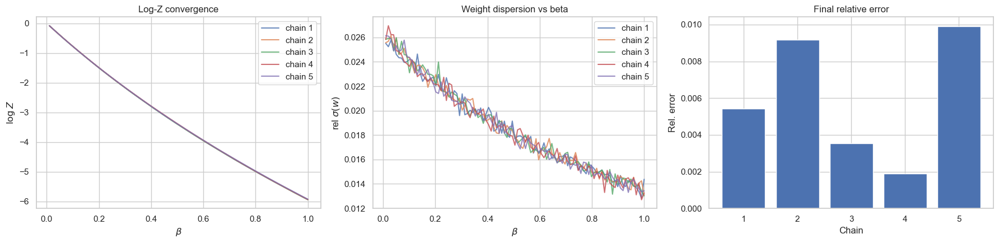

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.092e-02  | <w> mean = 9.2227e-01
[beta=0.020]  mean log rho = -8.022e-02  | <w> mean = 9.2291e-01
[beta=0.030]  mean log rho = -8.007e-02  | <w> mean = 9.2305e-01
[beta=0.040]  mean log rho = -7.910e-02  | <w> mean = 9.2395e-01
[beta=0.051]  mean log rho = -7.916e-02  | <w> mean = 9.2389e-01
[beta=0.061]  mean log rho = -7.780e-02  | <w> mean = 9.2515e-01
[beta=0.071]  mean log rho = -7.755e-02  | <w> mean = 9.2538e-01
[beta=0.081]  mean log rho = -7.757e-02  | <w> mean = 9.2536e-01
[beta=0.091]  mean log rho = -7.634e-02  | <w> mean = 9.2650e-01
[22:52:33] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.519e-02  | <w> mean = 9.2756e-01
[beta=0.111]  mean log rho = -7.531e-02  | <w> mean = 9.2746e-01
[beta=0.121]  mean log rho = -7.428e-02  | <w> mean = 9.2841e-01
[beta=0.131]  mean log rho = -7.413e-02  | <w> mean = 9.2856e-01
[beta=0.141]  mean log rho = -7.406e-02  | <w> mean = 9.2862e-01
[beta=0.152]  mean lo

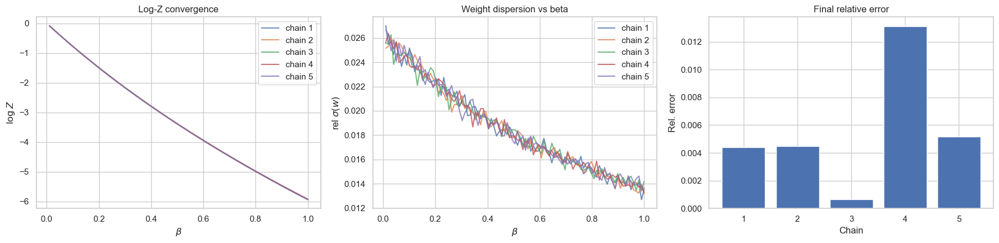

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.155e-02  | <w> mean = 9.2168e-01
[beta=0.020]  mean log rho = -8.113e-02  | <w> mean = 9.2207e-01
[beta=0.030]  mean log rho = -8.069e-02  | <w> mean = 9.2248e-01
[beta=0.040]  mean log rho = -7.888e-02  | <w> mean = 9.2415e-01
[beta=0.051]  mean log rho = -7.894e-02  | <w> mean = 9.2409e-01
[beta=0.061]  mean log rho = -7.807e-02  | <w> mean = 9.2490e-01
[beta=0.071]  mean log rho = -7.802e-02  | <w> mean = 9.2495e-01
[beta=0.081]  mean log rho = -7.678e-02  | <w> mean = 9.2610e-01
[beta=0.091]  mean log rho = -7.665e-02  | <w> mean = 9.2622e-01
[22:54:40] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.546e-02  | <w> mean = 9.2732e-01
[beta=0.111]  mean log rho = -7.545e-02  | <w> mean = 9.2733e-01
[beta=0.121]  mean log rho = -7.466e-02  | <w> mean = 9.2806e-01
[beta=0.131]  mean log rho = -7.351e-02  | <w> mean = 9.2912e-01
[beta=0.141]  mean log rho = -7.312e-02  | <w> mean = 9.2949e-01
[beta=0.152]  mean lo

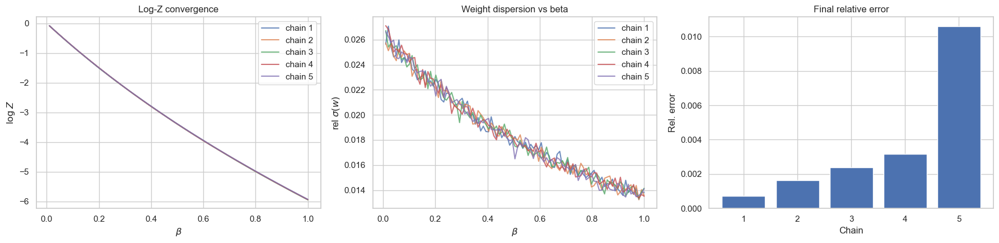

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.184e-02  | <w> mean = 9.2142e-01
[beta=0.020]  mean log rho = -8.065e-02  | <w> mean = 9.2251e-01
[beta=0.030]  mean log rho = -7.941e-02  | <w> mean = 9.2366e-01
[beta=0.040]  mean log rho = -7.922e-02  | <w> mean = 9.2384e-01
[beta=0.051]  mean log rho = -7.783e-02  | <w> mean = 9.2512e-01
[beta=0.061]  mean log rho = -7.818e-02  | <w> mean = 9.2479e-01
[beta=0.071]  mean log rho = -7.775e-02  | <w> mean = 9.2520e-01
[beta=0.081]  mean log rho = -7.751e-02  | <w> mean = 9.2542e-01
[beta=0.091]  mean log rho = -7.606e-02  | <w> mean = 9.2676e-01
[22:56:47] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.556e-02  | <w> mean = 9.2723e-01
[beta=0.111]  mean log rho = -7.517e-02  | <w> mean = 9.2759e-01
[beta=0.121]  mean log rho = -7.472e-02  | <w> mean = 9.2801e-01
[beta=0.131]  mean log rho = -7.334e-02  | <w> mean = 9.2929e-01
[beta=0.141]  mean log rho = -7.319e-02  | <w> mean = 9.2943e-01
[beta=0.152]  mean lo

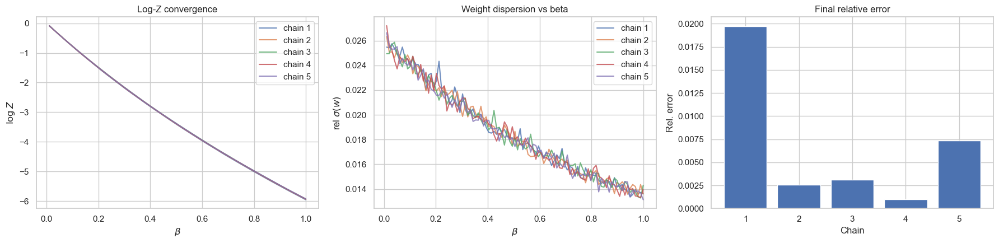

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.209e-02  | <w> mean = 9.2119e-01
[beta=0.020]  mean log rho = -8.180e-02  | <w> mean = 9.2146e-01
[beta=0.030]  mean log rho = -7.939e-02  | <w> mean = 9.2368e-01
[beta=0.040]  mean log rho = -8.011e-02  | <w> mean = 9.2301e-01
[beta=0.051]  mean log rho = -7.868e-02  | <w> mean = 9.2434e-01
[beta=0.061]  mean log rho = -7.802e-02  | <w> mean = 9.2494e-01
[beta=0.071]  mean log rho = -7.738e-02  | <w> mean = 9.2554e-01
[beta=0.081]  mean log rho = -7.769e-02  | <w> mean = 9.2526e-01
[beta=0.091]  mean log rho = -7.572e-02  | <w> mean = 9.2708e-01
[22:58:52] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.545e-02  | <w> mean = 9.2733e-01
[beta=0.111]  mean log rho = -7.497e-02  | <w> mean = 9.2777e-01
[beta=0.121]  mean log rho = -7.389e-02  | <w> mean = 9.2878e-01
[beta=0.131]  mean log rho = -7.439e-02  | <w> mean = 9.2831e-01
[beta=0.141]  mean log rho = -7.346e-02  | <w> mean = 9.2917e-01
[beta=0.152]  mean lo

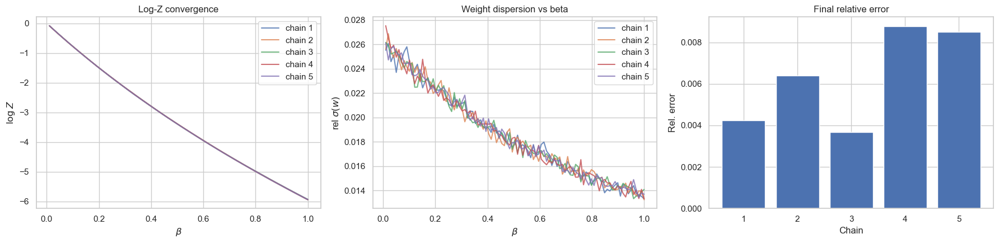

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.181e-02  | <w> mean = 9.2145e-01
[beta=0.020]  mean log rho = -7.969e-02  | <w> mean = 9.2340e-01
[beta=0.030]  mean log rho = -7.966e-02  | <w> mean = 9.2343e-01
[beta=0.040]  mean log rho = -7.950e-02  | <w> mean = 9.2358e-01
[beta=0.051]  mean log rho = -7.879e-02  | <w> mean = 9.2424e-01
[beta=0.061]  mean log rho = -7.786e-02  | <w> mean = 9.2510e-01
[beta=0.071]  mean log rho = -7.702e-02  | <w> mean = 9.2587e-01
[beta=0.081]  mean log rho = -7.672e-02  | <w> mean = 9.2615e-01
[beta=0.091]  mean log rho = -7.613e-02  | <w> mean = 9.2670e-01
[23:00:58] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.638e-02  | <w> mean = 9.2646e-01
[beta=0.111]  mean log rho = -7.505e-02  | <w> mean = 9.2770e-01
[beta=0.121]  mean log rho = -7.391e-02  | <w> mean = 9.2876e-01
[beta=0.131]  mean log rho = -7.419e-02  | <w> mean = 9.2849e-01
[beta=0.141]  mean log rho = -7.408e-02  | <w> mean = 9.2860e-01
[beta=0.152]  mean lo

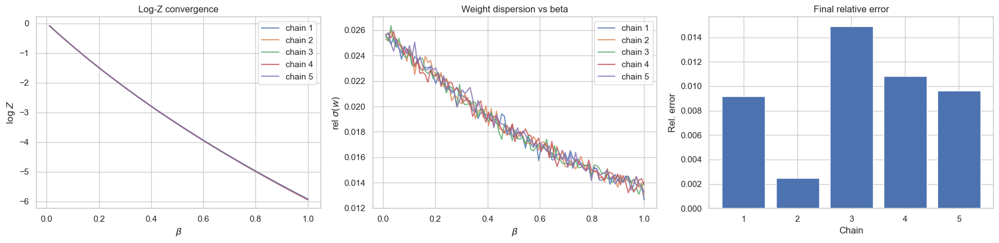

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.143e-02  | <w> mean = 9.2180e-01
[beta=0.020]  mean log rho = -8.095e-02  | <w> mean = 9.2224e-01
[beta=0.030]  mean log rho = -7.934e-02  | <w> mean = 9.2372e-01
[beta=0.040]  mean log rho = -8.022e-02  | <w> mean = 9.2292e-01
[beta=0.051]  mean log rho = -7.894e-02  | <w> mean = 9.2410e-01
[beta=0.061]  mean log rho = -7.766e-02  | <w> mean = 9.2528e-01
[beta=0.071]  mean log rho = -7.770e-02  | <w> mean = 9.2524e-01
[beta=0.081]  mean log rho = -7.723e-02  | <w> mean = 9.2567e-01
[beta=0.091]  mean log rho = -7.643e-02  | <w> mean = 9.2642e-01
[23:03:06] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.552e-02  | <w> mean = 9.2726e-01
[beta=0.111]  mean log rho = -7.505e-02  | <w> mean = 9.2770e-01
[beta=0.121]  mean log rho = -7.478e-02  | <w> mean = 9.2794e-01
[beta=0.131]  mean log rho = -7.360e-02  | <w> mean = 9.2904e-01
[beta=0.141]  mean log rho = -7.357e-02  | <w> mean = 9.2907e-01
[beta=0.152]  mean lo

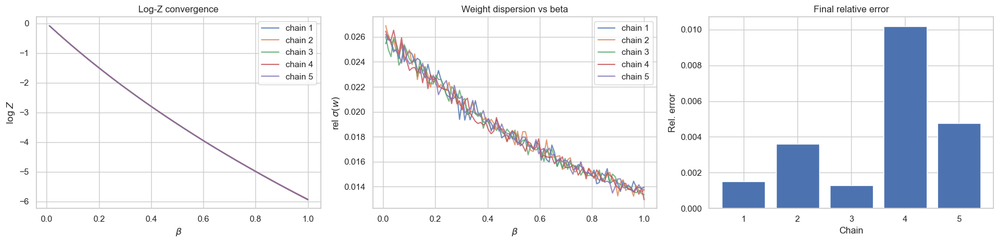

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.126e-02  | <w> mean = 9.2195e-01
[beta=0.020]  mean log rho = -8.055e-02  | <w> mean = 9.2261e-01
[beta=0.030]  mean log rho = -8.019e-02  | <w> mean = 9.2294e-01
[beta=0.040]  mean log rho = -7.883e-02  | <w> mean = 9.2419e-01
[beta=0.051]  mean log rho = -7.890e-02  | <w> mean = 9.2413e-01
[beta=0.061]  mean log rho = -7.789e-02  | <w> mean = 9.2507e-01
[beta=0.071]  mean log rho = -7.687e-02  | <w> mean = 9.2601e-01
[beta=0.081]  mean log rho = -7.755e-02  | <w> mean = 9.2538e-01
[beta=0.091]  mean log rho = -7.589e-02  | <w> mean = 9.2692e-01
[23:06:59] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.616e-02  | <w> mean = 9.2667e-01
[beta=0.111]  mean log rho = -7.533e-02  | <w> mean = 9.2743e-01
[beta=0.121]  mean log rho = -7.449e-02  | <w> mean = 9.2822e-01
[beta=0.131]  mean log rho = -7.324e-02  | <w> mean = 9.2937e-01
[beta=0.141]  mean log rho = -7.307e-02  | <w> mean = 9.2953e-01
[beta=0.152]  mean lo

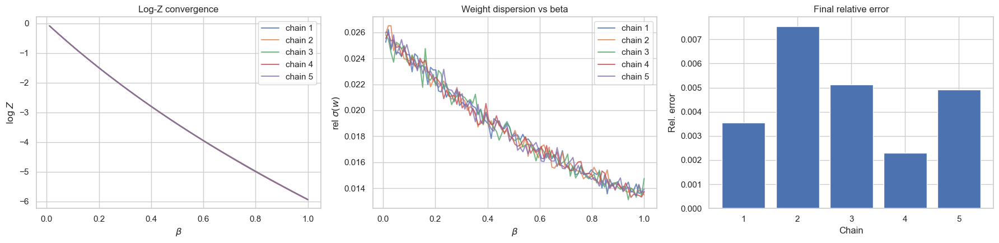


>>> Running with 10 rounds
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.105e-02  | <w> mean = 9.2214e-01
[beta=0.020]  mean log rho = -8.117e-02  | <w> mean = 9.2204e-01
[beta=0.030]  mean log rho = -8.069e-02  | <w> mean = 9.2248e-01
[beta=0.040]  mean log rho = -7.973e-02  | <w> mean = 9.2337e-01
[beta=0.051]  mean log rho = -7.845e-02  | <w> mean = 9.2455e-01
[beta=0.061]  mean log rho = -7.781e-02  | <w> mean = 9.2514e-01
[beta=0.071]  mean log rho = -7.773e-02  | <w> mean = 9.2522e-01
[beta=0.081]  mean log rho = -7.734e-02  | <w> mean = 9.2558e-01
[beta=0.091]  mean log rho = -7.604e-02  | <w> mean = 9.2677e-01
[23:09:07] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.572e-02  | <w> mean = 9.2707e-01
[beta=0.111]  mean log rho = -7.454e-02  | <w> mean = 9.2817e-01
[beta=0.121]  mean log rho = -7.467e-02  | <w> mean = 9.2805e-01
[beta=0.131]  mean log rho = -7.418e-02  | <w> mean = 9.2850e-01
[beta=0.141]  mean log rho = -7.280e-02  | <w> mean = 9.29

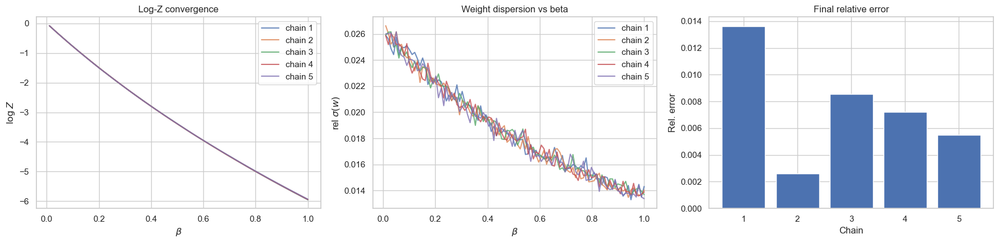

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.142e-02  | <w> mean = 9.2181e-01
[beta=0.020]  mean log rho = -8.101e-02  | <w> mean = 9.2218e-01
[beta=0.030]  mean log rho = -7.951e-02  | <w> mean = 9.2357e-01
[beta=0.040]  mean log rho = -7.921e-02  | <w> mean = 9.2385e-01
[beta=0.051]  mean log rho = -7.883e-02  | <w> mean = 9.2419e-01
[beta=0.061]  mean log rho = -7.738e-02  | <w> mean = 9.2553e-01
[beta=0.071]  mean log rho = -7.729e-02  | <w> mean = 9.2562e-01
[beta=0.081]  mean log rho = -7.669e-02  | <w> mean = 9.2618e-01
[beta=0.091]  mean log rho = -7.641e-02  | <w> mean = 9.2644e-01
[23:11:12] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.615e-02  | <w> mean = 9.2668e-01
[beta=0.111]  mean log rho = -7.536e-02  | <w> mean = 9.2741e-01
[beta=0.121]  mean log rho = -7.384e-02  | <w> mean = 9.2882e-01
[beta=0.131]  mean log rho = -7.390e-02  | <w> mean = 9.2876e-01
[beta=0.141]  mean log rho = -7.387e-02  | <w> mean = 9.2880e-01
[beta=0.152]  mean lo

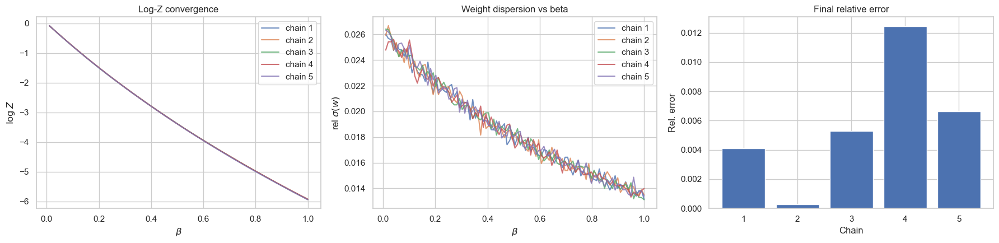

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.108e-02  | <w> mean = 9.2212e-01
[beta=0.020]  mean log rho = -8.041e-02  | <w> mean = 9.2274e-01
[beta=0.030]  mean log rho = -8.017e-02  | <w> mean = 9.2296e-01
[beta=0.040]  mean log rho = -7.977e-02  | <w> mean = 9.2333e-01
[beta=0.051]  mean log rho = -7.905e-02  | <w> mean = 9.2400e-01
[beta=0.061]  mean log rho = -7.849e-02  | <w> mean = 9.2451e-01
[beta=0.071]  mean log rho = -7.717e-02  | <w> mean = 9.2573e-01
[beta=0.081]  mean log rho = -7.688e-02  | <w> mean = 9.2600e-01
[beta=0.091]  mean log rho = -7.666e-02  | <w> mean = 9.2620e-01
[23:13:17] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.558e-02  | <w> mean = 9.2720e-01
[beta=0.111]  mean log rho = -7.518e-02  | <w> mean = 9.2758e-01
[beta=0.121]  mean log rho = -7.444e-02  | <w> mean = 9.2826e-01
[beta=0.131]  mean log rho = -7.381e-02  | <w> mean = 9.2884e-01
[beta=0.141]  mean log rho = -7.360e-02  | <w> mean = 9.2905e-01
[beta=0.152]  mean lo

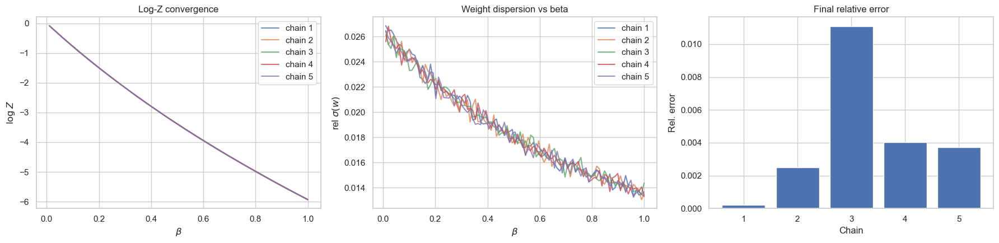

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.164e-02  | <w> mean = 9.2161e-01
[beta=0.020]  mean log rho = -8.018e-02  | <w> mean = 9.2295e-01
[beta=0.030]  mean log rho = -8.009e-02  | <w> mean = 9.2303e-01
[beta=0.040]  mean log rho = -7.914e-02  | <w> mean = 9.2391e-01
[beta=0.051]  mean log rho = -7.915e-02  | <w> mean = 9.2390e-01
[beta=0.061]  mean log rho = -7.825e-02  | <w> mean = 9.2473e-01
[beta=0.071]  mean log rho = -7.810e-02  | <w> mean = 9.2487e-01
[beta=0.081]  mean log rho = -7.689e-02  | <w> mean = 9.2599e-01
[beta=0.091]  mean log rho = -7.642e-02  | <w> mean = 9.2643e-01
[23:15:22] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.546e-02  | <w> mean = 9.2731e-01
[beta=0.111]  mean log rho = -7.518e-02  | <w> mean = 9.2757e-01
[beta=0.121]  mean log rho = -7.471e-02  | <w> mean = 9.2802e-01
[beta=0.131]  mean log rho = -7.395e-02  | <w> mean = 9.2872e-01
[beta=0.141]  mean log rho = -7.286e-02  | <w> mean = 9.2973e-01
[beta=0.152]  mean lo

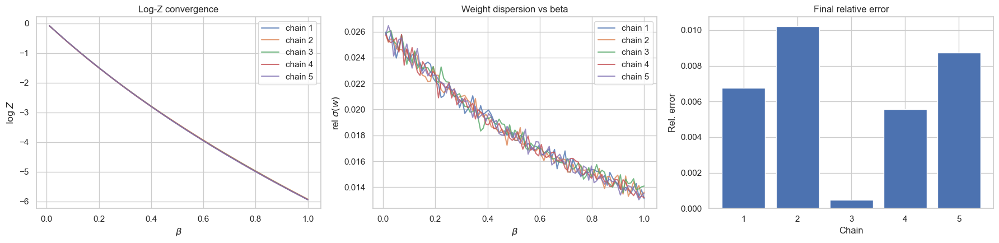

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.208e-02  | <w> mean = 9.2120e-01
[beta=0.020]  mean log rho = -8.004e-02  | <w> mean = 9.2308e-01
[beta=0.030]  mean log rho = -7.990e-02  | <w> mean = 9.2321e-01
[beta=0.040]  mean log rho = -7.943e-02  | <w> mean = 9.2364e-01
[beta=0.051]  mean log rho = -7.896e-02  | <w> mean = 9.2407e-01
[beta=0.061]  mean log rho = -7.788e-02  | <w> mean = 9.2507e-01
[beta=0.071]  mean log rho = -7.719e-02  | <w> mean = 9.2571e-01
[beta=0.081]  mean log rho = -7.714e-02  | <w> mean = 9.2576e-01
[beta=0.091]  mean log rho = -7.709e-02  | <w> mean = 9.2581e-01
[23:17:28] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.575e-02  | <w> mean = 9.2705e-01
[beta=0.111]  mean log rho = -7.471e-02  | <w> mean = 9.2802e-01
[beta=0.121]  mean log rho = -7.397e-02  | <w> mean = 9.2870e-01
[beta=0.131]  mean log rho = -7.404e-02  | <w> mean = 9.2864e-01
[beta=0.141]  mean log rho = -7.385e-02  | <w> mean = 9.2881e-01
[beta=0.152]  mean lo

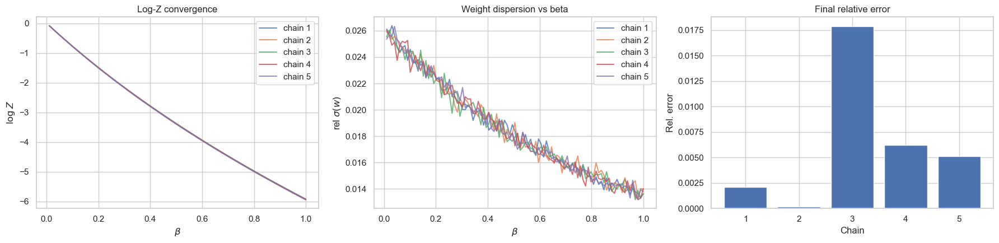

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.195e-02  | <w> mean = 9.2132e-01
[beta=0.020]  mean log rho = -8.061e-02  | <w> mean = 9.2255e-01
[beta=0.030]  mean log rho = -7.911e-02  | <w> mean = 9.2394e-01
[beta=0.040]  mean log rho = -7.964e-02  | <w> mean = 9.2345e-01
[beta=0.051]  mean log rho = -7.895e-02  | <w> mean = 9.2409e-01
[beta=0.061]  mean log rho = -7.738e-02  | <w> mean = 9.2553e-01
[beta=0.071]  mean log rho = -7.808e-02  | <w> mean = 9.2489e-01
[beta=0.081]  mean log rho = -7.671e-02  | <w> mean = 9.2616e-01
[beta=0.091]  mean log rho = -7.648e-02  | <w> mean = 9.2637e-01
[23:19:35] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.543e-02  | <w> mean = 9.2734e-01
[beta=0.111]  mean log rho = -7.536e-02  | <w> mean = 9.2741e-01
[beta=0.121]  mean log rho = -7.472e-02  | <w> mean = 9.2800e-01
[beta=0.131]  mean log rho = -7.404e-02  | <w> mean = 9.2863e-01
[beta=0.141]  mean log rho = -7.301e-02  | <w> mean = 9.2960e-01
[beta=0.152]  mean lo

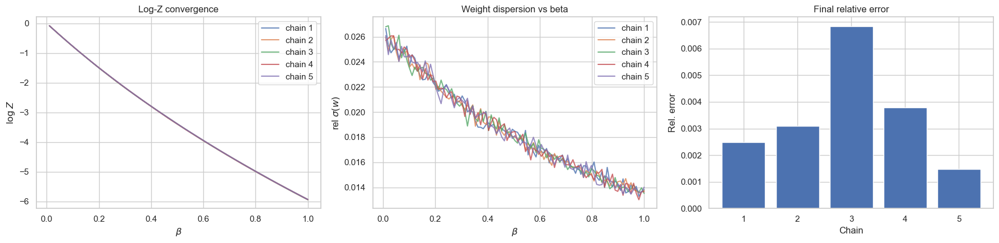

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.187e-02  | <w> mean = 9.2140e-01
[beta=0.020]  mean log rho = -8.069e-02  | <w> mean = 9.2248e-01
[beta=0.030]  mean log rho = -8.054e-02  | <w> mean = 9.2262e-01
[beta=0.040]  mean log rho = -7.916e-02  | <w> mean = 9.2389e-01
[beta=0.051]  mean log rho = -7.838e-02  | <w> mean = 9.2461e-01
[beta=0.061]  mean log rho = -7.839e-02  | <w> mean = 9.2460e-01
[beta=0.071]  mean log rho = -7.749e-02  | <w> mean = 9.2544e-01
[beta=0.081]  mean log rho = -7.799e-02  | <w> mean = 9.2497e-01
[beta=0.091]  mean log rho = -7.608e-02  | <w> mean = 9.2674e-01
[23:21:42] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.556e-02  | <w> mean = 9.2723e-01
[beta=0.111]  mean log rho = -7.562e-02  | <w> mean = 9.2717e-01
[beta=0.121]  mean log rho = -7.480e-02  | <w> mean = 9.2793e-01
[beta=0.131]  mean log rho = -7.317e-02  | <w> mean = 9.2944e-01
[beta=0.141]  mean log rho = -7.356e-02  | <w> mean = 9.2908e-01
[beta=0.152]  mean lo

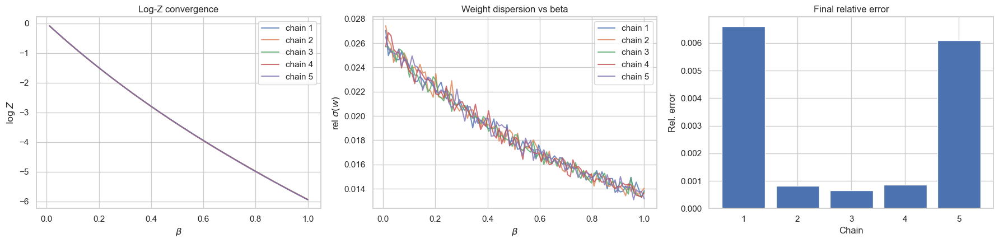

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.144e-02  | <w> mean = 9.2179e-01
[beta=0.020]  mean log rho = -8.097e-02  | <w> mean = 9.2222e-01
[beta=0.030]  mean log rho = -8.020e-02  | <w> mean = 9.2294e-01
[beta=0.040]  mean log rho = -7.971e-02  | <w> mean = 9.2338e-01
[beta=0.051]  mean log rho = -7.823e-02  | <w> mean = 9.2475e-01
[beta=0.061]  mean log rho = -7.739e-02  | <w> mean = 9.2553e-01
[beta=0.071]  mean log rho = -7.652e-02  | <w> mean = 9.2634e-01
[beta=0.081]  mean log rho = -7.779e-02  | <w> mean = 9.2516e-01
[beta=0.091]  mean log rho = -7.621e-02  | <w> mean = 9.2662e-01
[23:23:50] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.528e-02  | <w> mean = 9.2749e-01
[beta=0.111]  mean log rho = -7.510e-02  | <w> mean = 9.2765e-01
[beta=0.121]  mean log rho = -7.454e-02  | <w> mean = 9.2817e-01
[beta=0.131]  mean log rho = -7.458e-02  | <w> mean = 9.2813e-01
[beta=0.141]  mean log rho = -7.344e-02  | <w> mean = 9.2919e-01
[beta=0.152]  mean lo

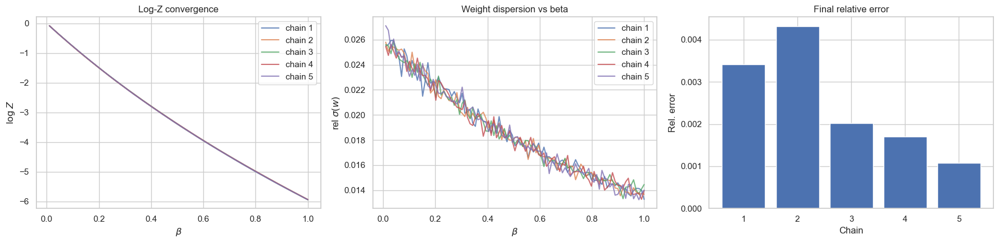

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.211e-02  | <w> mean = 9.2117e-01
[beta=0.020]  mean log rho = -8.041e-02  | <w> mean = 9.2274e-01
[beta=0.030]  mean log rho = -8.011e-02  | <w> mean = 9.2301e-01
[beta=0.040]  mean log rho = -7.945e-02  | <w> mean = 9.2362e-01
[beta=0.051]  mean log rho = -7.955e-02  | <w> mean = 9.2353e-01
[beta=0.061]  mean log rho = -7.828e-02  | <w> mean = 9.2470e-01
[beta=0.071]  mean log rho = -7.845e-02  | <w> mean = 9.2455e-01
[beta=0.081]  mean log rho = -7.721e-02  | <w> mean = 9.2570e-01
[beta=0.091]  mean log rho = -7.613e-02  | <w> mean = 9.2670e-01
[23:25:59] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.615e-02  | <w> mean = 9.2668e-01
[beta=0.111]  mean log rho = -7.496e-02  | <w> mean = 9.2778e-01
[beta=0.121]  mean log rho = -7.416e-02  | <w> mean = 9.2852e-01
[beta=0.131]  mean log rho = -7.410e-02  | <w> mean = 9.2858e-01
[beta=0.141]  mean log rho = -7.390e-02  | <w> mean = 9.2877e-01
[beta=0.152]  mean lo

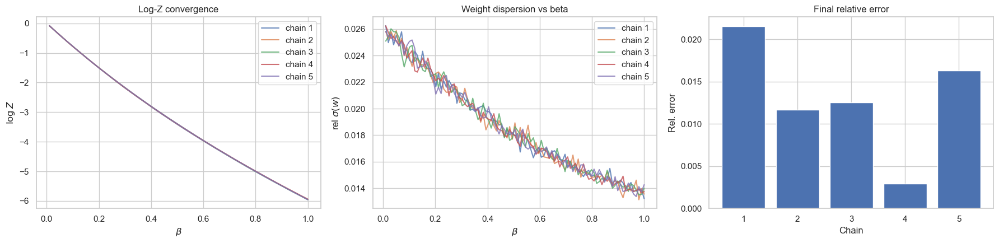

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.078e-02  | <w> mean = 9.2240e-01
[beta=0.020]  mean log rho = -8.111e-02  | <w> mean = 9.2209e-01
[beta=0.030]  mean log rho = -7.963e-02  | <w> mean = 9.2346e-01
[beta=0.040]  mean log rho = -7.895e-02  | <w> mean = 9.2408e-01
[beta=0.051]  mean log rho = -7.897e-02  | <w> mean = 9.2407e-01
[beta=0.061]  mean log rho = -7.870e-02  | <w> mean = 9.2432e-01
[beta=0.071]  mean log rho = -7.765e-02  | <w> mean = 9.2529e-01
[beta=0.081]  mean log rho = -7.714e-02  | <w> mean = 9.2576e-01
[beta=0.091]  mean log rho = -7.631e-02  | <w> mean = 9.2653e-01
[23:28:08] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.595e-02  | <w> mean = 9.2687e-01
[beta=0.111]  mean log rho = -7.546e-02  | <w> mean = 9.2732e-01
[beta=0.121]  mean log rho = -7.460e-02  | <w> mean = 9.2811e-01
[beta=0.131]  mean log rho = -7.521e-02  | <w> mean = 9.2755e-01
[beta=0.141]  mean log rho = -7.320e-02  | <w> mean = 9.2942e-01
[beta=0.152]  mean lo

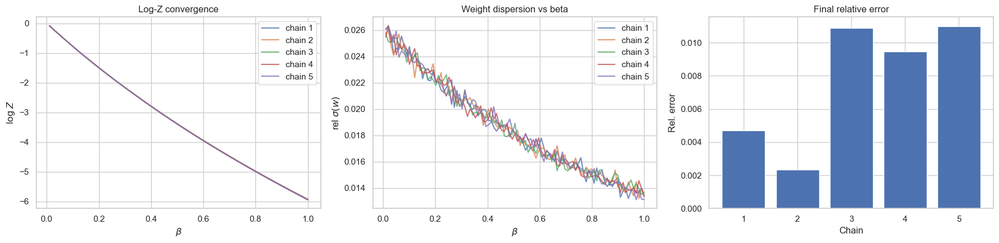


>>> Running with 20 rounds
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.142e-02  | <w> mean = 9.2181e-01
[beta=0.020]  mean log rho = -7.964e-02  | <w> mean = 9.2345e-01
[beta=0.030]  mean log rho = -7.998e-02  | <w> mean = 9.2313e-01
[beta=0.040]  mean log rho = -7.917e-02  | <w> mean = 9.2388e-01
[beta=0.051]  mean log rho = -7.888e-02  | <w> mean = 9.2415e-01
[beta=0.061]  mean log rho = -7.776e-02  | <w> mean = 9.2519e-01
[beta=0.071]  mean log rho = -7.803e-02  | <w> mean = 9.2494e-01
[beta=0.081]  mean log rho = -7.713e-02  | <w> mean = 9.2577e-01
[beta=0.091]  mean log rho = -7.632e-02  | <w> mean = 9.2652e-01
[23:30:17] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.567e-02  | <w> mean = 9.2712e-01
[beta=0.111]  mean log rho = -7.459e-02  | <w> mean = 9.2813e-01
[beta=0.121]  mean log rho = -7.431e-02  | <w> mean = 9.2838e-01
[beta=0.131]  mean log rho = -7.408e-02  | <w> mean = 9.2860e-01
[beta=0.141]  mean log rho = -7.366e-02  | <w> mean = 9.28

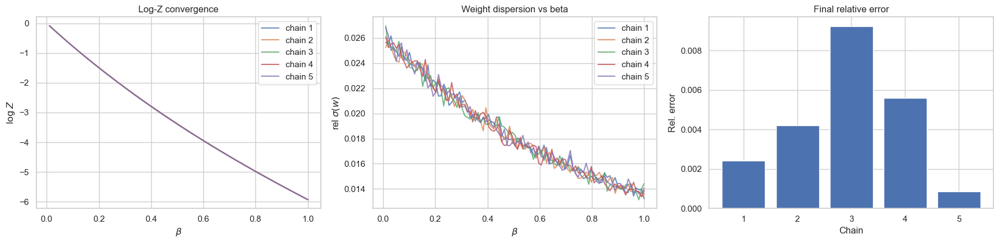

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.082e-02  | <w> mean = 9.2236e-01
[beta=0.020]  mean log rho = -8.106e-02  | <w> mean = 9.2214e-01
[beta=0.030]  mean log rho = -8.056e-02  | <w> mean = 9.2260e-01
[beta=0.040]  mean log rho = -7.912e-02  | <w> mean = 9.2393e-01
[beta=0.051]  mean log rho = -7.921e-02  | <w> mean = 9.2384e-01
[beta=0.061]  mean log rho = -7.768e-02  | <w> mean = 9.2526e-01
[beta=0.071]  mean log rho = -7.750e-02  | <w> mean = 9.2543e-01
[beta=0.081]  mean log rho = -7.697e-02  | <w> mean = 9.2592e-01
[beta=0.091]  mean log rho = -7.637e-02  | <w> mean = 9.2648e-01
[23:32:28] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.579e-02  | <w> mean = 9.2701e-01
[beta=0.111]  mean log rho = -7.548e-02  | <w> mean = 9.2730e-01
[beta=0.121]  mean log rho = -7.472e-02  | <w> mean = 9.2801e-01
[beta=0.131]  mean log rho = -7.385e-02  | <w> mean = 9.2881e-01
[beta=0.141]  mean log rho = -7.332e-02  | <w> mean = 9.2930e-01
[beta=0.152]  mean lo

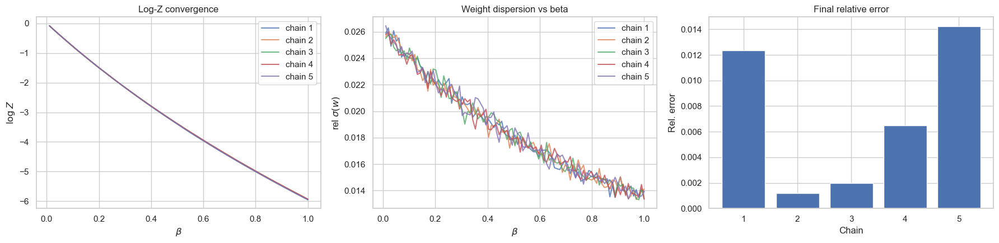

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.172e-02  | <w> mean = 9.2153e-01
[beta=0.020]  mean log rho = -8.142e-02  | <w> mean = 9.2181e-01
[beta=0.030]  mean log rho = -8.024e-02  | <w> mean = 9.2289e-01
[beta=0.040]  mean log rho = -7.949e-02  | <w> mean = 9.2359e-01
[beta=0.051]  mean log rho = -7.931e-02  | <w> mean = 9.2375e-01
[beta=0.061]  mean log rho = -7.831e-02  | <w> mean = 9.2468e-01
[beta=0.071]  mean log rho = -7.712e-02  | <w> mean = 9.2578e-01
[beta=0.081]  mean log rho = -7.776e-02  | <w> mean = 9.2519e-01
[beta=0.091]  mean log rho = -7.639e-02  | <w> mean = 9.2645e-01
[23:34:37] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.567e-02  | <w> mean = 9.2713e-01
[beta=0.111]  mean log rho = -7.555e-02  | <w> mean = 9.2723e-01
[beta=0.121]  mean log rho = -7.430e-02  | <w> mean = 9.2840e-01
[beta=0.131]  mean log rho = -7.362e-02  | <w> mean = 9.2902e-01
[beta=0.141]  mean log rho = -7.362e-02  | <w> mean = 9.2902e-01
[beta=0.152]  mean lo

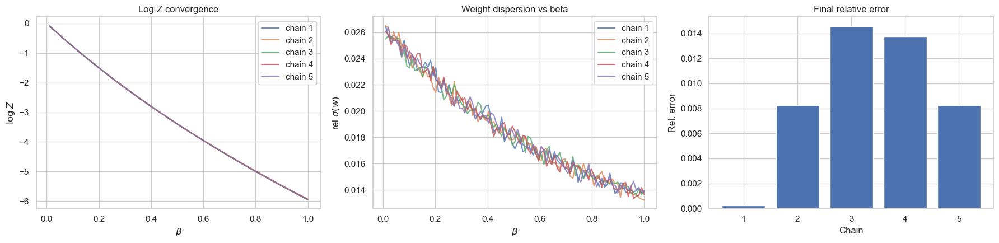

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.125e-02  | <w> mean = 9.2196e-01
[beta=0.020]  mean log rho = -8.123e-02  | <w> mean = 9.2198e-01
[beta=0.030]  mean log rho = -7.967e-02  | <w> mean = 9.2342e-01
[beta=0.040]  mean log rho = -7.968e-02  | <w> mean = 9.2341e-01
[beta=0.051]  mean log rho = -7.867e-02  | <w> mean = 9.2435e-01
[beta=0.061]  mean log rho = -7.865e-02  | <w> mean = 9.2436e-01
[beta=0.071]  mean log rho = -7.773e-02  | <w> mean = 9.2522e-01
[beta=0.081]  mean log rho = -7.725e-02  | <w> mean = 9.2566e-01
[beta=0.091]  mean log rho = -7.620e-02  | <w> mean = 9.2663e-01
[23:36:45] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.519e-02  | <w> mean = 9.2756e-01
[beta=0.111]  mean log rho = -7.552e-02  | <w> mean = 9.2727e-01
[beta=0.121]  mean log rho = -7.454e-02  | <w> mean = 9.2817e-01
[beta=0.131]  mean log rho = -7.341e-02  | <w> mean = 9.2922e-01
[beta=0.141]  mean log rho = -7.331e-02  | <w> mean = 9.2931e-01
[beta=0.152]  mean lo

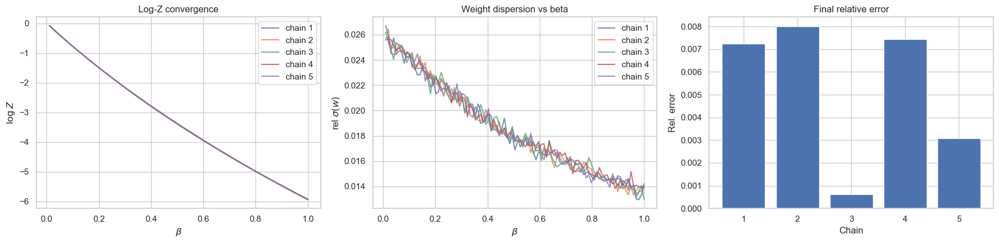

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.137e-02  | <w> mean = 9.2185e-01
[beta=0.020]  mean log rho = -8.028e-02  | <w> mean = 9.2286e-01
[beta=0.030]  mean log rho = -8.000e-02  | <w> mean = 9.2311e-01
[beta=0.040]  mean log rho = -7.877e-02  | <w> mean = 9.2425e-01
[beta=0.051]  mean log rho = -7.889e-02  | <w> mean = 9.2415e-01
[beta=0.061]  mean log rho = -7.796e-02  | <w> mean = 9.2500e-01
[beta=0.071]  mean log rho = -7.741e-02  | <w> mean = 9.2551e-01
[beta=0.081]  mean log rho = -7.659e-02  | <w> mean = 9.2627e-01
[beta=0.091]  mean log rho = -7.644e-02  | <w> mean = 9.2641e-01
[23:38:54] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.589e-02  | <w> mean = 9.2692e-01
[beta=0.111]  mean log rho = -7.561e-02  | <w> mean = 9.2718e-01
[beta=0.121]  mean log rho = -7.432e-02  | <w> mean = 9.2838e-01
[beta=0.131]  mean log rho = -7.407e-02  | <w> mean = 9.2861e-01
[beta=0.141]  mean log rho = -7.352e-02  | <w> mean = 9.2912e-01
[beta=0.152]  mean lo

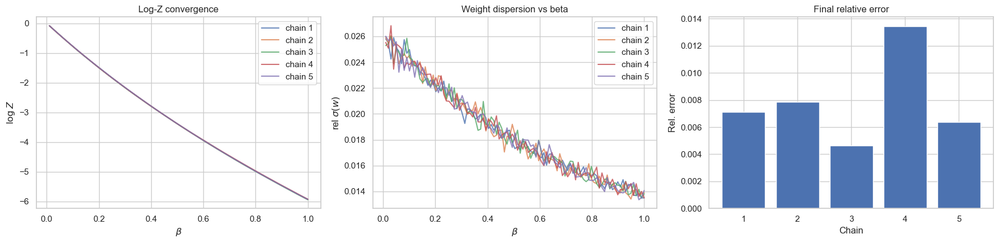

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.168e-02  | <w> mean = 9.2157e-01
[beta=0.020]  mean log rho = -8.072e-02  | <w> mean = 9.2245e-01
[beta=0.030]  mean log rho = -7.971e-02  | <w> mean = 9.2339e-01
[beta=0.040]  mean log rho = -7.959e-02  | <w> mean = 9.2349e-01
[beta=0.051]  mean log rho = -7.890e-02  | <w> mean = 9.2414e-01
[beta=0.061]  mean log rho = -7.772e-02  | <w> mean = 9.2522e-01
[beta=0.071]  mean log rho = -7.791e-02  | <w> mean = 9.2505e-01
[beta=0.081]  mean log rho = -7.677e-02  | <w> mean = 9.2610e-01
[beta=0.091]  mean log rho = -7.647e-02  | <w> mean = 9.2638e-01
[23:41:18] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.590e-02  | <w> mean = 9.2691e-01
[beta=0.111]  mean log rho = -7.459e-02  | <w> mean = 9.2813e-01
[beta=0.121]  mean log rho = -7.412e-02  | <w> mean = 9.2856e-01
[beta=0.131]  mean log rho = -7.419e-02  | <w> mean = 9.2850e-01
[beta=0.141]  mean log rho = -7.329e-02  | <w> mean = 9.2933e-01
[beta=0.152]  mean lo

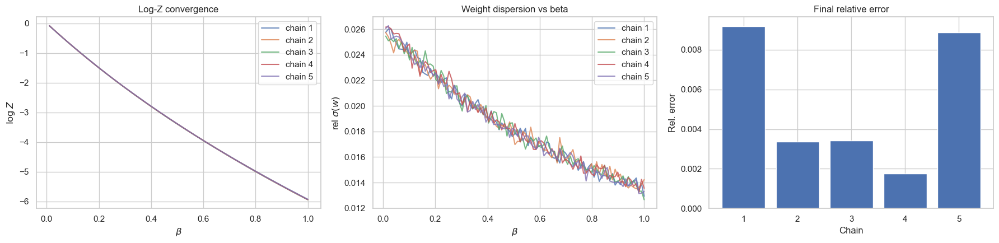

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.150e-02  | <w> mean = 9.2173e-01
[beta=0.020]  mean log rho = -8.058e-02  | <w> mean = 9.2258e-01
[beta=0.030]  mean log rho = -7.987e-02  | <w> mean = 9.2324e-01
[beta=0.040]  mean log rho = -7.863e-02  | <w> mean = 9.2439e-01
[beta=0.051]  mean log rho = -7.866e-02  | <w> mean = 9.2435e-01
[beta=0.061]  mean log rho = -7.793e-02  | <w> mean = 9.2503e-01
[beta=0.071]  mean log rho = -7.744e-02  | <w> mean = 9.2548e-01
[beta=0.081]  mean log rho = -7.709e-02  | <w> mean = 9.2580e-01
[beta=0.091]  mean log rho = -7.630e-02  | <w> mean = 9.2653e-01
[23:43:26] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.480e-02  | <w> mean = 9.2793e-01
[beta=0.111]  mean log rho = -7.508e-02  | <w> mean = 9.2767e-01
[beta=0.121]  mean log rho = -7.378e-02  | <w> mean = 9.2888e-01
[beta=0.131]  mean log rho = -7.406e-02  | <w> mean = 9.2861e-01
[beta=0.141]  mean log rho = -7.325e-02  | <w> mean = 9.2937e-01
[beta=0.152]  mean lo

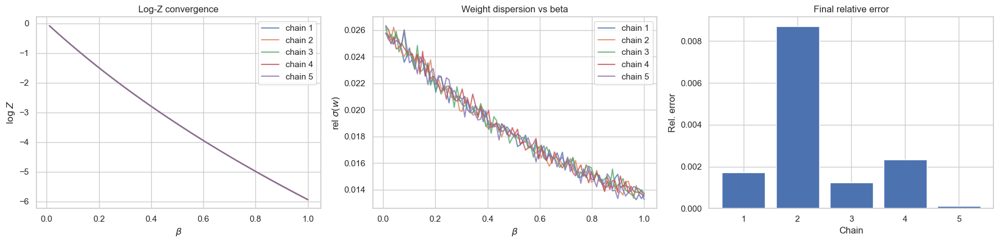

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.222e-02  | <w> mean = 9.2107e-01
[beta=0.020]  mean log rho = -7.997e-02  | <w> mean = 9.2314e-01
[beta=0.030]  mean log rho = -7.980e-02  | <w> mean = 9.2330e-01
[beta=0.040]  mean log rho = -7.934e-02  | <w> mean = 9.2373e-01
[beta=0.051]  mean log rho = -7.849e-02  | <w> mean = 9.2451e-01
[beta=0.061]  mean log rho = -7.762e-02  | <w> mean = 9.2532e-01
[beta=0.071]  mean log rho = -7.728e-02  | <w> mean = 9.2563e-01
[beta=0.081]  mean log rho = -7.707e-02  | <w> mean = 9.2582e-01
[beta=0.091]  mean log rho = -7.645e-02  | <w> mean = 9.2640e-01
[23:45:34] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.571e-02  | <w> mean = 9.2709e-01
[beta=0.111]  mean log rho = -7.548e-02  | <w> mean = 9.2730e-01
[beta=0.121]  mean log rho = -7.421e-02  | <w> mean = 9.2848e-01
[beta=0.131]  mean log rho = -7.413e-02  | <w> mean = 9.2855e-01
[beta=0.141]  mean log rho = -7.331e-02  | <w> mean = 9.2932e-01
[beta=0.152]  mean lo

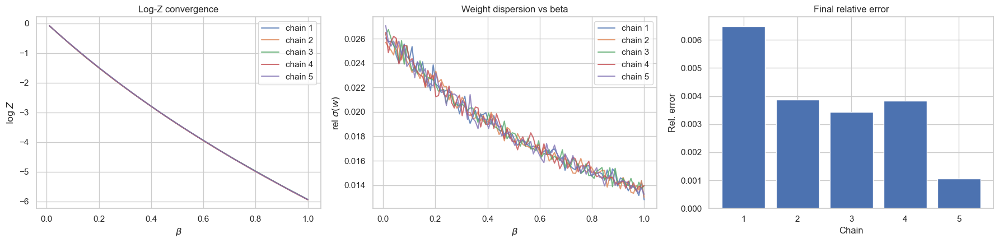

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.142e-02  | <w> mean = 9.2180e-01
[beta=0.020]  mean log rho = -8.101e-02  | <w> mean = 9.2219e-01
[beta=0.030]  mean log rho = -7.962e-02  | <w> mean = 9.2346e-01
[beta=0.040]  mean log rho = -7.927e-02  | <w> mean = 9.2379e-01
[beta=0.051]  mean log rho = -7.934e-02  | <w> mean = 9.2372e-01
[beta=0.061]  mean log rho = -7.868e-02  | <w> mean = 9.2434e-01
[beta=0.071]  mean log rho = -7.731e-02  | <w> mean = 9.2560e-01
[beta=0.081]  mean log rho = -7.678e-02  | <w> mean = 9.2609e-01
[beta=0.091]  mean log rho = -7.622e-02  | <w> mean = 9.2662e-01
[23:47:41] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.555e-02  | <w> mean = 9.2723e-01
[beta=0.111]  mean log rho = -7.523e-02  | <w> mean = 9.2753e-01
[beta=0.121]  mean log rho = -7.429e-02  | <w> mean = 9.2840e-01
[beta=0.131]  mean log rho = -7.385e-02  | <w> mean = 9.2881e-01
[beta=0.141]  mean log rho = -7.321e-02  | <w> mean = 9.2941e-01
[beta=0.152]  mean lo

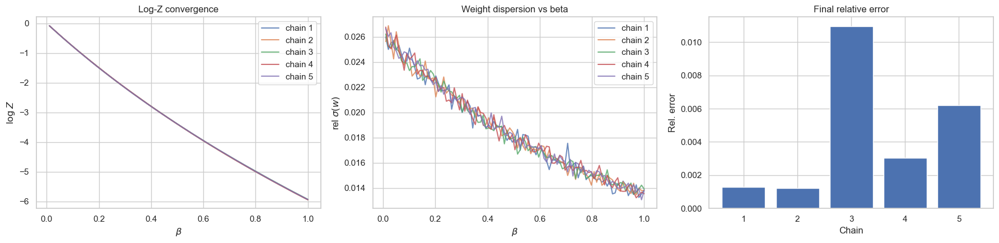

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.118e-02  | <w> mean = 9.2203e-01
[beta=0.020]  mean log rho = -8.013e-02  | <w> mean = 9.2300e-01
[beta=0.030]  mean log rho = -8.042e-02  | <w> mean = 9.2273e-01
[beta=0.040]  mean log rho = -7.910e-02  | <w> mean = 9.2394e-01
[beta=0.051]  mean log rho = -7.888e-02  | <w> mean = 9.2415e-01
[beta=0.061]  mean log rho = -7.822e-02  | <w> mean = 9.2476e-01
[beta=0.071]  mean log rho = -7.763e-02  | <w> mean = 9.2531e-01
[beta=0.081]  mean log rho = -7.660e-02  | <w> mean = 9.2626e-01
[beta=0.091]  mean log rho = -7.607e-02  | <w> mean = 9.2675e-01
[23:49:52] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.529e-02  | <w> mean = 9.2747e-01
[beta=0.111]  mean log rho = -7.463e-02  | <w> mean = 9.2809e-01
[beta=0.121]  mean log rho = -7.387e-02  | <w> mean = 9.2879e-01
[beta=0.131]  mean log rho = -7.388e-02  | <w> mean = 9.2878e-01
[beta=0.141]  mean log rho = -7.339e-02  | <w> mean = 9.2923e-01
[beta=0.152]  mean lo

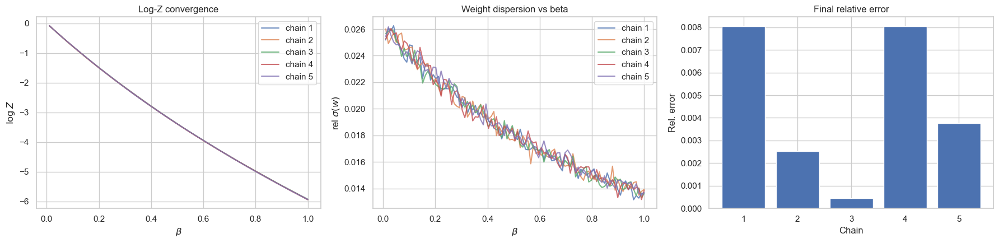


>>> Running with 30 rounds
Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.133e-02  | <w> mean = 9.2189e-01
[beta=0.020]  mean log rho = -8.022e-02  | <w> mean = 9.2292e-01
[beta=0.030]  mean log rho = -8.041e-02  | <w> mean = 9.2273e-01
[beta=0.040]  mean log rho = -7.982e-02  | <w> mean = 9.2328e-01
[beta=0.051]  mean log rho = -7.908e-02  | <w> mean = 9.2397e-01
[beta=0.061]  mean log rho = -7.761e-02  | <w> mean = 9.2533e-01
[beta=0.071]  mean log rho = -7.668e-02  | <w> mean = 9.2618e-01
[beta=0.081]  mean log rho = -7.682e-02  | <w> mean = 9.2605e-01
[beta=0.091]  mean log rho = -7.703e-02  | <w> mean = 9.2586e-01
[23:51:57] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.565e-02  | <w> mean = 9.2714e-01
[beta=0.111]  mean log rho = -7.553e-02  | <w> mean = 9.2725e-01
[beta=0.121]  mean log rho = -7.558e-02  | <w> mean = 9.2720e-01
[beta=0.131]  mean log rho = -7.359e-02  | <w> mean = 9.2906e-01
[beta=0.141]  mean log rho = -7.347e-02  | <w> mean = 9.29

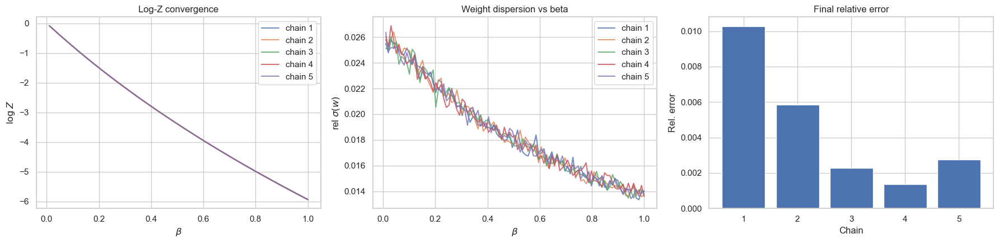

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.105e-02  | <w> mean = 9.2215e-01
[beta=0.020]  mean log rho = -8.058e-02  | <w> mean = 9.2258e-01
[beta=0.030]  mean log rho = -8.038e-02  | <w> mean = 9.2276e-01
[beta=0.040]  mean log rho = -7.952e-02  | <w> mean = 9.2356e-01
[beta=0.051]  mean log rho = -7.862e-02  | <w> mean = 9.2439e-01
[beta=0.061]  mean log rho = -7.762e-02  | <w> mean = 9.2531e-01
[beta=0.071]  mean log rho = -7.749e-02  | <w> mean = 9.2543e-01
[beta=0.081]  mean log rho = -7.645e-02  | <w> mean = 9.2640e-01
[beta=0.091]  mean log rho = -7.614e-02  | <w> mean = 9.2669e-01
[23:53:57] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.555e-02  | <w> mean = 9.2723e-01
[beta=0.111]  mean log rho = -7.536e-02  | <w> mean = 9.2741e-01
[beta=0.121]  mean log rho = -7.445e-02  | <w> mean = 9.2825e-01
[beta=0.131]  mean log rho = -7.399e-02  | <w> mean = 9.2868e-01
[beta=0.141]  mean log rho = -7.308e-02  | <w> mean = 9.2953e-01
[beta=0.152]  mean lo

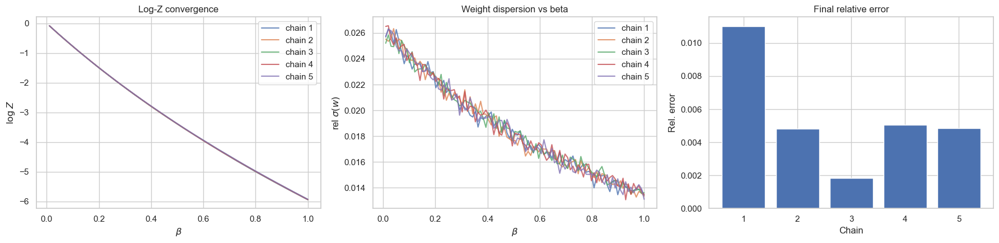

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.243e-02  | <w> mean = 9.2087e-01
[beta=0.020]  mean log rho = -8.028e-02  | <w> mean = 9.2286e-01
[beta=0.030]  mean log rho = -8.055e-02  | <w> mean = 9.2261e-01
[beta=0.040]  mean log rho = -7.961e-02  | <w> mean = 9.2348e-01
[beta=0.051]  mean log rho = -7.825e-02  | <w> mean = 9.2473e-01
[beta=0.061]  mean log rho = -7.735e-02  | <w> mean = 9.2556e-01
[beta=0.071]  mean log rho = -7.765e-02  | <w> mean = 9.2529e-01
[beta=0.081]  mean log rho = -7.640e-02  | <w> mean = 9.2645e-01
[beta=0.091]  mean log rho = -7.583e-02  | <w> mean = 9.2697e-01
[23:55:08] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.600e-02  | <w> mean = 9.2681e-01
[beta=0.111]  mean log rho = -7.512e-02  | <w> mean = 9.2763e-01
[beta=0.121]  mean log rho = -7.464e-02  | <w> mean = 9.2808e-01
[beta=0.131]  mean log rho = -7.453e-02  | <w> mean = 9.2818e-01
[beta=0.141]  mean log rho = -7.264e-02  | <w> mean = 9.2993e-01
[beta=0.152]  mean lo

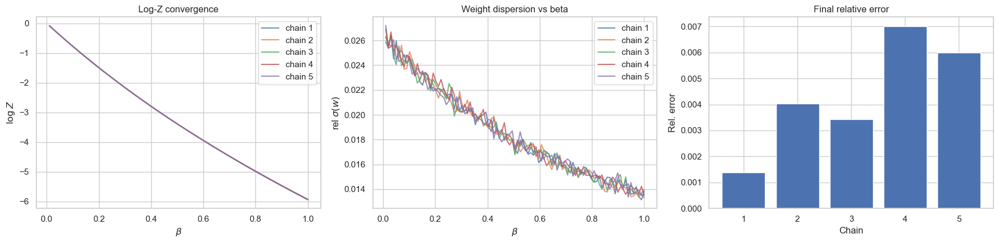

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.165e-02  | <w> mean = 9.2160e-01
[beta=0.020]  mean log rho = -8.037e-02  | <w> mean = 9.2278e-01
[beta=0.030]  mean log rho = -8.055e-02  | <w> mean = 9.2261e-01
[beta=0.040]  mean log rho = -7.952e-02  | <w> mean = 9.2356e-01
[beta=0.051]  mean log rho = -7.963e-02  | <w> mean = 9.2346e-01
[beta=0.061]  mean log rho = -7.788e-02  | <w> mean = 9.2507e-01
[beta=0.071]  mean log rho = -7.757e-02  | <w> mean = 9.2536e-01
[beta=0.081]  mean log rho = -7.692e-02  | <w> mean = 9.2596e-01
[beta=0.091]  mean log rho = -7.604e-02  | <w> mean = 9.2678e-01
[23:56:20] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.616e-02  | <w> mean = 9.2667e-01
[beta=0.111]  mean log rho = -7.526e-02  | <w> mean = 9.2750e-01
[beta=0.121]  mean log rho = -7.433e-02  | <w> mean = 9.2836e-01
[beta=0.131]  mean log rho = -7.470e-02  | <w> mean = 9.2803e-01
[beta=0.141]  mean log rho = -7.367e-02  | <w> mean = 9.2898e-01
[beta=0.152]  mean lo

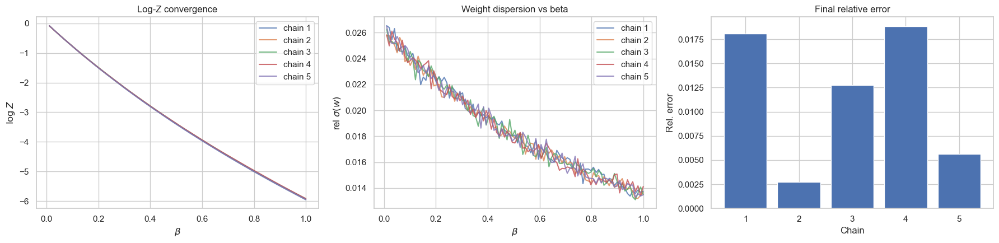

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.186e-02  | <w> mean = 9.2140e-01
[beta=0.020]  mean log rho = -7.988e-02  | <w> mean = 9.2323e-01
[beta=0.030]  mean log rho = -8.012e-02  | <w> mean = 9.2300e-01
[beta=0.040]  mean log rho = -7.900e-02  | <w> mean = 9.2404e-01
[beta=0.051]  mean log rho = -7.898e-02  | <w> mean = 9.2406e-01
[beta=0.061]  mean log rho = -7.857e-02  | <w> mean = 9.2444e-01
[beta=0.071]  mean log rho = -7.684e-02  | <w> mean = 9.2603e-01
[beta=0.081]  mean log rho = -7.716e-02  | <w> mean = 9.2575e-01
[beta=0.091]  mean log rho = -7.616e-02  | <w> mean = 9.2667e-01
[23:57:32] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.626e-02  | <w> mean = 9.2657e-01
[beta=0.111]  mean log rho = -7.541e-02  | <w> mean = 9.2737e-01
[beta=0.121]  mean log rho = -7.432e-02  | <w> mean = 9.2838e-01
[beta=0.131]  mean log rho = -7.338e-02  | <w> mean = 9.2924e-01
[beta=0.141]  mean log rho = -7.406e-02  | <w> mean = 9.2861e-01
[beta=0.152]  mean lo

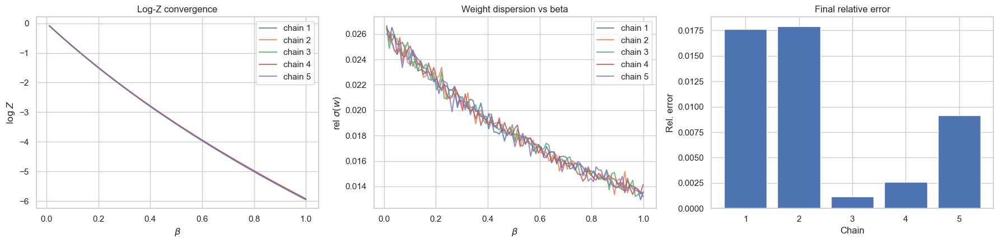

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.104e-02  | <w> mean = 9.2216e-01
[beta=0.020]  mean log rho = -8.080e-02  | <w> mean = 9.2238e-01
[beta=0.030]  mean log rho = -7.976e-02  | <w> mean = 9.2334e-01
[beta=0.040]  mean log rho = -7.912e-02  | <w> mean = 9.2393e-01
[beta=0.051]  mean log rho = -7.902e-02  | <w> mean = 9.2402e-01
[beta=0.061]  mean log rho = -7.813e-02  | <w> mean = 9.2485e-01
[beta=0.071]  mean log rho = -7.707e-02  | <w> mean = 9.2583e-01
[beta=0.081]  mean log rho = -7.709e-02  | <w> mean = 9.2581e-01
[beta=0.091]  mean log rho = -7.611e-02  | <w> mean = 9.2672e-01
[23:58:44] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.491e-02  | <w> mean = 9.2783e-01
[beta=0.111]  mean log rho = -7.552e-02  | <w> mean = 9.2726e-01
[beta=0.121]  mean log rho = -7.480e-02  | <w> mean = 9.2793e-01
[beta=0.131]  mean log rho = -7.312e-02  | <w> mean = 9.2949e-01
[beta=0.141]  mean log rho = -7.284e-02  | <w> mean = 9.2975e-01
[beta=0.152]  mean lo

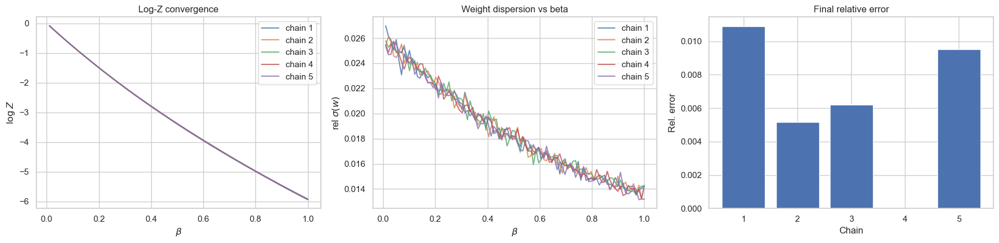

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.221e-02  | <w> mean = 9.2107e-01
[beta=0.020]  mean log rho = -8.053e-02  | <w> mean = 9.2263e-01
[beta=0.030]  mean log rho = -7.992e-02  | <w> mean = 9.2319e-01
[beta=0.040]  mean log rho = -7.863e-02  | <w> mean = 9.2438e-01
[beta=0.051]  mean log rho = -7.889e-02  | <w> mean = 9.2414e-01
[beta=0.061]  mean log rho = -7.816e-02  | <w> mean = 9.2481e-01
[beta=0.071]  mean log rho = -7.731e-02  | <w> mean = 9.2561e-01
[beta=0.081]  mean log rho = -7.737e-02  | <w> mean = 9.2555e-01
[beta=0.091]  mean log rho = -7.713e-02  | <w> mean = 9.2577e-01
[23:59:55] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.551e-02  | <w> mean = 9.2727e-01
[beta=0.111]  mean log rho = -7.498e-02  | <w> mean = 9.2776e-01
[beta=0.121]  mean log rho = -7.366e-02  | <w> mean = 9.2899e-01
[beta=0.131]  mean log rho = -7.382e-02  | <w> mean = 9.2884e-01
[beta=0.141]  mean log rho = -7.394e-02  | <w> mean = 9.2873e-01
[beta=0.152]  mean lo

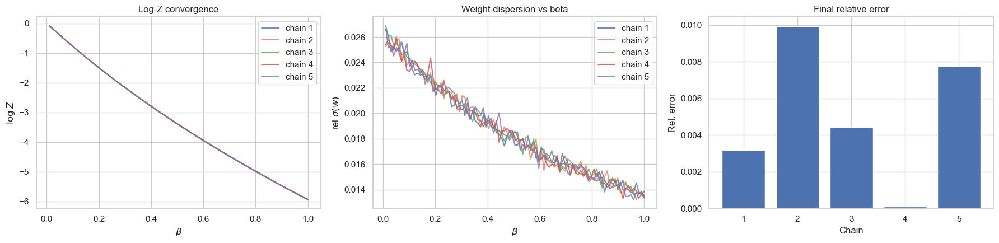

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.117e-02  | <w> mean = 9.2204e-01
[beta=0.020]  mean log rho = -8.066e-02  | <w> mean = 9.2251e-01
[beta=0.030]  mean log rho = -8.034e-02  | <w> mean = 9.2280e-01
[beta=0.040]  mean log rho = -7.934e-02  | <w> mean = 9.2373e-01
[beta=0.051]  mean log rho = -7.891e-02  | <w> mean = 9.2413e-01
[beta=0.061]  mean log rho = -7.791e-02  | <w> mean = 9.2505e-01
[beta=0.071]  mean log rho = -7.726e-02  | <w> mean = 9.2565e-01
[beta=0.081]  mean log rho = -7.780e-02  | <w> mean = 9.2515e-01
[beta=0.091]  mean log rho = -7.603e-02  | <w> mean = 9.2679e-01
[00:01:07] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.593e-02  | <w> mean = 9.2688e-01
[beta=0.111]  mean log rho = -7.524e-02  | <w> mean = 9.2752e-01
[beta=0.121]  mean log rho = -7.478e-02  | <w> mean = 9.2794e-01
[beta=0.131]  mean log rho = -7.396e-02  | <w> mean = 9.2871e-01
[beta=0.141]  mean log rho = -7.364e-02  | <w> mean = 9.2901e-01
[beta=0.152]  mean lo

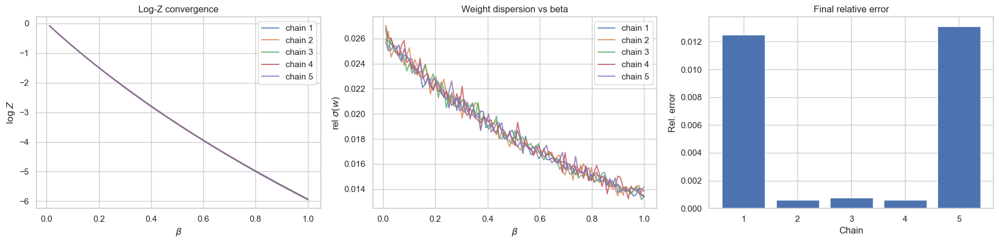

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.162e-02  | <w> mean = 9.2162e-01
[beta=0.020]  mean log rho = -8.048e-02  | <w> mean = 9.2268e-01
[beta=0.030]  mean log rho = -8.074e-02  | <w> mean = 9.2244e-01
[beta=0.040]  mean log rho = -7.926e-02  | <w> mean = 9.2380e-01
[beta=0.051]  mean log rho = -7.866e-02  | <w> mean = 9.2436e-01
[beta=0.061]  mean log rho = -7.775e-02  | <w> mean = 9.2520e-01
[beta=0.071]  mean log rho = -7.834e-02  | <w> mean = 9.2465e-01
[beta=0.081]  mean log rho = -7.756e-02  | <w> mean = 9.2537e-01
[beta=0.091]  mean log rho = -7.571e-02  | <w> mean = 9.2708e-01
[00:02:23] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.563e-02  | <w> mean = 9.2716e-01
[beta=0.111]  mean log rho = -7.550e-02  | <w> mean = 9.2728e-01
[beta=0.121]  mean log rho = -7.426e-02  | <w> mean = 9.2843e-01
[beta=0.131]  mean log rho = -7.368e-02  | <w> mean = 9.2897e-01
[beta=0.141]  mean log rho = -7.386e-02  | <w> mean = 9.2881e-01
[beta=0.152]  mean lo

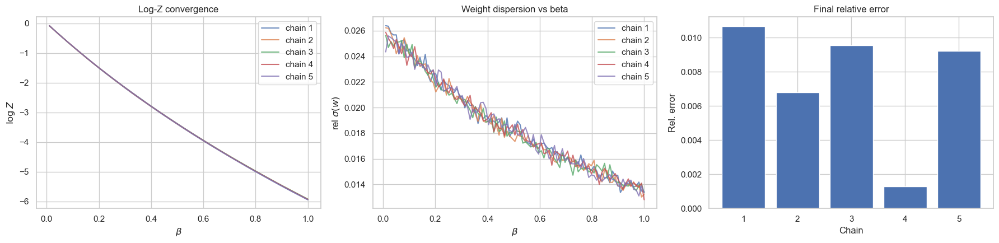

Running 5 AIS chains vectorized
[beta=0.010]  mean log rho = -8.158e-02  | <w> mean = 9.2166e-01
[beta=0.020]  mean log rho = -8.043e-02  | <w> mean = 9.2272e-01
[beta=0.030]  mean log rho = -8.021e-02  | <w> mean = 9.2293e-01
[beta=0.040]  mean log rho = -7.847e-02  | <w> mean = 9.2453e-01
[beta=0.051]  mean log rho = -7.899e-02  | <w> mean = 9.2405e-01
[beta=0.061]  mean log rho = -7.821e-02  | <w> mean = 9.2477e-01
[beta=0.071]  mean log rho = -7.720e-02  | <w> mean = 9.2570e-01
[beta=0.081]  mean log rho = -7.736e-02  | <w> mean = 9.2556e-01
[beta=0.091]  mean log rho = -7.629e-02  | <w> mean = 9.2655e-01
[00:03:35] beta step 10/99 (0.1010) 
[beta=0.101]  mean log rho = -7.614e-02  | <w> mean = 9.2669e-01
[beta=0.111]  mean log rho = -7.524e-02  | <w> mean = 9.2752e-01
[beta=0.121]  mean log rho = -7.463e-02  | <w> mean = 9.2809e-01
[beta=0.131]  mean log rho = -7.470e-02  | <w> mean = 9.2803e-01
[beta=0.141]  mean log rho = -7.355e-02  | <w> mean = 9.2909e-01
[beta=0.152]  mean lo

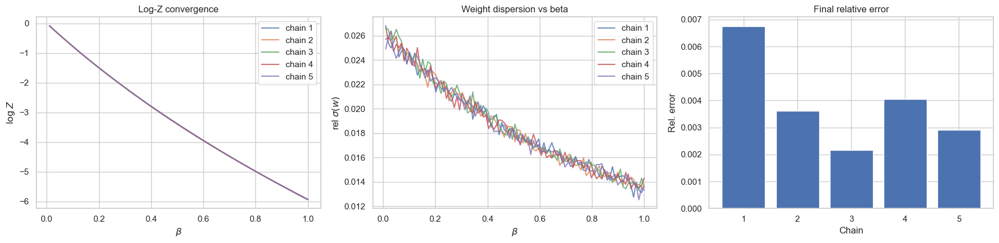

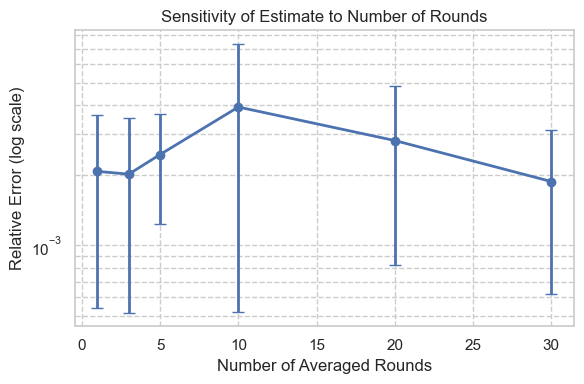

 Rounds  Mean Relative Error  Std Relative Error     Mean Ẑ   Std Ẑ
      1             0.002081            0.001543 1404.546447 3.635370
      3             0.002024            0.001511 1403.326754 3.268240
      5             0.002459            0.001225 1405.125918 3.836020
     10             0.003933            0.003414 1402.178000 6.864519
     20             0.002823            0.001998 1406.068083 4.663733
     30             0.001882            0.001265 1403.725394 3.029990


,Rounds,Mean Relative Error,Std Relative Error,Mean Ẑ,Std Ẑ
0,1,0.002081,0.001543,1404.546447,3.635370
1,3,0.002024,0.001511,1403.326754,3.268240
2,5,0.002459,0.001225,1405.125918,3.836020
3,10,0.003933,0.003414,1402.178000,6.864519
4,20,0.002823,0.001998,1406.068083,4.663733
5,30,0.001882,0.001265,1403.725394,3.029990


In [9]:
def sensitivity_n_rounds(dim=3, 
                         betas=np.linspace(0, 1, 100), 
                         rounds_list=[1, 3, 5, 10, 20, 30],
                         iters=10_000,
                         burns=1000,
                         n_chains=5,
                         n_trials=10):  # added multiple trials
    print('\n>>> Building Tensor Network')
    G, tensors = build_3x3_grid_test(dim=dim)
    TRUE_Z = contract_tensor_network(G, tensors)
    tn = TensorNetwork(G, tensors)

    stats = []

    for n_rounds in rounds_list:
        print(f'\n>>> Running with {n_rounds} rounds')

        rel_errors = []
        Z_means = []

        for trial in range(n_trials):
            try:
                mean_Z, std_Z = run_multiple_chains(
                    tn, betas,
                    n_chains=n_chains,
                    iters=iters,
                    burns=burns,
                    n_rounds=n_rounds,
                    Z_true=TRUE_Z
                )
                rel_error = np.abs(mean_Z - TRUE_Z) / np.abs(TRUE_Z)
                rel_errors.append(rel_error)
                Z_means.append(mean_Z)
            except Exception as e:
                print(f"[!] Trial {trial+1} failed for {n_rounds} rounds: {e}")

        if len(rel_errors) > 0:
            stats.append({
                'Rounds': n_rounds,
                'Mean Relative Error': np.mean(rel_errors),
                'Std Relative Error': np.std(rel_errors),
                'Mean Ẑ': np.mean(Z_means),
                'Std Ẑ': np.std(Z_means)
            })

    df = pd.DataFrame(stats)

    sns.set_theme(style="whitegrid")
    plt.figure(figsize=(6, 4))
    plt.errorbar(df['Rounds'], df['Mean Relative Error'],
                 yerr=df['Std Relative Error'], fmt='o-', capsize=4, lw=2)
    plt.yscale('log')
    plt.xlabel('Number of Averaged Rounds')
    plt.ylabel('Relative Error (log scale)')
    plt.title('Sensitivity of Estimate to Number of Rounds')
    plt.tight_layout()
    plt.grid(True, which="both", ls="--")
    plt.show()

    print(df.to_string(index=False, float_format='%.6f'))
    return df

sensitivity_n_rounds()